In [1]:
import torch
import torch.nn as nn
import torch
import torch.optim as optim
import torch.nn.functional as F
import torchvision
from math import floor, ceil

from torchvision import datasets, models, transforms
from torch.utils.data import DataLoader, Dataset
from sklearn.decomposition import PCA
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.colors import ListedColormap
import os
import zipfile
import glob
import random
from PIL import Image
import seaborn as sns

In [2]:
device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"Using {device} device")

Using cuda device


In [3]:
train_batch_size = 64  # Define train batch size
test_batch_size  = 256 # Define test batch size (can be larger than train batch size)


# Use the following code to load and normalize the dataset
train_loader = torch.utils.data.DataLoader(
  torchvision.datasets.MNIST('/files/', train=True, download=True,
                             transform=torchvision.transforms.Compose([
                               torchvision.transforms.ToTensor(),
                               torchvision.transforms.Normalize(
                                 (0.1307,), (0.3081,))
                             ])),
  batch_size=train_batch_size, shuffle=True)
train_data, val_data = torch.utils.data.random_split(train_loader.dataset, \
                                            [floor(len(train_loader.dataset)*0.8), floor(len(train_loader.dataset)*0.2)])
train_loader = torch.utils.data.DataLoader(train_data, batch_size=train_batch_size)
val_loader = torch.utils.data.DataLoader(val_data, batch_size=test_batch_size)

test_loader = torch.utils.data.DataLoader(
  torchvision.datasets.MNIST('/files/', train=False, download=True,
                             transform=torchvision.transforms.Compose([
                               torchvision.transforms.ToTensor(),
                               torchvision.transforms.Normalize(
                                 (0.1307,), (0.3081,))
                             ])),
  batch_size=test_batch_size, shuffle=True)

In [4]:
class LstmModel(torch.nn.Module):

    def __init__(self, input_scan_dim, hidden_dim, output_dim):
        super(LstmModel, self).__init__()
        self.n_in = input_scan_dim
        self.n_hid = hidden_dim
        self.lstm = torch.nn.LSTM(input_scan_dim, hidden_dim)
        self.readout = torch.nn.Linear(hidden_dim, output_dim)
        self.num_layers = 1
        self.save_path = './saved_LSTM'
        if torch.cuda.is_available():
            self.device = torch.device('cuda')
        else:
            self.device = torch.device('cpu')
        

    def forward(self, x, h=None):
        batch_size = x.size(0)
        seq_first_x = x.reshape(batch_size, -1, self.n_in).permute(1, 0, 2).contiguous()
        # seq_first_x.shape == (batch_size, sequence_length, input_scan_dim)
        if h is None:
            h = torch.zeros(self.num_layers, batch_size, self.n_hid, device=self.device)
        c = torch.zeros(self.num_layers, batch_size, self.n_hid, device=self.device)
        output_list, (h, c) = self.lstm(seq_first_x, (h, c))
        reshaped_hidden = h.view(batch_size, -1)
        output_list = output_list.permute(1, 0, 2)
        return output_list, output_list, self.readout(reshaped_hidden)

In [5]:
from torch.autograd import Variable


class FixedPoint(object):
    def __init__(self, model, device, max_epochs=50000):
        self.model = model
        self.device = device
        self.max_epochs = max_epochs

    def calc_speed(self, hidden, signal, full):
#         import pdb; pdb.set_trace()
        if full:
            hidden_list,_,_ = self.model(signal, hidden)
            # import pdb; pdb.set_trace()
            final = hidden_list[:,-1,...]
            start = hidden_list[:, 0,...]

            speed = torch.norm(final - start)
        else:
            activated = self.model.one_step(hidden, signal)
            speed = torch.norm(activated - hidden)

        return speed

    def find_fixed_point(self, init_hidden, signal, full, view=False, lr=1e-3, tor=1e-4, ok_tor=0.1):
        new_hidden = init_hidden.clone()
        result_ok = True
        i = 0
        hidden = Variable(new_hidden).to(self.device)
        hidden.requires_grad = True
        optimizer = torch.optim.Adam([hidden], lr=lr)
#         import pdb; pdb.set_trace()
        last_speed = 0
        while True:
#             signal = torch.randn(signal.shape).to(self.device)
            speed = self.calc_speed(hidden, signal, full=full)
            optimizer.zero_grad()
            if (i+1) % 1000 == 0:
                if view: print(f'iteration: {i+1}, speed={speed.item()}')
                if abs(speed.item() - last_speed)<tor:
                    print(f'performance leveled, forcibly finished. speed={speed.item()}')
                    break
                last_speed = speed.item()
            if speed.item() < tor:
                print(f'epoch: {i+1}, speed={speed.item()}')
                break
            speed.backward()
            optimizer.step()
            if i == self.max_epochs:
                print(f'Reach max iteration, forcibly finished. speed={speed.item()}')
                break
            i += 1

        result_ok = speed.item()<ok_tor
        fixed_point = hidden[0]
        return fixed_point, result_ok

    def calc_jacobian(self, fixed_point, const_signal_tensor):
        fixed_point = torch.unsqueeze(fixed_point, dim=1)
        fixed_point = Variable(fixed_point).to(self.device)
        fixed_point.requires_grad = True
        input_signal = const_signal_tensor.permute(1, 0, 2)
        w_hh = self.model.w_hh.weight
        w_hh.requires_grad = False
        w_hh = w_hh.to(self.device)
        pre_activates = torch.unsqueeze(self.model.w_in(input_signal[0])[0], dim=1) + \
                        w_hh @ fixed_point + torch.unsqueeze(self.model.w_hh.bias, dim=1)

        if self.model.activation == 'relu':
            activated = F.relu(pre_activates)
        else:
            activated = torch.tanh(pre_activates)

        jacobian = torch.zeros(self.model.n_hid, self.model.n_hid)
        for i in range(self.model.n_hid):
            output = torch.zeros(self.model.n_hid, 1).to(self.device)
            output[i] = 1.
            jacobian[:, i:i + 1] = torch.autograd.grad(activated, fixed_point, grad_outputs=output, retain_graph=True)[
                0]

        jacobian = jacobian.numpy().T

        return jacobian


In [6]:
class RNN(nn.Module):
    def __init__(self, n_in, n_out, n_hid,
                 activation='relu', use_bias=True,
                 lyapunov=False, autonomous=False,
                 save_path='./saved_RNN', loss_fn=nn.CrossEntropyLoss()):
        super(RNN, self).__init__()
        self.n_in = n_in
        self.n_hid = n_hid
        self.n_out = n_out
        self.w_in = nn.Linear(n_in, n_hid, bias=use_bias)
        self.w_hh = nn.Linear(n_hid, n_hid, bias=use_bias)
        self.w_out = nn.Linear(n_hid, n_out, bias=use_bias)
        
        self.loss_fn = loss_fn
        self.activation = activation
        self.save_path = save_path
        self.lyapunov = lyapunov

    def forward(self, input_signal, hidden=None, targets=None):
        batch_size = input_signal.size(0)
        input_signal = input_signal.reshape(batch_size, -1, self.n_in).permute(1, 0, 2).contiguous()
        length = input_signal.size(0)
        hidden_list = torch.zeros(length, batch_size, self.n_hid).type_as(input_signal.data)
        output_list = torch.zeros(length, batch_size, self.n_out).type_as(input_signal.data)
    
        if hidden is None:
            hidden = torch.zeros(batch_size, self.n_hid).to(device)
        
        for t in range(length):
#             import pdb; pdb.set_trace()
            pre_activates = self.w_in(input_signal[t]) + self.w_hh(hidden)

            if self.activation == 'relu':
                hidden = F.relu(pre_activates)
            else:
                hidden = torch.tanh(pre_activates)

            output = self.w_out(hidden)
            hidden_list[t] = hidden
            output_list[t] = output
        hidden_list = hidden_list.permute(1, 0, 2)
        output_list = output_list.permute(1, 0, 2)
        return hidden_list, output_list, output
    
    def one_step(self, hidden, input_signal=None):
        if input_signal is not None:
            input_signal = input_signal.permute(1, 0, 2)
        else:
            n_batch = hidden.shape[0] 
            input_signal = torch.zeros([1, n_batch, self.n_in]).to(hidden.device)
        pre_activates = self.w_in(input_signal[0]) + self.w_hh(hidden)

        if self.activation == 'relu':
            activated = F.relu(pre_activates)
        else:
            activated = torch.tanh(pre_activates)
        
        return activated
    
    def fixed_point_loss(self, hidden_list):
        hidden = hidden_list[-1]
        return torch.norm(self.one_step(hidden = hidden) - hidden)
        

In [7]:
def train(dataloader, model, loss_fn, optimizer, log=True):
    model.train()
    if log: print('epoch: {0}'.format(epoch))
    batch = 0
    size = len(train_loader.dataset)
    for batch, (train_sample, label) in enumerate(train_loader):
        #Calculate training loss on model
        train_sample, label = train_sample.to(device), label.to(device)

        hidden_list,_,pred = model(train_sample, targets=label)
        
        loss = loss_fn(pred, label)
        if model.lyapunov:
#             import pdb; pdb.set_trace()
            loss = loss + model.fixed_point_loss(hidden_list)/300

        #backprop
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        if batch % 100 == 0 and log:
            loss, current = loss.item(), batch * len(train_sample)
            print(f"loss: {loss:>7f}  [{current:>5d}/{size:>5d}]")
            
    return loss.item()

#Calculate loss on validation data
def validate(dataloader, model, loss_fn, log=True):
    size = len(dataloader.dataset)
    num_batch = len(dataloader)
    model.eval()
    val_loss, correct = 0, 0
    with torch.no_grad():
        for val_sample, label in dataloader:
            val_sample, label = val_sample.to(device), label.to(device)
            _,_,pred = model(val_sample)
            val_loss +=loss_fn(pred, label).item()
            correct += (pred.argmax(1)==label).type(torch.float).sum().item()
    val_loss /= num_batch
    correct /= size
    if log: print(f"Validation Error: \n Accuracy: {(100*correct):>0.1f}%, Avg loss: {val_loss:>8f} \n")
    return val_loss
     
def test(dataloader, model, loss_fn):
    size = len(dataloader.dataset)
    num_batch = len(dataloader)
    model.eval()
    test_loss, correct = 0, 0
    with torch.no_grad():
        for test_sample, label in dataloader:
            test_sample, label = test_sample.to(device), label.to(device)
            _,_,pred = model(test_sample)
            test_loss +=loss_fn(pred, label).item()
            correct += (pred.argmax(1)==label).type(torch.float).sum().item()
    test_loss /= num_batch
    correct /= size
    print(f"Test Error: \n Accuracy: {(100*correct):>0.1f}%, Avg loss: {test_loss:>8f} \n")
    return test_loss

def load(path, model):
    if os.path.exists(path):
        model.load_state_dict(torch.load(path))

Test Error: 
 Accuracy: 97.2%, Avg loss: 0.106874 



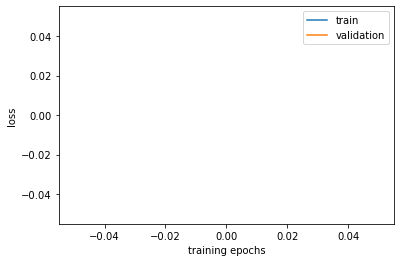

In [9]:
nepochs =0
loss_fn = nn.CrossEntropyLoss()
n_hid = 200
n_in = 28
n_out = 10
model_vanilla = RNN(n_in, n_out, n_hid, lyapunov=False, activation='tanh', save_path='./vanillaRNN').to(device)
load(model_vanilla.save_path, model)
optimizer = torch.optim.Adam(model_vanilla.parameters(), lr=1e-3, weight_decay=0.0001)
# load(model_vanilla.save_path, model_vanilla)

train_losses = []
val_losses=[]
for epoch in range(nepochs):
    train_losses.append(train(train_loader, model_vanilla, loss_fn, optimizer, True))
    
    if (epoch+1)%1==0:
        loss = validate(val_loader, model_vanilla, loss_fn, True)
        if (val_losses) and loss < min(val_losses):
            torch.save(model_vanilla.state_dict(), model_vanilla.save_path)
        val_losses.append(loss)
        
fig = plt.figure()
plt.plot(np.arange(0, nepochs, 1), train_losses)
plt.plot(np.arange(0, nepochs, 1), val_losses)
plt.xlabel('training epochs')
plt.ylabel('loss')
plt.legend(['train', 'validation'])

test(test_loader, model, loss_fn);

Test Error: 
 Accuracy: 9.7%, Avg loss: 107075548569.600006 



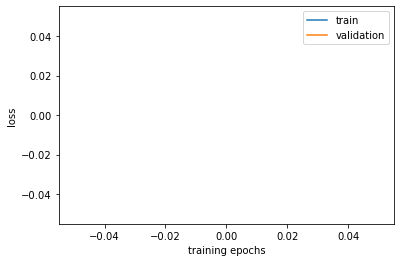

In [11]:
nepochs =0
loss_fn = nn.CrossEntropyLoss()
n_hid = 128
n_in = 28
n_out = 10
model_lyap = RNN(n_in, n_out, n_hid, lyapunov=True, save_path='./lyapRNN').to(device)
optimizer = torch.optim.Adam(model_lyap.parameters(), lr=1e-3)
load(model_lyap.save_path, model_lyap)

train_losses = []
val_losses=[]
for epoch in range(nepochs):
    train_losses.append(train(train_loader,model_lyap, loss_fn, optimizer, True))
    
    if (epoch+1)%1==0:
        loss = validate(val_loader, model_lyap, loss_fn, True)
        if (val_losses) and loss < min(val_losses):
            torch.save(model_lyap.state_dict(), model_lyap.save_path)
        val_losses.append(loss)
        
fig = plt.figure()
plt.plot(np.arange(0, nepochs, 1), train_losses)
plt.plot(np.arange(0, nepochs, 1), val_losses)
plt.xlabel('training epochs')
plt.ylabel('loss')
plt.legend(['train', 'validation'])

test(test_loader, model_lyap, loss_fn);

In [ ]:
nepochs =0
loss_fn = nn.CrossEntropyLoss()
n_hid = 128
n_in = 28
n_out = 10
model = LstmModel(n_in, n_hid, n_out).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
load(model.save_path, model)

train_losses = []
val_losses=[]
for epoch in range(nepochs):
    train_losses.append(train(train_loader, model, loss_fn, optimizer, True))
    
    if (epoch+1)%1==0:
        loss = validate(val_loader, model, loss_fn, True)
        if (val_losses) and loss < min(val_losses):
            torch.save(model.state_dict(), model.save_path)
        val_losses.append(loss)
        
fig = plt.figure()
plt.plot(np.arange(0, nepochs, 1), train_losses)
plt.plot(np.arange(0, nepochs, 1), val_losses)
plt.xlabel('training epochs')
plt.ylabel('loss')
plt.legend(['train', 'validation'])

test(test_loader, model, loss_fn);

In [12]:
def show_images(images):
    images = np.reshape(images, [images.shape[0], -1])  # images reshape to (batch_size, D)
    sqrtn = int(np.ceil(np.sqrt(images.shape[0])))
    sqrtimg = int(np.ceil(np.sqrt(images.shape[1])))

    fig = plt.figure(figsize=(sqrtn, sqrtn))
    gs = gridspec.GridSpec(sqrtn, sqrtn)
    gs.update(wspace=0.05, hspace=0.05)

    for i, img in enumerate(images):
        ax = plt.subplot(gs[i])
        plt.axis('off')
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        ax.set_aspect('equal')
        plt.imshow(img.reshape([sqrtimg,sqrtimg]))
    return 

In [17]:
import matplotlib
# matplotlib.use('Agg')

import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D


from sklearn.decomposition import PCA
single_loader = torch.utils.data.DataLoader(
torchvision.datasets.MNIST('/files/', train=False, download=True,
                            transform=torchvision.transforms.Compose([
                            torchvision.transforms.ToTensor(),
                            torchvision.transforms.Normalize(
                                (0.1307,), (0.3081,))
                            ])),
batch_size=1, shuffle=True)
def find_fix_points(model, loader,
                    use_mean_digit=False,
                    n_fix=20, 
                    dataset='MNIST', 
                    full=False,
                    max_epochs=20000,
                    ok_tor=0.1, 
                    start_digit=-1):
    # freeze the weights in model
    for param in model.parameters():
        param.requires_grad = False

    fixed_point_list = np.zeros([n_fix, model.n_hid])
    model.autonomous = False
    n_found = 0
    if use_mean_digit:
        mean_digit = torch.zeros(10, 28, 28)
        for i, (test_sample, label) in enumerate(loader):
            mean_digit[label, ...] += test_sample.squeeze()
        mean_digit /= (i+1)
        show_images(mean_digit)
        mean_digit = mean_digit.to(device)
    # import pdb; pdb.set_trace()
    if dataset == 'MNIST':
        cnt = np.zeros(10)
        if start_digit != -1:
            cnt = np.ones(10)*2
            cnt[start_digit] = -18
    for i, (test_sample, label) in enumerate(loader):
        if dataset == 'MNIST':
            test_sample = test_sample.squeeze(1)
            label_np = label.clone()
            if cnt[label_np]==2:
                continue
        test_sample, label = test_sample.float().to(device), label.float().to(device)

        if use_mean_digit:
            signal_tensor = mean_digit[label_np, ...]
            # signal_tensor = test_sample
        else:
            if dataset=='MNIST':
                signal_tensor = torch.zeros(test_sample.shape).to(device)
            elif dataset=='Sine':
                # signal_tensor = (torch.tensor(i/n_fix).to(device)*0.04+0.01)*torch.ones(test_sample.shape).to(device)
                # signal_tensor = signal_tensor.float()
                signal_tensor = test_sample

        analyzer = FixedPoint(model=model, device=device, max_epochs=max_epochs)

        # print(label)
        with torch.no_grad():
            hidden_list, _, _ = model(test_sample)
        fixed_point, result_ok = analyzer.find_fixed_point(torch.unsqueeze(hidden_list[:, -1, :], dim=0).to(device),
                                                           signal_tensor, 
                                                           full = full,
                                                           view=True,
                                                           ok_tor=ok_tor)
        if not result_ok:
            continue
        if dataset == 'MNIST':
            if cnt[label_np]==2:
                continue
            cnt[label_np]+=1
        fixed_point_list[n_found] = fixed_point.detach().cpu().numpy()
        n_found += 1
        print(n_found)
        if n_found == n_fix:
            break
    return fixed_point_list

In [15]:
n_hid = 200
n_in = 28
n_out = 10
model = RNN(n_in, n_out, n_hid, lyapunov=False, activation='tanh', save_path='./vanillaRNN').to(device)
load(model.save_path, model)
vanilla_fixed_point_list = find_fix_points(model, single_loader, use_mean_digit=False)

iteration: 1000, speed=3.3747992515563965
iteration: 2000, speed=2.554703950881958
iteration: 3000, speed=1.8345019817352295
iteration: 4000, speed=1.476585865020752
iteration: 5000, speed=1.2673166990280151
iteration: 6000, speed=1.252586841583252
iteration: 7000, speed=1.2494263648986816
iteration: 8000, speed=1.2333004474639893
iteration: 9000, speed=1.232904076576233
iteration: 10000, speed=1.2327442169189453
iteration: 11000, speed=1.2328647375106812
iteration: 12000, speed=1.2330870628356934
iteration: 13000, speed=1.2329312562942505
iteration: 14000, speed=1.2328845262527466
performance leveled, forcibly finished. speed=1.2328845262527466
iteration: 1000, speed=3.5798120498657227
iteration: 2000, speed=2.056307077407837
iteration: 3000, speed=1.504944920539856
iteration: 4000, speed=1.4125672578811646
iteration: 5000, speed=1.1577407121658325
iteration: 6000, speed=0.5655862092971802
iteration: 7000, speed=0.0036246476229280233
iteration: 8000, speed=0.003311869688332081
iterati

iteration: 14000, speed=0.09923162311315536
iteration: 15000, speed=0.09942575544118881
iteration: 16000, speed=0.09898000210523605
iteration: 17000, speed=0.09924600273370743
iteration: 18000, speed=0.09913738816976547
iteration: 19000, speed=0.09929266571998596
iteration: 20000, speed=0.09925836324691772
performance leveled, forcibly finished. speed=0.09925836324691772
5
iteration: 1000, speed=3.9830405712127686
iteration: 2000, speed=2.593510150909424
iteration: 3000, speed=2.124602794647217
iteration: 4000, speed=1.5852855443954468
iteration: 5000, speed=0.7309838533401489
iteration: 6000, speed=0.6892424821853638
iteration: 7000, speed=0.6072032451629639
iteration: 8000, speed=0.11888173967599869
iteration: 9000, speed=0.0990389883518219
iteration: 10000, speed=0.09914582222700119
iteration: 11000, speed=0.09902960807085037
iteration: 12000, speed=0.09926591068506241
iteration: 13000, speed=0.09919553995132446
performance leveled, forcibly finished. speed=0.09919553995132446
6
ite

iteration: 11000, speed=0.0028395876288414
iteration: 12000, speed=0.002053832169622183
iteration: 13000, speed=0.0017407938139513135
iteration: 14000, speed=0.0016336356056854129
iteration: 15000, speed=0.0018002524739131331
iteration: 16000, speed=0.0019795368425548077
iteration: 17000, speed=0.0019722438883036375
performance leveled, forcibly finished. speed=0.0019722438883036375
10
iteration: 1000, speed=2.3439383506774902
iteration: 2000, speed=1.0376406908035278
iteration: 3000, speed=0.5326758623123169
iteration: 4000, speed=0.2629769444465637
iteration: 5000, speed=0.1957862377166748
iteration: 6000, speed=0.19489383697509766
iteration: 7000, speed=0.19472260773181915
iteration: 8000, speed=0.1948092132806778
performance leveled, forcibly finished. speed=0.1948092132806778
iteration: 1000, speed=2.168591022491455
iteration: 2000, speed=0.2846302390098572
iteration: 3000, speed=0.20581160485744476
iteration: 4000, speed=0.19648994505405426
iteration: 5000, speed=0.19508440792560

iteration: 7000, speed=0.9222728610038757
iteration: 8000, speed=0.510011613368988
iteration: 9000, speed=0.01694348454475403
iteration: 10000, speed=0.0026060130912810564
iteration: 11000, speed=0.0021753497421741486
iteration: 12000, speed=0.0015090875094756484
iteration: 13000, speed=0.002582288347184658
iteration: 14000, speed=0.0026367974933236837
performance leveled, forcibly finished. speed=0.0026367974933236837
14
iteration: 1000, speed=2.1828665733337402
iteration: 2000, speed=1.0769836902618408
iteration: 3000, speed=0.7891882658004761
iteration: 4000, speed=0.3813239336013794
iteration: 5000, speed=0.33880937099456787
iteration: 6000, speed=0.18262696266174316
iteration: 7000, speed=0.08849348872900009
iteration: 8000, speed=0.025272175669670105
iteration: 9000, speed=0.018406329676508904
iteration: 10000, speed=0.012651062570512295
iteration: 11000, speed=0.005373302381485701
iteration: 12000, speed=0.004251495003700256
iteration: 13000, speed=0.002525669988244772
iteration

iteration: 1000, speed=3.8723297119140625
iteration: 2000, speed=1.6918236017227173
iteration: 3000, speed=1.2478628158569336
iteration: 4000, speed=1.2431341409683228
iteration: 5000, speed=1.243086814880371
performance leveled, forcibly finished. speed=1.243086814880371
iteration: 1000, speed=3.5412094593048096
iteration: 2000, speed=2.390146255493164
iteration: 3000, speed=1.8278343677520752
iteration: 4000, speed=0.9553768634796143
iteration: 5000, speed=0.26634737849235535
iteration: 6000, speed=0.10030295699834824
iteration: 7000, speed=0.10025577247142792
performance leveled, forcibly finished. speed=0.10025577247142792
iteration: 1000, speed=3.577075958251953
iteration: 2000, speed=2.551731586456299
iteration: 3000, speed=1.8714830875396729
iteration: 4000, speed=0.990456223487854
iteration: 5000, speed=0.12851838767528534
iteration: 6000, speed=0.10041029006242752
iteration: 7000, speed=0.10026225447654724
iteration: 8000, speed=0.10027263313531876
performance leveled, forcibl

iteration: 10000, speed=0.7873592376708984
performance leveled, forcibly finished. speed=0.7873592376708984
iteration: 1000, speed=2.6550841331481934
iteration: 2000, speed=1.9436379671096802
iteration: 3000, speed=1.4178950786590576
iteration: 4000, speed=0.7547956705093384
iteration: 5000, speed=0.11690980195999146
iteration: 6000, speed=0.10011590272188187
iteration: 7000, speed=0.10013892501592636
performance leveled, forcibly finished. speed=0.10013892501592636
iteration: 1000, speed=3.4721384048461914
iteration: 2000, speed=2.647075653076172
iteration: 3000, speed=2.09456729888916
iteration: 4000, speed=1.6659643650054932
iteration: 5000, speed=1.0683354139328003
iteration: 6000, speed=0.7635757327079773
iteration: 7000, speed=0.6816616058349609
iteration: 8000, speed=0.6817285418510437
performance leveled, forcibly finished. speed=0.6817285418510437
iteration: 1000, speed=3.2184925079345703
iteration: 2000, speed=2.2015020847320557
iteration: 3000, speed=1.8267449140548706
itera

iteration: 8000, speed=0.10030866414308548
performance leveled, forcibly finished. speed=0.10030866414308548
iteration: 1000, speed=3.8347344398498535
iteration: 2000, speed=2.5290915966033936
iteration: 3000, speed=2.3082075119018555
iteration: 4000, speed=2.275113344192505
iteration: 5000, speed=2.274294853210449
iteration: 6000, speed=2.2744028568267822
iteration: 7000, speed=2.2739992141723633
iteration: 8000, speed=2.274190664291382
iteration: 9000, speed=2.2739620208740234
iteration: 10000, speed=2.2742624282836914
iteration: 11000, speed=2.274430513381958
iteration: 12000, speed=2.274354934692383
performance leveled, forcibly finished. speed=2.274354934692383
iteration: 1000, speed=3.064999580383301
iteration: 2000, speed=2.1305534839630127
iteration: 3000, speed=1.5153435468673706
iteration: 4000, speed=0.6347103714942932
iteration: 5000, speed=0.20086669921875
iteration: 6000, speed=0.19826684892177582
iteration: 7000, speed=0.19564513862133026
iteration: 8000, speed=0.1951414

iteration: 3000, speed=2.293794631958008
iteration: 4000, speed=2.293058395385742
iteration: 5000, speed=2.27945876121521
iteration: 6000, speed=2.2745296955108643
iteration: 7000, speed=2.2743358612060547
iteration: 8000, speed=2.2742667198181152
performance leveled, forcibly finished. speed=2.2742667198181152
iteration: 1000, speed=2.9346747398376465
iteration: 2000, speed=1.9826101064682007
iteration: 3000, speed=1.5509101152420044
iteration: 4000, speed=0.7994639873504639
iteration: 5000, speed=0.1996348649263382
iteration: 6000, speed=0.19597575068473816
iteration: 7000, speed=0.1951889991760254
iteration: 8000, speed=0.19455371797084808
iteration: 9000, speed=0.1945963352918625
performance leveled, forcibly finished. speed=0.1945963352918625
iteration: 1000, speed=3.5450119972229004
iteration: 2000, speed=2.8249099254608154
iteration: 3000, speed=2.0995211601257324
iteration: 4000, speed=1.4119981527328491
iteration: 5000, speed=0.4406895637512207
iteration: 6000, speed=0.1004466

iteration: 11000, speed=2.274247169494629
performance leveled, forcibly finished. speed=2.274247169494629
iteration: 1000, speed=3.2008471488952637
iteration: 2000, speed=1.867004156112671
iteration: 3000, speed=1.388261318206787
iteration: 4000, speed=0.43485283851623535
iteration: 5000, speed=0.10295192152261734
iteration: 6000, speed=0.10032448172569275
iteration: 7000, speed=0.10033871233463287
performance leveled, forcibly finished. speed=0.10033871233463287
iteration: 1000, speed=3.118468761444092
iteration: 2000, speed=2.682142734527588
iteration: 3000, speed=2.557248115539551
iteration: 4000, speed=1.9273581504821777
iteration: 5000, speed=1.5755029916763306
iteration: 6000, speed=0.4915879964828491
iteration: 7000, speed=0.10029079020023346
iteration: 8000, speed=0.10030793398618698
performance leveled, forcibly finished. speed=0.10030793398618698
iteration: 1000, speed=3.3443212509155273
iteration: 2000, speed=1.9454970359802246
iteration: 3000, speed=1.2012481689453125
itera

iteration: 2000, speed=2.8406822681427
iteration: 3000, speed=2.3841516971588135
iteration: 4000, speed=1.6975706815719604
iteration: 5000, speed=1.5528644323349
iteration: 6000, speed=0.41888323426246643
iteration: 7000, speed=0.10028800368309021
iteration: 8000, speed=0.1001916453242302
performance leveled, forcibly finished. speed=0.1001916453242302
iteration: 1000, speed=3.421147584915161
iteration: 2000, speed=2.523838520050049
iteration: 3000, speed=2.227335214614868
iteration: 4000, speed=2.097851514816284
iteration: 5000, speed=2.0885908603668213
iteration: 6000, speed=2.087484121322632
iteration: 7000, speed=2.087186336517334
iteration: 8000, speed=2.0838491916656494
iteration: 9000, speed=2.0838096141815186
performance leveled, forcibly finished. speed=2.0838096141815186
iteration: 1000, speed=3.314558744430542
iteration: 2000, speed=2.66377592086792
iteration: 3000, speed=2.126210927963257
iteration: 4000, speed=1.7814115285873413
iteration: 5000, speed=1.3658320903778076
it

In [18]:
n_hid = 200
n_in = 28
n_out = 10
model = RNN(n_in, n_out, n_hid, lyapunov=False, activation='tanh', save_path='./vanillaRNN').to(device)
load(model.save_path, model)
vanilla_single_fixed_point_list = find_fix_points(model, single_loader, use_mean_digit=False, start_digit=1)

iteration: 1000, speed=2.4340741634368896
iteration: 2000, speed=1.4174845218658447
iteration: 3000, speed=0.9687578678131104
iteration: 4000, speed=0.8664528131484985
iteration: 5000, speed=0.5324243903160095
iteration: 6000, speed=0.5286234617233276
iteration: 7000, speed=0.5180230140686035
iteration: 8000, speed=0.5109196901321411
iteration: 9000, speed=0.5110093951225281
performance leveled, forcibly finished. speed=0.5110093951225281
iteration: 1000, speed=3.030965805053711
iteration: 2000, speed=1.863632082939148
iteration: 3000, speed=1.088686466217041
iteration: 4000, speed=0.6097486615180969
iteration: 5000, speed=0.47991743683815
iteration: 6000, speed=0.47596243023872375
iteration: 7000, speed=0.4762105941772461
iteration: 8000, speed=0.47604772448539734
iteration: 9000, speed=0.47592663764953613
iteration: 10000, speed=0.4762309491634369
iteration: 11000, speed=0.4759635925292969
iteration: 12000, speed=0.476230263710022
iteration: 13000, speed=0.4763244092464447
performanc

iteration: 5000, speed=0.2666539251804352
iteration: 6000, speed=0.003985603339970112
iteration: 7000, speed=0.002426262479275465
iteration: 8000, speed=0.0017872793832793832
iteration: 9000, speed=0.002044207649305463
iteration: 10000, speed=0.0019006723305210471
iteration: 11000, speed=0.0027674983721226454
iteration: 12000, speed=0.002711587818339467
performance leveled, forcibly finished. speed=0.002711587818339467
10
iteration: 1000, speed=2.0666592121124268
iteration: 2000, speed=1.4179714918136597
iteration: 3000, speed=0.7070318460464478
iteration: 4000, speed=0.5790570378303528
iteration: 5000, speed=0.04327023774385452
iteration: 6000, speed=0.0022433202248066664
iteration: 7000, speed=0.00156862020958215
iteration: 8000, speed=0.0013623416889458895
iteration: 9000, speed=0.0014264688361436129
performance leveled, forcibly finished. speed=0.0014264688361436129
11
iteration: 1000, speed=2.296438217163086
iteration: 2000, speed=1.3770780563354492
iteration: 3000, speed=0.874711

iteration: 4000, speed=0.5995610356330872
iteration: 5000, speed=0.2019953578710556
iteration: 6000, speed=0.004604886751621962
iteration: 7000, speed=0.0017639219295233488
iteration: 8000, speed=0.0016793622635304928
performance leveled, forcibly finished. speed=0.0016793622635304928
15
iteration: 1000, speed=2.569941282272339
iteration: 2000, speed=1.4571361541748047
iteration: 3000, speed=0.8698726892471313
iteration: 4000, speed=0.5888229608535767
iteration: 5000, speed=0.06501595675945282
iteration: 6000, speed=0.0023382483050227165
iteration: 7000, speed=0.0020818610209971666
iteration: 8000, speed=0.0019401244353502989
iteration: 9000, speed=0.00231344997882843
iteration: 10000, speed=0.0021037182305008173
iteration: 11000, speed=0.0022262181155383587
iteration: 12000, speed=0.0024050315842032433
iteration: 13000, speed=0.0021507740020751953
iteration: 14000, speed=0.0015005284221842885
iteration: 15000, speed=0.002133245812729001
iteration: 16000, speed=0.0021370730828493834
pe

In [23]:
n_hid = 200
n_in = 28
n_out = 10
model = RNN(n_in, n_out, n_hid, lyapunov=False, activation='tanh', save_path='./vanillaRNN').to(device)
load(model.save_path, model)
vanilla_single_fixed_point_list_list = []
for i in range(10):
    vanilla_single_fixed_point_list_list.append(find_fix_points(model, single_loader, use_mean_digit=False, start_digit=i))

iteration: 1000, speed=2.206444025039673
iteration: 2000, speed=1.1551668643951416
iteration: 3000, speed=0.8424524664878845
iteration: 4000, speed=0.5950837135314941
iteration: 5000, speed=0.07788161933422089
iteration: 6000, speed=0.003200651379302144
iteration: 7000, speed=0.0025449057575315237
iteration: 8000, speed=0.0016913424478843808
iteration: 9000, speed=0.0023034552577883005
iteration: 10000, speed=0.002147725783288479
iteration: 11000, speed=0.0017988217296078801
iteration: 12000, speed=0.002525924937799573
iteration: 13000, speed=0.001866756472736597
iteration: 14000, speed=0.0022555282339453697
iteration: 15000, speed=0.0020653202664107084
iteration: 16000, speed=0.002837088657543063
iteration: 17000, speed=0.0017864530673250556
iteration: 18000, speed=0.002618934027850628
iteration: 19000, speed=0.0019833443220704794
iteration: 20000, speed=0.001974774757400155
performance leveled, forcibly finished. speed=0.001974774757400155
1
iteration: 1000, speed=2.7136356830596924


iteration: 15000, speed=0.0016386641655117273
iteration: 16000, speed=0.0019548397976905107
iteration: 17000, speed=0.0020997438114136457
iteration: 18000, speed=0.0019986778497695923
iteration: 19000, speed=0.002049471251666546
performance leveled, forcibly finished. speed=0.002049471251666546
9
iteration: 1000, speed=2.559216022491455
iteration: 2000, speed=1.3585397005081177
iteration: 3000, speed=0.7747094035148621
iteration: 4000, speed=0.5935179591178894
iteration: 5000, speed=0.07640621066093445
iteration: 6000, speed=0.0029364137444645166
iteration: 7000, speed=0.0018598666647449136
iteration: 8000, speed=0.00196746620349586
iteration: 9000, speed=0.0022420831955969334
iteration: 10000, speed=0.0017310214461758733
iteration: 11000, speed=0.002264265902340412
iteration: 12000, speed=0.0019779603462666273
iteration: 13000, speed=0.0019368621287867427
performance leveled, forcibly finished. speed=0.0019368621287867427
10
iteration: 1000, speed=2.5186774730682373
iteration: 2000, s

iteration: 6000, speed=0.002567087998613715
iteration: 7000, speed=0.0018046979093924165
iteration: 8000, speed=0.0018267974955961108
performance leveled, forcibly finished. speed=0.0018267974955961108
20
iteration: 1000, speed=1.8395495414733887
iteration: 2000, speed=0.19793842732906342
iteration: 3000, speed=0.10059192031621933
iteration: 4000, speed=0.10031642019748688
iteration: 5000, speed=0.10033596307039261
performance leveled, forcibly finished. speed=0.10033596307039261
iteration: 1000, speed=2.6372087001800537
iteration: 2000, speed=0.986422061920166
iteration: 3000, speed=0.4105594754219055
iteration: 4000, speed=0.2976784110069275
iteration: 5000, speed=0.28963935375213623
iteration: 6000, speed=0.289078950881958
iteration: 7000, speed=0.28885355591773987
iteration: 8000, speed=0.28935953974723816
iteration: 9000, speed=0.2890435755252838
iteration: 10000, speed=0.2893054783344269
iteration: 11000, speed=0.28919464349746704
iteration: 12000, speed=0.28896644711494446
itera

iteration: 1000, speed=2.4896254539489746
iteration: 2000, speed=0.9438176155090332
iteration: 3000, speed=0.289887398481369
iteration: 4000, speed=0.28909459710121155
iteration: 5000, speed=0.2892226278781891
iteration: 6000, speed=0.28908199071884155
iteration: 7000, speed=0.2890335023403168
performance leveled, forcibly finished. speed=0.2890335023403168
iteration: 1000, speed=2.7215349674224854
iteration: 2000, speed=0.859738290309906
iteration: 3000, speed=0.41850799322128296
iteration: 4000, speed=0.34491580724716187
iteration: 5000, speed=0.34489476680755615
performance leveled, forcibly finished. speed=0.34489476680755615
iteration: 1000, speed=2.4844369888305664
iteration: 2000, speed=1.2971997261047363
iteration: 3000, speed=0.8759347796440125
iteration: 4000, speed=0.4240092635154724
iteration: 5000, speed=0.34989115595817566
iteration: 6000, speed=0.18451665341854095
iteration: 7000, speed=0.14527566730976105
iteration: 8000, speed=0.027433110401034355
iteration: 9000, spee

iteration: 4000, speed=0.2826569378376007
iteration: 5000, speed=0.2815731465816498
iteration: 6000, speed=0.28217610716819763
iteration: 7000, speed=0.28228065371513367
iteration: 8000, speed=0.2816685438156128
iteration: 9000, speed=0.28191301226615906
iteration: 10000, speed=0.2818548083305359
performance leveled, forcibly finished. speed=0.2818548083305359
iteration: 1000, speed=2.8296499252319336
iteration: 2000, speed=0.7780677080154419
iteration: 3000, speed=0.23429958522319794
iteration: 4000, speed=0.20052401721477509
iteration: 5000, speed=0.1953994631767273
iteration: 6000, speed=0.19521085917949677
iteration: 7000, speed=0.19467760622501373
iteration: 8000, speed=0.19486534595489502
iteration: 9000, speed=0.19461768865585327
iteration: 10000, speed=0.19500257074832916
iteration: 11000, speed=0.1946716457605362
iteration: 12000, speed=0.1947695016860962
performance leveled, forcibly finished. speed=0.1947695016860962
iteration: 1000, speed=2.4556875228881836
iteration: 2000,

iteration: 5000, speed=0.3449840247631073
iteration: 6000, speed=0.3449881076812744
performance leveled, forcibly finished. speed=0.3449881076812744
iteration: 1000, speed=1.4471876621246338
iteration: 2000, speed=0.2906157076358795
iteration: 3000, speed=0.2827807664871216
iteration: 4000, speed=0.2818920612335205
iteration: 5000, speed=0.2817133665084839
iteration: 6000, speed=0.2816848158836365
performance leveled, forcibly finished. speed=0.2816848158836365
iteration: 1000, speed=2.99135684967041
iteration: 2000, speed=0.8540372252464294
iteration: 3000, speed=0.4761818051338196
iteration: 4000, speed=0.3013657331466675
iteration: 5000, speed=0.28969696164131165
iteration: 6000, speed=0.28905680775642395
iteration: 7000, speed=0.2893395721912384
iteration: 8000, speed=0.2891070246696472
iteration: 9000, speed=0.2889164388179779
iteration: 10000, speed=0.2890617251396179
iteration: 11000, speed=0.28899478912353516
performance leveled, forcibly finished. speed=0.28899478912353516
ite

iteration: 9000, speed=0.2890954613685608
iteration: 10000, speed=0.2892417013645172
iteration: 11000, speed=0.28923147916793823
performance leveled, forcibly finished. speed=0.28923147916793823
iteration: 1000, speed=2.395643711090088
iteration: 2000, speed=0.19696500897407532
iteration: 3000, speed=0.10135429352521896
iteration: 4000, speed=0.10039453208446503
iteration: 5000, speed=0.10029158741235733
iteration: 6000, speed=0.10039524734020233
iteration: 7000, speed=0.10004676133394241
iteration: 8000, speed=0.1001860648393631
iteration: 9000, speed=0.10044049471616745
iteration: 10000, speed=0.10015429556369781
iteration: 11000, speed=0.10027265548706055
iteration: 12000, speed=0.10025333613157272
performance leveled, forcibly finished. speed=0.10025333613157272
iteration: 1000, speed=2.740302324295044
iteration: 2000, speed=1.2727220058441162
iteration: 3000, speed=0.4945470094680786
iteration: 4000, speed=0.20607802271842957
iteration: 5000, speed=0.19545505940914154
iteration: 6

iteration: 1000, speed=2.7869861125946045
iteration: 2000, speed=1.6117099523544312
iteration: 3000, speed=0.6250110268592834
iteration: 4000, speed=0.3043498694896698
iteration: 5000, speed=0.28984904289245605
iteration: 6000, speed=0.2893005311489105
iteration: 7000, speed=0.28929463028907776
performance leveled, forcibly finished. speed=0.28929463028907776
iteration: 1000, speed=1.8437557220458984
iteration: 2000, speed=0.23125037550926208
iteration: 3000, speed=0.19887247681617737
iteration: 4000, speed=0.19580481946468353
iteration: 5000, speed=0.19543543457984924
iteration: 6000, speed=0.19452133774757385
iteration: 7000, speed=0.1947164237499237
iteration: 8000, speed=0.1946313977241516
performance leveled, forcibly finished. speed=0.1946313977241516
iteration: 1000, speed=2.1383626461029053
iteration: 2000, speed=1.0666645765304565
iteration: 3000, speed=0.7759281396865845
iteration: 4000, speed=0.38203853368759155
iteration: 5000, speed=0.33696335554122925
iteration: 6000, spe

iteration: 5000, speed=0.19504614174365997
iteration: 6000, speed=0.1948016881942749
iteration: 7000, speed=0.1946260631084442
iteration: 8000, speed=0.19481536746025085
iteration: 9000, speed=0.19456806778907776
iteration: 10000, speed=0.19477611780166626
iteration: 11000, speed=0.19475002586841583
performance leveled, forcibly finished. speed=0.19475002586841583
iteration: 1000, speed=2.5297505855560303
iteration: 2000, speed=1.5975743532180786
iteration: 3000, speed=0.6339118480682373
iteration: 4000, speed=0.36267051100730896
iteration: 5000, speed=0.29142746329307556
iteration: 6000, speed=0.2892923951148987
iteration: 7000, speed=0.2888147830963135
iteration: 8000, speed=0.28921636939048767
iteration: 9000, speed=0.28917357325553894
performance leveled, forcibly finished. speed=0.28917357325553894
iteration: 1000, speed=2.587000608444214
iteration: 2000, speed=1.6223095655441284
iteration: 3000, speed=0.5665238499641418
iteration: 4000, speed=0.35903868079185486
iteration: 5000, 

iteration: 1000, speed=2.905834913253784
iteration: 2000, speed=0.7207075357437134
iteration: 3000, speed=0.3379473090171814
iteration: 4000, speed=0.3350798189640045
iteration: 5000, speed=0.3354300856590271
iteration: 6000, speed=0.33540669083595276
performance leveled, forcibly finished. speed=0.33540669083595276
iteration: 1000, speed=1.2926599979400635
iteration: 2000, speed=0.351530522108078
iteration: 3000, speed=0.28556472063064575
iteration: 4000, speed=0.2821657061576843
iteration: 5000, speed=0.2818286418914795
iteration: 6000, speed=0.2820405662059784
iteration: 7000, speed=0.28186044096946716
iteration: 8000, speed=0.281602680683136
iteration: 9000, speed=0.28220435976982117
iteration: 10000, speed=0.2819300591945648
iteration: 11000, speed=0.28216174244880676
iteration: 12000, speed=0.2820433974266052
iteration: 13000, speed=0.2819557189941406
performance leveled, forcibly finished. speed=0.2819557189941406
iteration: 1000, speed=2.3916783332824707
iteration: 2000, speed=

iteration: 7000, speed=0.19470961391925812
performance leveled, forcibly finished. speed=0.19470961391925812
iteration: 1000, speed=2.6906931400299072
iteration: 2000, speed=1.0354828834533691
iteration: 3000, speed=0.3799564242362976
iteration: 4000, speed=0.34578678011894226
iteration: 5000, speed=0.3447872996330261
iteration: 6000, speed=0.3451184332370758
iteration: 7000, speed=0.34509119391441345
performance leveled, forcibly finished. speed=0.34509119391441345
iteration: 1000, speed=2.587385892868042
iteration: 2000, speed=1.5977027416229248
iteration: 3000, speed=0.5614787340164185
iteration: 4000, speed=0.17549815773963928
iteration: 5000, speed=0.1207595020532608
iteration: 6000, speed=0.1205059215426445
iteration: 7000, speed=0.12029343098402023
iteration: 8000, speed=0.1200205609202385
iteration: 9000, speed=0.12030352652072906
iteration: 10000, speed=0.12022706121206284
performance leveled, forcibly finished. speed=0.12022706121206284
iteration: 1000, speed=2.42076086997985

iteration: 2000, speed=1.5962276458740234
iteration: 3000, speed=0.6832559108734131
iteration: 4000, speed=0.40690988302230835
iteration: 5000, speed=0.29238641262054443
iteration: 6000, speed=0.28930872678756714
iteration: 7000, speed=0.2891042232513428
iteration: 8000, speed=0.2890714108943939
performance leveled, forcibly finished. speed=0.2890714108943939
iteration: 1000, speed=1.4714761972427368
iteration: 2000, speed=0.2605304718017578
iteration: 3000, speed=0.20019009709358215
iteration: 4000, speed=0.19582724571228027
iteration: 5000, speed=0.19519145786762238
iteration: 6000, speed=0.19480471312999725
iteration: 7000, speed=0.19466030597686768
iteration: 8000, speed=0.19436658918857574
iteration: 9000, speed=0.19475141167640686
iteration: 10000, speed=0.19478245079517365
performance leveled, forcibly finished. speed=0.19478245079517365
iteration: 1000, speed=1.4068938493728638
iteration: 2000, speed=0.35045886039733887
iteration: 3000, speed=0.2821563184261322
iteration: 4000,

iteration: 1000, speed=1.8273084163665771
iteration: 2000, speed=0.29285678267478943
iteration: 3000, speed=0.20191995799541473
iteration: 4000, speed=0.19561241567134857
iteration: 5000, speed=0.19504399597644806
iteration: 6000, speed=0.19505037367343903
performance leveled, forcibly finished. speed=0.19505037367343903
iteration: 1000, speed=2.887451410293579
iteration: 2000, speed=1.1462019681930542
iteration: 3000, speed=0.5742329955101013
iteration: 4000, speed=0.3505529761314392
iteration: 5000, speed=0.34484216570854187
iteration: 6000, speed=0.3450350761413574
iteration: 7000, speed=0.34501275420188904
performance leveled, forcibly finished. speed=0.34501275420188904
iteration: 1000, speed=1.4371155500411987
iteration: 2000, speed=0.21322859823703766
iteration: 3000, speed=0.19598565995693207
iteration: 4000, speed=0.1951402723789215
iteration: 5000, speed=0.194500133395195
iteration: 6000, speed=0.19451168179512024
performance leveled, forcibly finished. speed=0.19451168179512

iteration: 10000, speed=0.289429634809494
iteration: 11000, speed=0.2891935706138611
iteration: 12000, speed=0.2892376184463501
performance leveled, forcibly finished. speed=0.2892376184463501
iteration: 1000, speed=2.6468112468719482
iteration: 2000, speed=0.9595975875854492
iteration: 3000, speed=0.6122552156448364
iteration: 4000, speed=0.5126591324806213
iteration: 5000, speed=0.299968421459198
iteration: 6000, speed=0.2893352508544922
iteration: 7000, speed=0.2889424264431
iteration: 8000, speed=0.2892982065677643
iteration: 9000, speed=0.289122998714447
iteration: 10000, speed=0.2891080975532532
performance leveled, forcibly finished. speed=0.2891080975532532
iteration: 1000, speed=1.4346721172332764
iteration: 2000, speed=0.36266955733299255
iteration: 3000, speed=0.32457342743873596
iteration: 4000, speed=0.28159788250923157
iteration: 5000, speed=0.2819274365901947
iteration: 6000, speed=0.28209951519966125
iteration: 7000, speed=0.28167271614074707
iteration: 8000, speed=0.28

iteration: 1000, speed=2.7423455715179443
iteration: 2000, speed=1.8803435564041138
iteration: 3000, speed=1.5633177757263184
iteration: 4000, speed=1.4398889541625977
iteration: 5000, speed=1.2244255542755127
iteration: 6000, speed=1.224184274673462
iteration: 7000, speed=1.224115252494812
performance leveled, forcibly finished. speed=1.224115252494812
iteration: 1000, speed=2.9262948036193848
iteration: 2000, speed=1.966550588607788
iteration: 3000, speed=1.841718077659607
iteration: 4000, speed=1.827551007270813
iteration: 5000, speed=1.803459882736206
iteration: 6000, speed=1.728488802909851
iteration: 7000, speed=1.315302848815918
iteration: 8000, speed=1.3019707202911377
iteration: 9000, speed=1.3017816543579102
iteration: 10000, speed=1.3019790649414062
iteration: 11000, speed=1.3020025491714478
performance leveled, forcibly finished. speed=1.3020025491714478
iteration: 1000, speed=3.1459434032440186
iteration: 2000, speed=2.2014524936676025
iteration: 3000, speed=1.892753720283

iteration: 6000, speed=1.2243106365203857
iteration: 7000, speed=1.2240910530090332
iteration: 8000, speed=1.224052906036377
performance leveled, forcibly finished. speed=1.224052906036377
iteration: 1000, speed=3.466966390609741
iteration: 2000, speed=2.19528865814209
iteration: 3000, speed=1.9463965892791748
iteration: 4000, speed=1.8928923606872559
iteration: 5000, speed=1.8910369873046875
iteration: 6000, speed=1.8906018733978271
iteration: 7000, speed=1.8906607627868652
performance leveled, forcibly finished. speed=1.8906607627868652
iteration: 1000, speed=4.094866752624512
iteration: 2000, speed=3.0635507106781006
iteration: 3000, speed=2.0128016471862793
iteration: 4000, speed=1.6171735525131226
iteration: 5000, speed=1.493646264076233
iteration: 6000, speed=1.3156627416610718
iteration: 7000, speed=1.0952974557876587
iteration: 8000, speed=0.4081113934516907
iteration: 9000, speed=0.034571971744298935
iteration: 10000, speed=0.02150006778538227
iteration: 11000, speed=0.0153830

iteration: 6000, speed=1.2242200374603271
iteration: 7000, speed=1.2242262363433838
performance leveled, forcibly finished. speed=1.2242262363433838
iteration: 1000, speed=2.8348076343536377
iteration: 2000, speed=1.9960684776306152
iteration: 3000, speed=1.8948255777359009
iteration: 4000, speed=1.8909856081008911
iteration: 5000, speed=1.890442967414856
iteration: 6000, speed=1.8906289339065552
iteration: 7000, speed=1.8904941082000732
iteration: 8000, speed=1.8906188011169434
iteration: 9000, speed=1.8907678127288818
iteration: 10000, speed=1.8905818462371826
iteration: 11000, speed=1.8908758163452148
iteration: 12000, speed=1.8907802104949951
performance leveled, forcibly finished. speed=1.8907802104949951
iteration: 1000, speed=3.1088790893554688
iteration: 2000, speed=2.0881564617156982
iteration: 3000, speed=1.9037307500839233
iteration: 4000, speed=1.8909162282943726
iteration: 5000, speed=1.8908905982971191
performance leveled, forcibly finished. speed=1.8908905982971191
itera

iteration: 4000, speed=1.2324516773223877
iteration: 5000, speed=1.2242995500564575
iteration: 6000, speed=1.2241286039352417
iteration: 7000, speed=1.224291205406189
iteration: 8000, speed=1.2241572141647339
iteration: 9000, speed=1.224233627319336
performance leveled, forcibly finished. speed=1.224233627319336
iteration: 1000, speed=3.282362461090088
iteration: 2000, speed=2.6986191272735596
iteration: 3000, speed=2.4110493659973145
iteration: 4000, speed=1.9200485944747925
iteration: 5000, speed=1.678352952003479
iteration: 6000, speed=1.0476154088974
iteration: 7000, speed=0.5445730686187744
iteration: 8000, speed=0.19877442717552185
iteration: 9000, speed=0.1977817863225937
iteration: 10000, speed=0.19778048992156982
performance leveled, forcibly finished. speed=0.19778048992156982
iteration: 1000, speed=2.4682435989379883
iteration: 2000, speed=1.7991052865982056
iteration: 3000, speed=1.561750054359436
iteration: 4000, speed=1.2709406614303589
iteration: 5000, speed=1.2242918014

iteration: 10000, speed=0.4664730131626129
iteration: 11000, speed=0.4666679799556732
iteration: 12000, speed=0.4668695032596588
iteration: 13000, speed=0.46660315990448
iteration: 14000, speed=0.46687284111976624
iteration: 15000, speed=0.4666135311126709
iteration: 16000, speed=0.4664708971977234
iteration: 17000, speed=0.4666907489299774
iteration: 18000, speed=0.46644243597984314
iteration: 19000, speed=0.46666330099105835
iteration: 20000, speed=0.46648257970809937
Reach max iteration, forcibly finished. speed=0.46661263704299927
iteration: 1000, speed=3.1362698078155518
iteration: 2000, speed=2.2148165702819824
iteration: 3000, speed=1.8108292818069458
iteration: 4000, speed=1.3133176565170288
iteration: 5000, speed=1.3015388250350952
iteration: 6000, speed=1.3019362688064575
iteration: 7000, speed=1.3019620180130005
performance leveled, forcibly finished. speed=1.3019620180130005
iteration: 1000, speed=2.927389144897461
iteration: 2000, speed=1.718923807144165
iteration: 3000, s

iteration: 5000, speed=1.1207177639007568
iteration: 6000, speed=1.0012681484222412
iteration: 7000, speed=0.22542403638362885
iteration: 8000, speed=0.026648465543985367
iteration: 9000, speed=0.024384284391999245
iteration: 10000, speed=0.02346695028245449
iteration: 11000, speed=0.023503275588154793
performance leveled, forcibly finished. speed=0.023503275588154793
10
iteration: 1000, speed=3.121190309524536
iteration: 2000, speed=1.6342004537582397
iteration: 3000, speed=1.3902782201766968
iteration: 4000, speed=1.229767918586731
iteration: 5000, speed=1.2246719598770142
iteration: 6000, speed=1.2243753671646118
iteration: 7000, speed=1.2242094278335571
iteration: 8000, speed=1.2242255210876465
performance leveled, forcibly finished. speed=1.2242255210876465
iteration: 1000, speed=3.4588944911956787
iteration: 2000, speed=2.7483646869659424
iteration: 3000, speed=2.381037712097168
iteration: 4000, speed=2.2986648082733154
iteration: 5000, speed=2.2846028804779053
iteration: 6000, s

iteration: 3000, speed=1.5404419898986816
iteration: 4000, speed=1.241819143295288
iteration: 5000, speed=1.2253801822662354
iteration: 6000, speed=1.224273681640625
iteration: 7000, speed=1.2240878343582153
iteration: 8000, speed=1.2239301204681396
iteration: 9000, speed=1.2242474555969238
iteration: 10000, speed=1.2241652011871338
performance leveled, forcibly finished. speed=1.2241652011871338
iteration: 1000, speed=2.7599070072174072
iteration: 2000, speed=1.920015811920166
iteration: 3000, speed=1.6406077146530151
iteration: 4000, speed=1.451462745666504
iteration: 5000, speed=1.225391149520874
iteration: 6000, speed=1.2241734266281128
iteration: 7000, speed=1.2240450382232666
iteration: 8000, speed=1.2242138385772705
iteration: 9000, speed=1.2242759466171265
performance leveled, forcibly finished. speed=1.2242759466171265
iteration: 1000, speed=3.456695079803467
iteration: 2000, speed=2.8993704319000244
iteration: 3000, speed=2.2998766899108887
iteration: 4000, speed=1.7365647554

iteration: 9000, speed=0.04064776375889778
performance leveled, forcibly finished. speed=0.04064776375889778
14
iteration: 1000, speed=3.2366607189178467
iteration: 2000, speed=2.5668702125549316
iteration: 3000, speed=2.38594913482666
iteration: 4000, speed=1.8311195373535156
iteration: 5000, speed=1.3605412244796753
iteration: 6000, speed=0.17638838291168213
iteration: 7000, speed=0.10537490248680115
iteration: 8000, speed=0.04097874462604523
iteration: 9000, speed=0.040994808077812195
performance leveled, forcibly finished. speed=0.040994808077812195
15
iteration: 1000, speed=3.7615935802459717
iteration: 2000, speed=2.0736522674560547
iteration: 3000, speed=1.558528184890747
iteration: 4000, speed=1.2759486436843872
iteration: 5000, speed=1.2240768671035767
iteration: 6000, speed=1.2242703437805176
iteration: 7000, speed=1.2241052389144897
iteration: 8000, speed=1.2241519689559937
performance leveled, forcibly finished. speed=1.2241519689559937
iteration: 1000, speed=3.778862237930

iteration: 4000, speed=1.277602195739746
iteration: 5000, speed=1.224043846130371
iteration: 6000, speed=1.224100112915039
performance leveled, forcibly finished. speed=1.224100112915039
iteration: 1000, speed=2.469270706176758
iteration: 2000, speed=1.9535436630249023
iteration: 3000, speed=1.6525691747665405
iteration: 4000, speed=1.456511378288269
iteration: 5000, speed=1.2244726419448853
iteration: 6000, speed=1.224145770072937
iteration: 7000, speed=1.2242361307144165
performance leveled, forcibly finished. speed=1.2242361307144165
iteration: 1000, speed=2.9653732776641846
iteration: 2000, speed=2.036938428878784
iteration: 3000, speed=1.8702386617660522
iteration: 4000, speed=1.8333625793457031
iteration: 5000, speed=1.815032720565796
iteration: 6000, speed=1.7623858451843262
iteration: 7000, speed=1.3224992752075195
iteration: 8000, speed=1.3017685413360596
iteration: 9000, speed=1.301598310470581
iteration: 10000, speed=1.3016730546951294
performance leveled, forcibly finished.

iteration: 1000, speed=3.204341411590576
iteration: 2000, speed=1.6021000146865845
iteration: 3000, speed=1.2539681196212769
iteration: 4000, speed=1.2243854999542236
iteration: 5000, speed=1.2241289615631104
iteration: 6000, speed=1.2241581678390503
performance leveled, forcibly finished. speed=1.2241581678390503
iteration: 1000, speed=3.285550832748413
iteration: 2000, speed=2.3958072662353516
iteration: 3000, speed=1.797523856163025
iteration: 4000, speed=1.274783968925476
iteration: 5000, speed=1.0663813352584839
iteration: 6000, speed=0.9844205379486084
iteration: 7000, speed=0.13499492406845093
iteration: 8000, speed=0.026486273854970932
iteration: 9000, speed=0.024122416973114014
iteration: 10000, speed=0.024082057178020477
performance leveled, forcibly finished. speed=0.024082057178020477
20
iteration: 1000, speed=3.0740880966186523
iteration: 2000, speed=2.1445984840393066
iteration: 3000, speed=2.0401041507720947
iteration: 4000, speed=2.013676881790161
iteration: 5000, speed

iteration: 1000, speed=3.3207643032073975
iteration: 2000, speed=2.4467196464538574
iteration: 3000, speed=1.9809091091156006
iteration: 4000, speed=1.5883851051330566
iteration: 5000, speed=1.257577657699585
iteration: 6000, speed=1.2516533136367798
iteration: 7000, speed=1.245200514793396
iteration: 8000, speed=1.2327982187271118
iteration: 9000, speed=1.2330175638198853
iteration: 10000, speed=1.2330174446105957
performance leveled, forcibly finished. speed=1.2330174446105957
iteration: 1000, speed=3.009329319000244
iteration: 2000, speed=2.030017852783203
iteration: 3000, speed=1.3731927871704102
iteration: 4000, speed=1.2552814483642578
iteration: 5000, speed=1.2433518171310425
iteration: 6000, speed=1.243377923965454
performance leveled, forcibly finished. speed=1.243377923965454
iteration: 1000, speed=3.5068421363830566
iteration: 2000, speed=2.315410852432251
iteration: 3000, speed=1.6863312721252441
iteration: 4000, speed=1.27594792842865
iteration: 5000, speed=1.2511867284774

iteration: 1000, speed=4.291809558868408
iteration: 2000, speed=2.625767469406128
iteration: 3000, speed=2.1319289207458496
iteration: 4000, speed=1.5850286483764648
iteration: 5000, speed=1.1519008874893188
iteration: 6000, speed=1.1470849514007568
iteration: 7000, speed=1.1469799280166626
iteration: 8000, speed=1.1472951173782349
iteration: 9000, speed=1.1473044157028198
performance leveled, forcibly finished. speed=1.1473044157028198
iteration: 1000, speed=3.3309226036071777
iteration: 2000, speed=2.5698604583740234
iteration: 3000, speed=1.8899034261703491
iteration: 4000, speed=1.3214516639709473
iteration: 5000, speed=1.2450993061065674
iteration: 6000, speed=1.2433832883834839
iteration: 7000, speed=1.2432968616485596
performance leveled, forcibly finished. speed=1.2432968616485596
iteration: 1000, speed=3.4356913566589355
iteration: 2000, speed=2.1659042835235596
iteration: 3000, speed=1.9883004426956177
iteration: 4000, speed=1.9627481698989868
iteration: 5000, speed=1.8887681

iteration: 7000, speed=1.2435308694839478
iteration: 8000, speed=1.2433922290802002
iteration: 9000, speed=1.243215560913086
iteration: 10000, speed=1.2435137033462524
iteration: 11000, speed=1.2434800863265991
performance leveled, forcibly finished. speed=1.2434800863265991
iteration: 1000, speed=2.9728481769561768
iteration: 2000, speed=2.271599531173706
iteration: 3000, speed=1.7217457294464111
iteration: 4000, speed=1.595493197441101
iteration: 5000, speed=1.595556616783142
performance leveled, forcibly finished. speed=1.595556616783142
iteration: 1000, speed=2.838488817214966
iteration: 2000, speed=2.0707573890686035
iteration: 3000, speed=1.9374761581420898
iteration: 4000, speed=1.8055753707885742
iteration: 5000, speed=1.7156535387039185
iteration: 6000, speed=1.4885926246643066
iteration: 7000, speed=0.9174185991287231
iteration: 8000, speed=0.5538294911384583
iteration: 9000, speed=0.12235770374536514
iteration: 10000, speed=0.12027978152036667
iteration: 11000, speed=0.12017

iteration: 8000, speed=0.4278189241886139
iteration: 9000, speed=0.008758317679166794
iteration: 10000, speed=0.002372957766056061
iteration: 11000, speed=0.002324514789506793
performance leveled, forcibly finished. speed=0.002324514789506793
7
iteration: 1000, speed=3.416515350341797
iteration: 2000, speed=2.6742851734161377
iteration: 3000, speed=1.9557830095291138
iteration: 4000, speed=1.5720243453979492
iteration: 5000, speed=1.2655744552612305
iteration: 6000, speed=1.2524818181991577
iteration: 7000, speed=1.2486332654953003
iteration: 8000, speed=1.2328779697418213
iteration: 9000, speed=1.2329400777816772
performance leveled, forcibly finished. speed=1.2329400777816772
iteration: 1000, speed=3.4204442501068115
iteration: 2000, speed=2.693059206008911
iteration: 3000, speed=1.8711388111114502
iteration: 4000, speed=1.582842230796814
iteration: 5000, speed=1.2681399583816528
iteration: 6000, speed=1.2523695230484009
iteration: 7000, speed=1.249664306640625
iteration: 8000, speed

iteration: 5000, speed=1.7784448862075806
iteration: 6000, speed=1.0285146236419678
iteration: 7000, speed=1.0232887268066406
iteration: 8000, speed=1.0226701498031616
iteration: 9000, speed=1.0228462219238281
iteration: 10000, speed=1.0229626893997192
iteration: 11000, speed=1.0227361917495728
iteration: 12000, speed=1.0229285955429077
iteration: 13000, speed=1.0229521989822388
performance leveled, forcibly finished. speed=1.0229521989822388
iteration: 1000, speed=3.4088428020477295
iteration: 2000, speed=2.63737154006958
iteration: 3000, speed=1.8504430055618286
iteration: 4000, speed=1.5787569284439087
iteration: 5000, speed=1.2716914415359497
iteration: 6000, speed=1.2525875568389893
iteration: 7000, speed=1.250708818435669
iteration: 8000, speed=1.232951045036316
iteration: 9000, speed=1.2329328060150146
performance leveled, forcibly finished. speed=1.2329328060150146
iteration: 1000, speed=3.3969690799713135
iteration: 2000, speed=2.6402828693389893
iteration: 3000, speed=1.83652

iteration: 5000, speed=1.2633861303329468
iteration: 6000, speed=1.2519488334655762
iteration: 7000, speed=1.2439656257629395
iteration: 8000, speed=1.233130931854248
iteration: 9000, speed=1.2328002452850342
iteration: 10000, speed=1.2329387664794922
iteration: 11000, speed=1.2326716184616089
iteration: 12000, speed=1.232873558998108
iteration: 13000, speed=1.2327946424484253
performance leveled, forcibly finished. speed=1.2327946424484253
iteration: 1000, speed=2.9151532649993896
iteration: 2000, speed=2.2678866386413574
iteration: 3000, speed=1.7566401958465576
iteration: 4000, speed=1.5960912704467773
iteration: 5000, speed=1.5955463647842407
iteration: 6000, speed=1.595449686050415
performance leveled, forcibly finished. speed=1.595449686050415
iteration: 1000, speed=3.3628902435302734
iteration: 2000, speed=2.4181594848632812
iteration: 3000, speed=1.9693925380706787
iteration: 4000, speed=1.772499918937683
iteration: 5000, speed=1.6648566722869873
iteration: 6000, speed=1.437208

iteration: 3000, speed=1.9412713050842285
iteration: 4000, speed=1.8818479776382446
iteration: 5000, speed=1.8810641765594482
iteration: 6000, speed=1.8810136318206787
performance leveled, forcibly finished. speed=1.8810136318206787
iteration: 1000, speed=3.201968193054199
iteration: 2000, speed=2.026158332824707
iteration: 3000, speed=1.8799642324447632
iteration: 4000, speed=1.8768649101257324
iteration: 5000, speed=1.8763166666030884
iteration: 6000, speed=1.876582145690918
iteration: 7000, speed=1.8763916492462158
iteration: 8000, speed=1.876458764076233
performance leveled, forcibly finished. speed=1.876458764076233
iteration: 1000, speed=3.348787546157837
iteration: 2000, speed=2.356062412261963
iteration: 3000, speed=1.9016093015670776
iteration: 4000, speed=1.5716309547424316
iteration: 5000, speed=1.2609684467315674
iteration: 6000, speed=1.252140760421753
iteration: 7000, speed=1.2465097904205322
iteration: 8000, speed=1.2331736087799072
iteration: 9000, speed=1.2329059839248

iteration: 2000, speed=2.641268730163574
iteration: 3000, speed=1.8827266693115234
iteration: 4000, speed=1.574861764907837
iteration: 5000, speed=1.2672061920166016
iteration: 6000, speed=1.2522077560424805
iteration: 7000, speed=1.2499099969863892
iteration: 8000, speed=1.2331682443618774
iteration: 9000, speed=1.2330061197280884
iteration: 10000, speed=1.232757806777954
iteration: 11000, speed=1.2327923774719238
performance leveled, forcibly finished. speed=1.2327923774719238
iteration: 1000, speed=3.5317893028259277
iteration: 2000, speed=2.705899238586426
iteration: 3000, speed=2.196991205215454
iteration: 4000, speed=1.7983487844467163
iteration: 5000, speed=1.2381515502929688
iteration: 6000, speed=1.2333612442016602
iteration: 7000, speed=1.2327923774719238
iteration: 8000, speed=1.2328189611434937
performance leveled, forcibly finished. speed=1.2328189611434937
iteration: 1000, speed=3.451174259185791
iteration: 2000, speed=2.5632100105285645
iteration: 3000, speed=1.835489153

iteration: 1000, speed=3.335662603378296
iteration: 2000, speed=2.5745253562927246
iteration: 3000, speed=1.8715050220489502
iteration: 4000, speed=1.4411746263504028
iteration: 5000, speed=1.2587031126022339
iteration: 6000, speed=1.2519510984420776
iteration: 7000, speed=1.2449909448623657
iteration: 8000, speed=1.232844352722168
iteration: 9000, speed=1.233018398284912
iteration: 10000, speed=1.23288893699646
iteration: 11000, speed=1.2328473329544067
performance leveled, forcibly finished. speed=1.2328473329544067
iteration: 1000, speed=3.4927539825439453
iteration: 2000, speed=2.718916654586792
iteration: 3000, speed=1.939089298248291
iteration: 4000, speed=1.579336404800415
iteration: 5000, speed=1.259455680847168
iteration: 6000, speed=1.2519574165344238
iteration: 7000, speed=1.2412210702896118
iteration: 8000, speed=1.2327276468276978
iteration: 9000, speed=1.2330373525619507
iteration: 10000, speed=1.2329014539718628
iteration: 11000, speed=1.2330946922302246
iteration: 12000

iteration: 1000, speed=3.3982388973236084
iteration: 2000, speed=2.3533239364624023
iteration: 3000, speed=1.9719499349594116
iteration: 4000, speed=1.2916978597640991
iteration: 5000, speed=1.2518582344055176
iteration: 6000, speed=1.2390007972717285
iteration: 7000, speed=1.2326277494430542
iteration: 8000, speed=1.2327073812484741
performance leveled, forcibly finished. speed=1.2327073812484741
iteration: 1000, speed=4.044116020202637
iteration: 2000, speed=3.4155004024505615
iteration: 3000, speed=2.9950714111328125
iteration: 4000, speed=2.198826313018799
iteration: 5000, speed=1.6653472185134888
iteration: 6000, speed=1.2782461643218994
iteration: 7000, speed=1.2431869506835938
iteration: 8000, speed=1.2432376146316528
performance leveled, forcibly finished. speed=1.2432376146316528
iteration: 1000, speed=3.1434574127197266
iteration: 2000, speed=2.4745898246765137
iteration: 3000, speed=1.9947340488433838
iteration: 4000, speed=1.3913888931274414
iteration: 5000, speed=1.2779326

iteration: 3000, speed=2.5668282508850098
iteration: 4000, speed=2.4921634197235107
iteration: 5000, speed=1.9197438955307007
iteration: 6000, speed=1.2992992401123047
iteration: 7000, speed=1.2434425354003906
iteration: 8000, speed=1.2430874109268188
iteration: 9000, speed=1.243350625038147
iteration: 10000, speed=1.2435365915298462
iteration: 11000, speed=1.2431952953338623
iteration: 12000, speed=1.243255615234375
performance leveled, forcibly finished. speed=1.243255615234375
iteration: 1000, speed=3.146733283996582
iteration: 2000, speed=2.3854973316192627
iteration: 3000, speed=1.8657126426696777
iteration: 4000, speed=1.7514142990112305
iteration: 5000, speed=1.6360448598861694
iteration: 6000, speed=1.4261674880981445
iteration: 7000, speed=0.9248414635658264
iteration: 8000, speed=0.5665504336357117
iteration: 9000, speed=0.028520436957478523
iteration: 10000, speed=0.004383527208119631
iteration: 11000, speed=0.0037091930862516165
iteration: 12000, speed=0.0017563106957823038

iteration: 5000, speed=0.10958634316921234
iteration: 6000, speed=0.10041823983192444
iteration: 7000, speed=0.10031191259622574
iteration: 8000, speed=0.10019422322511673
iteration: 9000, speed=0.1004570722579956
iteration: 10000, speed=0.10021397471427917
iteration: 11000, speed=0.10028881579637527
performance leveled, forcibly finished. speed=0.10028881579637527
iteration: 1000, speed=3.0843050479888916
iteration: 2000, speed=1.6957124471664429
iteration: 3000, speed=1.1587187051773071
iteration: 4000, speed=0.42621371150016785
iteration: 5000, speed=0.19969727098941803
iteration: 6000, speed=0.19594308733940125
iteration: 7000, speed=0.19493843615055084
iteration: 8000, speed=0.19483576714992523
iteration: 9000, speed=0.1945473700761795
iteration: 10000, speed=0.19454944133758545
performance leveled, forcibly finished. speed=0.19454944133758545
iteration: 1000, speed=3.1544077396392822
iteration: 2000, speed=2.1247758865356445
iteration: 3000, speed=1.8875094652175903
iteration: 40

iteration: 1000, speed=3.2474117279052734
iteration: 2000, speed=2.8737194538116455
iteration: 3000, speed=2.5724477767944336
iteration: 4000, speed=2.254274606704712
iteration: 5000, speed=2.236984968185425
iteration: 6000, speed=2.2369136810302734
performance leveled, forcibly finished. speed=2.2369136810302734
iteration: 1000, speed=3.391263723373413
iteration: 2000, speed=1.932953119277954
iteration: 3000, speed=1.7016452550888062
iteration: 4000, speed=0.9197684526443481
iteration: 5000, speed=0.22121208906173706
iteration: 6000, speed=0.10053674876689911
iteration: 7000, speed=0.10053467005491257
performance leveled, forcibly finished. speed=0.10053467005491257
iteration: 1000, speed=3.821265935897827
iteration: 2000, speed=1.9861116409301758
iteration: 3000, speed=1.6605465412139893
iteration: 4000, speed=0.9691908955574036
iteration: 5000, speed=0.2117336541414261
iteration: 6000, speed=0.10026752948760986
iteration: 7000, speed=0.10033886879682541
performance leveled, forcibly

iteration: 6000, speed=0.10018490254878998
iteration: 7000, speed=0.10036494582891464
iteration: 8000, speed=0.10043258219957352
performance leveled, forcibly finished. speed=0.10043258219957352
iteration: 1000, speed=3.047866106033325
iteration: 2000, speed=2.2083444595336914
iteration: 3000, speed=1.8735840320587158
iteration: 4000, speed=1.533316969871521
iteration: 5000, speed=0.6049551963806152
iteration: 6000, speed=0.10023592412471771
iteration: 7000, speed=0.10037790238857269
iteration: 8000, speed=0.10026673227548599
iteration: 9000, speed=0.10029995441436768
performance leveled, forcibly finished. speed=0.10029995441436768
iteration: 1000, speed=3.4721384048461914
iteration: 2000, speed=2.647075653076172
iteration: 3000, speed=2.09456729888916
iteration: 4000, speed=1.6659643650054932
iteration: 5000, speed=1.0683354139328003
iteration: 6000, speed=0.7635757327079773
iteration: 7000, speed=0.6816616058349609
iteration: 8000, speed=0.6817285418510437
performance leveled, forci

iteration: 6000, speed=0.12463711947202682
iteration: 7000, speed=0.10034796595573425
iteration: 8000, speed=0.10020381212234497
iteration: 9000, speed=0.10029025375843048
performance leveled, forcibly finished. speed=0.10029025375843048
iteration: 1000, speed=3.121272563934326
iteration: 2000, speed=1.8886655569076538
iteration: 3000, speed=1.5424344539642334
iteration: 4000, speed=0.5494310855865479
iteration: 5000, speed=0.19626951217651367
iteration: 6000, speed=0.19494949281215668
iteration: 7000, speed=0.1947823017835617
iteration: 8000, speed=0.1945810317993164
iteration: 9000, speed=0.1945689171552658
performance leveled, forcibly finished. speed=0.1945689171552658
iteration: 1000, speed=3.589171886444092
iteration: 2000, speed=2.7127416133880615
iteration: 3000, speed=2.272840738296509
iteration: 4000, speed=2.091249942779541
iteration: 5000, speed=2.087898015975952
iteration: 6000, speed=2.088078022003174
iteration: 7000, speed=2.08831524848938
iteration: 8000, speed=2.087385

iteration: 7000, speed=0.10044731199741364
performance leveled, forcibly finished. speed=0.10044731199741364
iteration: 1000, speed=3.3034071922302246
iteration: 2000, speed=2.6847405433654785
iteration: 3000, speed=1.879228115081787
iteration: 4000, speed=1.707529902458191
iteration: 5000, speed=1.0028685331344604
iteration: 6000, speed=0.1354944407939911
iteration: 7000, speed=0.10057465732097626
iteration: 8000, speed=0.10031194984912872
iteration: 9000, speed=0.10017821937799454
iteration: 10000, speed=0.10039524734020233
iteration: 11000, speed=0.10044355690479279
performance leveled, forcibly finished. speed=0.10044355690479279
iteration: 1000, speed=3.6661219596862793
iteration: 2000, speed=2.254025936126709
iteration: 3000, speed=1.8894016742706299
iteration: 4000, speed=1.4527199268341064
iteration: 5000, speed=1.2992222309112549
iteration: 6000, speed=0.6719533801078796
iteration: 7000, speed=0.0037495456635951996
iteration: 8000, speed=0.0029994086362421513
iteration: 9000, 

iteration: 18000, speed=0.19458982348442078
iteration: 19000, speed=0.1948327273130417
iteration: 20000, speed=0.19477154314517975
performance leveled, forcibly finished. speed=0.19477154314517975
iteration: 1000, speed=3.534196376800537
iteration: 2000, speed=2.240218162536621
iteration: 3000, speed=2.1275782585144043
iteration: 4000, speed=2.1275951862335205
performance leveled, forcibly finished. speed=2.1275951862335205
iteration: 1000, speed=3.224106550216675
iteration: 2000, speed=2.229780912399292
iteration: 3000, speed=1.7302048206329346
iteration: 4000, speed=0.8758201003074646
iteration: 5000, speed=0.12957052886486053
iteration: 6000, speed=0.10020662099123001
iteration: 7000, speed=0.10017189383506775
performance leveled, forcibly finished. speed=0.10017189383506775
iteration: 1000, speed=3.52079701423645
iteration: 2000, speed=2.8961973190307617
iteration: 3000, speed=2.5173614025115967
iteration: 4000, speed=2.2438466548919678
iteration: 5000, speed=2.2370243072509766
ite

iteration: 10000, speed=0.10029063373804092
iteration: 11000, speed=0.10043895244598389
iteration: 12000, speed=0.10021946579217911
iteration: 13000, speed=0.10036332905292511
iteration: 14000, speed=0.10039164125919342
performance leveled, forcibly finished. speed=0.10039164125919342
iteration: 1000, speed=3.291934013366699
iteration: 2000, speed=2.3205602169036865
iteration: 3000, speed=1.399242877960205
iteration: 4000, speed=0.6514400243759155
iteration: 5000, speed=0.1978273093700409
iteration: 6000, speed=0.19459818303585052
iteration: 7000, speed=0.19445399940013885
iteration: 8000, speed=0.19458803534507751
iteration: 9000, speed=0.19470857083797455
iteration: 10000, speed=0.19452722370624542
iteration: 11000, speed=0.1946250945329666
performance leveled, forcibly finished. speed=0.1946250945329666
iteration: 1000, speed=2.9088022708892822
iteration: 2000, speed=1.9076992273330688
iteration: 3000, speed=1.6419984102249146
iteration: 4000, speed=1.2313343286514282
iteration: 500

iteration: 3000, speed=1.3136459589004517
iteration: 4000, speed=0.44404780864715576
iteration: 5000, speed=0.19849328696727753
iteration: 6000, speed=0.19534587860107422
iteration: 7000, speed=0.19506873190402985
iteration: 8000, speed=0.19482944905757904
iteration: 9000, speed=0.19465045630931854
iteration: 10000, speed=0.1945461481809616
iteration: 11000, speed=0.1944202035665512
iteration: 12000, speed=0.1945076286792755
performance leveled, forcibly finished. speed=0.1945076286792755
iteration: 1000, speed=3.206055164337158
iteration: 2000, speed=2.6138696670532227
iteration: 3000, speed=2.0166001319885254
iteration: 4000, speed=1.7792927026748657
iteration: 5000, speed=1.0948642492294312
iteration: 6000, speed=0.21246640384197235
iteration: 7000, speed=0.19704559445381165
iteration: 8000, speed=0.1952642798423767
iteration: 9000, speed=0.19500818848609924
iteration: 10000, speed=0.19468767940998077
iteration: 11000, speed=0.19489645957946777
iteration: 12000, speed=0.194778993725

iteration: 1000, speed=3.059953212738037
iteration: 2000, speed=2.4398117065429688
iteration: 3000, speed=1.8775633573532104
iteration: 4000, speed=1.4948999881744385
iteration: 5000, speed=0.42182111740112305
iteration: 6000, speed=0.19881591200828552
iteration: 7000, speed=0.19515861570835114
iteration: 8000, speed=0.19494768977165222
iteration: 9000, speed=0.19455765187740326
iteration: 10000, speed=0.19490407407283783
iteration: 11000, speed=0.19477827847003937
iteration: 12000, speed=0.1947101503610611
performance leveled, forcibly finished. speed=0.1947101503610611
iteration: 1000, speed=3.8737752437591553
iteration: 2000, speed=2.0257577896118164
iteration: 3000, speed=1.6899950504302979
iteration: 4000, speed=1.0336415767669678
iteration: 5000, speed=0.3123762905597687
iteration: 6000, speed=0.10037487745285034
iteration: 7000, speed=0.10026174783706665
iteration: 8000, speed=0.10022437572479248
performance leveled, forcibly finished. speed=0.10022437572479248
iteration: 1000, 

iteration: 9000, speed=0.19487176835536957
iteration: 10000, speed=0.19469775259494781
iteration: 11000, speed=0.1944904923439026
iteration: 12000, speed=0.19492195546627045
iteration: 13000, speed=0.19463400542736053
iteration: 14000, speed=0.19464950263500214
performance leveled, forcibly finished. speed=0.19464950263500214
iteration: 1000, speed=3.0993382930755615
iteration: 2000, speed=2.3642070293426514
iteration: 3000, speed=1.8572665452957153
iteration: 4000, speed=0.9652702808380127
iteration: 5000, speed=0.2180476039648056
iteration: 6000, speed=0.10038053244352341
iteration: 7000, speed=0.10019063949584961
iteration: 8000, speed=0.10010514408349991
performance leveled, forcibly finished. speed=0.10010514408349991
iteration: 1000, speed=2.430229425430298
iteration: 2000, speed=1.6743721961975098
iteration: 3000, speed=1.2497398853302002
iteration: 4000, speed=0.6966795921325684
iteration: 5000, speed=0.12061265110969543
iteration: 6000, speed=0.10034477710723877
iteration: 700

iteration: 2000, speed=2.482320547103882
iteration: 3000, speed=2.2382843494415283
iteration: 4000, speed=2.1370744705200195
iteration: 5000, speed=2.008145809173584
iteration: 6000, speed=1.9988572597503662
iteration: 7000, speed=1.9987813234329224
performance leveled, forcibly finished. speed=1.9987813234329224
iteration: 1000, speed=3.0176284313201904
iteration: 2000, speed=1.988189935684204
iteration: 3000, speed=1.6001386642456055
iteration: 4000, speed=0.5212938189506531
iteration: 5000, speed=0.14816758036613464
iteration: 6000, speed=0.10038181394338608
iteration: 7000, speed=0.10024237632751465
iteration: 8000, speed=0.1003100574016571
performance leveled, forcibly finished. speed=0.1003100574016571
iteration: 1000, speed=3.474334955215454
iteration: 2000, speed=2.888319969177246
iteration: 3000, speed=2.5409374237060547
iteration: 4000, speed=2.289547920227051
iteration: 5000, speed=2.2366034984588623
iteration: 6000, speed=2.236841917037964
iteration: 7000, speed=2.236957311

iteration: 3000, speed=1.9637601375579834
iteration: 4000, speed=1.1277357339859009
iteration: 5000, speed=0.2683791220188141
iteration: 6000, speed=0.10027280449867249
iteration: 7000, speed=0.10022234916687012
performance leveled, forcibly finished. speed=0.10022234916687012
iteration: 1000, speed=3.5216171741485596
iteration: 2000, speed=2.801990032196045
iteration: 3000, speed=2.419848680496216
iteration: 4000, speed=2.1305935382843018
iteration: 5000, speed=2.1281869411468506
iteration: 6000, speed=2.1280384063720703
iteration: 7000, speed=2.1277506351470947
iteration: 8000, speed=2.1274163722991943
iteration: 9000, speed=2.1276566982269287
iteration: 10000, speed=2.1279406547546387
iteration: 11000, speed=2.1275837421417236
iteration: 12000, speed=2.1274495124816895
iteration: 13000, speed=2.1276984214782715
iteration: 14000, speed=2.127692461013794
performance leveled, forcibly finished. speed=2.127692461013794
iteration: 1000, speed=3.5694029331207275
iteration: 2000, speed=1.9

iteration: 6000, speed=0.20050247013568878
iteration: 7000, speed=0.19522956013679504
iteration: 8000, speed=0.19481155276298523
iteration: 9000, speed=0.19485798478126526
performance leveled, forcibly finished. speed=0.19485798478126526
iteration: 1000, speed=3.4005320072174072
iteration: 2000, speed=2.583726644515991
iteration: 3000, speed=1.8378626108169556
iteration: 4000, speed=1.5969226360321045
iteration: 5000, speed=1.0124605894088745
iteration: 6000, speed=0.7237640023231506
iteration: 7000, speed=0.6817050576210022
iteration: 8000, speed=0.6818171739578247
iteration: 9000, speed=0.6816813349723816
iteration: 10000, speed=0.6815291047096252
iteration: 11000, speed=0.6817421317100525
iteration: 12000, speed=0.681456446647644
iteration: 13000, speed=0.6816462874412537
iteration: 14000, speed=0.6814287304878235
iteration: 15000, speed=0.6818464398384094
iteration: 16000, speed=0.6816739439964294
iteration: 17000, speed=0.6816639304161072
performance leveled, forcibly finished. sp

iteration: 1000, speed=3.2773189544677734
iteration: 2000, speed=1.6370353698730469
iteration: 3000, speed=1.306637167930603
iteration: 4000, speed=0.9119856357574463
iteration: 5000, speed=0.7447764277458191
iteration: 6000, speed=0.19277648627758026
iteration: 7000, speed=0.1871330291032791
iteration: 8000, speed=0.15804924070835114
iteration: 9000, speed=0.028836023062467575
iteration: 10000, speed=0.019731419160962105
iteration: 11000, speed=0.013295984826982021
iteration: 12000, speed=0.006798624061048031
iteration: 13000, speed=0.003014596411958337
iteration: 14000, speed=0.001963074319064617
iteration: 15000, speed=0.0029322528280317783
iteration: 16000, speed=0.0023492397740483284
iteration: 17000, speed=0.002876036334782839
iteration: 18000, speed=0.003014065558090806
iteration: 19000, speed=0.0025097939651459455
iteration: 20000, speed=0.002869559219107032
Reach max iteration, forcibly finished. speed=0.0025900541804730892
6
iteration: 1000, speed=3.2162091732025146
iteration

iteration: 1000, speed=3.623955726623535
iteration: 2000, speed=1.8929269313812256
iteration: 3000, speed=1.6544429063796997
iteration: 4000, speed=1.1222662925720215
iteration: 5000, speed=0.41234681010246277
iteration: 6000, speed=0.19556164741516113
iteration: 7000, speed=0.19502101838588715
iteration: 8000, speed=0.19473879039287567
iteration: 9000, speed=0.19493728876113892
iteration: 10000, speed=0.1947530210018158
iteration: 11000, speed=0.19446325302124023
iteration: 12000, speed=0.19468756020069122
iteration: 13000, speed=0.19456376135349274
iteration: 14000, speed=0.19468922913074493
iteration: 15000, speed=0.1947001814842224
performance leveled, forcibly finished. speed=0.1947001814842224
iteration: 1000, speed=3.433650493621826
iteration: 2000, speed=2.826514959335327
iteration: 3000, speed=2.504927396774292
iteration: 4000, speed=2.267717123031616
iteration: 5000, speed=2.2365901470184326
iteration: 6000, speed=2.23689603805542
iteration: 7000, speed=2.2369937896728516
per

iteration: 4000, speed=0.9475548267364502
iteration: 5000, speed=0.16095523536205292
iteration: 6000, speed=0.10015968978404999
iteration: 7000, speed=0.10043051093816757
iteration: 8000, speed=0.10061469674110413
iteration: 9000, speed=0.10026480257511139
iteration: 10000, speed=0.10033465176820755
performance leveled, forcibly finished. speed=0.10033465176820755
iteration: 1000, speed=2.7765002250671387
iteration: 2000, speed=1.789315104484558
iteration: 3000, speed=1.0706379413604736
iteration: 4000, speed=0.40274912118911743
iteration: 5000, speed=0.19545570015907288
iteration: 6000, speed=0.19508963823318481
iteration: 7000, speed=0.19471915066242218
iteration: 8000, speed=0.19461138546466827
iteration: 9000, speed=0.19471880793571472
iteration: 10000, speed=0.1948108673095703
performance leveled, forcibly finished. speed=0.1948108673095703
iteration: 1000, speed=3.5198044776916504
iteration: 2000, speed=2.8692193031311035
iteration: 3000, speed=2.5261569023132324
iteration: 4000,

iteration: 7000, speed=0.10033941268920898
iteration: 8000, speed=0.10020145773887634
iteration: 9000, speed=0.10022291541099548
performance leveled, forcibly finished. speed=0.10022291541099548
iteration: 1000, speed=2.9920170307159424
iteration: 2000, speed=1.775327205657959
iteration: 3000, speed=1.321123480796814
iteration: 4000, speed=0.48879072070121765
iteration: 5000, speed=0.10063108801841736
iteration: 6000, speed=0.10044974088668823
iteration: 7000, speed=0.10029876232147217
iteration: 8000, speed=0.10044784843921661
iteration: 9000, speed=0.10046248883008957
performance leveled, forcibly finished. speed=0.10046248883008957
iteration: 1000, speed=3.4621708393096924
iteration: 2000, speed=2.8202977180480957
iteration: 3000, speed=2.6238012313842773
iteration: 4000, speed=2.1206893920898438
iteration: 5000, speed=2.0896286964416504
iteration: 6000, speed=2.08831524848938
iteration: 7000, speed=2.0878162384033203
iteration: 8000, speed=2.0874571800231934
iteration: 9000, speed=

iteration: 5000, speed=2.2366554737091064
iteration: 6000, speed=2.2370169162750244
iteration: 7000, speed=2.237018585205078
performance leveled, forcibly finished. speed=2.237018585205078
iteration: 1000, speed=2.2684314250946045
iteration: 2000, speed=1.7290529012680054
iteration: 3000, speed=1.6187450885772705
iteration: 4000, speed=0.8744810223579407
iteration: 5000, speed=0.26299238204956055
iteration: 6000, speed=0.19772982597351074
iteration: 7000, speed=0.19527682662010193
iteration: 8000, speed=0.19492967426776886
iteration: 9000, speed=0.19493260979652405
performance leveled, forcibly finished. speed=0.19493260979652405
iteration: 1000, speed=3.6265296936035156
iteration: 2000, speed=2.4575355052948
iteration: 3000, speed=2.1116013526916504
iteration: 4000, speed=1.8415745496749878
iteration: 5000, speed=1.3321727514266968
iteration: 6000, speed=0.23400747776031494
iteration: 7000, speed=0.10018142312765121
iteration: 8000, speed=0.10037071257829666
iteration: 9000, speed=0.1

iteration: 8000, speed=0.1003391221165657
iteration: 9000, speed=0.1003008484840393
performance leveled, forcibly finished. speed=0.1003008484840393
iteration: 1000, speed=3.2685558795928955
iteration: 2000, speed=1.725917100906372
iteration: 3000, speed=0.9855659008026123
iteration: 4000, speed=0.3916515111923218
iteration: 5000, speed=0.19535981118679047
iteration: 6000, speed=0.1951613575220108
iteration: 7000, speed=0.19475510716438293
iteration: 8000, speed=0.19479143619537354
performance leveled, forcibly finished. speed=0.19479143619537354
iteration: 1000, speed=4.198015213012695
iteration: 2000, speed=3.326667070388794
iteration: 3000, speed=2.6907689571380615
iteration: 4000, speed=1.8364293575286865
iteration: 5000, speed=0.975705623626709
iteration: 6000, speed=0.9089051485061646
iteration: 7000, speed=0.8073208928108215
iteration: 8000, speed=0.8016481399536133
iteration: 9000, speed=0.801611065864563
performance leveled, forcibly finished. speed=0.801611065864563
iteration

iteration: 2000, speed=2.0401484966278076
iteration: 3000, speed=1.677988052368164
iteration: 4000, speed=1.5208662748336792
iteration: 5000, speed=0.7514352798461914
iteration: 6000, speed=0.10214434564113617
iteration: 7000, speed=0.1003514751791954
iteration: 8000, speed=0.10008843243122101
iteration: 9000, speed=0.10021285712718964
iteration: 10000, speed=0.10048050433397293
iteration: 11000, speed=0.10049492865800858
performance leveled, forcibly finished. speed=0.10049492865800858
iteration: 1000, speed=3.104459047317505
iteration: 2000, speed=2.4132399559020996
iteration: 3000, speed=1.5990209579467773
iteration: 4000, speed=0.7471994757652283
iteration: 5000, speed=0.1994122713804245
iteration: 6000, speed=0.19527886807918549
iteration: 7000, speed=0.19511698186397552
iteration: 8000, speed=0.19469867646694183
iteration: 9000, speed=0.1945696622133255
iteration: 10000, speed=0.19464987516403198
performance leveled, forcibly finished. speed=0.19464987516403198
iteration: 1000, s

iteration: 10000, speed=0.5951387882232666
iteration: 11000, speed=0.5950675010681152
performance leveled, forcibly finished. speed=0.5950675010681152
iteration: 1000, speed=4.092238426208496
iteration: 2000, speed=2.233966112136841
iteration: 3000, speed=1.2822214365005493
iteration: 4000, speed=0.4573889374732971
iteration: 5000, speed=0.10082324594259262
iteration: 6000, speed=0.10047142952680588
iteration: 7000, speed=0.10036908090114594
iteration: 8000, speed=0.10017035156488419
iteration: 9000, speed=0.10010438412427902
performance leveled, forcibly finished. speed=0.10010438412427902
iteration: 1000, speed=3.6819398403167725
iteration: 2000, speed=1.9359548091888428
iteration: 3000, speed=1.1763827800750732
iteration: 4000, speed=0.40902405977249146
iteration: 5000, speed=0.1002960130572319
iteration: 6000, speed=0.10025898367166519
performance leveled, forcibly finished. speed=0.10025898367166519
iteration: 1000, speed=3.2517008781433105
iteration: 2000, speed=1.937310934066772

iteration: 1000, speed=3.3721351623535156
iteration: 2000, speed=1.732223391532898
iteration: 3000, speed=1.0473731756210327
iteration: 4000, speed=0.4118565618991852
iteration: 5000, speed=0.19893886148929596
iteration: 6000, speed=0.19560649991035461
iteration: 7000, speed=0.19497311115264893
iteration: 8000, speed=0.19485028088092804
iteration: 9000, speed=0.19463375210762024
iteration: 10000, speed=0.1949683427810669
iteration: 11000, speed=0.1947908252477646
iteration: 12000, speed=0.19476377964019775
performance leveled, forcibly finished. speed=0.19476377964019775
iteration: 1000, speed=3.86274790763855
iteration: 2000, speed=1.9785023927688599
iteration: 3000, speed=1.6607826948165894
iteration: 4000, speed=0.9564165472984314
iteration: 5000, speed=0.16016943752765656
iteration: 6000, speed=0.10027100145816803
iteration: 7000, speed=0.10039746761322021
iteration: 8000, speed=0.10011976212263107
iteration: 9000, speed=0.10047369450330734
iteration: 10000, speed=0.100336171686649

iteration: 7000, speed=0.1003081426024437
performance leveled, forcibly finished. speed=0.1003081426024437
iteration: 1000, speed=3.0359385013580322
iteration: 2000, speed=2.478501558303833
iteration: 3000, speed=1.8629639148712158
iteration: 4000, speed=1.7469992637634277
iteration: 5000, speed=1.1209746599197388
iteration: 6000, speed=0.16590645909309387
iteration: 7000, speed=0.10029371082782745
iteration: 8000, speed=0.10045965015888214
iteration: 9000, speed=0.10022542625665665
iteration: 10000, speed=0.10012069344520569
iteration: 11000, speed=0.10018423944711685
performance leveled, forcibly finished. speed=0.10018423944711685
iteration: 1000, speed=3.6311330795288086
iteration: 2000, speed=2.0313706398010254
iteration: 3000, speed=1.1522791385650635
iteration: 4000, speed=0.4137572944164276
iteration: 5000, speed=0.10064137727022171
iteration: 6000, speed=0.10047940909862518
iteration: 7000, speed=0.10036758333444595
iteration: 8000, speed=0.10027691721916199
performance levele

iteration: 4000, speed=0.9525198340415955
iteration: 5000, speed=0.27265992760658264
iteration: 6000, speed=0.10024378448724747
iteration: 7000, speed=0.100282683968544
performance leveled, forcibly finished. speed=0.100282683968544
iteration: 1000, speed=3.182823419570923
iteration: 2000, speed=2.0888586044311523
iteration: 3000, speed=1.5104140043258667
iteration: 4000, speed=0.7661811113357544
iteration: 5000, speed=0.20025058090686798
iteration: 6000, speed=0.196342334151268
iteration: 7000, speed=0.19486582279205322
iteration: 8000, speed=0.19460366666316986
iteration: 9000, speed=0.19452551007270813
performance leveled, forcibly finished. speed=0.19452551007270813
iteration: 1000, speed=3.1048028469085693
iteration: 2000, speed=1.815726637840271
iteration: 3000, speed=1.4798827171325684
iteration: 4000, speed=0.6969128847122192
iteration: 5000, speed=0.109706811606884
iteration: 6000, speed=0.1002795621752739
iteration: 7000, speed=0.10027999430894852
performance leveled, forcibl

iteration: 10000, speed=2.127732992172241
iteration: 11000, speed=2.127821922302246
performance leveled, forcibly finished. speed=2.127821922302246
iteration: 1000, speed=3.577075958251953
iteration: 2000, speed=2.551731586456299
iteration: 3000, speed=1.8714830875396729
iteration: 4000, speed=0.990456223487854
iteration: 5000, speed=0.12851838767528534
iteration: 6000, speed=0.10041029006242752
iteration: 7000, speed=0.10026225447654724
iteration: 8000, speed=0.10027263313531876
performance leveled, forcibly finished. speed=0.10027263313531876
iteration: 1000, speed=2.715404510498047
iteration: 2000, speed=1.7358083724975586
iteration: 3000, speed=1.6110200881958008
iteration: 4000, speed=0.895445704460144
iteration: 5000, speed=0.33321061730384827
iteration: 6000, speed=0.19620674848556519
iteration: 7000, speed=0.19476039707660675
iteration: 8000, speed=0.194750115275383
performance leveled, forcibly finished. speed=0.194750115275383
iteration: 1000, speed=2.696721076965332
iteratio

iteration: 5000, speed=0.19668498635292053
iteration: 6000, speed=0.1948864609003067
iteration: 7000, speed=0.1949242353439331
performance leveled, forcibly finished. speed=0.1949242353439331
iteration: 1000, speed=2.7552237510681152
iteration: 2000, speed=1.7641680240631104
iteration: 3000, speed=1.6145424842834473
iteration: 4000, speed=0.9314219951629639
iteration: 5000, speed=0.30228501558303833
iteration: 6000, speed=0.19478155672550201
iteration: 7000, speed=0.19490967690944672
iteration: 8000, speed=0.19481880962848663
performance leveled, forcibly finished. speed=0.19481880962848663
iteration: 1000, speed=3.244065046310425
iteration: 2000, speed=2.0821139812469482
iteration: 3000, speed=1.5924866199493408
iteration: 4000, speed=0.821668267250061
iteration: 5000, speed=0.10858099162578583
iteration: 6000, speed=0.1001431792974472
iteration: 7000, speed=0.10038542002439499
iteration: 8000, speed=0.10057386755943298
iteration: 9000, speed=0.1001286506652832
iteration: 10000, speed

iteration: 3000, speed=1.839806318283081
iteration: 4000, speed=0.9426296949386597
iteration: 5000, speed=0.1348007470369339
iteration: 6000, speed=0.10033867508172989
iteration: 7000, speed=0.10044217109680176
iteration: 8000, speed=0.10025829076766968
iteration: 9000, speed=0.10016527771949768
performance leveled, forcibly finished. speed=0.10016527771949768
iteration: 1000, speed=2.9627480506896973
iteration: 2000, speed=2.2026796340942383
iteration: 3000, speed=1.7296364307403564
iteration: 4000, speed=0.9611566066741943
iteration: 5000, speed=0.24746453762054443
iteration: 6000, speed=0.19614140689373016
iteration: 7000, speed=0.19495703279972076
iteration: 8000, speed=0.19492527842521667
performance leveled, forcibly finished. speed=0.19492527842521667
iteration: 1000, speed=4.149840831756592
iteration: 2000, speed=2.118040084838867
iteration: 3000, speed=1.7027837038040161
iteration: 4000, speed=1.013635516166687
iteration: 5000, speed=0.22395305335521698
iteration: 6000, speed=

iteration: 3000, speed=1.3316243886947632
iteration: 4000, speed=0.5290356874465942
iteration: 5000, speed=0.1957777738571167
iteration: 6000, speed=0.19466853141784668
iteration: 7000, speed=0.1949588805437088
iteration: 8000, speed=0.1951269656419754
iteration: 9000, speed=0.1946450024843216
iteration: 10000, speed=0.19458329677581787
performance leveled, forcibly finished. speed=0.19458329677581787
iteration: 1000, speed=3.3443212509155273
iteration: 2000, speed=1.9454970359802246
iteration: 3000, speed=1.2012481689453125
iteration: 4000, speed=0.3240908980369568
iteration: 5000, speed=0.10038771480321884
iteration: 6000, speed=0.10034767538309097
performance leveled, forcibly finished. speed=0.10034767538309097
iteration: 1000, speed=3.1715664863586426
iteration: 2000, speed=1.7431477308273315
iteration: 3000, speed=1.267630696296692
iteration: 4000, speed=0.4435010850429535
iteration: 5000, speed=0.19983583688735962
iteration: 6000, speed=0.19768990576267242
iteration: 7000, speed

iteration: 1000, speed=3.583325147628784
iteration: 2000, speed=2.2681210041046143
iteration: 3000, speed=1.6326638460159302
iteration: 4000, speed=0.7953242659568787
iteration: 5000, speed=0.11806172877550125
iteration: 6000, speed=0.10046155750751495
iteration: 7000, speed=0.10022221505641937
iteration: 8000, speed=0.10028807818889618
performance leveled, forcibly finished. speed=0.10028807818889618
iteration: 1000, speed=3.4819161891937256
iteration: 2000, speed=2.3911306858062744
iteration: 3000, speed=2.277669906616211
iteration: 4000, speed=2.187903881072998
iteration: 5000, speed=2.1754775047302246
iteration: 6000, speed=2.175124168395996
iteration: 7000, speed=2.1749095916748047
iteration: 8000, speed=2.175088405609131
iteration: 9000, speed=2.174960136413574
iteration: 10000, speed=2.1751363277435303
iteration: 11000, speed=2.1749866008758545
iteration: 12000, speed=2.1750946044921875
iteration: 13000, speed=2.1750328540802
performance leveled, forcibly finished. speed=2.17503

iteration: 5000, speed=0.19975438714027405
iteration: 6000, speed=0.19707328081130981
iteration: 7000, speed=0.1950933039188385
iteration: 8000, speed=0.19488941133022308
iteration: 9000, speed=0.194655179977417
iteration: 10000, speed=0.1947496086359024
performance leveled, forcibly finished. speed=0.1947496086359024
iteration: 1000, speed=3.2008471488952637
iteration: 2000, speed=1.867004156112671
iteration: 3000, speed=1.388261318206787
iteration: 4000, speed=0.43485283851623535
iteration: 5000, speed=0.10295192152261734
iteration: 6000, speed=0.10032448172569275
iteration: 7000, speed=0.10033871233463287
performance leveled, forcibly finished. speed=0.10033871233463287
iteration: 1000, speed=3.787085771560669
iteration: 2000, speed=1.8916828632354736
iteration: 3000, speed=1.205019235610962
iteration: 4000, speed=0.4309791326522827
iteration: 5000, speed=0.10101272165775299
iteration: 6000, speed=0.10021252185106277
iteration: 7000, speed=0.10016777366399765
performance leveled, fo

iteration: 1000, speed=3.137151002883911
iteration: 2000, speed=2.7426931858062744
iteration: 3000, speed=2.436967611312866
iteration: 4000, speed=1.8123340606689453
iteration: 5000, speed=1.4528558254241943
iteration: 6000, speed=0.44936278462409973
iteration: 7000, speed=0.10061799734830856
iteration: 8000, speed=0.09980843961238861
iteration: 9000, speed=0.09986866265535355
performance leveled, forcibly finished. speed=0.09986866265535355
10
iteration: 1000, speed=2.917832851409912
iteration: 2000, speed=2.2034554481506348
iteration: 3000, speed=1.7967640161514282
iteration: 4000, speed=0.9171716570854187
iteration: 5000, speed=0.1884874850511551
iteration: 6000, speed=0.1002507209777832
iteration: 7000, speed=0.10038991272449493
iteration: 8000, speed=0.10033492743968964
performance leveled, forcibly finished. speed=0.10033492743968964
iteration: 1000, speed=3.538037061691284
iteration: 2000, speed=1.750464916229248
iteration: 3000, speed=1.1402863264083862
iteration: 4000, speed=0

iteration: 3000, speed=1.5527408123016357
iteration: 4000, speed=0.5355050563812256
iteration: 5000, speed=0.10410505533218384
iteration: 6000, speed=0.10022547096014023
iteration: 7000, speed=0.10037998855113983
iteration: 8000, speed=0.10016460716724396
iteration: 9000, speed=0.1003151535987854
iteration: 10000, speed=0.10014448314905167
iteration: 11000, speed=0.10027115046977997
iteration: 12000, speed=0.1001264750957489
iteration: 13000, speed=0.10027138143777847
iteration: 14000, speed=0.10039801895618439
iteration: 15000, speed=0.10017520189285278
iteration: 16000, speed=0.10031872242689133
iteration: 17000, speed=0.10021744668483734
iteration: 18000, speed=0.100477434694767
iteration: 19000, speed=0.10029149800539017
iteration: 20000, speed=0.1001981720328331
performance leveled, forcibly finished. speed=0.1001981720328331
iteration: 1000, speed=3.8388936519622803
iteration: 2000, speed=3.005492687225342
iteration: 3000, speed=2.109494209289551
iteration: 4000, speed=1.91930878

iteration: 9000, speed=0.10041124373674393
performance leveled, forcibly finished. speed=0.10041124373674393
iteration: 1000, speed=2.6648478507995605
iteration: 2000, speed=1.7614080905914307
iteration: 3000, speed=1.6090166568756104
iteration: 4000, speed=0.8764272332191467
iteration: 5000, speed=0.21857289969921112
iteration: 6000, speed=0.1948428750038147
iteration: 7000, speed=0.19466309249401093
iteration: 8000, speed=0.19460546970367432
performance leveled, forcibly finished. speed=0.19460546970367432
iteration: 1000, speed=3.0003697872161865
iteration: 2000, speed=2.3157155513763428
iteration: 3000, speed=1.9086182117462158
iteration: 4000, speed=1.2996187210083008
iteration: 5000, speed=0.37306198477745056
iteration: 6000, speed=0.10044518858194351
iteration: 7000, speed=0.10044831037521362
performance leveled, forcibly finished. speed=0.10044831037521362
iteration: 1000, speed=2.7904458045959473
iteration: 2000, speed=1.9469248056411743
iteration: 3000, speed=1.65738880634307

iteration: 4000, speed=1.279685616493225
iteration: 5000, speed=0.6982855200767517
iteration: 6000, speed=0.005346484482288361
iteration: 7000, speed=0.002746985526755452
iteration: 8000, speed=0.003582435892894864
iteration: 9000, speed=0.0024905605241656303
iteration: 10000, speed=0.003347309771925211
iteration: 11000, speed=0.0023387367837131023
iteration: 12000, speed=0.002807330572977662
iteration: 13000, speed=0.002399669261649251
iteration: 14000, speed=0.002413385082036257
performance leveled, forcibly finished. speed=0.002413385082036257
11
iteration: 1000, speed=3.283581495285034
iteration: 2000, speed=2.470823287963867
iteration: 3000, speed=1.9360735416412354
iteration: 4000, speed=1.6192177534103394
iteration: 5000, speed=0.7756245732307434
iteration: 6000, speed=0.10048700124025345
iteration: 7000, speed=0.1003275141119957
iteration: 8000, speed=0.10027831047773361
performance leveled, forcibly finished. speed=0.10027831047773361
iteration: 1000, speed=2.7032928466796875


iteration: 7000, speed=0.1002497598528862
iteration: 8000, speed=0.10063671320676804
iteration: 9000, speed=0.10056005418300629
performance leveled, forcibly finished. speed=0.10056005418300629
iteration: 1000, speed=3.693258047103882
iteration: 2000, speed=1.5693058967590332
iteration: 3000, speed=0.7445319890975952
iteration: 4000, speed=0.16718441247940063
iteration: 5000, speed=0.10034677386283875
iteration: 6000, speed=0.10031570494174957
performance leveled, forcibly finished. speed=0.10031570494174957
iteration: 1000, speed=3.4457263946533203
iteration: 2000, speed=2.1633079051971436
iteration: 3000, speed=1.8073599338531494
iteration: 4000, speed=1.4473401308059692
iteration: 5000, speed=0.5881987810134888
iteration: 6000, speed=0.1072523221373558
iteration: 7000, speed=0.10051556676626205
iteration: 8000, speed=0.10052187740802765
performance leveled, forcibly finished. speed=0.10052187740802765
iteration: 1000, speed=3.4295268058776855
iteration: 2000, speed=1.792197346687317

iteration: 1000, speed=3.358595609664917
iteration: 2000, speed=1.727365255355835
iteration: 3000, speed=0.9363651871681213
iteration: 4000, speed=0.39257675409317017
iteration: 5000, speed=0.19527970254421234
iteration: 6000, speed=0.1948191076517105
iteration: 7000, speed=0.19486597180366516
performance leveled, forcibly finished. speed=0.19486597180366516
iteration: 1000, speed=3.097156524658203
iteration: 2000, speed=2.4183976650238037
iteration: 3000, speed=1.9747880697250366
iteration: 4000, speed=1.6054272651672363
iteration: 5000, speed=0.7864091396331787
iteration: 6000, speed=0.10047702491283417
iteration: 7000, speed=0.10027091950178146
iteration: 8000, speed=0.10021821409463882
performance leveled, forcibly finished. speed=0.10021821409463882
iteration: 1000, speed=3.119394540786743
iteration: 2000, speed=2.3792872428894043
iteration: 3000, speed=2.133392572402954
iteration: 4000, speed=2.1276400089263916
iteration: 5000, speed=2.1269326210021973
iteration: 6000, speed=2.12

iteration: 1000, speed=2.3915228843688965
iteration: 2000, speed=1.7590419054031372
iteration: 3000, speed=1.6498643159866333
iteration: 4000, speed=1.0686942338943481
iteration: 5000, speed=0.43318063020706177
iteration: 6000, speed=0.19966015219688416
iteration: 7000, speed=0.10055331140756607
iteration: 8000, speed=0.10038534551858902
iteration: 9000, speed=0.10043741762638092
performance leveled, forcibly finished. speed=0.10043741762638092
iteration: 1000, speed=3.7552149295806885
iteration: 2000, speed=1.7486763000488281
iteration: 3000, speed=1.0626859664916992
iteration: 4000, speed=0.3699444532394409
iteration: 5000, speed=0.10140819102525711
iteration: 6000, speed=0.10023168474435806
iteration: 7000, speed=0.10029540956020355
performance leveled, forcibly finished. speed=0.10029540956020355
iteration: 1000, speed=3.0866098403930664
iteration: 2000, speed=2.188368797302246
iteration: 3000, speed=1.853411316871643
iteration: 4000, speed=1.3897031545639038
iteration: 5000, speed

iteration: 5000, speed=2.128722906112671
iteration: 6000, speed=2.1274449825286865
iteration: 7000, speed=2.127866268157959
iteration: 8000, speed=2.127918004989624
performance leveled, forcibly finished. speed=2.127918004989624
iteration: 1000, speed=3.728248119354248
iteration: 2000, speed=2.055777072906494
iteration: 3000, speed=1.9227185249328613
iteration: 4000, speed=1.5328567028045654
iteration: 5000, speed=0.43645888566970825
iteration: 6000, speed=0.10022550821304321
iteration: 7000, speed=0.10013499855995178
performance leveled, forcibly finished. speed=0.10013499855995178
iteration: 1000, speed=4.204405784606934
iteration: 2000, speed=1.9896098375320435
iteration: 3000, speed=1.6541049480438232
iteration: 4000, speed=0.9135257601737976
iteration: 5000, speed=0.13151100277900696
iteration: 6000, speed=0.10045243054628372
iteration: 7000, speed=0.10020718723535538
iteration: 8000, speed=0.10015053302049637
performance leveled, forcibly finished. speed=0.10015053302049637
itera

iteration: 4000, speed=0.4502035081386566
iteration: 5000, speed=0.19841477274894714
iteration: 6000, speed=0.19539391994476318
iteration: 7000, speed=0.19508863985538483
iteration: 8000, speed=0.19482070207595825
iteration: 9000, speed=0.19471551477909088
iteration: 10000, speed=0.19457925856113434
iteration: 11000, speed=0.19496697187423706
iteration: 12000, speed=0.19453397393226624
iteration: 13000, speed=0.19484511017799377
iteration: 14000, speed=0.1950124204158783
iteration: 15000, speed=0.19491875171661377
performance leveled, forcibly finished. speed=0.19491875171661377
iteration: 1000, speed=3.3809974193573
iteration: 2000, speed=1.8542543649673462
iteration: 3000, speed=1.061366319656372
iteration: 4000, speed=0.4045617878437042
iteration: 5000, speed=0.19996954500675201
iteration: 6000, speed=0.10054080188274384
iteration: 7000, speed=0.100356824696064
iteration: 8000, speed=0.10013183206319809
iteration: 9000, speed=0.10009445995092392
performance leveled, forcibly finishe

iteration: 8000, speed=0.7874005436897278
performance leveled, forcibly finished. speed=0.7874005436897278
iteration: 1000, speed=3.3853580951690674
iteration: 2000, speed=2.4619593620300293
iteration: 3000, speed=1.7475980520248413
iteration: 4000, speed=1.3187003135681152
iteration: 5000, speed=0.3221389949321747
iteration: 6000, speed=0.10027384012937546
iteration: 7000, speed=0.10027185827493668
performance leveled, forcibly finished. speed=0.10027185827493668
iteration: 1000, speed=3.1161725521087646
iteration: 2000, speed=1.7273647785186768
iteration: 3000, speed=0.9863319396972656
iteration: 4000, speed=0.4061785638332367
iteration: 5000, speed=0.10016829520463943
iteration: 6000, speed=0.1002190038561821
performance leveled, forcibly finished. speed=0.1002190038561821
iteration: 1000, speed=3.4630606174468994
iteration: 2000, speed=1.7415311336517334
iteration: 3000, speed=1.127699375152588
iteration: 4000, speed=0.40731918811798096
iteration: 5000, speed=0.10032404214143753
it

iteration: 1000, speed=3.7089548110961914
iteration: 2000, speed=2.6023035049438477
iteration: 3000, speed=2.5267605781555176
iteration: 4000, speed=2.292947292327881
iteration: 5000, speed=2.128072738647461
iteration: 6000, speed=2.128159523010254
performance leveled, forcibly finished. speed=2.128159523010254
iteration: 1000, speed=2.9314372539520264
iteration: 2000, speed=1.762384057044983
iteration: 3000, speed=1.5807405710220337
iteration: 4000, speed=0.7979961037635803
iteration: 5000, speed=0.20475733280181885
iteration: 6000, speed=0.19476068019866943
iteration: 7000, speed=0.1945946216583252
iteration: 8000, speed=0.19450999796390533
performance leveled, forcibly finished. speed=0.19450999796390533
iteration: 1000, speed=3.2441177368164062
iteration: 2000, speed=2.11328125
iteration: 3000, speed=1.6541837453842163
iteration: 4000, speed=0.8044407367706299
iteration: 5000, speed=0.11934494972229004
iteration: 6000, speed=0.10030246526002884
iteration: 7000, speed=0.100342050194

iteration: 1000, speed=3.121493101119995
iteration: 2000, speed=1.8224716186523438
iteration: 3000, speed=1.53225839138031
iteration: 4000, speed=0.8176892995834351
iteration: 5000, speed=0.28206875920295715
iteration: 6000, speed=0.1959610879421234
iteration: 7000, speed=0.19469889998435974
iteration: 8000, speed=0.19515135884284973
iteration: 9000, speed=0.19467733800411224
iteration: 10000, speed=0.1948019564151764
iteration: 11000, speed=0.19458813965320587
iteration: 12000, speed=0.1946801096200943
performance leveled, forcibly finished. speed=0.1946801096200943
iteration: 1000, speed=3.2375967502593994
iteration: 2000, speed=1.8942679166793823
iteration: 3000, speed=1.554002285003662
iteration: 4000, speed=1.0556601285934448
iteration: 5000, speed=0.7877013087272644
iteration: 6000, speed=0.7875076532363892
iteration: 7000, speed=0.7872236967086792
iteration: 8000, speed=0.7872107625007629
performance leveled, forcibly finished. speed=0.7872107625007629
iteration: 1000, speed=3.2

iteration: 7000, speed=0.19488517940044403
iteration: 8000, speed=0.19488759338855743
performance leveled, forcibly finished. speed=0.19488759338855743
iteration: 1000, speed=3.35874605178833
iteration: 2000, speed=2.6156070232391357
iteration: 3000, speed=2.0394740104675293
iteration: 4000, speed=1.72895348072052
iteration: 5000, speed=0.825247049331665
iteration: 6000, speed=0.10011689364910126
iteration: 7000, speed=0.10035774856805801
iteration: 8000, speed=0.10020944476127625
iteration: 9000, speed=0.10027926415205002
performance leveled, forcibly finished. speed=0.10027926415205002
iteration: 1000, speed=3.2636561393737793
iteration: 2000, speed=2.5017616748809814
iteration: 3000, speed=1.9191521406173706
iteration: 4000, speed=1.593275547027588
iteration: 5000, speed=0.47831758856773376
iteration: 6000, speed=0.1001812070608139
iteration: 7000, speed=0.10045713186264038
iteration: 8000, speed=0.10028503090143204
iteration: 9000, speed=0.10044422745704651
iteration: 10000, speed=

iteration: 4000, speed=0.41399937868118286
iteration: 5000, speed=0.19753848016262054
iteration: 6000, speed=0.19513694941997528
iteration: 7000, speed=0.19483232498168945
iteration: 8000, speed=0.19483713805675507
performance leveled, forcibly finished. speed=0.19483713805675507
iteration: 1000, speed=3.5882809162139893
iteration: 2000, speed=2.855069160461426
iteration: 3000, speed=2.3778257369995117
iteration: 4000, speed=1.368823528289795
iteration: 5000, speed=0.44850775599479675
iteration: 6000, speed=0.19850768148899078
iteration: 7000, speed=0.19541777670383453
iteration: 8000, speed=0.1951294243335724
iteration: 9000, speed=0.19476836919784546
iteration: 10000, speed=0.19471432268619537
performance leveled, forcibly finished. speed=0.19471432268619537
iteration: 1000, speed=3.906088352203369
iteration: 2000, speed=1.8392802476882935
iteration: 3000, speed=0.9909902811050415
iteration: 4000, speed=0.2939469814300537
iteration: 5000, speed=0.10033615678548813
iteration: 6000, sp

iteration: 7000, speed=0.10052204132080078
performance leveled, forcibly finished. speed=0.10052204132080078
iteration: 1000, speed=3.6771740913391113
iteration: 2000, speed=2.148179769515991
iteration: 3000, speed=0.9853696823120117
iteration: 4000, speed=0.33149027824401855
iteration: 5000, speed=0.1003265455365181
iteration: 6000, speed=0.10044420510530472
iteration: 7000, speed=0.10041072219610214
performance leveled, forcibly finished. speed=0.10041072219610214
iteration: 1000, speed=2.7267696857452393
iteration: 2000, speed=1.7282077074050903
iteration: 3000, speed=1.5332576036453247
iteration: 4000, speed=0.8052945733070374
iteration: 5000, speed=0.13524767756462097
iteration: 6000, speed=0.10039474070072174
iteration: 7000, speed=0.10033827275037766
performance leveled, forcibly finished. speed=0.10033827275037766
iteration: 1000, speed=2.6851258277893066
iteration: 2000, speed=1.9392238855361938
iteration: 3000, speed=1.4089463949203491
iteration: 4000, speed=0.497082680463790

iteration: 9000, speed=0.07733247429132462
iteration: 10000, speed=0.0774226114153862
performance leveled, forcibly finished. speed=0.0774226114153862
14
iteration: 1000, speed=3.296053886413574
iteration: 2000, speed=2.0056264400482178
iteration: 3000, speed=1.877018928527832
iteration: 4000, speed=1.8684370517730713
iteration: 5000, speed=1.8686038255691528
iteration: 6000, speed=1.8684966564178467
iteration: 7000, speed=1.8683844804763794
iteration: 8000, speed=1.8684544563293457
performance leveled, forcibly finished. speed=1.8684544563293457
iteration: 1000, speed=2.6887454986572266
iteration: 2000, speed=2.120006799697876
iteration: 3000, speed=1.775223970413208
iteration: 4000, speed=1.70077645778656
iteration: 5000, speed=0.9597625136375427
iteration: 6000, speed=0.15652507543563843
iteration: 7000, speed=0.1003115177154541
iteration: 8000, speed=0.10019991546869278
iteration: 9000, speed=0.10026570409536362
performance leveled, forcibly finished. speed=0.10026570409536362
iter

iteration: 6000, speed=0.10024988651275635
iteration: 7000, speed=0.10028491914272308
performance leveled, forcibly finished. speed=0.10028491914272308
iteration: 1000, speed=3.4528250694274902
iteration: 2000, speed=2.6650261878967285
iteration: 3000, speed=2.334984540939331
iteration: 4000, speed=2.2801856994628906
iteration: 5000, speed=2.2748467922210693
iteration: 6000, speed=2.274339437484741
iteration: 7000, speed=2.2741620540618896
iteration: 8000, speed=2.274134397506714
performance leveled, forcibly finished. speed=2.274134397506714
iteration: 1000, speed=3.2059760093688965
iteration: 2000, speed=1.738506555557251
iteration: 3000, speed=1.1931315660476685
iteration: 4000, speed=0.4211674928665161
iteration: 5000, speed=0.10054410248994827
iteration: 6000, speed=0.10025160759687424
iteration: 7000, speed=0.10029202699661255
performance leveled, forcibly finished. speed=0.10029202699661255
iteration: 1000, speed=3.8250489234924316
iteration: 2000, speed=2.0034756660461426
itera

iteration: 1000, speed=3.370208263397217
iteration: 2000, speed=2.2802107334136963
iteration: 3000, speed=2.0068554878234863
iteration: 4000, speed=1.7620288133621216
iteration: 5000, speed=0.9738865494728088
iteration: 6000, speed=0.10828342288732529
iteration: 7000, speed=0.10044273734092712
iteration: 8000, speed=0.10021977871656418
iteration: 9000, speed=0.10013800859451294
performance leveled, forcibly finished. speed=0.10013800859451294
iteration: 1000, speed=3.5779192447662354
iteration: 2000, speed=2.532132625579834
iteration: 3000, speed=1.7017098665237427
iteration: 4000, speed=1.5901075601577759
iteration: 5000, speed=0.9570789337158203
iteration: 6000, speed=0.10662335157394409
iteration: 7000, speed=0.10038650035858154
iteration: 8000, speed=0.10035338997840881
performance leveled, forcibly finished. speed=0.10035338997840881
iteration: 1000, speed=4.146086692810059
iteration: 2000, speed=2.626389265060425
iteration: 3000, speed=2.0067856311798096
iteration: 4000, speed=1.

iteration: 1000, speed=3.254946708679199
iteration: 2000, speed=2.4421844482421875
iteration: 3000, speed=1.9073575735092163
iteration: 4000, speed=1.0684795379638672
iteration: 5000, speed=0.2580379247665405
iteration: 6000, speed=0.10036317259073257
iteration: 7000, speed=0.10037455707788467
performance leveled, forcibly finished. speed=0.10037455707788467
iteration: 1000, speed=3.2140095233917236
iteration: 2000, speed=2.1222288608551025
iteration: 3000, speed=1.6276423931121826
iteration: 4000, speed=1.1632659435272217
iteration: 5000, speed=0.3055260181427002
iteration: 6000, speed=0.10017876327037811
iteration: 7000, speed=0.10009001195430756
performance leveled, forcibly finished. speed=0.10009001195430756
iteration: 1000, speed=3.339029550552368
iteration: 2000, speed=2.463315486907959
iteration: 3000, speed=1.9396440982818604
iteration: 4000, speed=1.6353025436401367
iteration: 5000, speed=0.8061196804046631
iteration: 6000, speed=0.10058152675628662
iteration: 7000, speed=0.1

iteration: 4000, speed=0.9937168955802917
iteration: 5000, speed=0.11667826771736145
iteration: 6000, speed=0.10033199191093445
iteration: 7000, speed=0.10017602890729904
iteration: 8000, speed=0.10023316740989685
performance leveled, forcibly finished. speed=0.10023316740989685
iteration: 1000, speed=3.293586254119873
iteration: 2000, speed=1.8929911851882935
iteration: 3000, speed=1.401882290840149
iteration: 4000, speed=0.4743889570236206
iteration: 5000, speed=0.19752560555934906
iteration: 6000, speed=0.19533826410770416
iteration: 7000, speed=0.19488662481307983
iteration: 8000, speed=0.19502216577529907
iteration: 9000, speed=0.1946510672569275
iteration: 10000, speed=0.19487695395946503
iteration: 11000, speed=0.19464680552482605
iteration: 12000, speed=0.1947592943906784
iteration: 13000, speed=0.1946178376674652
iteration: 14000, speed=0.19488263130187988
iteration: 15000, speed=0.1946428120136261
iteration: 16000, speed=0.19502484798431396
iteration: 17000, speed=0.194669917

iteration: 3000, speed=1.9256958961486816
iteration: 4000, speed=0.9163296818733215
iteration: 5000, speed=0.11937809735536575
iteration: 6000, speed=0.1004101112484932
iteration: 7000, speed=0.10050885379314423
performance leveled, forcibly finished. speed=0.10050885379314423
iteration: 1000, speed=3.7122302055358887
iteration: 2000, speed=2.7606852054595947
iteration: 3000, speed=1.7154422998428345
iteration: 4000, speed=1.5734269618988037
iteration: 5000, speed=0.8601824045181274
iteration: 6000, speed=0.10958826541900635
iteration: 7000, speed=0.10039219260215759
iteration: 8000, speed=0.10044459998607635
performance leveled, forcibly finished. speed=0.10044459998607635
iteration: 1000, speed=3.1222281455993652
iteration: 2000, speed=2.1288390159606934
iteration: 3000, speed=1.682108759880066
iteration: 4000, speed=0.8242344260215759
iteration: 5000, speed=0.1091003343462944
iteration: 6000, speed=0.10026664286851883
iteration: 7000, speed=0.10040664672851562
iteration: 8000, speed

iteration: 4000, speed=1.3775049448013306
iteration: 5000, speed=0.41071873903274536
iteration: 6000, speed=0.19743075966835022
iteration: 7000, speed=0.19563864171504974
iteration: 8000, speed=0.1950594186782837
iteration: 9000, speed=0.19483497738838196
iteration: 10000, speed=0.1948876976966858
performance leveled, forcibly finished. speed=0.1948876976966858
iteration: 1000, speed=3.083387613296509
iteration: 2000, speed=1.7608472108840942
iteration: 3000, speed=1.0993610620498657
iteration: 4000, speed=1.0623600482940674
iteration: 5000, speed=1.041145920753479
iteration: 6000, speed=1.0246050357818604
iteration: 7000, speed=0.9897132515907288
iteration: 8000, speed=0.9880247712135315
iteration: 9000, speed=0.9880074858665466
performance leveled, forcibly finished. speed=0.9880074858665466
iteration: 1000, speed=2.6851418018341064
iteration: 2000, speed=2.149785280227661
iteration: 3000, speed=1.7947527170181274
iteration: 4000, speed=1.644238829612732
iteration: 5000, speed=1.0076

iteration: 3000, speed=1.5301713943481445
iteration: 4000, speed=0.7262480854988098
iteration: 5000, speed=0.1990712285041809
iteration: 6000, speed=0.19540125131607056
iteration: 7000, speed=0.19515912234783173
iteration: 8000, speed=0.19474947452545166
iteration: 9000, speed=0.19479267299175262
performance leveled, forcibly finished. speed=0.19479267299175262
iteration: 1000, speed=2.642825126647949
iteration: 2000, speed=1.7145744562149048
iteration: 3000, speed=1.433349609375
iteration: 4000, speed=0.7760494351387024
iteration: 5000, speed=0.11684548854827881
iteration: 6000, speed=0.10044576972723007
iteration: 7000, speed=0.10031706094741821
iteration: 8000, speed=0.10011807084083557
iteration: 9000, speed=0.10018852353096008
performance leveled, forcibly finished. speed=0.10018852353096008
iteration: 1000, speed=3.4922821521759033
iteration: 2000, speed=1.9794161319732666
iteration: 3000, speed=1.4616338014602661
iteration: 4000, speed=0.5209287405014038
iteration: 5000, speed=0

iteration: 2000, speed=2.524815320968628
iteration: 3000, speed=1.2310227155685425
iteration: 4000, speed=0.8985694050788879
iteration: 5000, speed=0.49722084403038025
iteration: 6000, speed=0.4007379114627838
iteration: 7000, speed=0.25199195742607117
iteration: 8000, speed=0.2507304847240448
iteration: 9000, speed=0.2509554326534271
iteration: 10000, speed=0.2508295774459839
iteration: 11000, speed=0.25110405683517456
iteration: 12000, speed=0.25104260444641113
performance leveled, forcibly finished. speed=0.25104260444641113
iteration: 1000, speed=4.249499797821045
iteration: 2000, speed=3.405468463897705
iteration: 3000, speed=2.528724431991577
iteration: 4000, speed=1.891357660293579
iteration: 5000, speed=1.7768656015396118
iteration: 6000, speed=1.3373751640319824
iteration: 7000, speed=1.2527278661727905
iteration: 8000, speed=1.2366310358047485
iteration: 9000, speed=1.2327803373336792
iteration: 10000, speed=1.232906699180603
iteration: 11000, speed=1.2330005168914795
perform

iteration: 14000, speed=0.25107887387275696
iteration: 15000, speed=0.25086939334869385
iteration: 16000, speed=0.25091394782066345
performance leveled, forcibly finished. speed=0.25091394782066345
iteration: 1000, speed=4.324747562408447
iteration: 2000, speed=3.1245381832122803
iteration: 3000, speed=1.5551663637161255
iteration: 4000, speed=1.0945664644241333
iteration: 5000, speed=0.8733071088790894
iteration: 6000, speed=0.8702148795127869
iteration: 7000, speed=0.8702876567840576
performance leveled, forcibly finished. speed=0.8702876567840576
iteration: 1000, speed=3.9133293628692627
iteration: 2000, speed=3.229309558868408
iteration: 3000, speed=2.8528330326080322
iteration: 4000, speed=1.1731274127960205
iteration: 5000, speed=0.44236892461776733
iteration: 6000, speed=0.3558152914047241
iteration: 7000, speed=0.354989230632782
iteration: 8000, speed=0.35514241456985474
iteration: 9000, speed=0.3547956347465515
iteration: 10000, speed=0.35496285557746887
iteration: 11000, spee

iteration: 6000, speed=0.26005181670188904
iteration: 7000, speed=0.25083473324775696
iteration: 8000, speed=0.25063782930374146
iteration: 9000, speed=0.2508632242679596
iteration: 10000, speed=0.2510359287261963
iteration: 11000, speed=0.25096598267555237
performance leveled, forcibly finished. speed=0.25096598267555237
iteration: 1000, speed=3.960308313369751
iteration: 2000, speed=2.452704906463623
iteration: 3000, speed=1.4888848066329956
iteration: 4000, speed=1.412152886390686
iteration: 5000, speed=1.2772693634033203
iteration: 6000, speed=1.066015601158142
iteration: 7000, speed=0.9745438098907471
iteration: 8000, speed=0.9744649529457092
performance leveled, forcibly finished. speed=0.9744649529457092
iteration: 1000, speed=3.671020984649658
iteration: 2000, speed=2.9664878845214844
iteration: 3000, speed=0.9218660593032837
iteration: 4000, speed=0.4918173849582672
iteration: 5000, speed=0.4016079604625702
iteration: 6000, speed=0.2534636855125427
iteration: 7000, speed=0.250

iteration: 8000, speed=0.20180971920490265
iteration: 9000, speed=0.05028528347611427
iteration: 10000, speed=0.050264306366443634
performance leveled, forcibly finished. speed=0.050264306366443634
8
iteration: 1000, speed=4.6871724128723145
iteration: 2000, speed=2.8329787254333496
iteration: 3000, speed=1.8310987949371338
iteration: 4000, speed=1.3092875480651855
iteration: 5000, speed=1.1407825946807861
iteration: 6000, speed=1.1222447156906128
iteration: 7000, speed=1.1221414804458618
iteration: 8000, speed=1.1221915483474731
performance leveled, forcibly finished. speed=1.1221915483474731
iteration: 1000, speed=3.541104316711426
iteration: 2000, speed=2.6217942237854004
iteration: 3000, speed=1.2598967552185059
iteration: 4000, speed=0.794238805770874
iteration: 5000, speed=0.45880126953125
iteration: 6000, speed=0.38407549262046814
iteration: 7000, speed=0.2510799169540405
iteration: 8000, speed=0.25078752636909485
iteration: 9000, speed=0.25092411041259766
iteration: 10000, spee

iteration: 11000, speed=0.25137948989868164
iteration: 12000, speed=0.25086790323257446
iteration: 13000, speed=0.25083595514297485
performance leveled, forcibly finished. speed=0.25083595514297485
iteration: 1000, speed=3.9894514083862305
iteration: 2000, speed=2.7226123809814453
iteration: 3000, speed=2.252427816390991
iteration: 4000, speed=1.401982307434082
iteration: 5000, speed=1.2051328420639038
iteration: 6000, speed=1.1382334232330322
iteration: 7000, speed=0.9694903492927551
iteration: 8000, speed=0.872413158416748
iteration: 9000, speed=0.6451078653335571
iteration: 10000, speed=0.6450998783111572
performance leveled, forcibly finished. speed=0.6450998783111572
iteration: 1000, speed=3.887415885925293
iteration: 2000, speed=3.1635513305664062
iteration: 3000, speed=2.8198983669281006
iteration: 4000, speed=0.9181910753250122
iteration: 5000, speed=0.4458003640174866
iteration: 6000, speed=0.33704209327697754
iteration: 7000, speed=0.25084272027015686
iteration: 8000, speed=0

iteration: 1000, speed=3.572580099105835
iteration: 2000, speed=2.0687203407287598
iteration: 3000, speed=1.940346121788025
iteration: 4000, speed=1.9031994342803955
iteration: 5000, speed=1.8842331171035767
iteration: 6000, speed=1.8811126947402954
iteration: 7000, speed=1.8809441328048706
iteration: 8000, speed=1.881042718887329
performance leveled, forcibly finished. speed=1.881042718887329
iteration: 1000, speed=4.123317718505859
iteration: 2000, speed=3.030268669128418
iteration: 3000, speed=2.8829843997955322
iteration: 4000, speed=2.7705113887786865
iteration: 5000, speed=2.7038912773132324
iteration: 6000, speed=2.7035861015319824
iteration: 7000, speed=2.703566074371338
performance leveled, forcibly finished. speed=2.703566074371338
iteration: 1000, speed=3.678389310836792
iteration: 2000, speed=3.0291664600372314
iteration: 3000, speed=2.1850414276123047
iteration: 4000, speed=0.5848581194877625
iteration: 5000, speed=0.4150419235229492
iteration: 6000, speed=0.25817307829856

iteration: 9000, speed=1.3884810209274292
iteration: 10000, speed=1.388474941253662
performance leveled, forcibly finished. speed=1.388474941253662
iteration: 1000, speed=4.15902042388916
iteration: 2000, speed=3.2528367042541504
iteration: 3000, speed=1.9267491102218628
iteration: 4000, speed=0.9948051571846008
iteration: 5000, speed=0.5743418335914612
iteration: 6000, speed=0.3564913868904114
iteration: 7000, speed=0.3548698425292969
iteration: 8000, speed=0.3548296093940735
performance leveled, forcibly finished. speed=0.3548296093940735
iteration: 1000, speed=3.9773762226104736
iteration: 2000, speed=2.0973713397979736
iteration: 3000, speed=1.4929330348968506
iteration: 4000, speed=1.3103407621383667
iteration: 5000, speed=1.1667898893356323
iteration: 6000, speed=0.7292157411575317
iteration: 7000, speed=0.35773786902427673
iteration: 8000, speed=0.355040043592453
iteration: 9000, speed=0.3550923764705658
performance leveled, forcibly finished. speed=0.3550923764705658
iteration:

iteration: 6000, speed=1.122335433959961
iteration: 7000, speed=1.1222922801971436
performance leveled, forcibly finished. speed=1.1222922801971436
iteration: 1000, speed=3.956411361694336
iteration: 2000, speed=2.589655876159668
iteration: 3000, speed=1.589260458946228
iteration: 4000, speed=1.3287917375564575
iteration: 5000, speed=1.1563054323196411
iteration: 6000, speed=1.109148621559143
iteration: 7000, speed=0.9612793922424316
iteration: 8000, speed=0.891793429851532
iteration: 9000, speed=0.6453460454940796
iteration: 10000, speed=0.6449152231216431
iteration: 11000, speed=0.6451734900474548
iteration: 12000, speed=0.6452279090881348
performance leveled, forcibly finished. speed=0.6452279090881348
iteration: 1000, speed=3.4013092517852783
iteration: 2000, speed=1.971579670906067
iteration: 3000, speed=1.799452304840088
iteration: 4000, speed=1.794905185699463
iteration: 5000, speed=1.7760719060897827
iteration: 6000, speed=1.7609083652496338
iteration: 7000, speed=1.76070880889

iteration: 7000, speed=0.08382640033960342
performance leveled, forcibly finished. speed=0.08382640033960342
17
iteration: 1000, speed=3.9498674869537354
iteration: 2000, speed=2.7806568145751953
iteration: 3000, speed=1.3843082189559937
iteration: 4000, speed=0.9023089408874512
iteration: 5000, speed=0.8704404830932617
iteration: 6000, speed=0.8701483607292175
iteration: 7000, speed=0.8704333305358887
iteration: 8000, speed=0.8703075051307678
iteration: 9000, speed=0.8700574636459351
iteration: 10000, speed=0.8702980279922485
iteration: 11000, speed=0.8704192042350769
iteration: 12000, speed=0.8698732256889343
iteration: 13000, speed=0.8701173663139343
iteration: 14000, speed=0.8699812889099121
iteration: 15000, speed=0.8700140714645386
performance leveled, forcibly finished. speed=0.8700140714645386
iteration: 1000, speed=4.064416885375977
iteration: 2000, speed=2.7718729972839355
iteration: 3000, speed=1.5231989622116089
iteration: 4000, speed=0.9827339053153992
iteration: 5000, spe

iteration: 5000, speed=0.9627522826194763
iteration: 6000, speed=0.5582906007766724
iteration: 7000, speed=0.3552663028240204
iteration: 8000, speed=0.35479816794395447
iteration: 9000, speed=0.35512906312942505
iteration: 10000, speed=0.35502755641937256
iteration: 11000, speed=0.35539063811302185
iteration: 12000, speed=0.35493865609169006
iteration: 13000, speed=0.35544392466545105
iteration: 14000, speed=0.3554956614971161
performance leveled, forcibly finished. speed=0.3554956614971161
iteration: 1000, speed=4.562873363494873
iteration: 2000, speed=3.8138484954833984
iteration: 3000, speed=2.617401123046875
iteration: 4000, speed=2.21964168548584
iteration: 5000, speed=1.807337999343872
iteration: 6000, speed=1.4164488315582275
iteration: 7000, speed=0.5500368475914001
iteration: 8000, speed=0.4762692451477051
iteration: 9000, speed=0.47596603631973267
iteration: 10000, speed=0.47595784068107605
performance leveled, forcibly finished. speed=0.47595784068107605
iteration: 1000, spe

iteration: 1000, speed=4.087863922119141
iteration: 2000, speed=2.6823999881744385
iteration: 3000, speed=2.0371546745300293
iteration: 4000, speed=1.5903422832489014
iteration: 5000, speed=1.0988324880599976
iteration: 6000, speed=0.743105411529541
iteration: 7000, speed=0.6829614639282227
iteration: 8000, speed=0.6817137598991394
iteration: 9000, speed=0.6816800832748413
performance leveled, forcibly finished. speed=0.6816800832748413
iteration: 1000, speed=4.296799659729004
iteration: 2000, speed=3.3675129413604736
iteration: 3000, speed=2.4240641593933105
iteration: 4000, speed=1.941635012626648
iteration: 5000, speed=1.918049931526184
iteration: 6000, speed=1.9175289869308472
iteration: 7000, speed=1.917741298675537
iteration: 8000, speed=1.91600501537323
iteration: 9000, speed=1.9015278816223145
iteration: 10000, speed=1.901615858078003
performance leveled, forcibly finished. speed=1.901615858078003
iteration: 1000, speed=4.184326171875
iteration: 2000, speed=2.959770679473877
it

iteration: 4000, speed=1.4632076025009155
iteration: 5000, speed=0.7510947585105896
iteration: 6000, speed=0.6876072287559509
iteration: 7000, speed=0.6003666520118713
iteration: 8000, speed=0.11834733188152313
iteration: 9000, speed=0.09925662726163864
iteration: 10000, speed=0.09931603074073792
performance leveled, forcibly finished. speed=0.09931603074073792
9
iteration: 1000, speed=3.8290576934814453
iteration: 2000, speed=3.3092336654663086
iteration: 3000, speed=2.206003189086914
iteration: 4000, speed=1.8429757356643677
iteration: 5000, speed=0.9187057018280029
iteration: 6000, speed=0.6899158358573914
iteration: 7000, speed=0.6494051814079285
iteration: 8000, speed=0.2414333075284958
iteration: 9000, speed=0.0994737297296524
iteration: 10000, speed=0.09957768023014069
iteration: 11000, speed=0.09936751425266266
iteration: 12000, speed=0.09911513328552246
iteration: 13000, speed=0.09930101782083511
iteration: 14000, speed=0.0992116704583168
performance leveled, forcibly finished

iteration: 5000, speed=0.8026978969573975
iteration: 6000, speed=0.6910364627838135
iteration: 7000, speed=0.6740899682044983
iteration: 8000, speed=0.31367385387420654
iteration: 9000, speed=0.09949515759944916
iteration: 10000, speed=0.09926234930753708
iteration: 11000, speed=0.09912201762199402
iteration: 12000, speed=0.09890230000019073
iteration: 13000, speed=0.0990505963563919
iteration: 14000, speed=0.09923605620861053
iteration: 15000, speed=0.09938231855630875
iteration: 16000, speed=0.0994025319814682
performance leveled, forcibly finished. speed=0.0994025319814682
15
iteration: 1000, speed=3.8888566493988037
iteration: 2000, speed=2.631648540496826
iteration: 3000, speed=2.0582523345947266
iteration: 4000, speed=1.6421090364456177
iteration: 5000, speed=1.1371206045150757
iteration: 6000, speed=0.8392266631126404
iteration: 7000, speed=0.7874122858047485
iteration: 8000, speed=0.7873314619064331
performance leveled, forcibly finished. speed=0.7873314619064331
iteration: 100

iteration: 5000, speed=0.4579293727874756
iteration: 6000, speed=0.3447961211204529
iteration: 7000, speed=0.3450984060764313
iteration: 8000, speed=0.34501051902770996
performance leveled, forcibly finished. speed=0.34501051902770996
iteration: 1000, speed=2.4511804580688477
iteration: 2000, speed=1.618408203125
iteration: 3000, speed=0.8646610379219055
iteration: 4000, speed=0.7097583413124084
iteration: 5000, speed=0.5014922618865967
iteration: 6000, speed=0.34499672055244446
iteration: 7000, speed=0.3449869751930237
performance leveled, forcibly finished. speed=0.3449869751930237
iteration: 1000, speed=2.876410722732544
iteration: 2000, speed=1.4046645164489746
iteration: 3000, speed=0.9489148259162903
iteration: 4000, speed=0.8550312519073486
iteration: 5000, speed=0.7064338326454163
iteration: 6000, speed=0.4639492630958557
iteration: 7000, speed=0.34489232301712036
iteration: 8000, speed=0.34487396478652954
performance leveled, forcibly finished. speed=0.34487396478652954
iterat

iteration: 1000, speed=2.6232094764709473
iteration: 2000, speed=1.7984967231750488
iteration: 3000, speed=0.9343865513801575
iteration: 4000, speed=0.8003122806549072
iteration: 5000, speed=0.4622621536254883
iteration: 6000, speed=0.3447847068309784
iteration: 7000, speed=0.34480082988739014
performance leveled, forcibly finished. speed=0.34480082988739014
iteration: 1000, speed=2.7017769813537598
iteration: 2000, speed=1.541742205619812
iteration: 3000, speed=0.7211180329322815
iteration: 4000, speed=0.14619463682174683
iteration: 5000, speed=0.03989680856466293
iteration: 6000, speed=0.03978533297777176
iteration: 7000, speed=0.03968218341469765
iteration: 8000, speed=0.03956588730216026
iteration: 9000, speed=0.03953899070620537
performance leveled, forcibly finished. speed=0.03953899070620537
4
iteration: 1000, speed=2.3422276973724365
iteration: 2000, speed=1.0913864374160767
iteration: 3000, speed=0.8819233179092407
iteration: 4000, speed=0.7642695307731628
iteration: 5000, spe

iteration: 3000, speed=1.0756986141204834
iteration: 4000, speed=0.1247154101729393
iteration: 5000, speed=0.019096696749329567
iteration: 6000, speed=0.01891002431511879
iteration: 7000, speed=0.0187939815223217
iteration: 8000, speed=0.019038250669836998
iteration: 9000, speed=0.01898442581295967
performance leveled, forcibly finished. speed=0.01898442581295967
7
iteration: 1000, speed=1.9596037864685059
iteration: 2000, speed=0.9847354888916016
iteration: 3000, speed=0.7019215822219849
iteration: 4000, speed=0.4669775068759918
iteration: 5000, speed=0.34502822160720825
iteration: 6000, speed=0.3450724482536316
performance leveled, forcibly finished. speed=0.3450724482536316
iteration: 1000, speed=2.781745433807373
iteration: 2000, speed=1.77895188331604
iteration: 3000, speed=1.2557146549224854
iteration: 4000, speed=0.6512877941131592
iteration: 5000, speed=0.3450279235839844
iteration: 6000, speed=0.34505948424339294
performance leveled, forcibly finished. speed=0.3450594842433929

iteration: 2000, speed=1.021796464920044
iteration: 3000, speed=0.3687870502471924
iteration: 4000, speed=0.3448724150657654
iteration: 5000, speed=0.3450450003147125
iteration: 6000, speed=0.34503740072250366
performance leveled, forcibly finished. speed=0.34503740072250366
iteration: 1000, speed=3.2260377407073975
iteration: 2000, speed=1.3026700019836426
iteration: 3000, speed=0.9660296440124512
iteration: 4000, speed=0.8667792081832886
iteration: 5000, speed=0.8095622062683105
iteration: 6000, speed=0.40975913405418396
iteration: 7000, speed=0.3448941111564636
iteration: 8000, speed=0.34516629576683044
iteration: 9000, speed=0.3450245261192322
iteration: 10000, speed=0.3449348211288452
performance leveled, forcibly finished. speed=0.3449348211288452
iteration: 1000, speed=2.296433210372925
iteration: 2000, speed=1.215986728668213
iteration: 3000, speed=0.9327298998832703
iteration: 4000, speed=0.7189489006996155
iteration: 5000, speed=0.45807787775993347
iteration: 6000, speed=0.34

iteration: 1000, speed=3.5547902584075928
iteration: 2000, speed=1.8853118419647217
iteration: 3000, speed=1.0720003843307495
iteration: 4000, speed=0.9657501578330994
iteration: 5000, speed=0.8473206162452698
iteration: 6000, speed=0.570367157459259
iteration: 7000, speed=0.3447936475276947
iteration: 8000, speed=0.3449629545211792
iteration: 9000, speed=0.34489578008651733
performance leveled, forcibly finished. speed=0.34489578008651733
iteration: 1000, speed=2.8258938789367676
iteration: 2000, speed=1.4417216777801514
iteration: 3000, speed=0.6133743524551392
iteration: 4000, speed=0.09102607518434525
iteration: 5000, speed=0.039658527821302414
iteration: 6000, speed=0.03959334269165993
performance leveled, forcibly finished. speed=0.03959334269165993
18
iteration: 1000, speed=3.6081960201263428
iteration: 2000, speed=2.6643786430358887
iteration: 3000, speed=1.482616662979126
iteration: 4000, speed=1.4357328414916992
iteration: 5000, speed=1.3688898086547852
iteration: 6000, speed

iteration: 17000, speed=0.0032196082174777985
iteration: 18000, speed=0.0030228765681385994
iteration: 19000, speed=0.0023455803748220205
iteration: 20000, speed=0.0019452922279015183
Reach max iteration, forcibly finished. speed=0.002782990923151374
4
iteration: 1000, speed=5.14926290512085
iteration: 2000, speed=3.9372270107269287
iteration: 3000, speed=3.7759504318237305
iteration: 4000, speed=3.4811511039733887
iteration: 5000, speed=2.907381772994995
iteration: 6000, speed=2.1131937503814697
iteration: 7000, speed=1.7880321741104126
iteration: 8000, speed=1.7319025993347168
iteration: 9000, speed=1.730289340019226
iteration: 10000, speed=1.7305055856704712
iteration: 11000, speed=1.7304927110671997
performance leveled, forcibly finished. speed=1.7304927110671997
iteration: 1000, speed=5.152584552764893
iteration: 2000, speed=3.978501558303833
iteration: 3000, speed=3.78682279586792
iteration: 4000, speed=3.39819598197937
iteration: 5000, speed=2.4425106048583984
iteration: 6000, s

iteration: 18000, speed=0.0037070969119668007
iteration: 19000, speed=0.0023931157775223255
iteration: 20000, speed=0.003313627792522311
Reach max iteration, forcibly finished. speed=0.002955008065328002
10
iteration: 1000, speed=5.774413108825684
iteration: 2000, speed=3.41172456741333
iteration: 3000, speed=2.0554006099700928
iteration: 4000, speed=1.1739953756332397
iteration: 5000, speed=0.726605236530304
iteration: 6000, speed=0.7250389456748962
iteration: 7000, speed=0.7250980138778687
performance leveled, forcibly finished. speed=0.7250980138778687
iteration: 1000, speed=5.2593770027160645
iteration: 2000, speed=2.6236119270324707
iteration: 3000, speed=1.2629629373550415
iteration: 4000, speed=0.678580105304718
iteration: 5000, speed=0.24643924832344055
iteration: 6000, speed=0.04518064484000206
iteration: 7000, speed=0.02316315844655037
iteration: 8000, speed=0.01709931530058384
iteration: 9000, speed=0.010104131884872913
iteration: 10000, speed=0.004862075671553612
iteration:

iteration: 7000, speed=0.19803155958652496
iteration: 8000, speed=0.19776764512062073
iteration: 9000, speed=0.1981685906648636
iteration: 10000, speed=0.19796645641326904
iteration: 11000, speed=0.19818155467510223
iteration: 12000, speed=0.19807684421539307
iteration: 13000, speed=0.19789007306098938
iteration: 14000, speed=0.19832706451416016
iteration: 15000, speed=0.19797353446483612
iteration: 16000, speed=0.19812260568141937
iteration: 17000, speed=0.19783972203731537
iteration: 18000, speed=0.19791175425052643
performance leveled, forcibly finished. speed=0.19791175425052643
iteration: 1000, speed=4.870636940002441
iteration: 2000, speed=3.9028732776641846
iteration: 3000, speed=2.42522931098938
iteration: 4000, speed=1.5439482927322388
iteration: 5000, speed=1.2193169593811035
iteration: 6000, speed=1.1508747339248657
iteration: 7000, speed=1.0506744384765625
iteration: 8000, speed=0.9239423871040344
iteration: 9000, speed=0.6453971266746521
iteration: 10000, speed=0.645177125

iteration: 1000, speed=2.873429775238037
iteration: 2000, speed=1.9553569555282593
iteration: 3000, speed=1.5727981328964233
iteration: 4000, speed=1.419109582901001
iteration: 5000, speed=1.3164070844650269
iteration: 6000, speed=0.6162574887275696
iteration: 7000, speed=0.0037621627561748028
iteration: 8000, speed=0.0021834378130733967
iteration: 9000, speed=0.0022883147466927767
iteration: 10000, speed=0.001315125497058034
iteration: 11000, speed=0.0020502214320003986
iteration: 12000, speed=0.0030122697353363037
iteration: 13000, speed=0.0025104766245931387
iteration: 14000, speed=0.003077287459746003
iteration: 15000, speed=0.00235056784003973
iteration: 16000, speed=0.003288842272013426
iteration: 17000, speed=0.002458021743223071
iteration: 18000, speed=0.002956908196210861
iteration: 19000, speed=0.0024727347772568464
iteration: 20000, speed=0.0018228946719318628
Reach max iteration, forcibly finished. speed=0.0035051831509917974
3
iteration: 1000, speed=4.579788684844971
itera

iteration: 15000, speed=0.0023920228704810143
iteration: 16000, speed=0.0017843955429270864
iteration: 17000, speed=0.0022242499981075525
iteration: 18000, speed=0.0026861424557864666
iteration: 19000, speed=0.003327875630930066
iteration: 20000, speed=0.0018057781271636486
Reach max iteration, forcibly finished. speed=0.0027113580144941807
11
iteration: 1000, speed=3.908529758453369
iteration: 2000, speed=1.744966745376587
iteration: 3000, speed=0.5033550262451172
iteration: 4000, speed=0.40736153721809387
iteration: 5000, speed=0.06618259847164154
iteration: 6000, speed=0.01614883542060852
iteration: 7000, speed=0.002747428370639682
iteration: 8000, speed=0.0017621505539864302
iteration: 9000, speed=0.002784638898447156
iteration: 10000, speed=0.002987047890201211
iteration: 11000, speed=0.0023982448037713766
iteration: 12000, speed=0.002227938733994961
iteration: 13000, speed=0.0023516754154115915
iteration: 14000, speed=0.0024262003134936094
performance leveled, forcibly finished. 

iteration: 13000, speed=0.0022039024624973536
iteration: 14000, speed=0.003135494887828827
iteration: 15000, speed=0.0029031322337687016
iteration: 16000, speed=0.0028077196329832077
performance leveled, forcibly finished. speed=0.0028077196329832077
20


In [ ]:
model = LstmModel(n_in, n_hid, 10).to(device)
load(model.save_path, model)
lstm_z_fixed_point_list = find_fix_points(model, single_loader)

In [ ]:
model = LstmModel(n_in, n_hid, 10).to(device)
print(f'loading from {model.save_path}')
load(model.save_path, model)
lstm_fixed_point_list = find_fix_points(model, single_loader, use_mean_digit=True)

In [30]:
%matplotlib widget
# given fixed_point_list and hidden_list plot the cloud point 
def plot_cloud(model, fixed_point_list, loader, dataset='MNIST', use_digit=-1):
    n_traj = 1000
    time_length = 28
    # freeze the weights in model
    for param in model.parameters():
        param.requires_grad = False
    hidden_list_list = np.zeros([n_traj * time_length*2, model.n_hid])
    traj_labels = np.zeros(n_traj)
    for i, (test_sample, label) in enumerate(loader):
        test_sample, label = test_sample.to(device), label.to(device)
        hidden_list,_,pred = model(test_sample)
        hidden_list_list[i * time_length:(i + 1) * time_length, ...] = hidden_list.cpu().numpy()[:, ...].squeeze()
        # traj_labels[i] = pred.argmax(1)
        traj_labels[i] = label
        if i>=n_traj-1:
            break
    # import pdb; pdb.set_trace()
    from sklearn.cluster import KMeans
    traindata = hidden_list_list[time_length-1:n_traj*time_length:time_length, :]
    km = KMeans(n_clusters=10).fit(traindata)
    print(km.inertia_)
    n_comp = 3
    pca = PCA(n_components=n_comp)
    pca.fit(hidden_list_list)

    if n_comp == 3:
        fig = plt.figure()
        ax = Axes3D(fig, rect=[0, 0, .95, 1], elev=45, azim=134, auto_add_to_figure=False)
        fig.add_axes(ax)

        ax.set_xlabel('PC1')
        ax.set_ylabel('PC2')
        ax.set_zlabel('PC3')

        print(hidden_list_list.shape)
        print(fixed_point_list.shape)
        pc_trajectory = pca.transform(hidden_list_list)
        pc_fixed_point = pca.transform(fixed_point_list)

        cmap = ListedColormap(sns.color_palette("husl", 10).as_hex())
        sc = ax.scatter(pc_trajectory.T[0, time_length-1:n_traj*time_length:time_length],
                    pc_trajectory.T[1, time_length-1:n_traj*time_length:time_length],
                        pc_trajectory.T[2, time_length-1:n_traj*time_length:time_length], cmap=cmap, c=traj_labels,alpha=1,s=0.5)
        plt.legend(*sc.legend_elements(), bbox_to_anchor=(1.05, 1), loc=2)
        ax.scatter(pc_fixed_point.T[0], pc_fixed_point.T[1], pc_fixed_point.T[2], color='red', marker='o')
        plt.title('vanillaRNN trajectory')
        plt.show()
        if dataset=='MNIST':
            plt.savefig(f'figures/MNIST_fixed_points_{use_digit}.png', dpi=100)
        else:
            plt.savefig(f'figures/Sine_fixed_points.png', dpi=100)


def plot_traj(model, loader, fixed_point_list=None, init_timelength=28, n_traj = 1, time_length=500):
    # freeze the weights in model
    for param in model.parameters():
        param.requires_grad = False
    hidden_list_list = np.zeros([n_traj * time_length, model.n_hid])
    # traj_labels = np.zeros(n_traj)
    for i, (test_sample, label) in enumerate(loader):
        test_sample, label = test_sample.float().to(device), label.float().to(device)
        signal_shape = list(test_sample.shape)
        signal_shape[-2] = time_length - init_timelength
        constant_signal = test_sample.flatten()[0]*torch.ones(signal_shape).to(device)
        test_sample = torch.concat([test_sample, constant_signal],1)
        hidden_list,_,pred = model(test_sample)
        hidden_list_list[i * time_length:(i + 1) * time_length, ...] = hidden_list.cpu().numpy()[:, ...].squeeze()
        # traj_labels[i] = pred.argmax(1)
        if i>=n_traj-1:
            break

    n_comp = 3
    pca = PCA(n_components=n_comp)
    pca.fit(hidden_list_list)

    if n_comp == 3:
        fig = plt.figure()
        ax = Axes3D(fig, rect=[0, 0, .95, 1], elev=45, azim=134, auto_add_to_figure=False)
        fig.add_axes(ax)

        ax.set_xlabel('PC1')
        ax.set_ylabel('PC2')
        ax.set_zlabel('PC3')

        print(hidden_list_list.shape)
        pc_trajectory = pca.transform(hidden_list_list)
        
        if fixed_point_list is not None:
            pc_fixed_point = pca.transform(fixed_point_list)
            ax.scatter(pc_fixed_point.T[0],
                       pc_fixed_point.T[1],
                       pc_fixed_point.T[2], color='red', marker='o', alpha=1)
        traj_offset = 30
        for i in range(n_traj):
            ax.plot(pc_trajectory.T[0, i * time_length+traj_offset:(i + 1) * time_length],
                    pc_trajectory.T[1, i * time_length+traj_offset:(i + 1) * time_length],
                    pc_trajectory.T[2, i * time_length+traj_offset:(i + 1) * time_length], color='royalblue')
            # end point
            # ax.scatter(pc_trajectory.T[0, (i+1)*time_length-1], 
            #            pc_trajectory.T[1, (i+1)*time_length-1],
            #            pc_trajectory.T[2, (i+1)*time_length-1], color='green', marker='o') 
            # starting point
            # ax.scatter(pc_trajectory.T[0, (i)*time_length],
            #            pc_trajectory.T[1, (i)*time_length],
            #            pc_trajectory.T[2, (i)*time_length], color='blue', marker='x')
            # training point
            # ax.scatter(pc_trajectory.T[0, (i)*time_length+init_timelength-1],
            #            pc_trajectory.T[1, (i)*time_length+init_timelength-1],
            #            pc_trajectory.T[2, (i)*time_length+init_timelength-1], color='red', marker='x')


43471.851176204276
(56000, 200)
(20, 200)


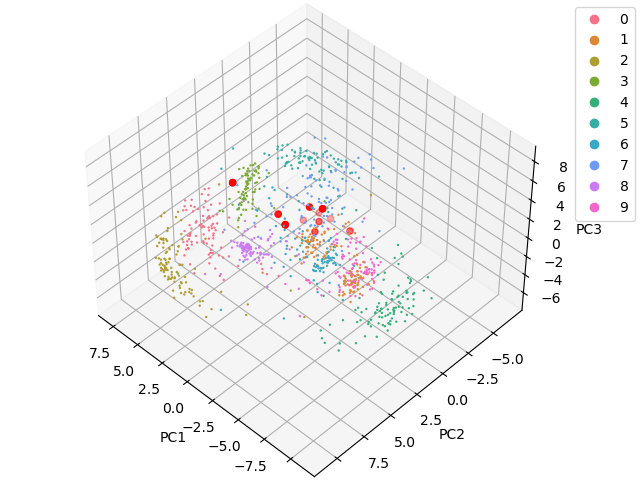

In [24]:
n_hid = 200
n_in = 28
n_out = 10
model = RNN(n_in, n_out, n_hid, lyapunov=False, activation='tanh', save_path='./vanillaRNN').to(device)
load(model.save_path, model)
plot_cloud(model, vanilla_fixed_point_list, single_loader)

43383.00143480184
(56000, 200)
(20, 200)


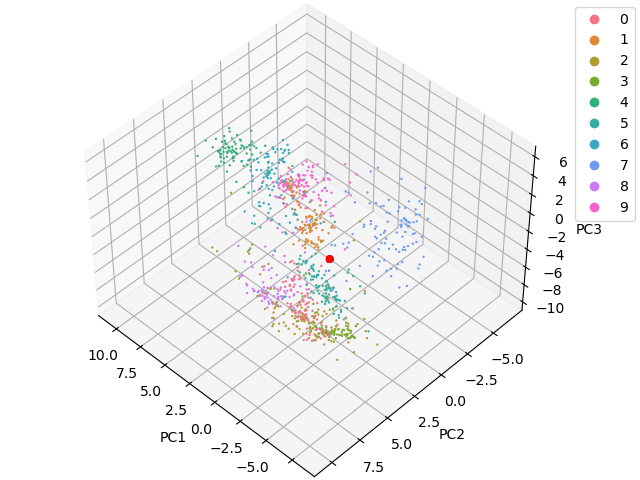

42641.510532134176
(56000, 200)
(20, 200)


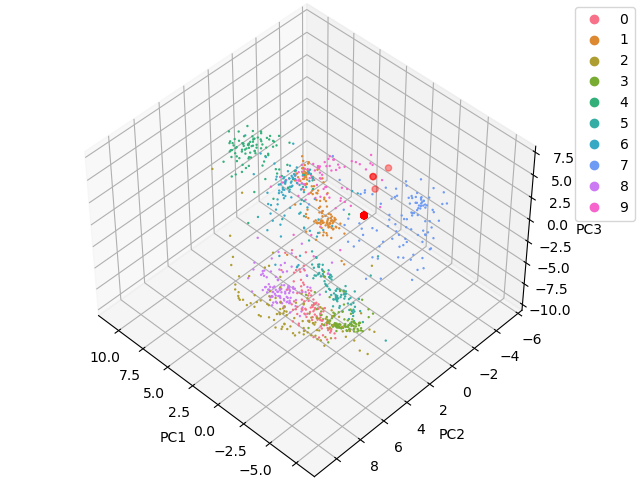

44390.91900208572
(56000, 200)
(20, 200)


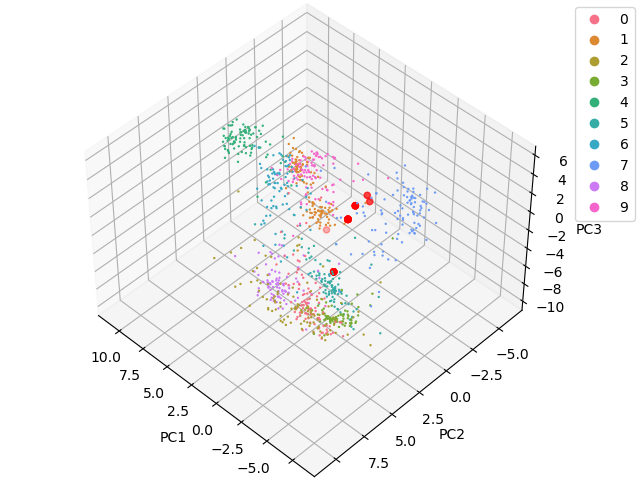

41817.13668372828
(56000, 200)
(20, 200)


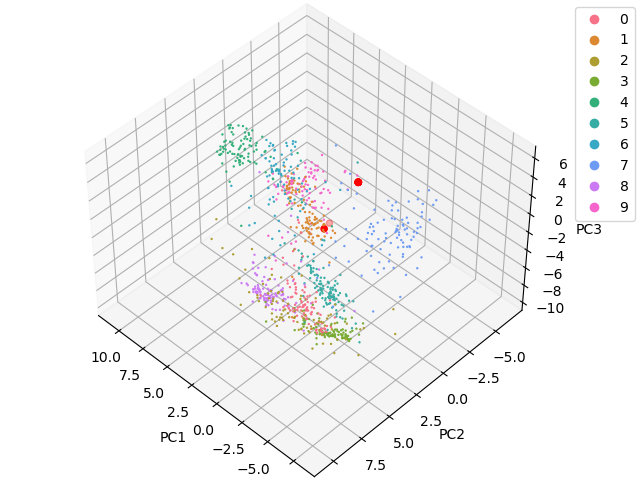

42399.5296658313
(56000, 200)
(20, 200)


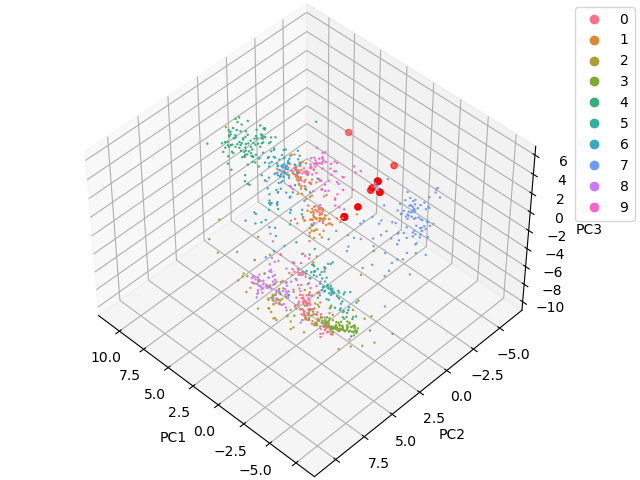

43162.90754512984
(56000, 200)
(20, 200)


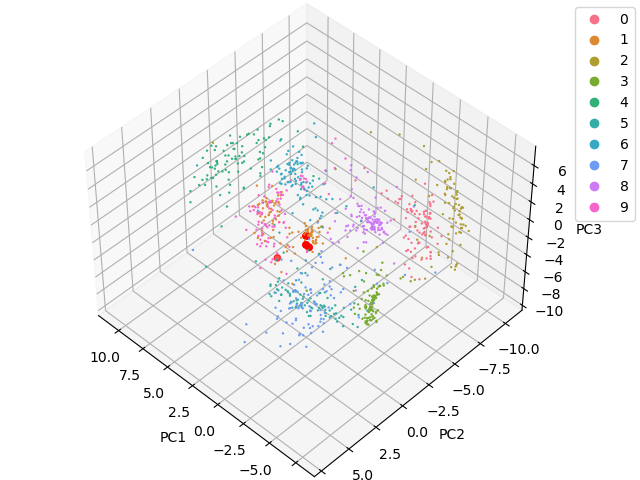

42785.672449094156
(56000, 200)
(20, 200)


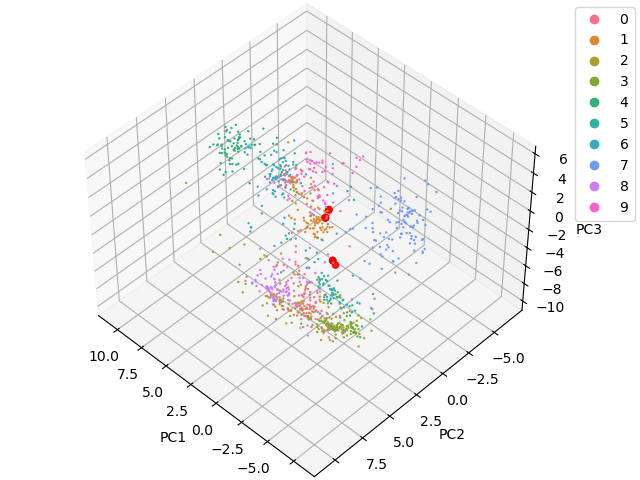

43021.23680974668
(56000, 200)
(20, 200)


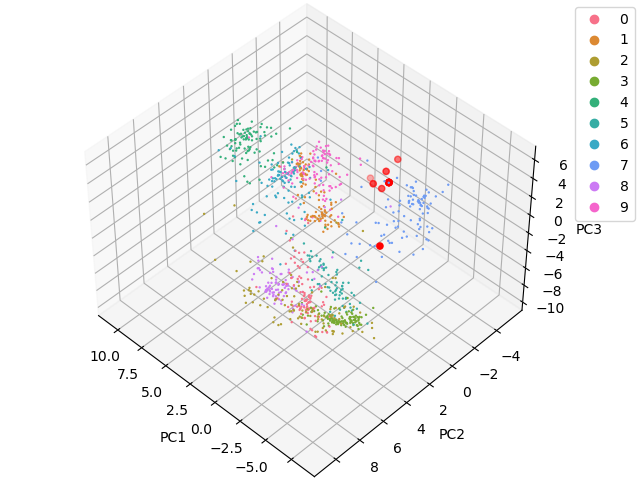

42823.84239145411
(56000, 200)
(20, 200)


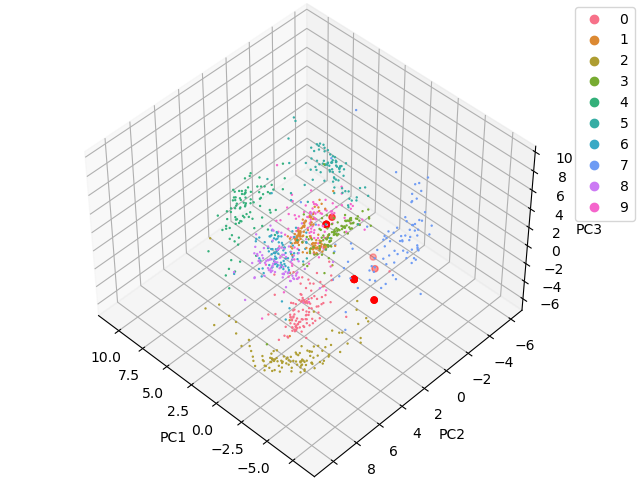

43046.61998281949


C:\Users\sengi\AppData\Local\Temp\ipykernel_8056\4115465635.py:29: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()


(56000, 200)
(20, 200)


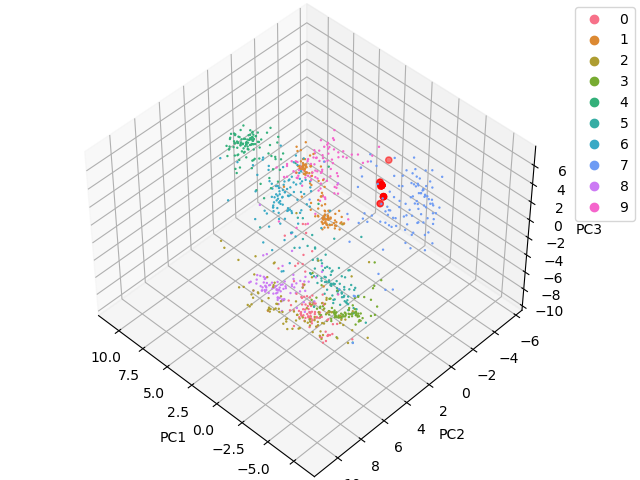

In [33]:
n_hid = 200
n_in = 28
n_out = 10
model = RNN(n_in, n_out, n_hid, lyapunov=False, activation='tanh', save_path='./vanillaRNN').to(device)
load(model.save_path, model)
for i in range(10):
    plot_cloud(model, vanilla_single_fixed_point_list_list[i], single_loader, use_digit=i)

In [ ]:
n_hid = 200
n_in = 28
n_out = 10
model = LstmModel(n_in, n_hid, n_out).to(device)
load(model.save_path, model)
plot_cloud(model, lstm_fixed_point_list, single_loader)

RNN(
  (w_in): Linear(in_features=1, out_features=200, bias=True)
  (w_hh): Linear(in_features=200, out_features=200, bias=True)
  (w_out): Linear(in_features=200, out_features=1, bias=True)
  (loss_fn): CrossEntropyLoss()
)
Train Epoch: 5, Loss: 0.026981


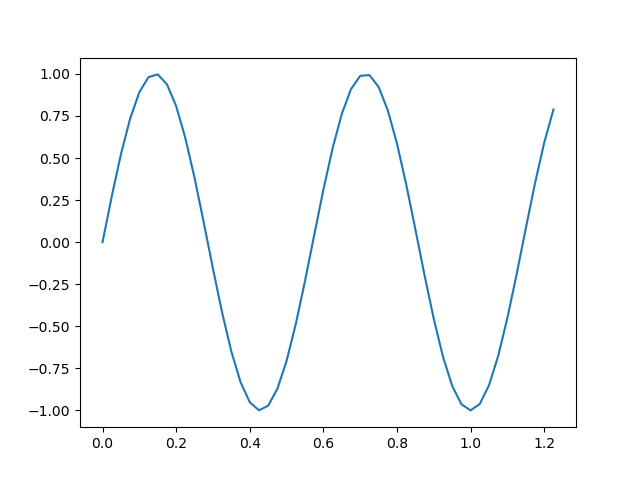

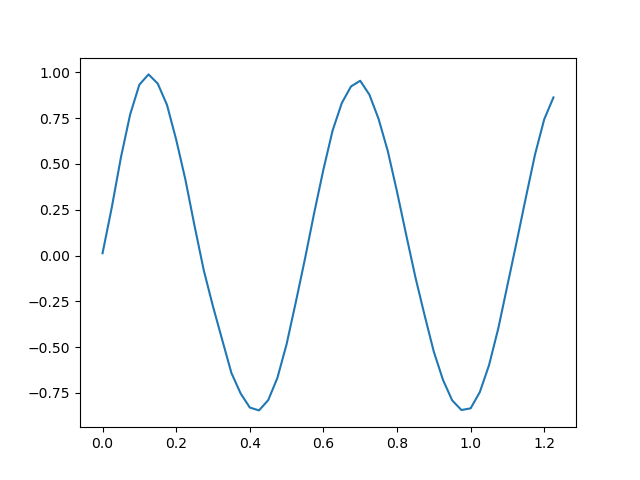

Train Epoch: 10, Loss: 0.004026


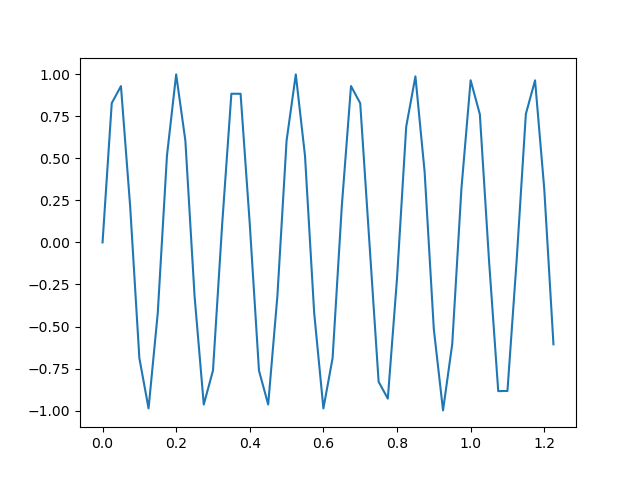

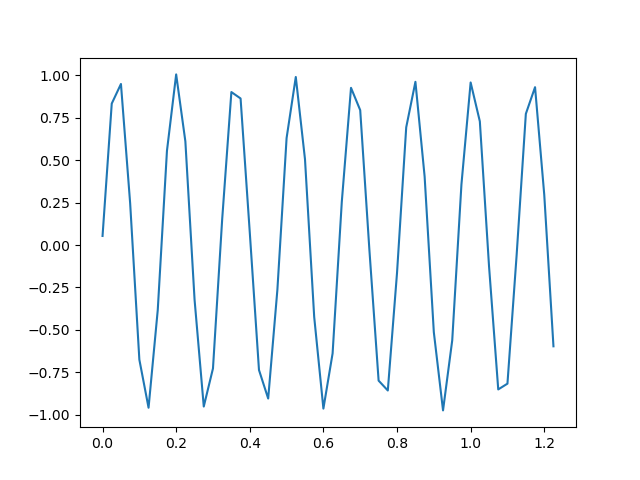

Train Epoch: 15, Loss: 0.001292


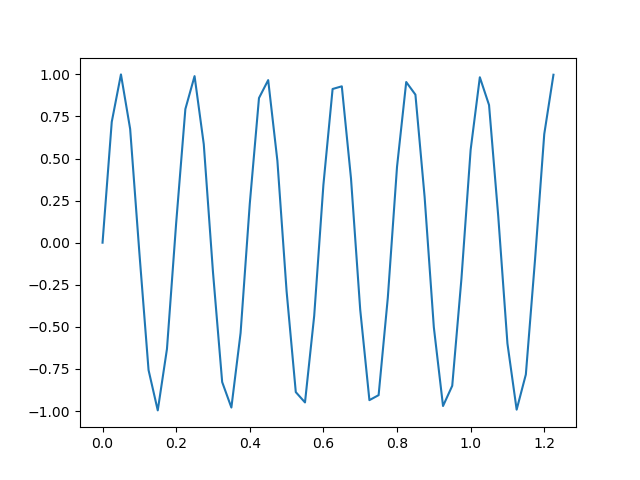

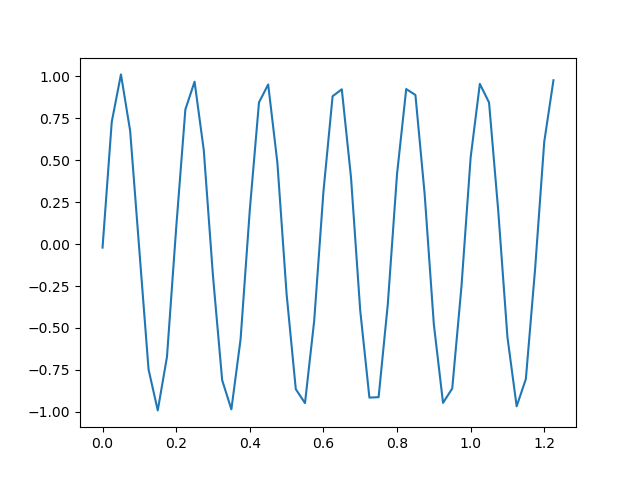

Train Epoch: 20, Loss: 0.000506


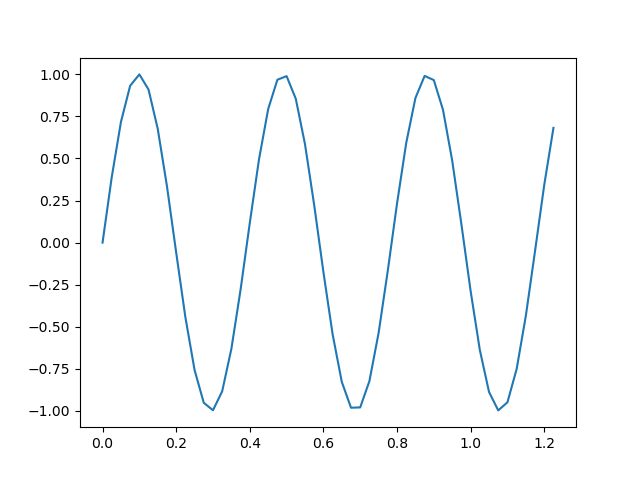

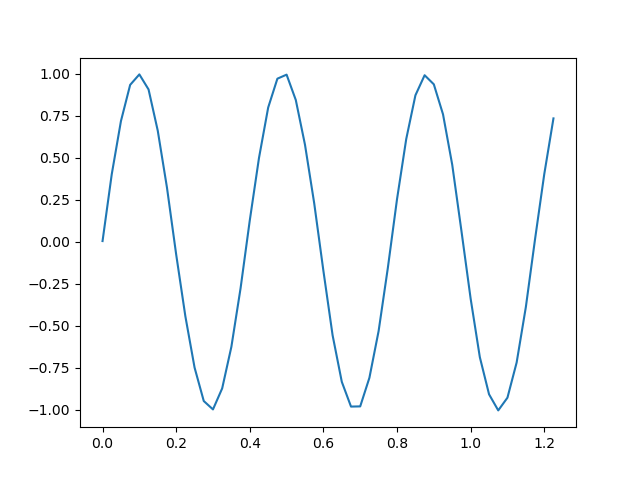

Train Epoch: 25, Loss: 0.000136


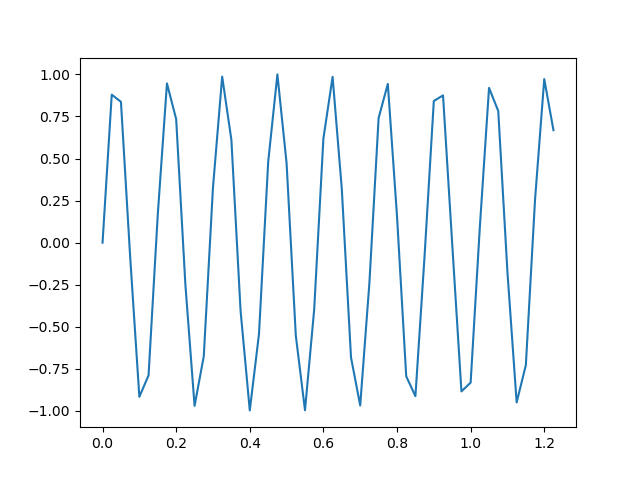

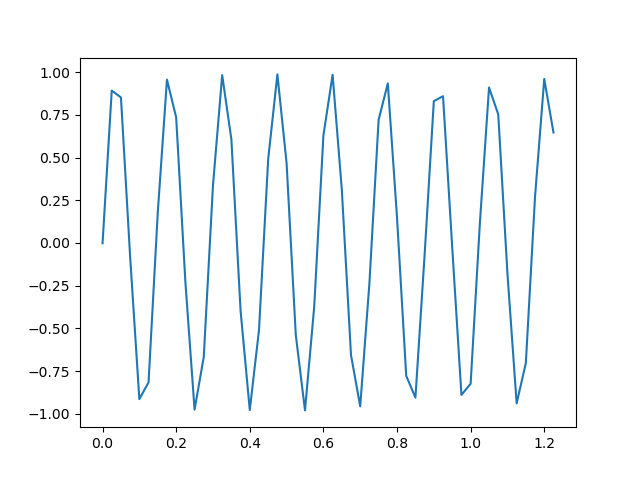

Train Epoch: 30, Loss: 0.000140


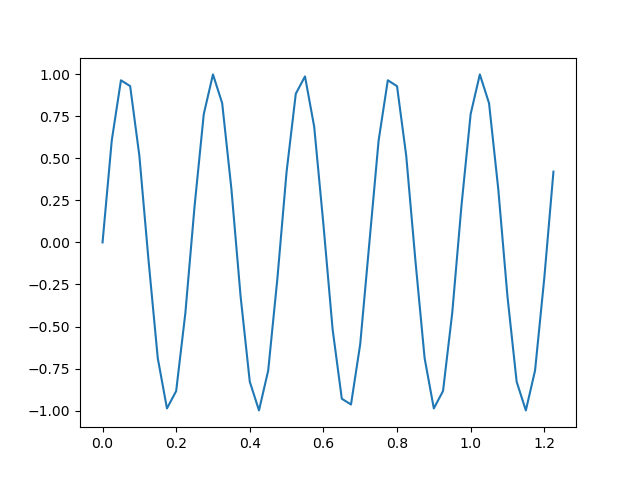

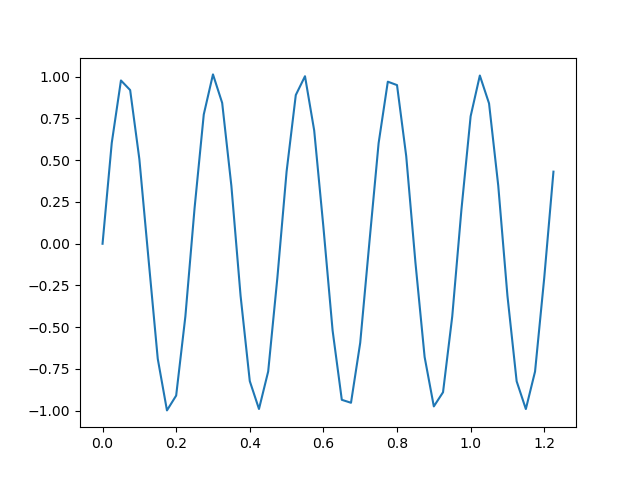

Train Epoch: 35, Loss: 0.000109


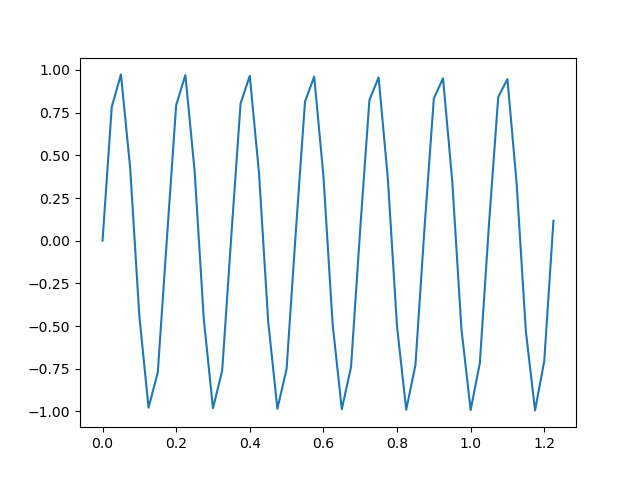

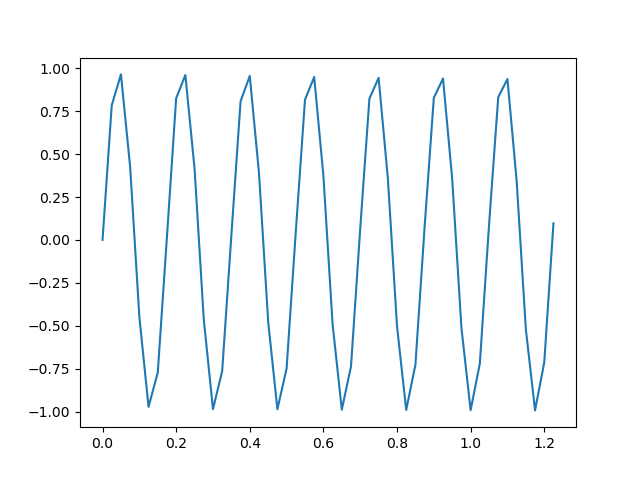

Train Epoch: 40, Loss: 0.000097


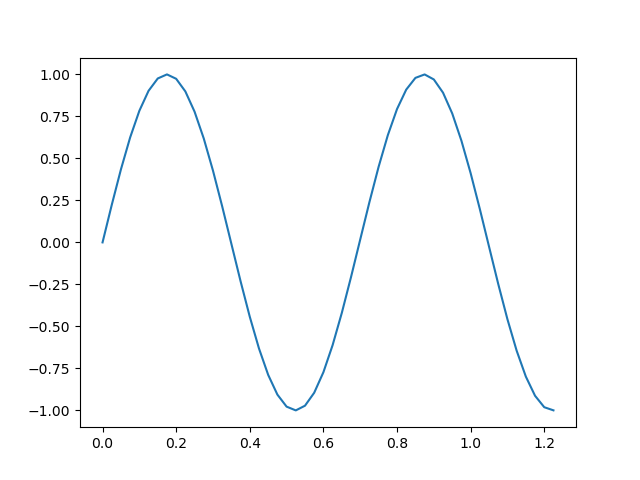

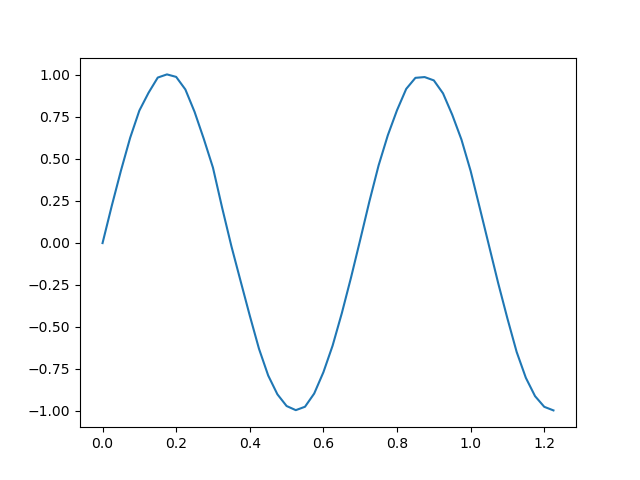

Train Epoch: 45, Loss: 0.000114


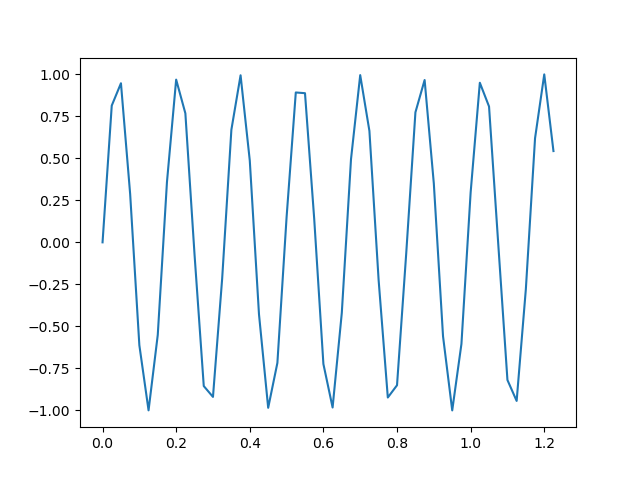

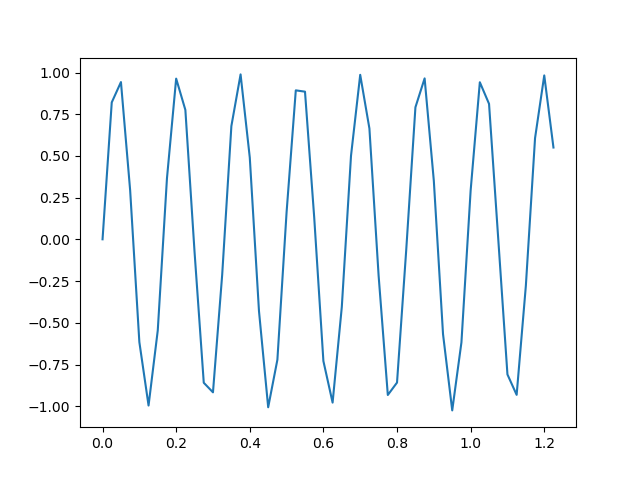

Train Epoch: 50, Loss: 0.000090


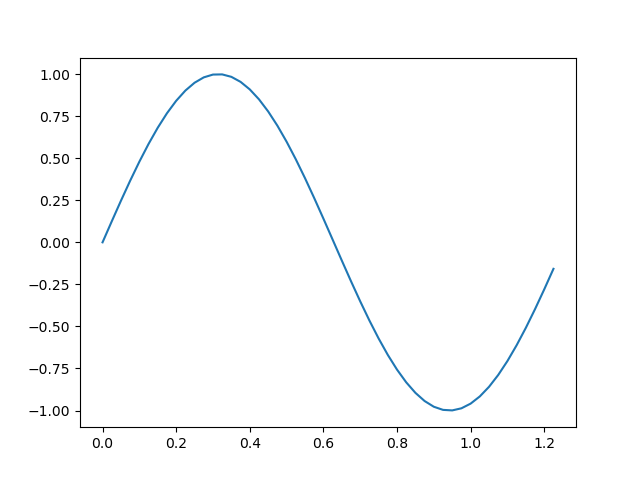

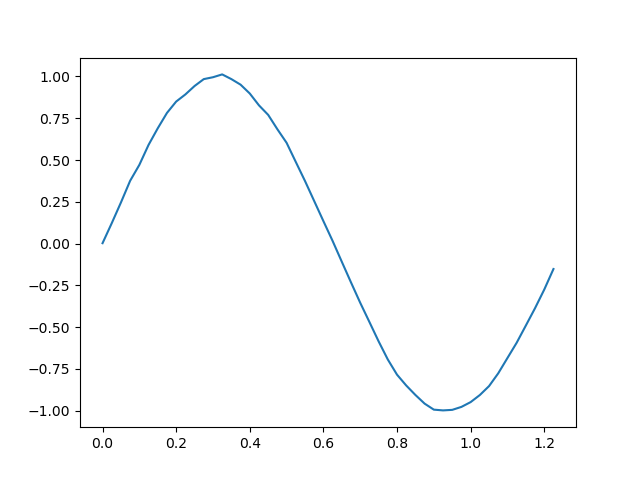

Train Epoch: 55, Loss: 0.000093


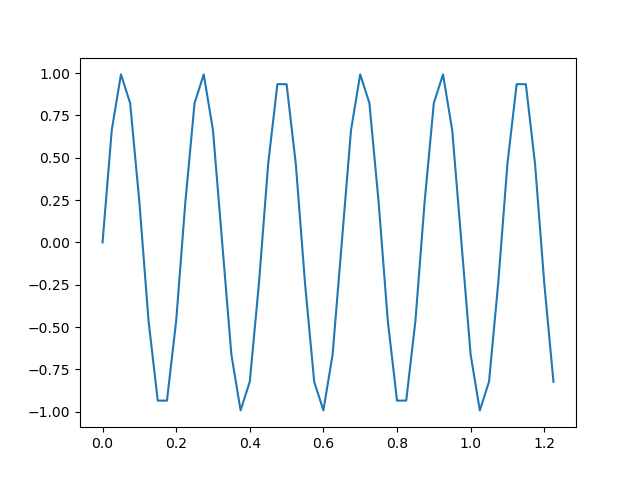

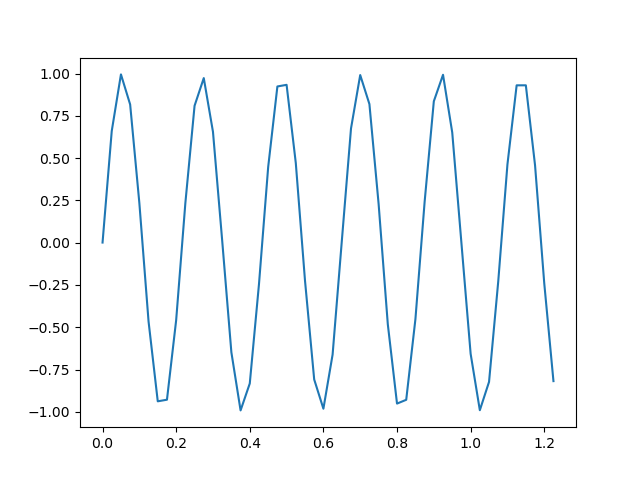

Train Epoch: 60, Loss: 0.000078


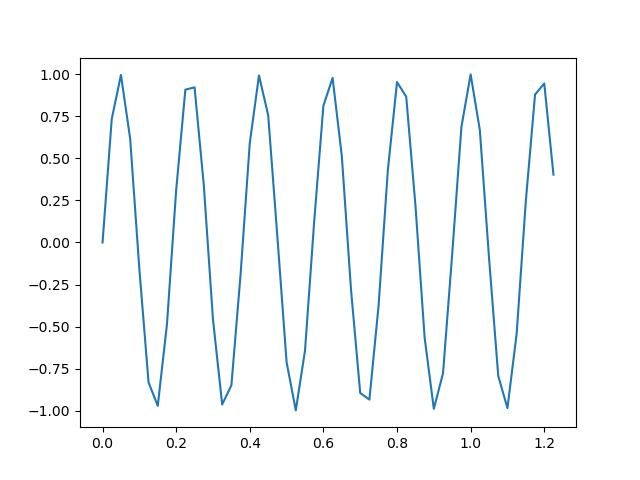

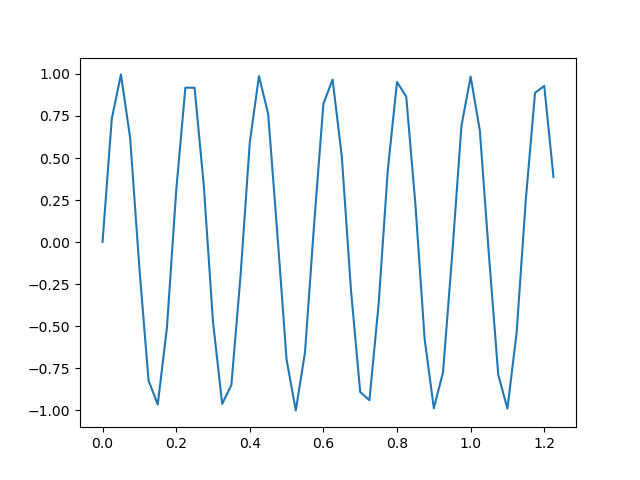

Train Epoch: 65, Loss: 0.000078


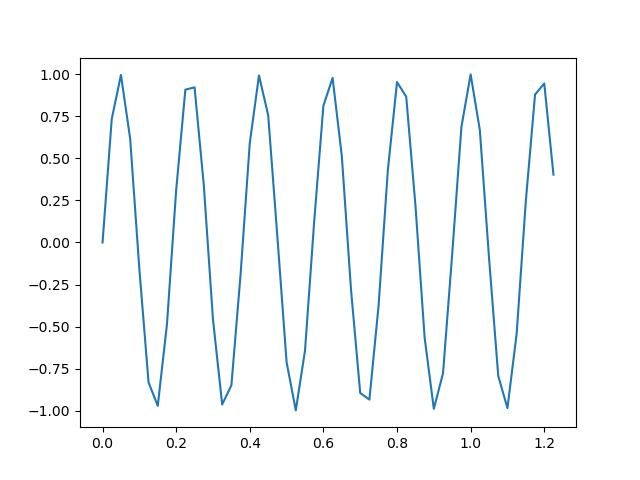

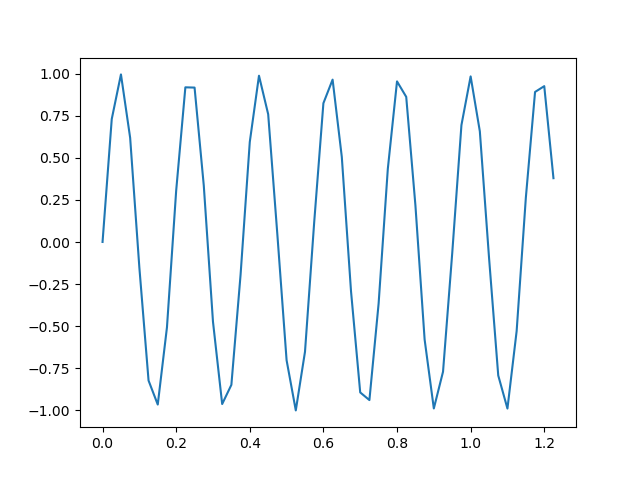

Train Epoch: 70, Loss: 0.000077


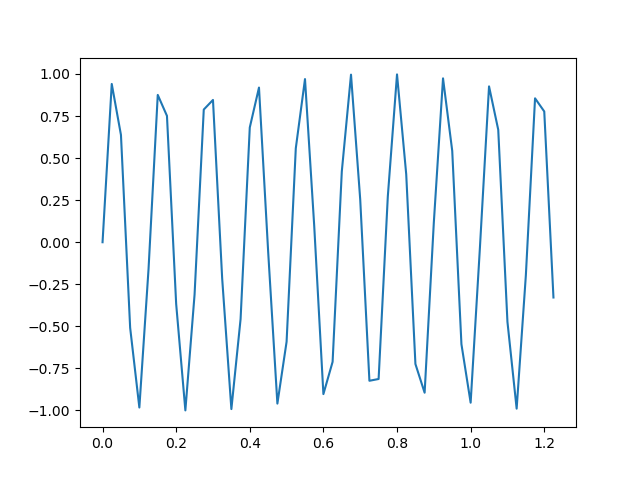

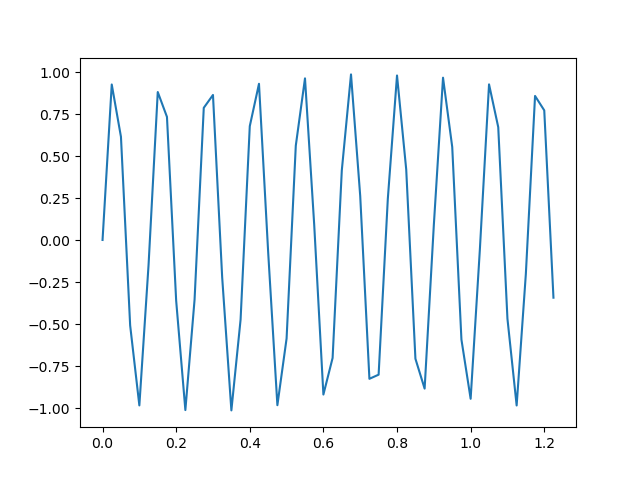

Train Epoch: 75, Loss: 0.000070


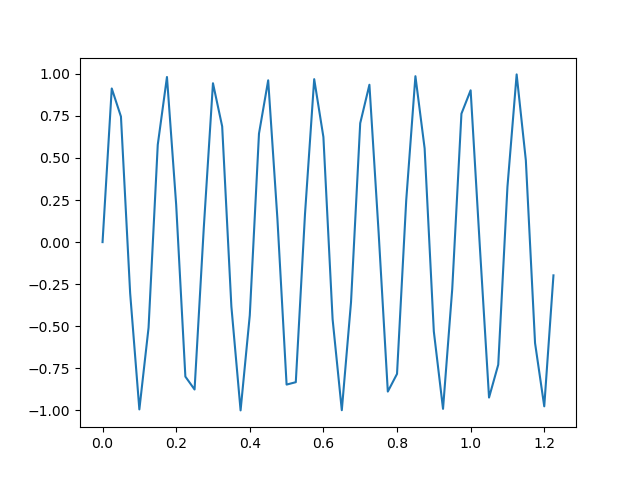

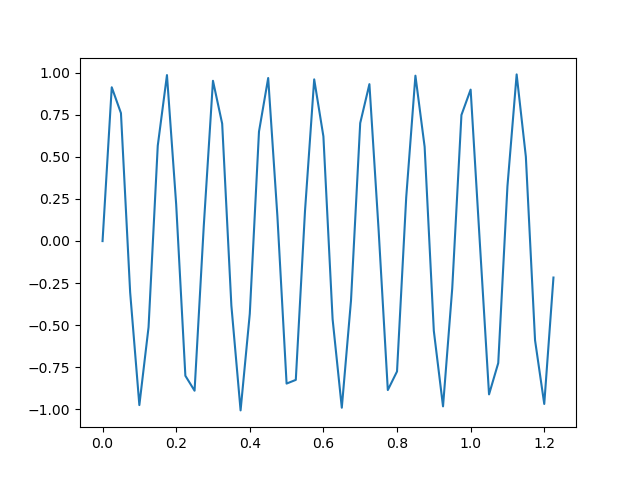

Train Epoch: 80, Loss: 0.000071


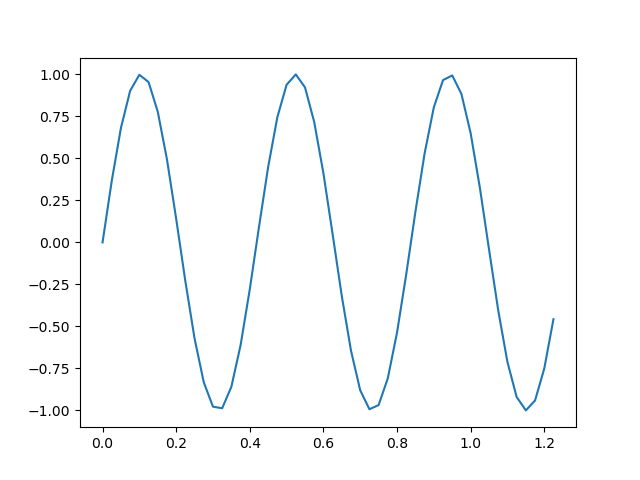

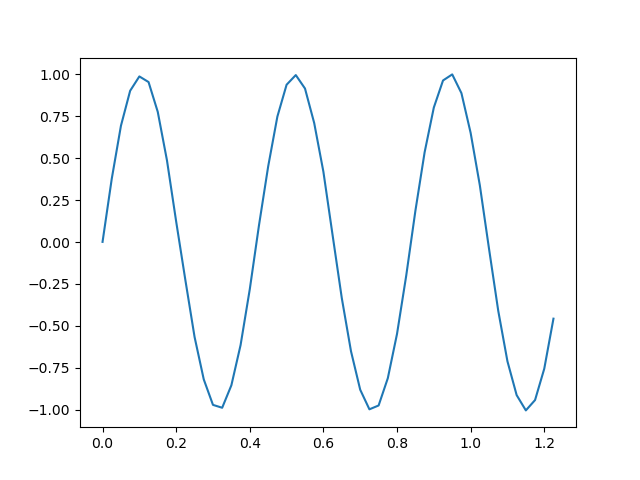

Train Epoch: 85, Loss: 0.000069


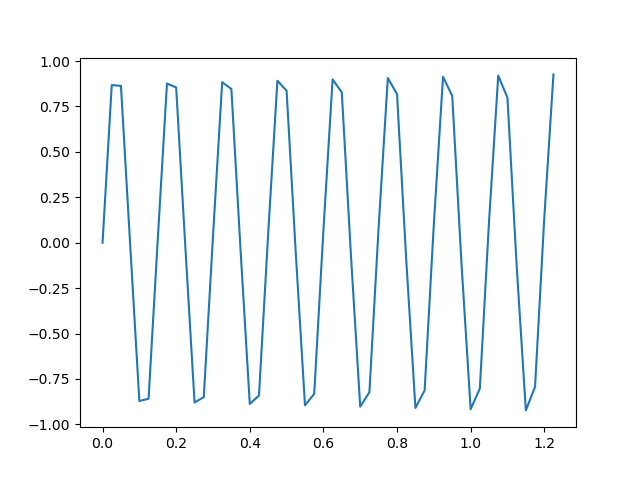

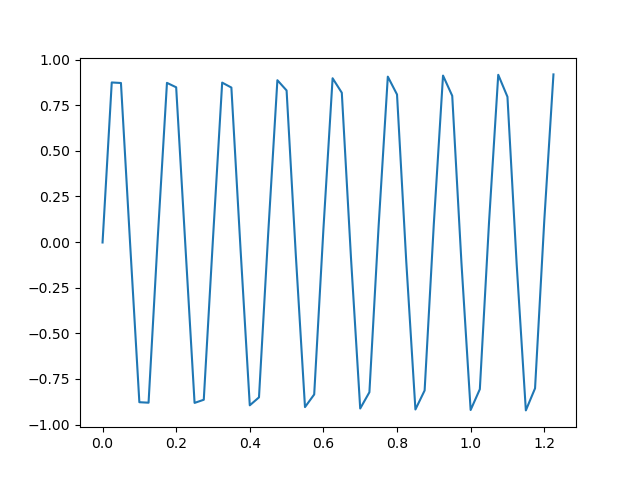

Train Epoch: 90, Loss: 0.000063


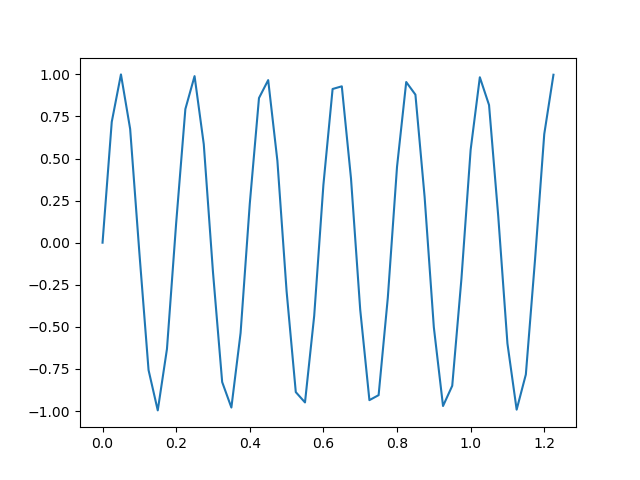

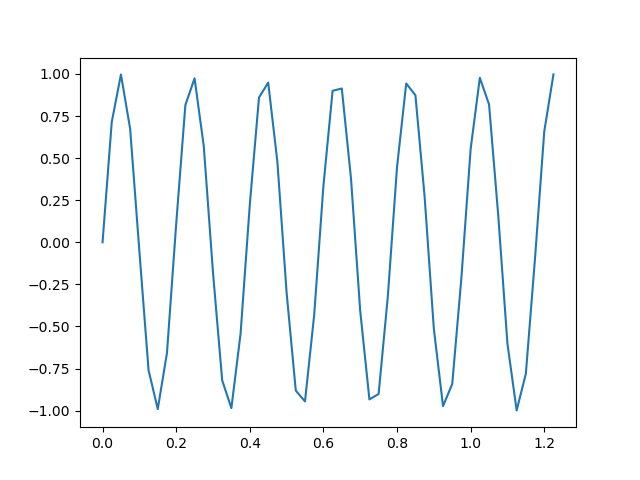

Train Epoch: 95, Loss: 0.000066


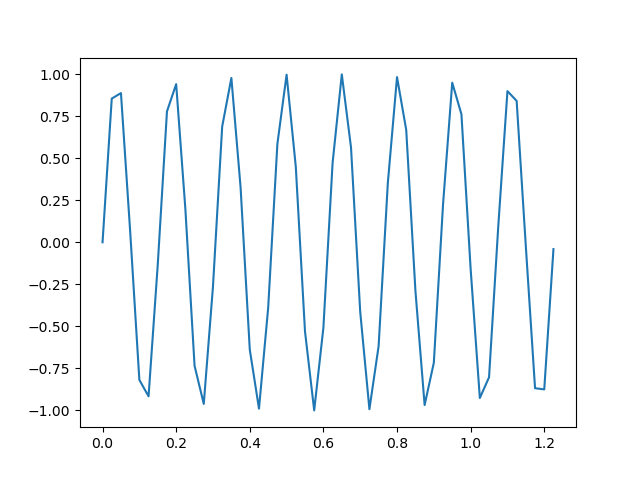

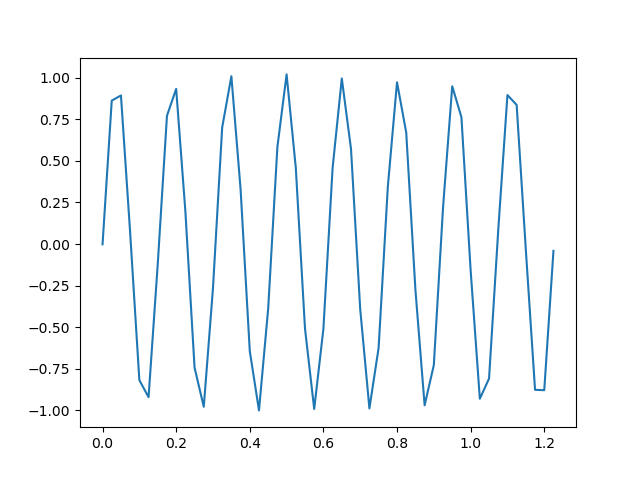

Train Epoch: 100, Loss: 0.000063


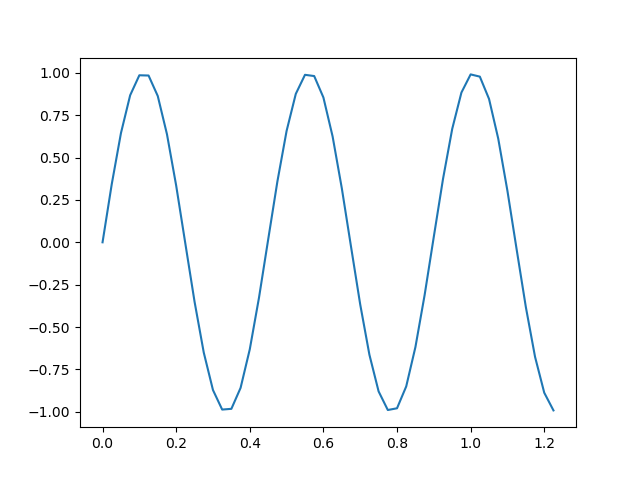

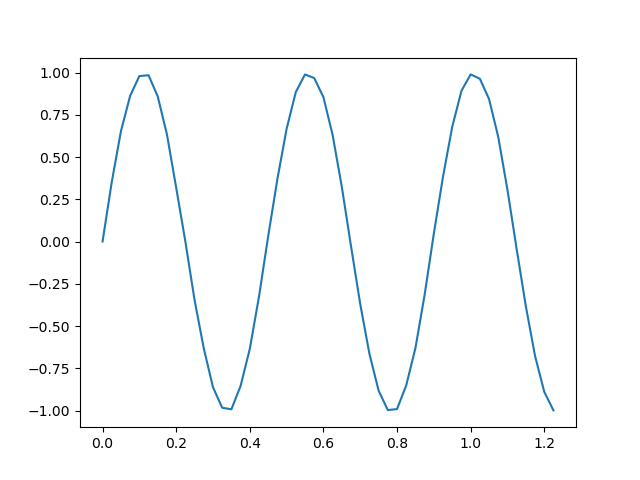

Train Epoch: 105, Loss: 0.000062


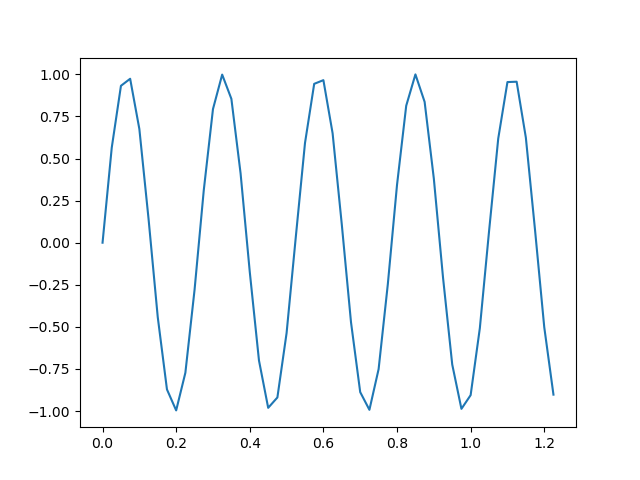

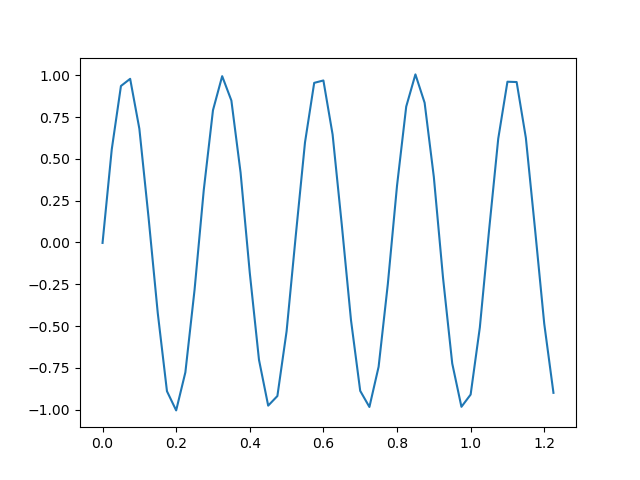

Train Epoch: 110, Loss: 0.000067


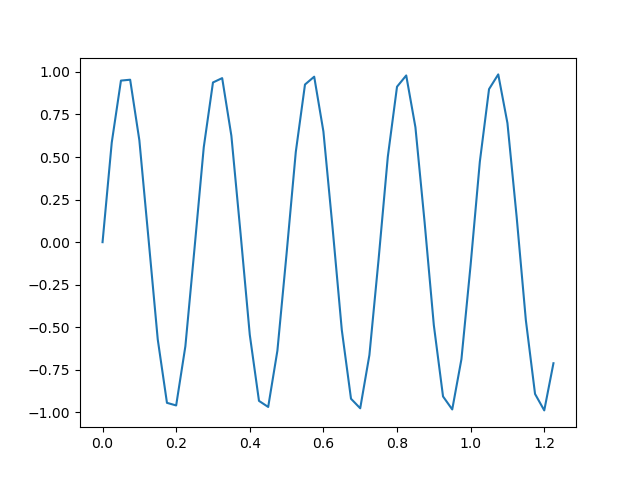

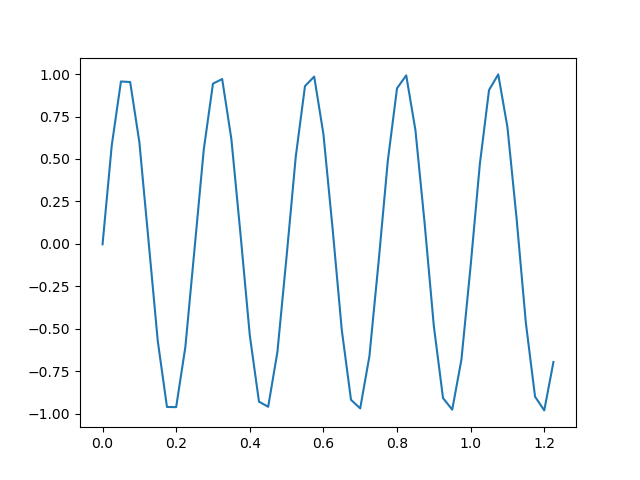

Train Epoch: 115, Loss: 0.000076


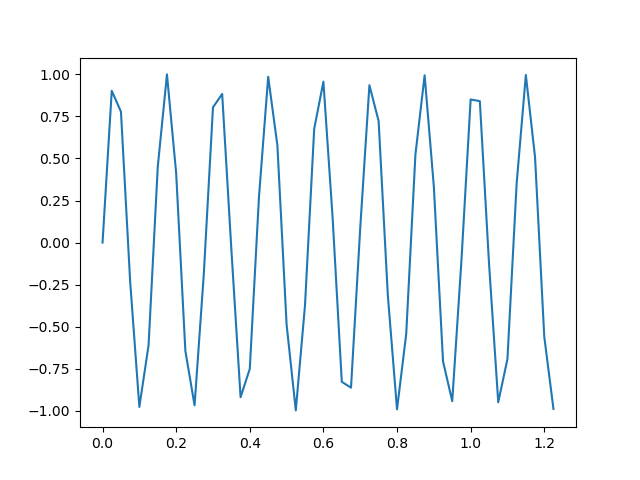

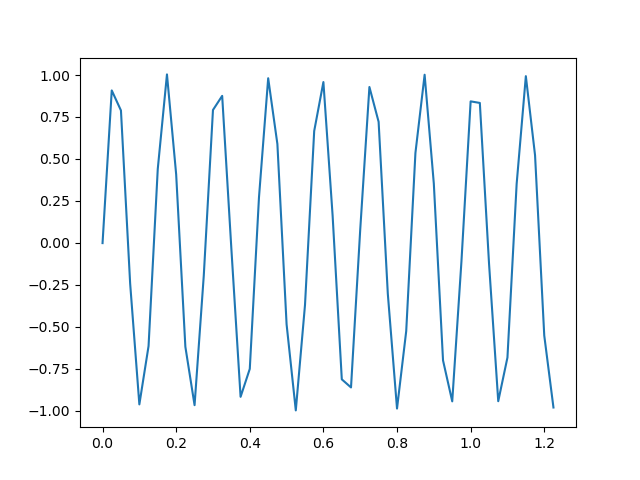

Train Epoch: 120, Loss: 0.000087


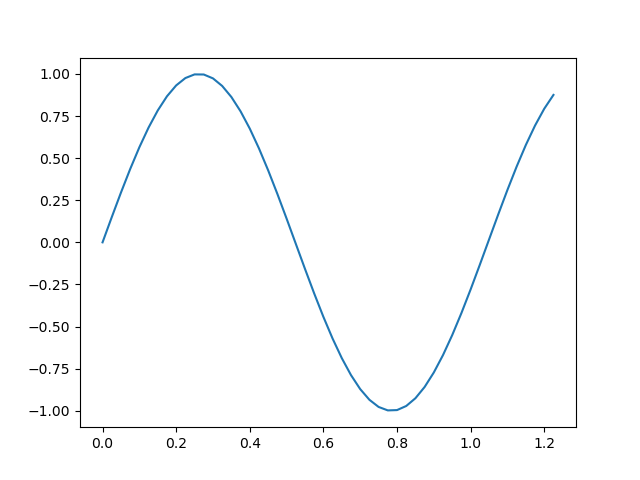

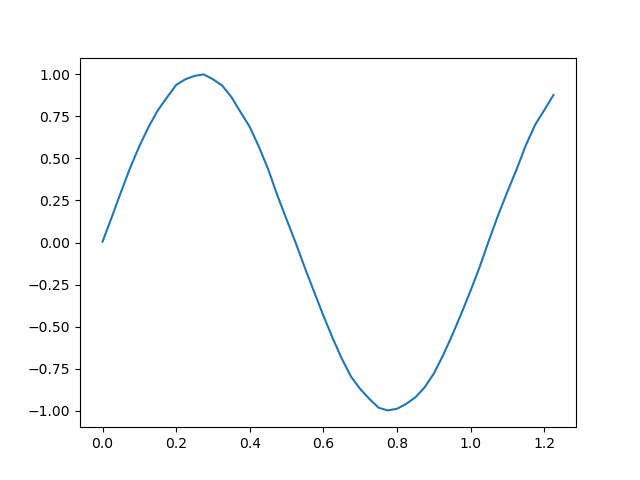

Train Epoch: 125, Loss: 0.000314


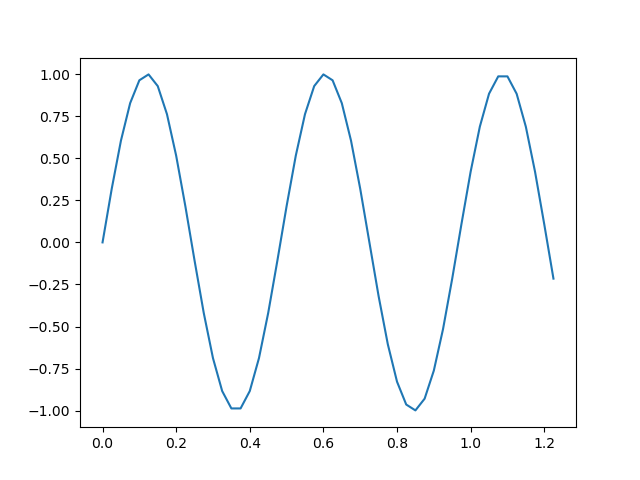

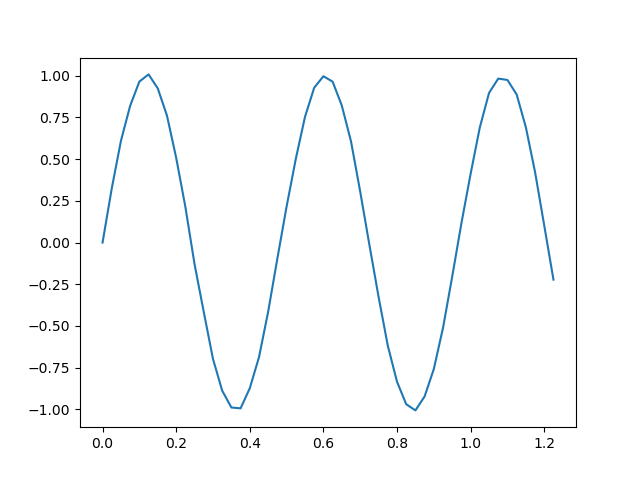

Train Epoch: 130, Loss: 0.000185


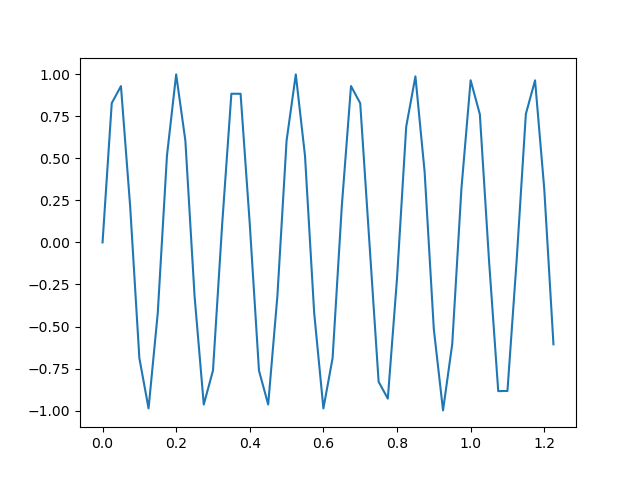

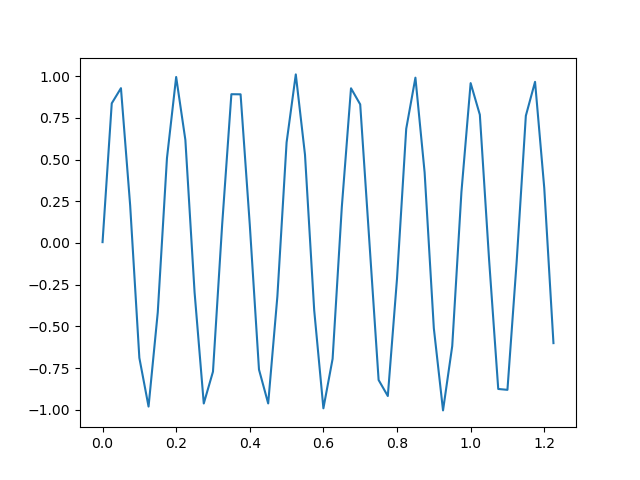

Train Epoch: 135, Loss: 0.000099


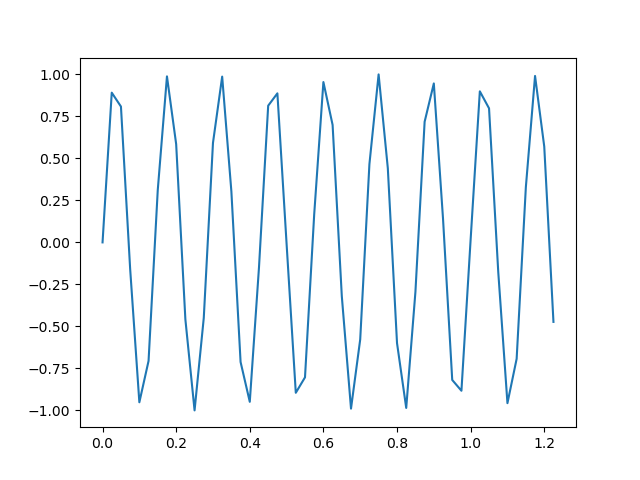

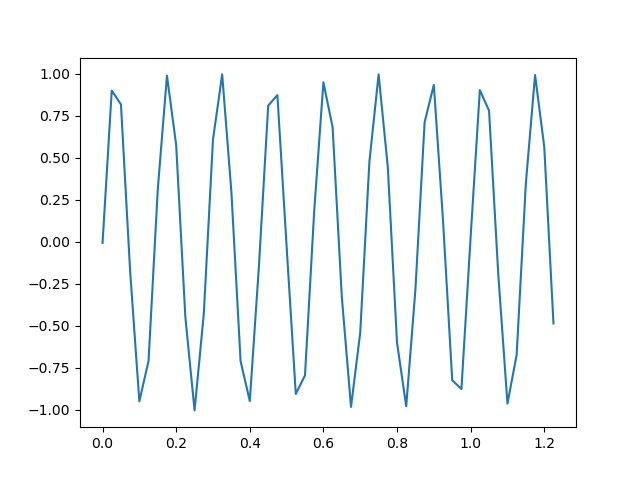

Train Epoch: 140, Loss: 0.000156


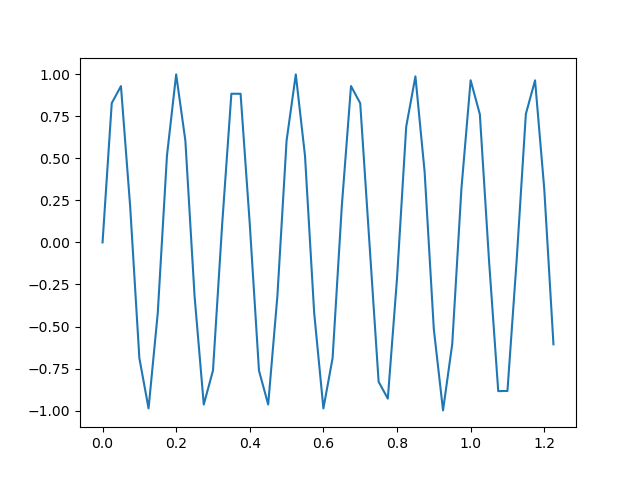

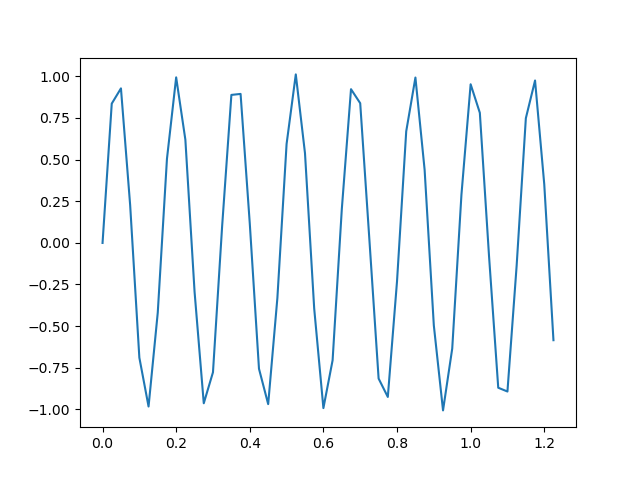

Train Epoch: 145, Loss: 0.000172


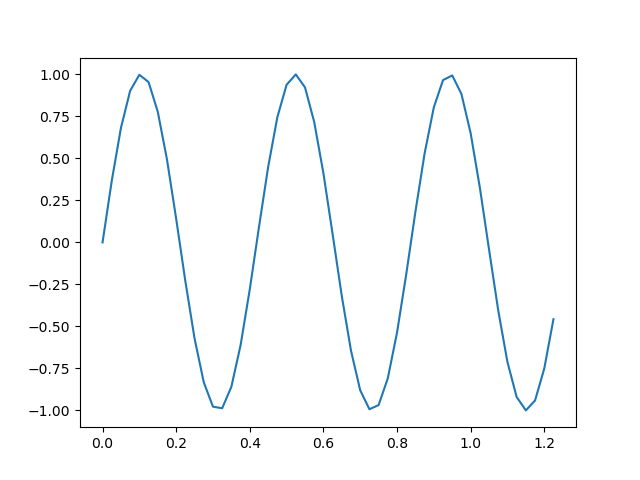

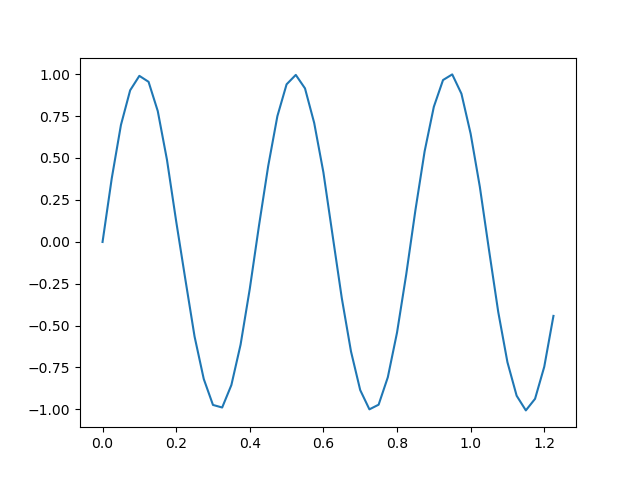

Train Epoch: 150, Loss: 0.000210


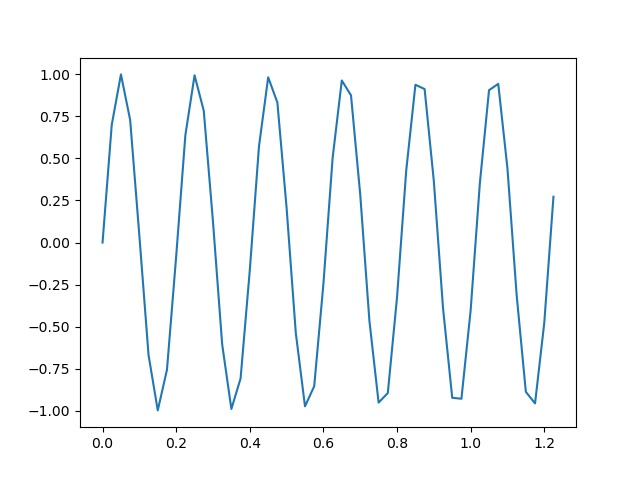

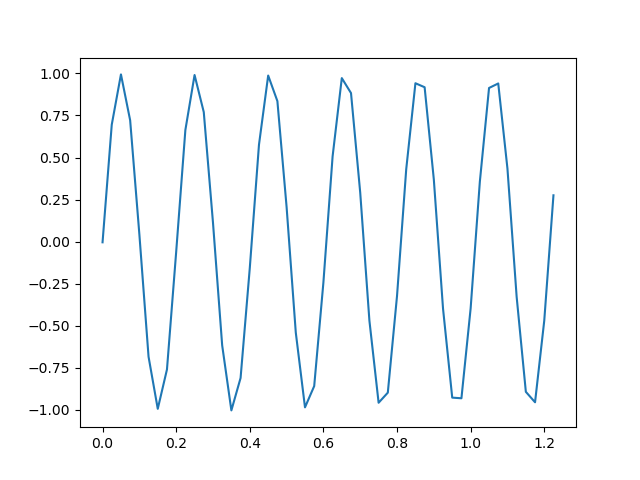

Train Epoch: 155, Loss: 0.000572


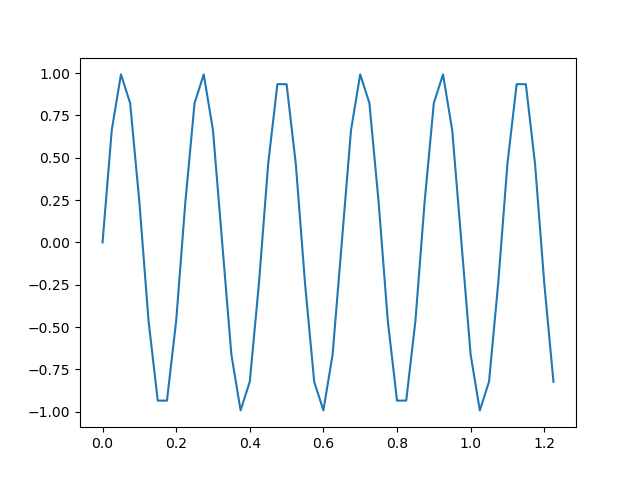

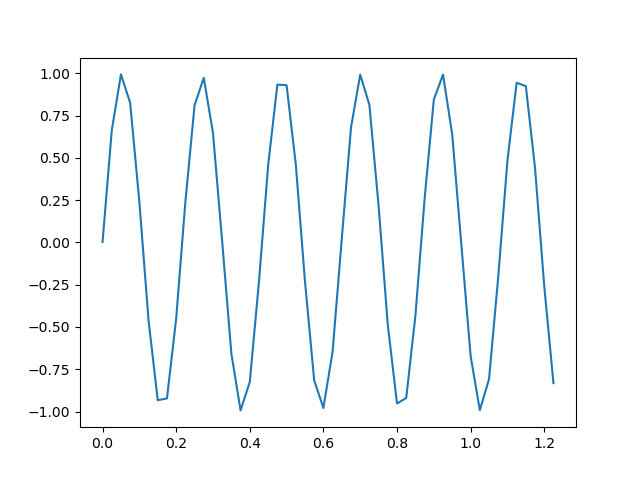

Train Epoch: 160, Loss: 0.000955


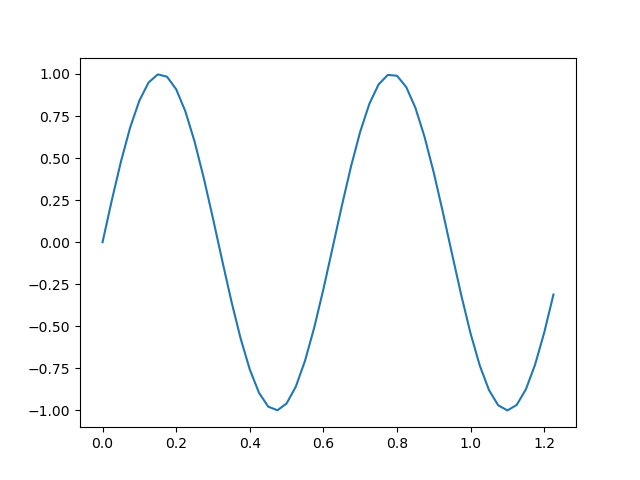

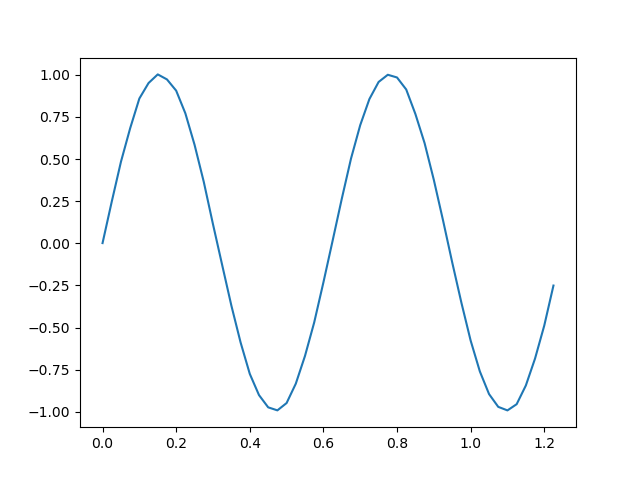

Train Epoch: 165, Loss: 0.001112


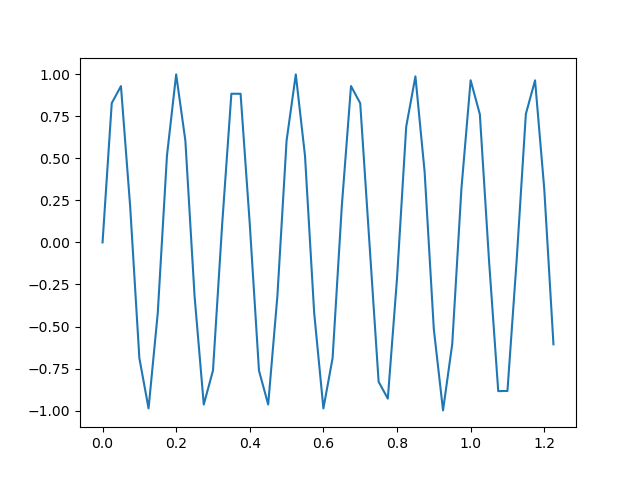

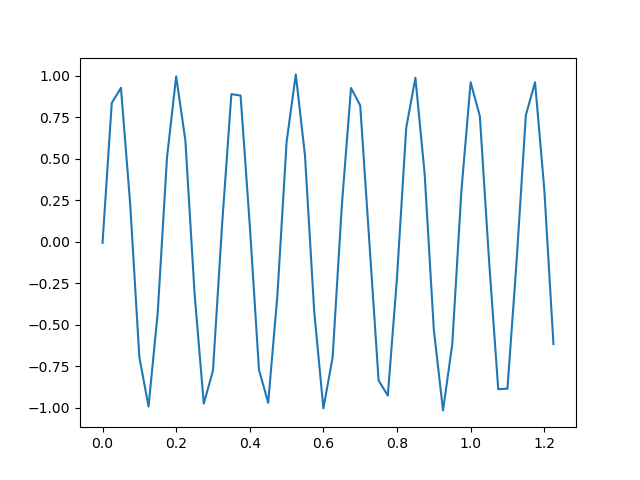

Train Epoch: 170, Loss: 0.000541


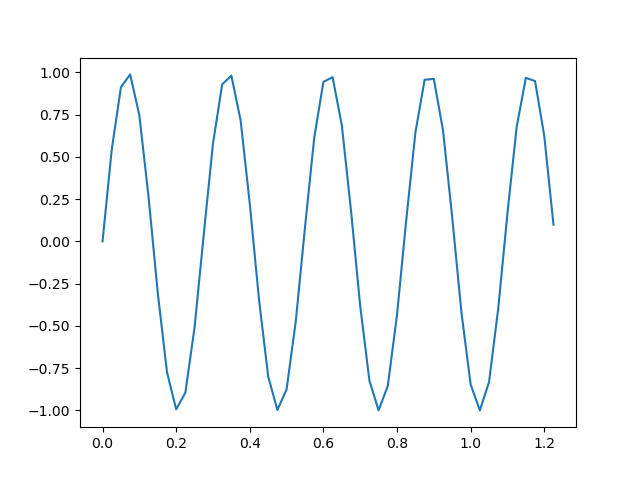

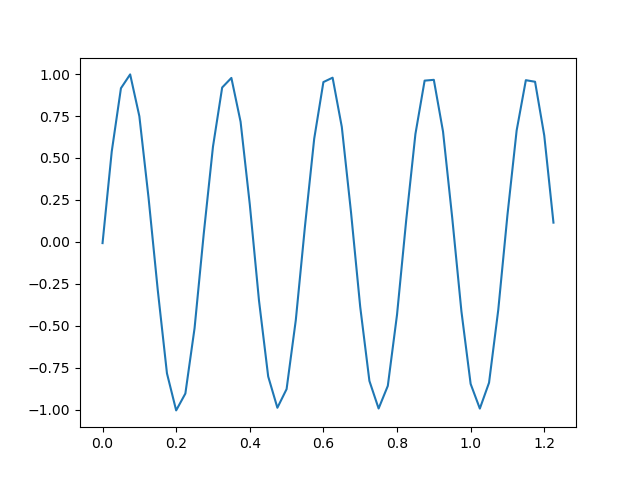

Train Epoch: 175, Loss: 0.000958


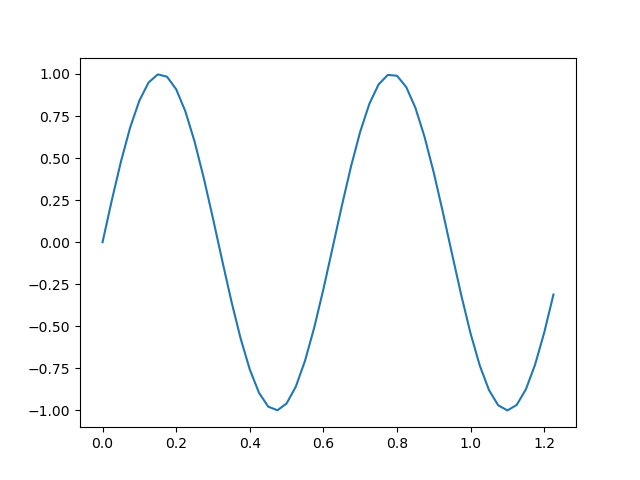

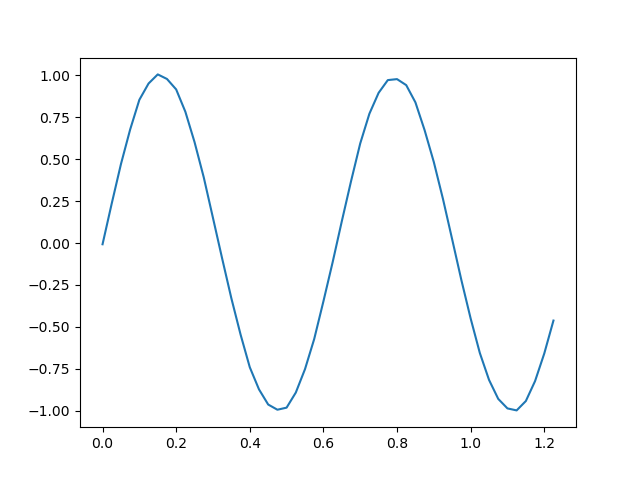

Train Epoch: 180, Loss: 0.000267


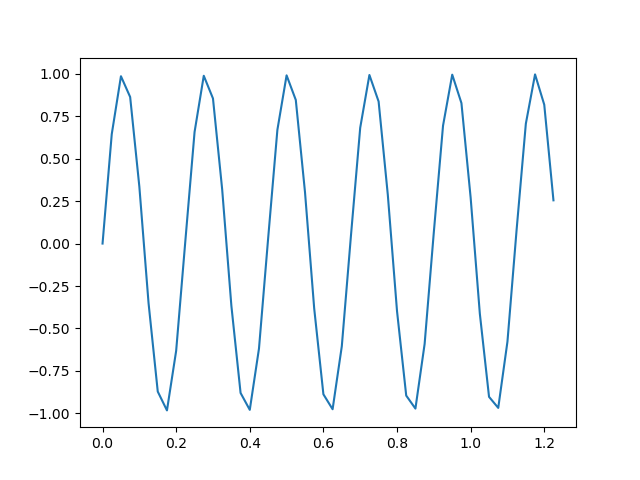

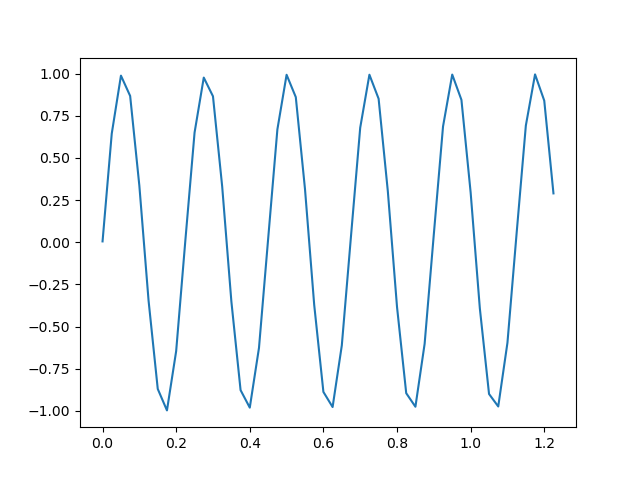

Train Epoch: 185, Loss: 0.000212


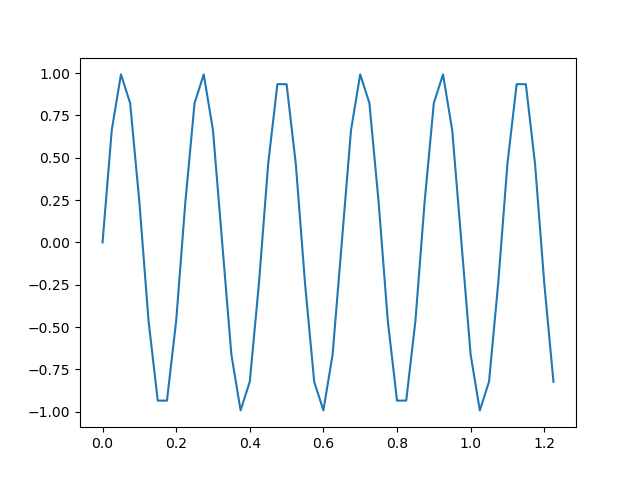

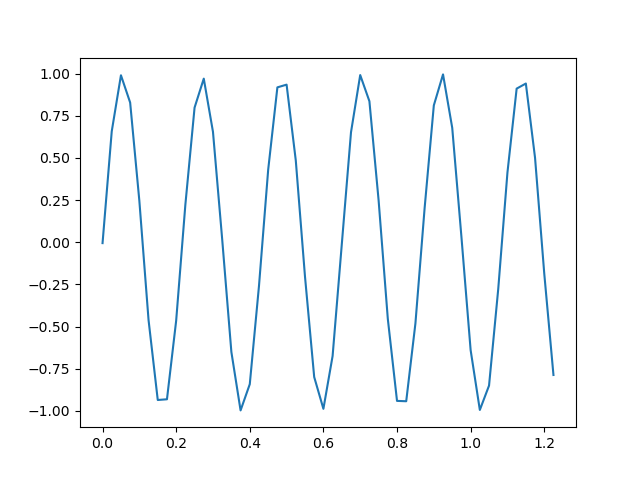

Train Epoch: 190, Loss: 0.000099


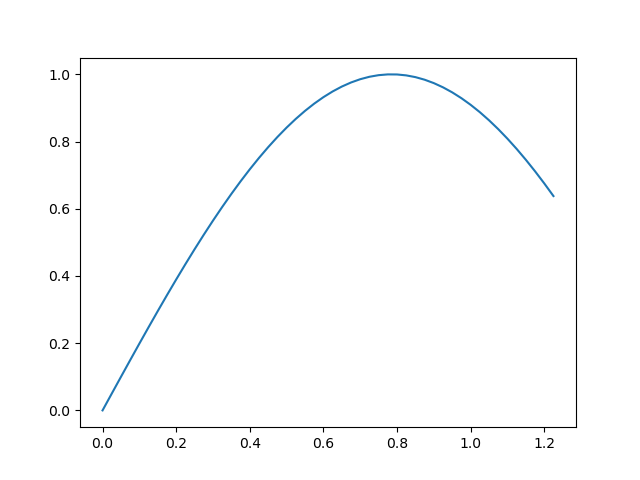

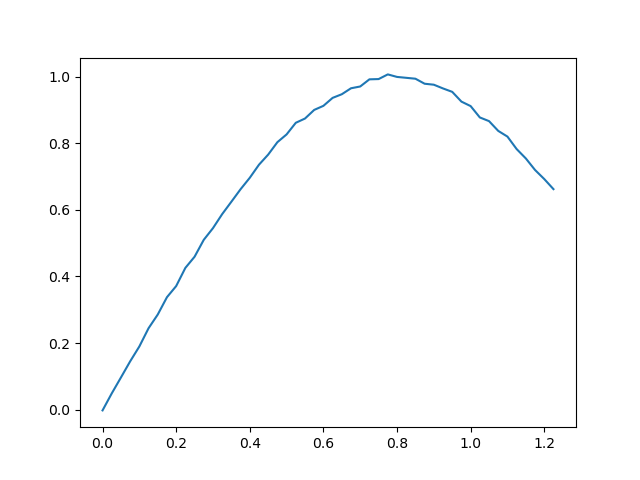

Train Epoch: 195, Loss: 0.000062


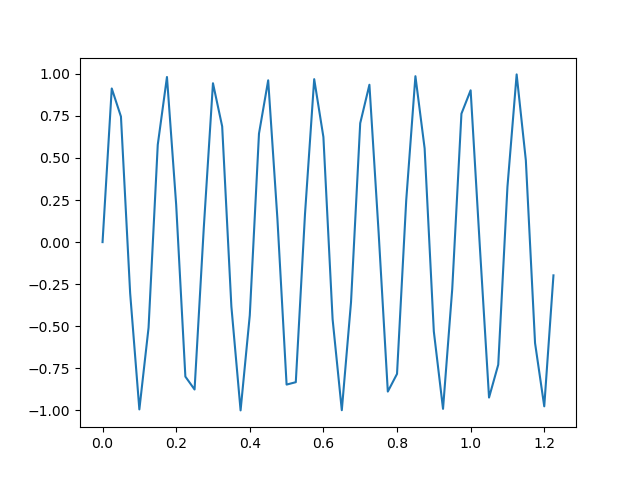

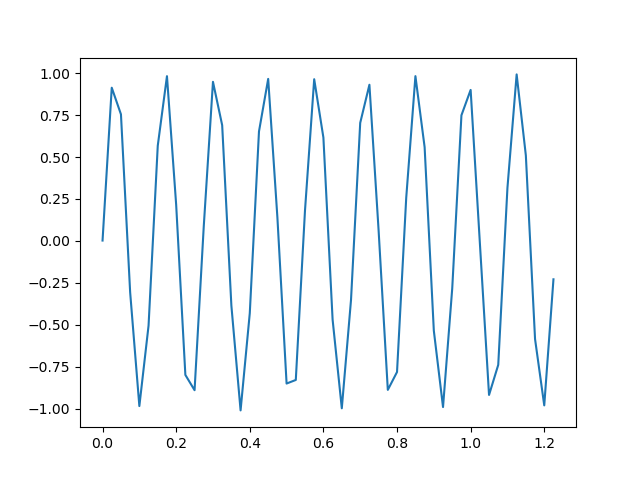

Train Epoch: 200, Loss: 0.000068


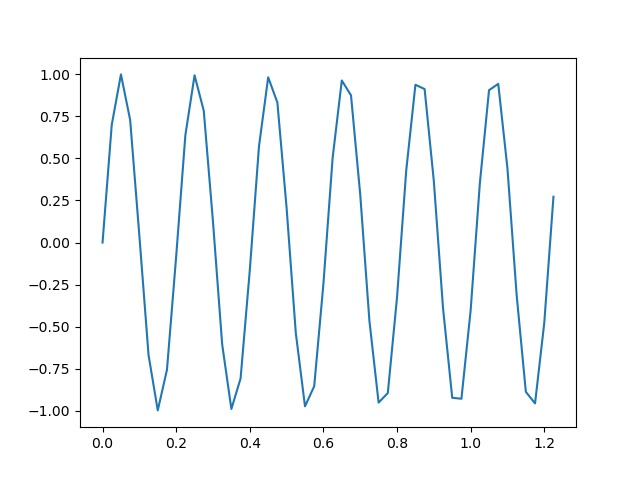

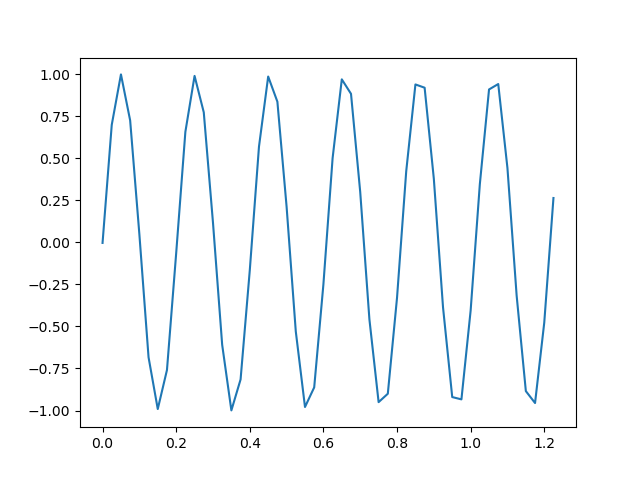

Train Epoch: 205, Loss: 0.000058


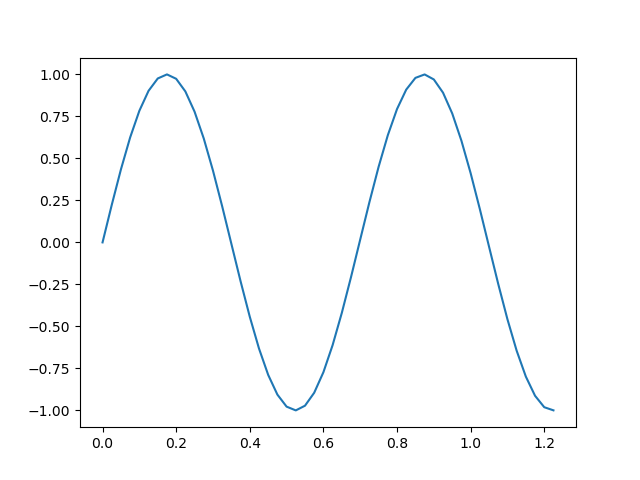

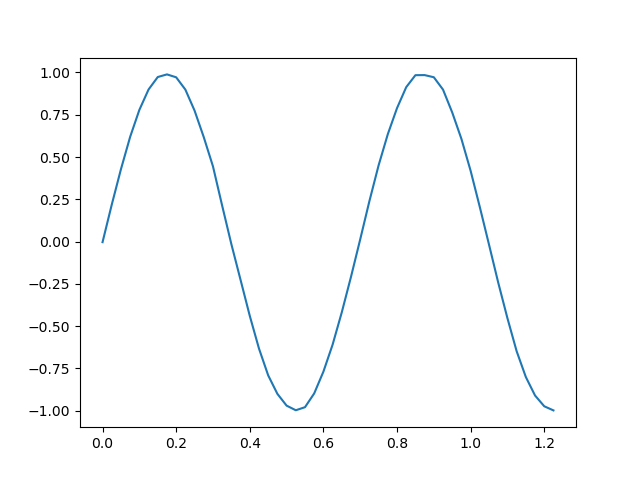

Train Epoch: 210, Loss: 0.000099


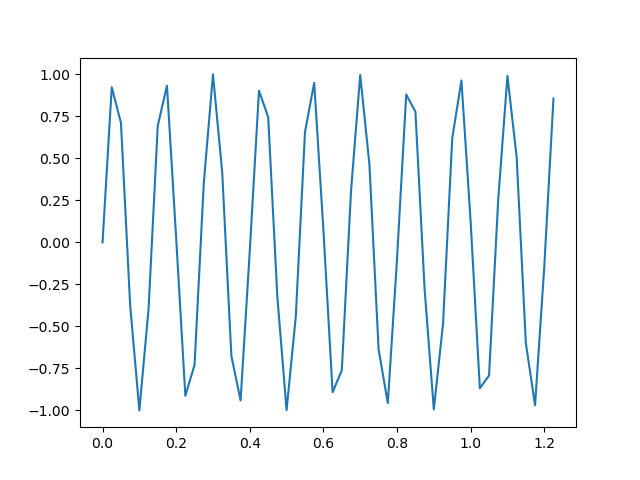

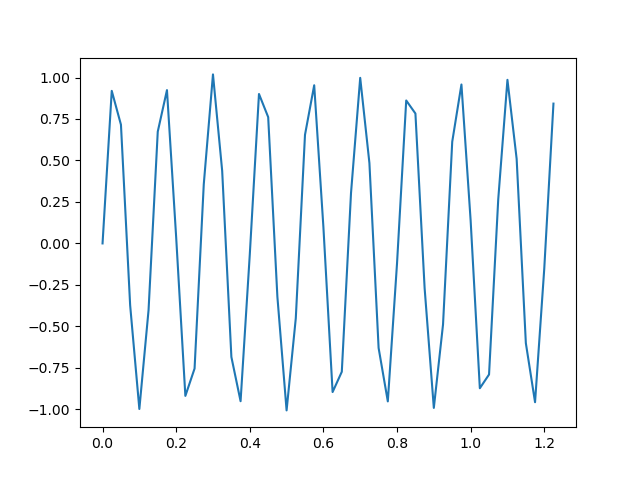

Train Epoch: 215, Loss: 0.000103


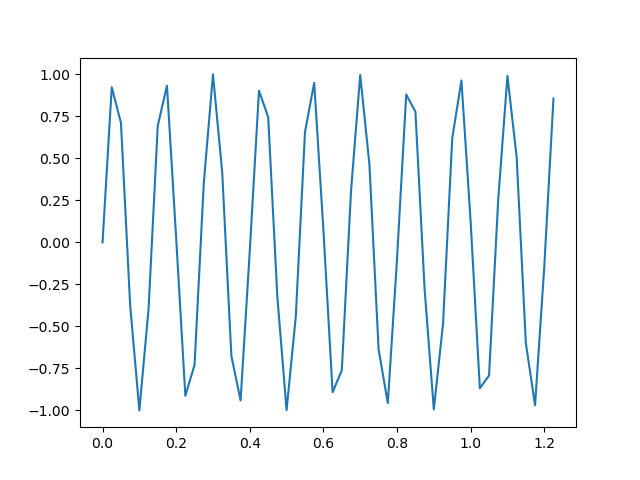

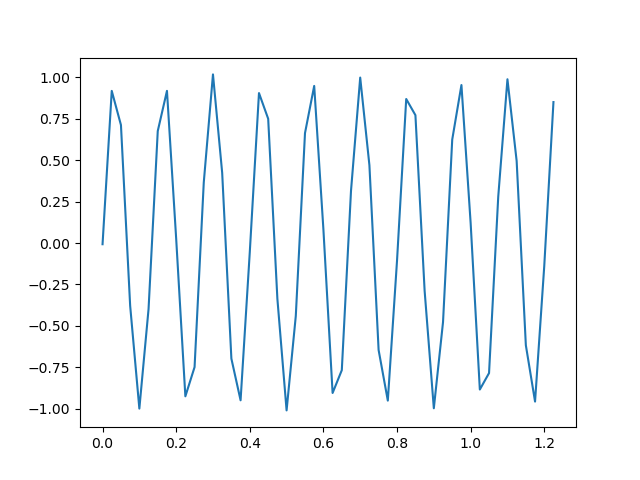

Train Epoch: 220, Loss: 0.000058


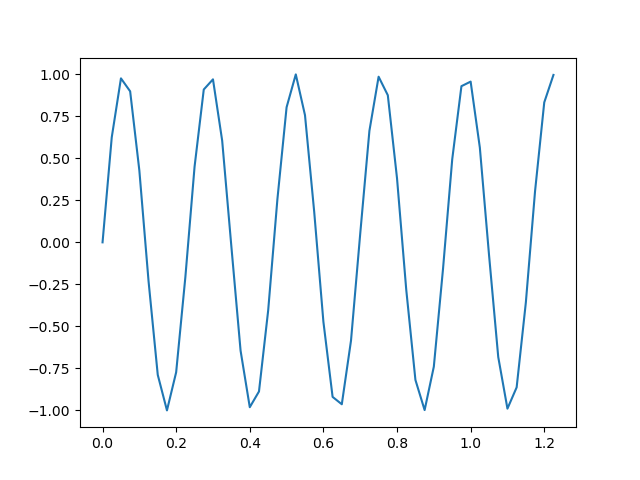

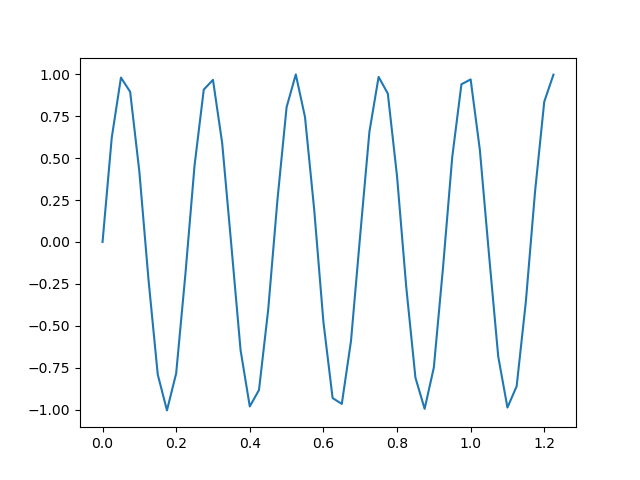

Train Epoch: 225, Loss: 0.000598


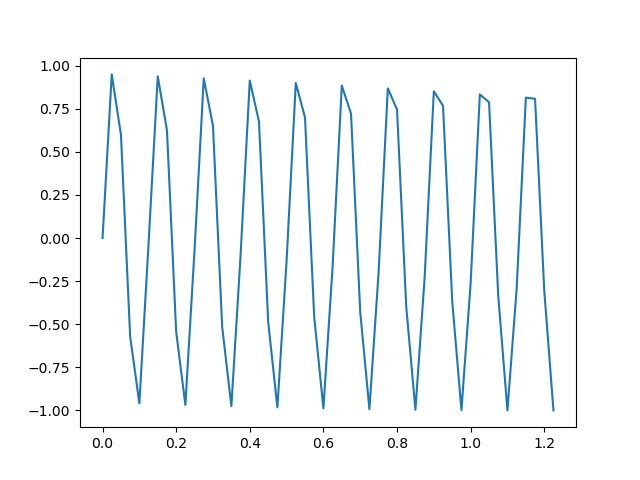

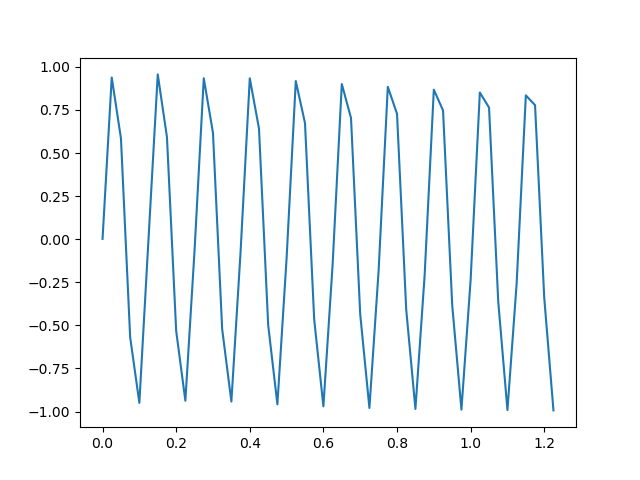

Train Epoch: 230, Loss: 0.000315


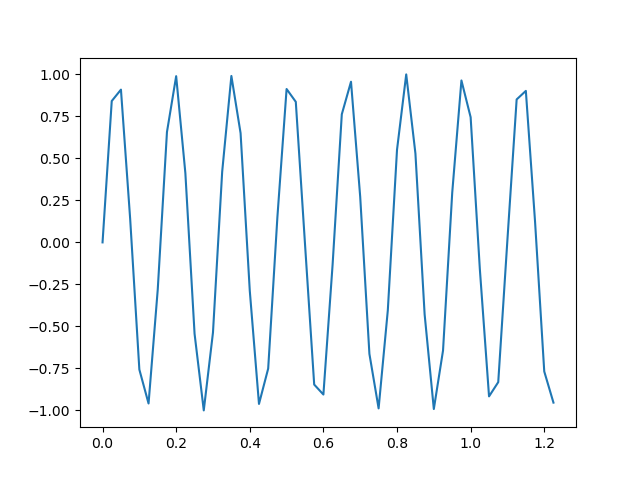

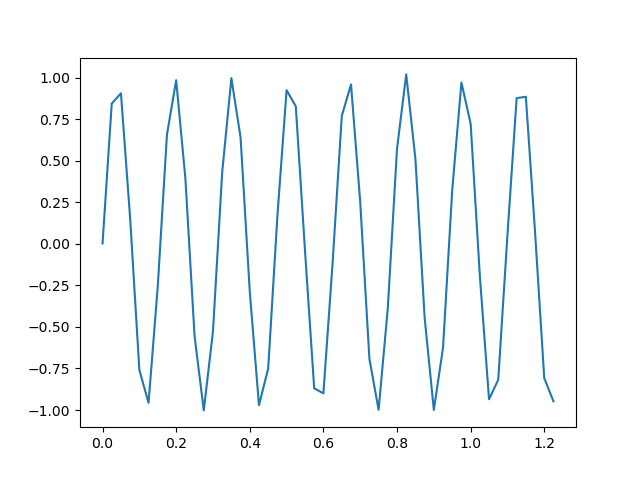

Train Epoch: 235, Loss: 0.000677


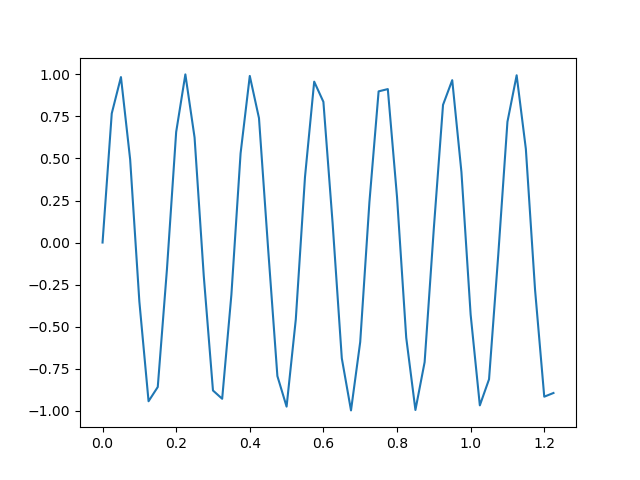

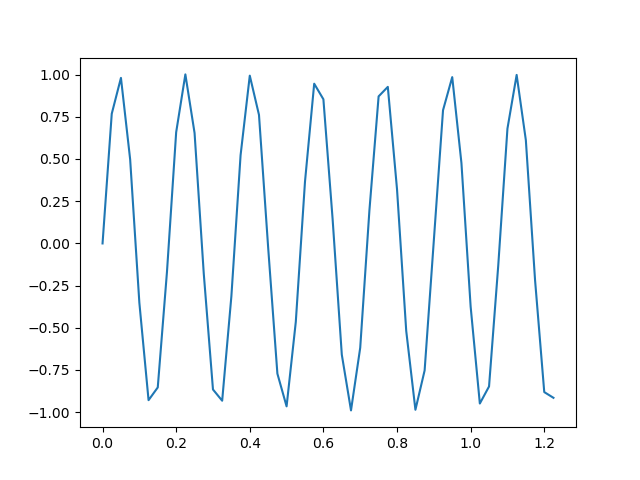

Train Epoch: 240, Loss: 0.001813


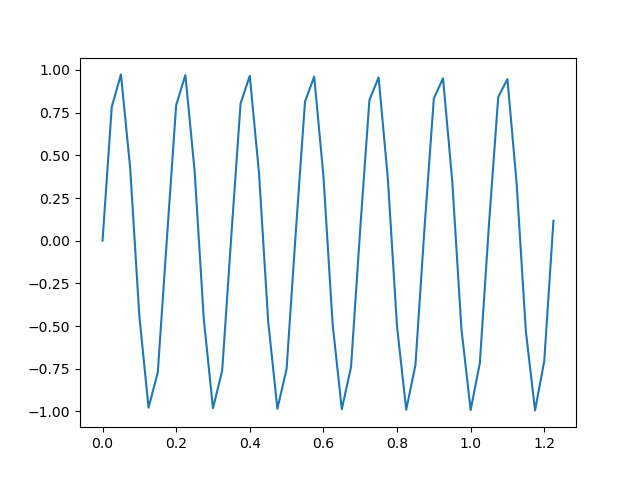

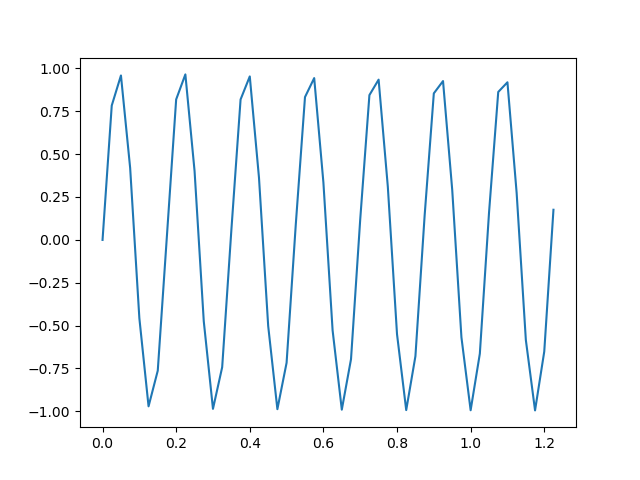

Train Epoch: 245, Loss: 0.162231


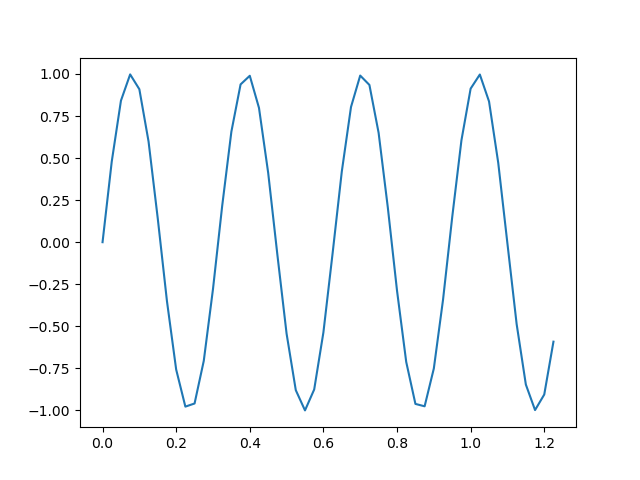

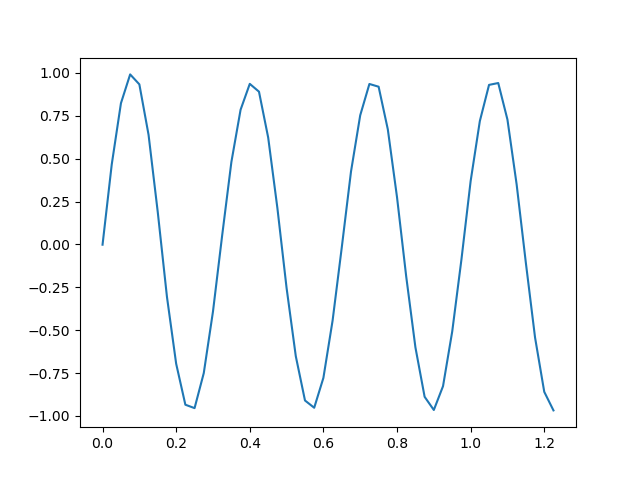

Train Epoch: 250, Loss: 0.039709


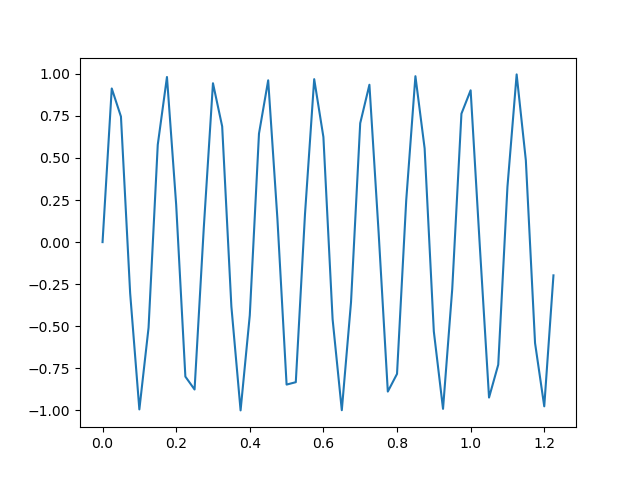

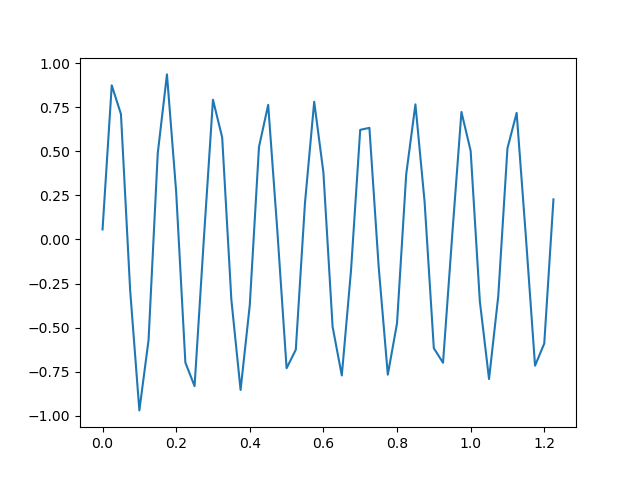

Train Epoch: 255, Loss: 0.009989


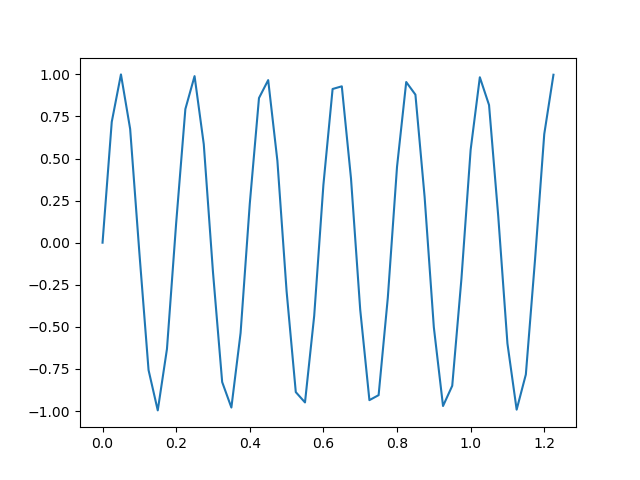

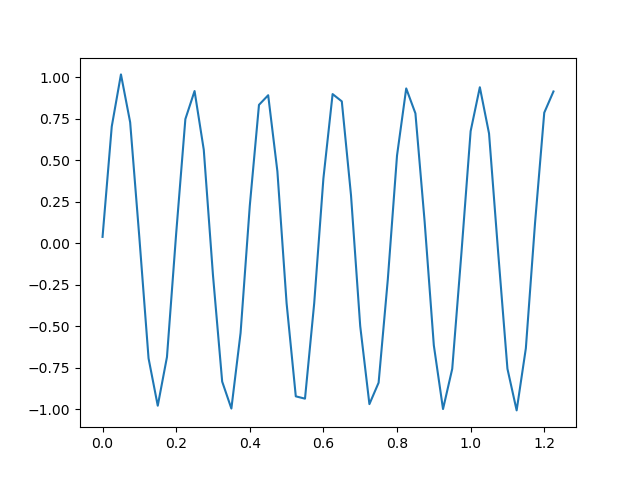

Train Epoch: 260, Loss: 0.006402


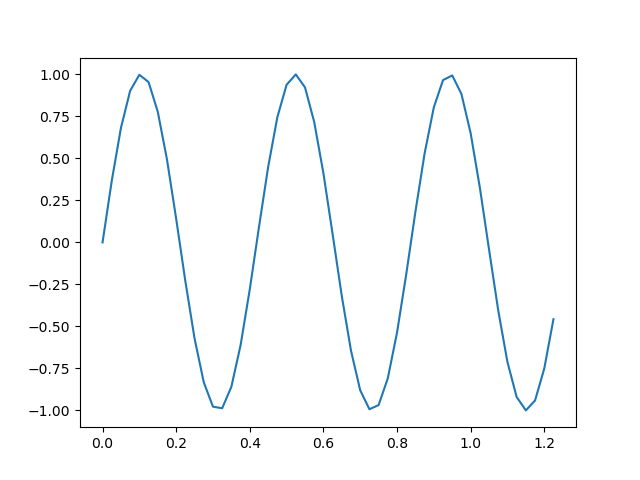

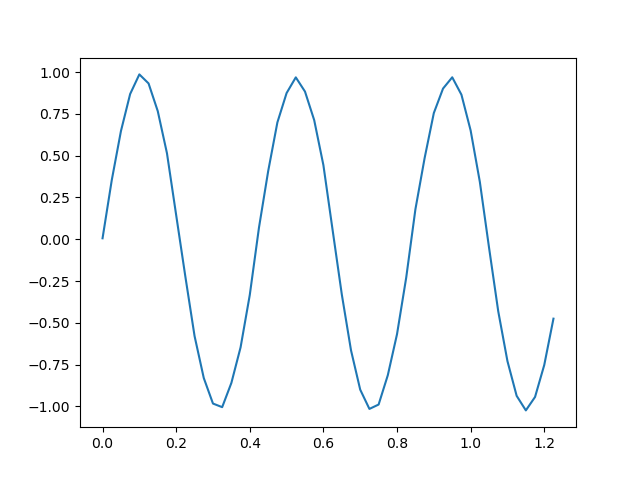

Train Epoch: 265, Loss: 0.001222


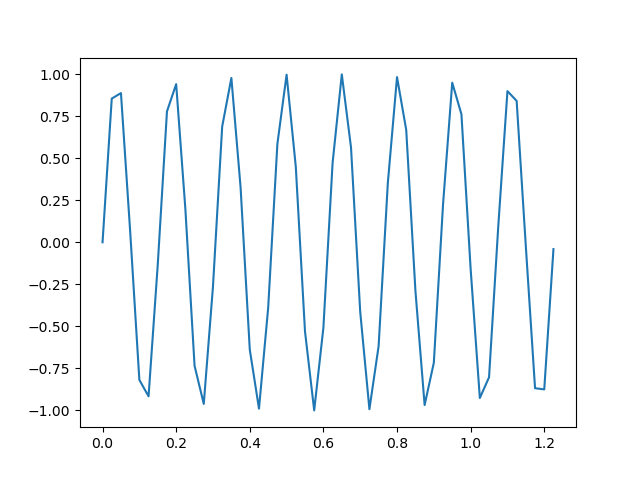

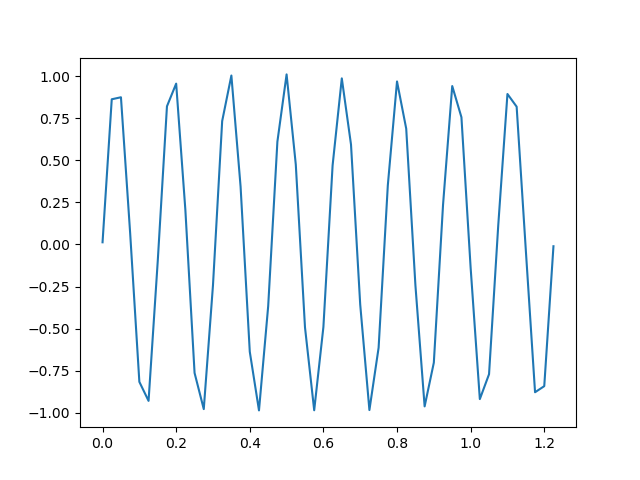

Train Epoch: 270, Loss: 0.000864


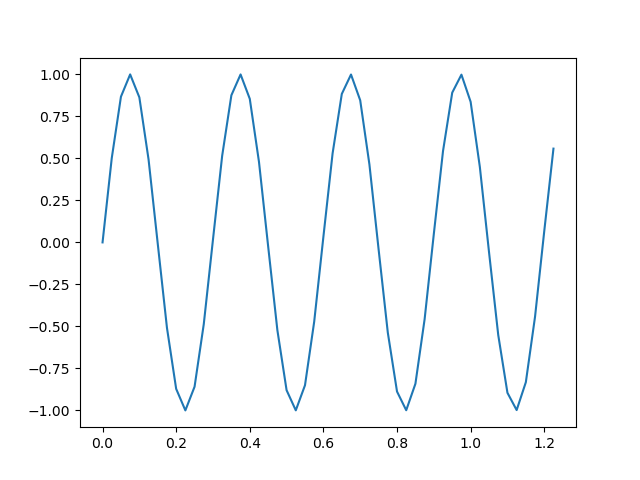

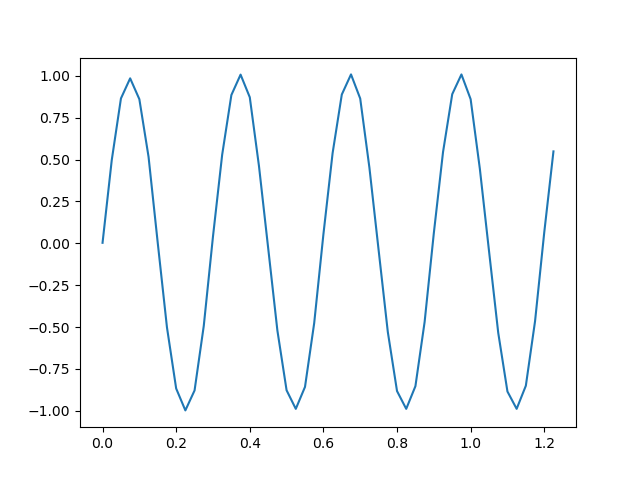

Train Epoch: 275, Loss: 0.000582


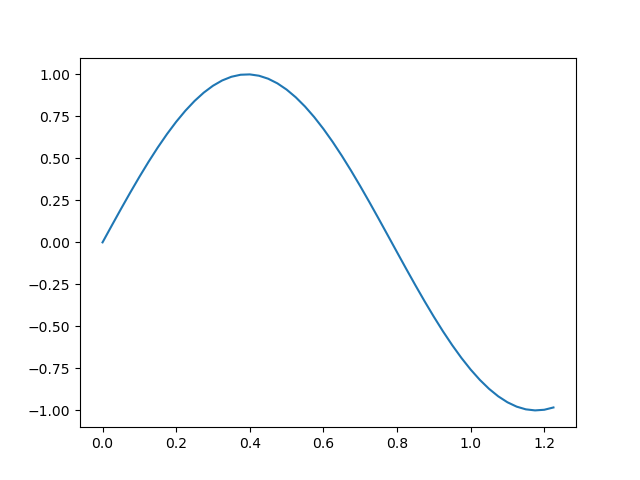

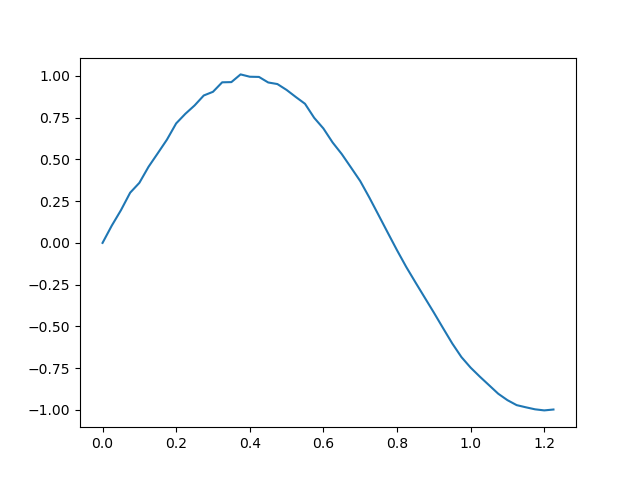

Train Epoch: 280, Loss: 0.000271


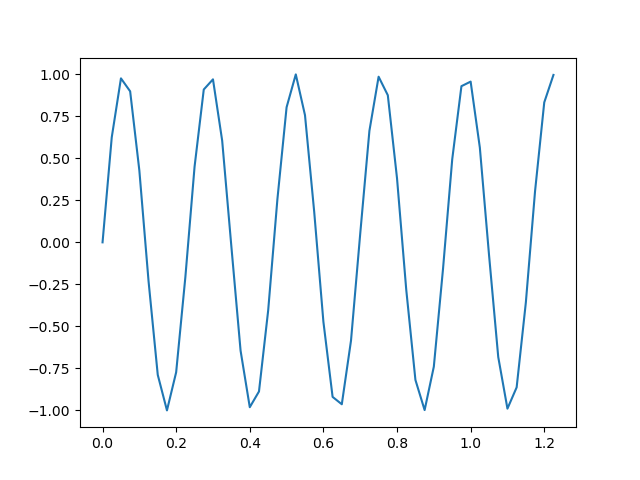

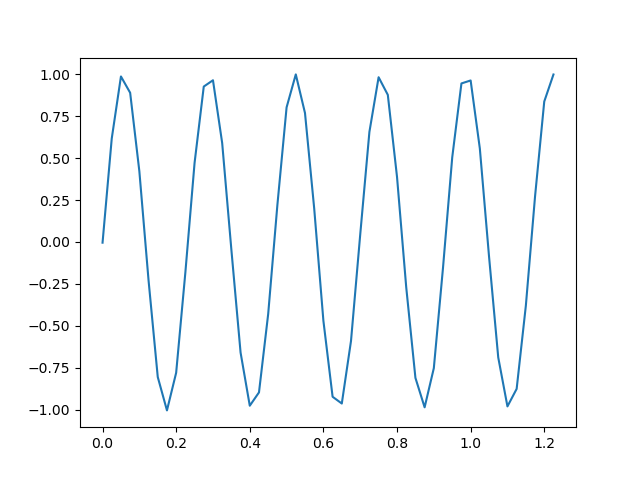

Train Epoch: 285, Loss: 0.000312


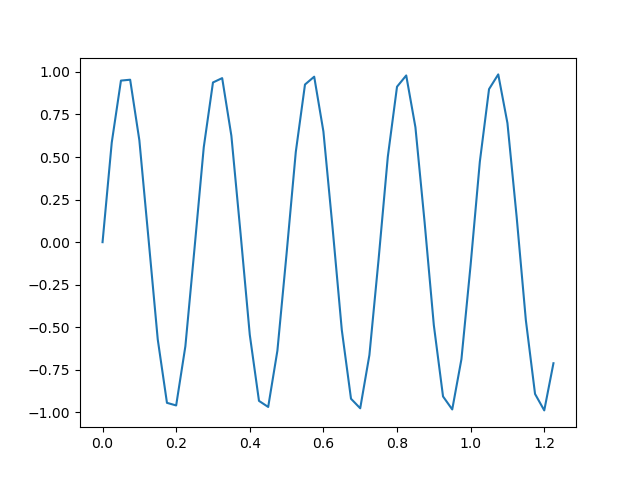

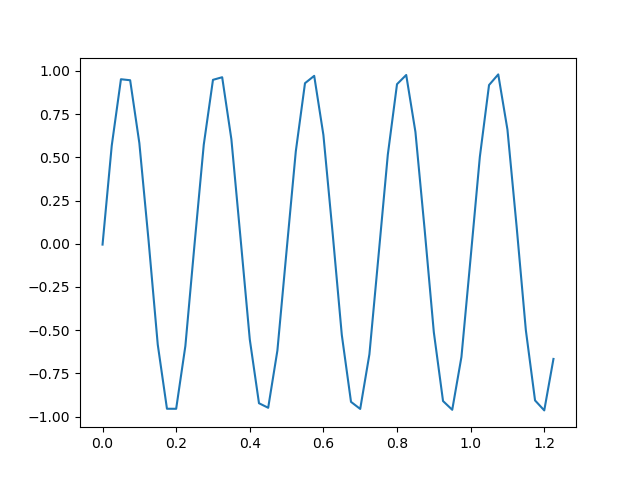

Train Epoch: 290, Loss: 0.000231


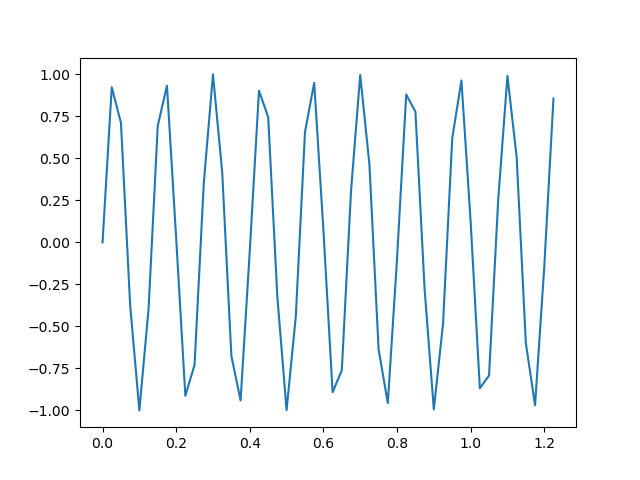

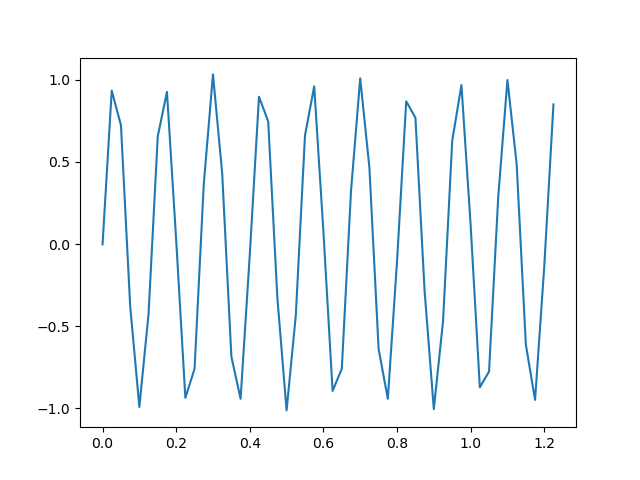

Train Epoch: 295, Loss: 0.000226


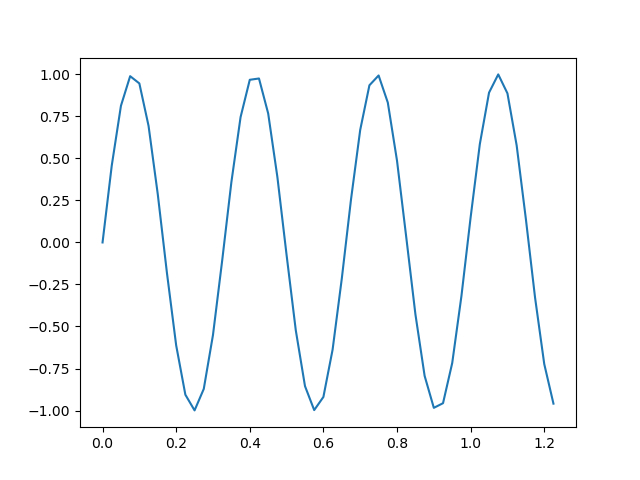

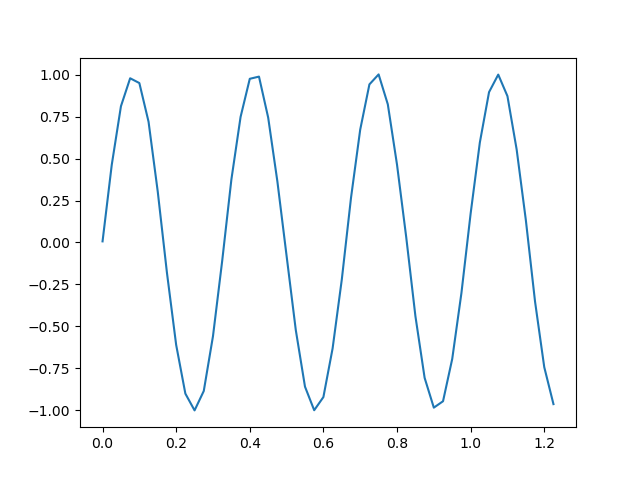

Train Epoch: 300, Loss: 0.000147


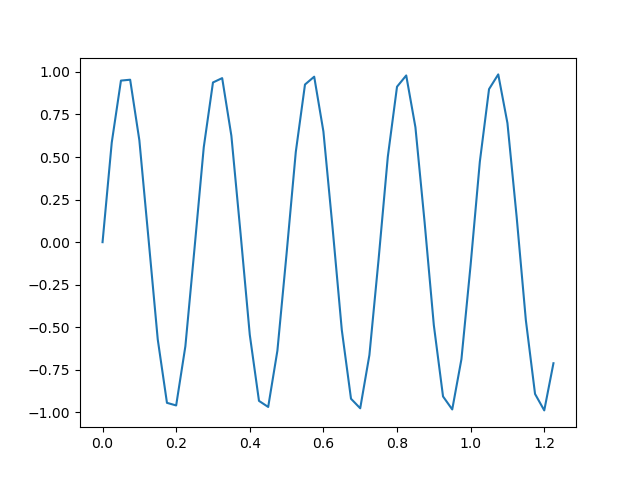

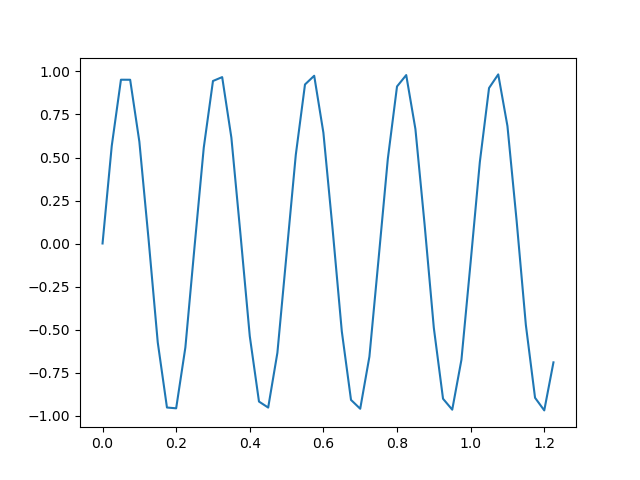

Train Epoch: 305, Loss: 0.000123


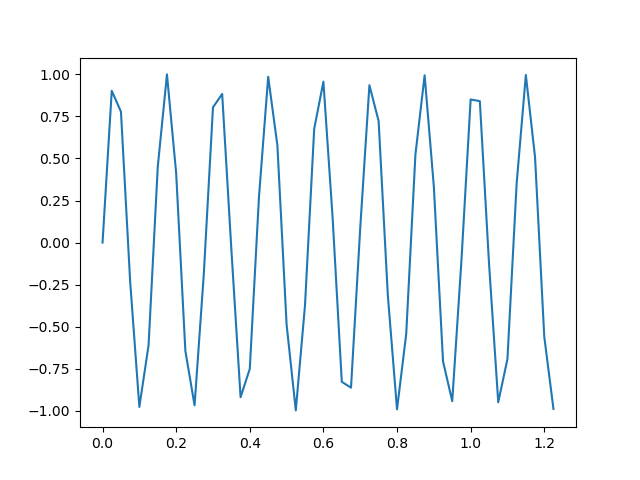

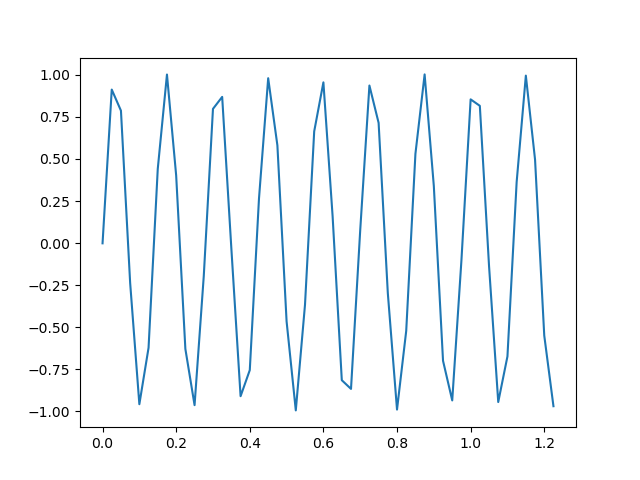

Train Epoch: 310, Loss: 0.000113


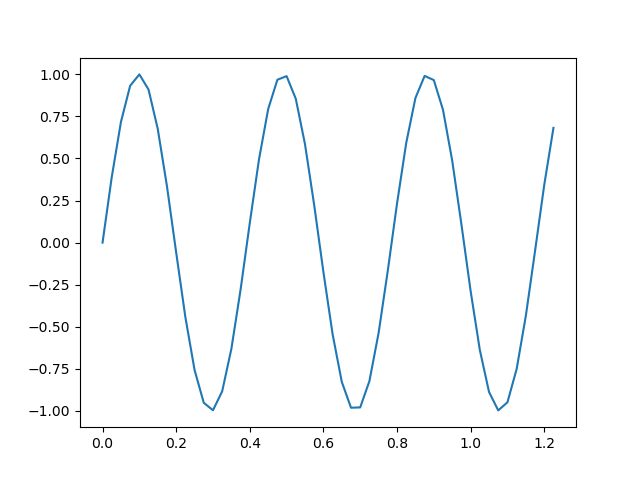

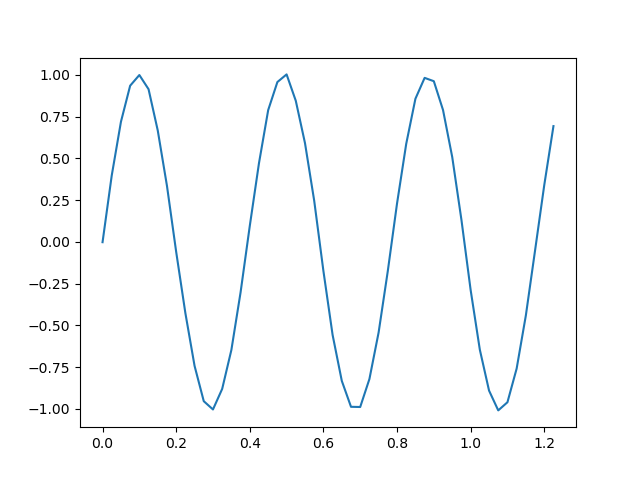

Train Epoch: 315, Loss: 0.000120


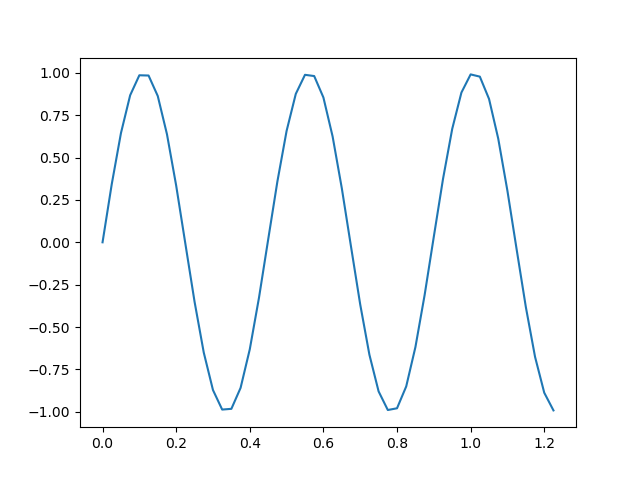

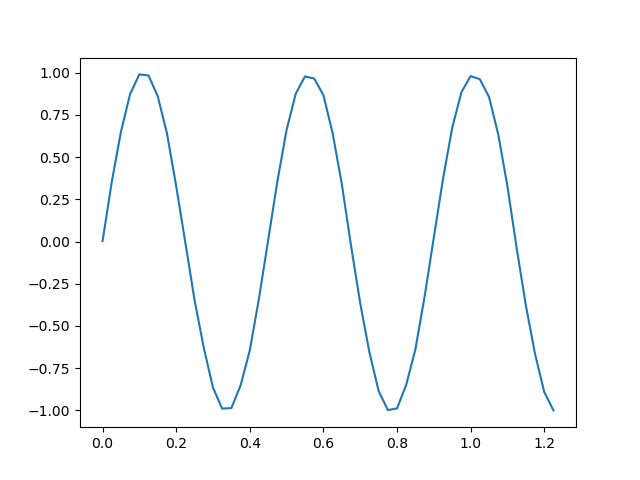

Train Epoch: 320, Loss: 0.000094


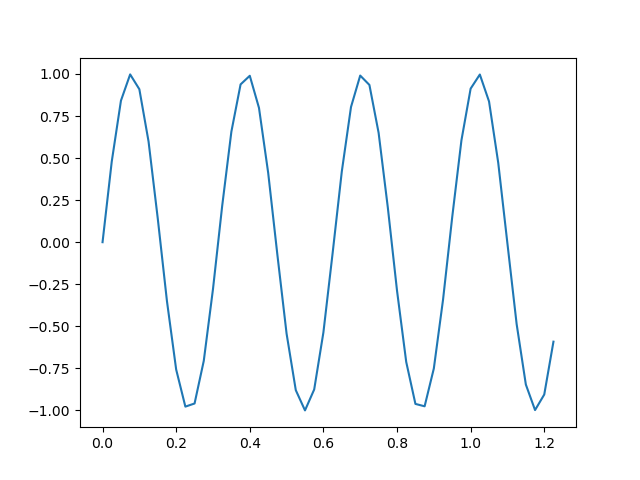

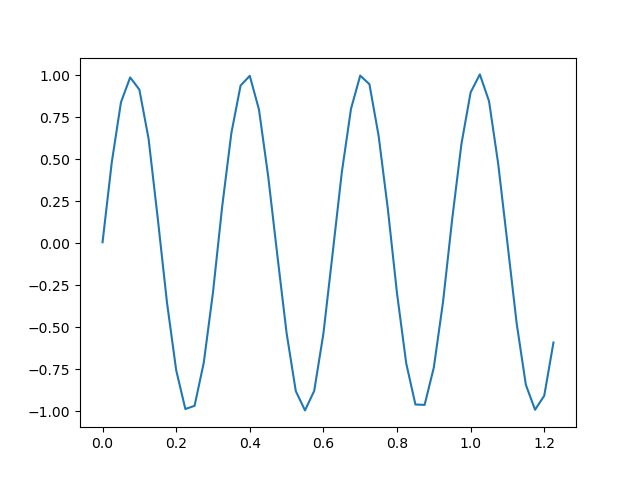

Train Epoch: 325, Loss: 0.000113


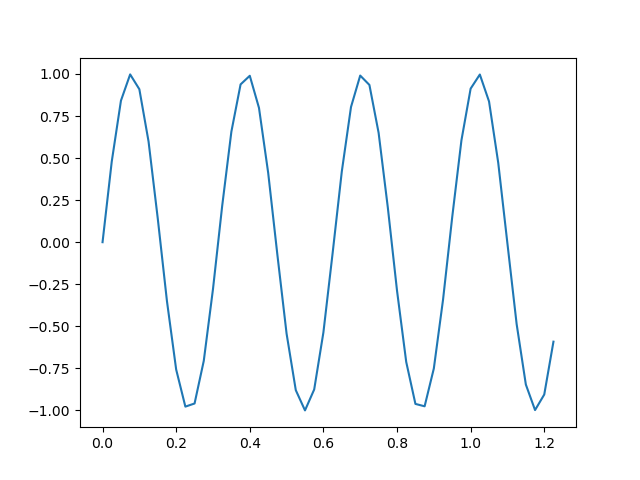

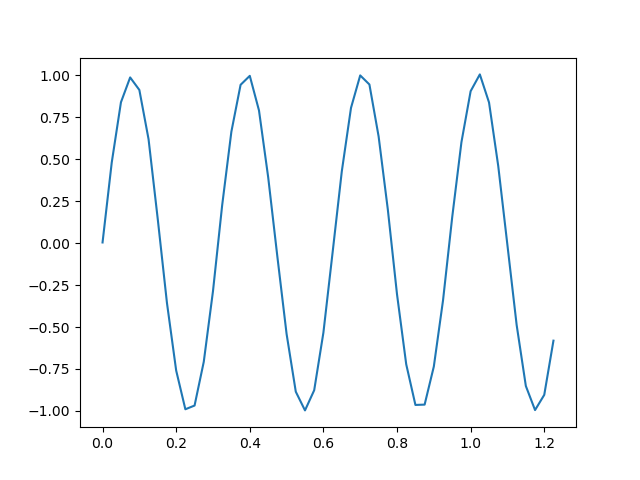

Train Epoch: 330, Loss: 0.000092


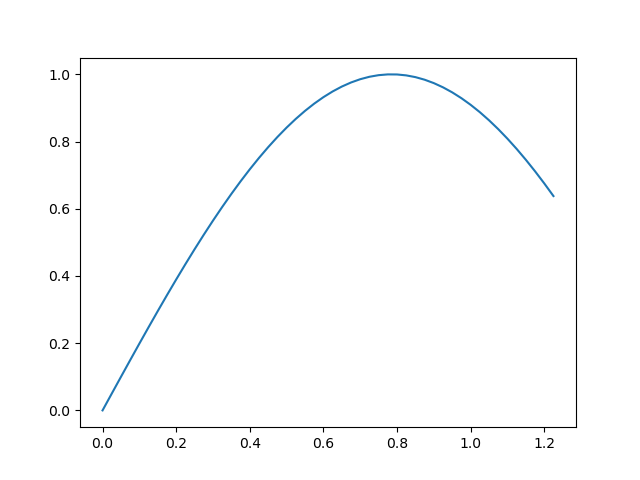

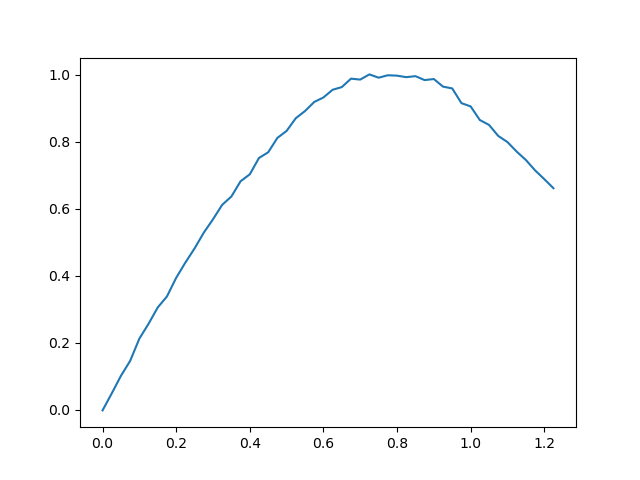

Train Epoch: 335, Loss: 0.000346


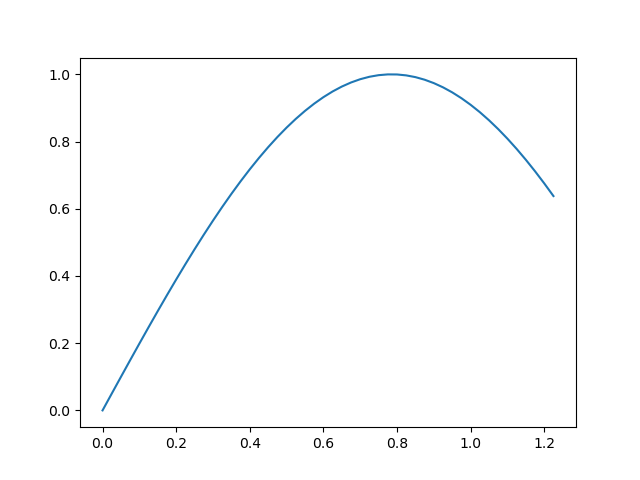

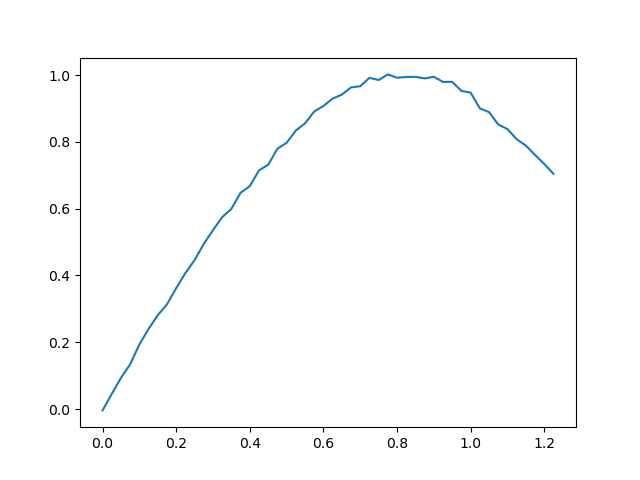

Train Epoch: 340, Loss: 0.000110


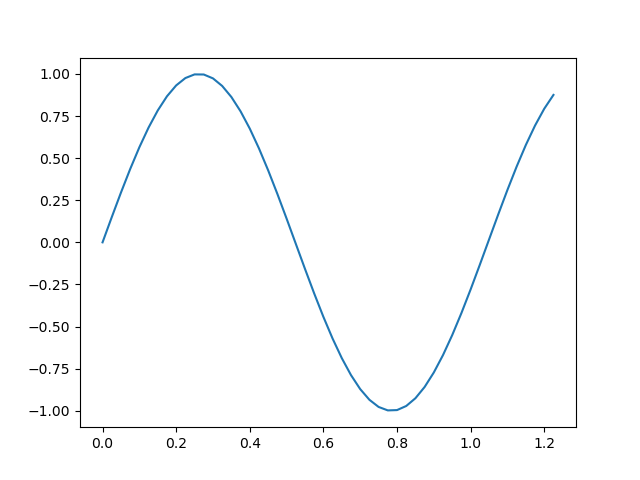

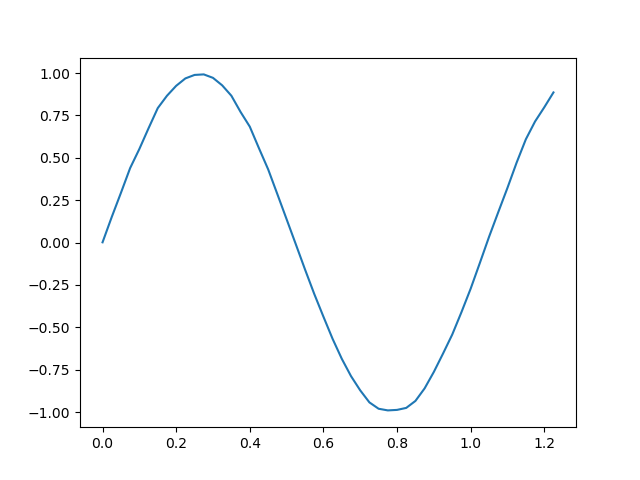

Train Epoch: 345, Loss: 0.000091


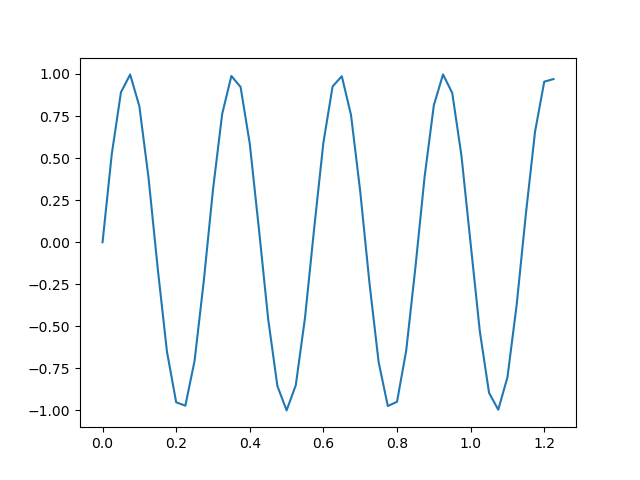

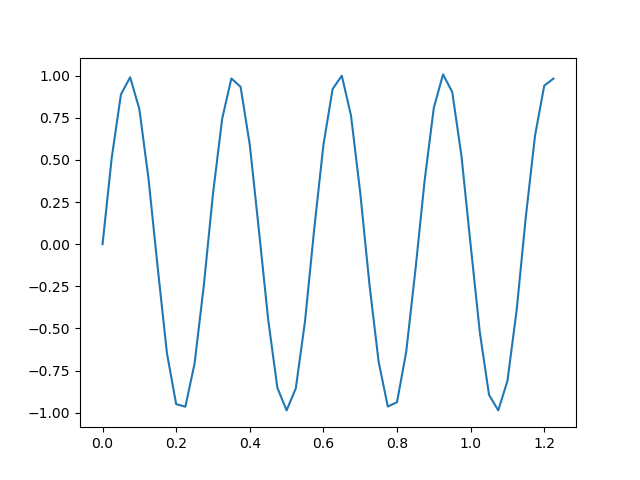

Train Epoch: 350, Loss: 0.000114


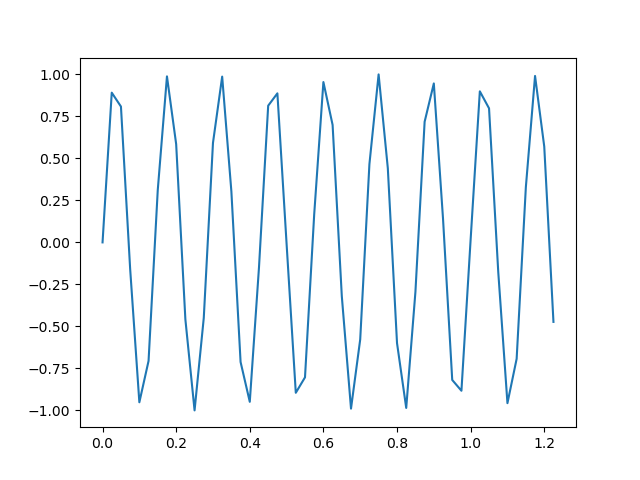

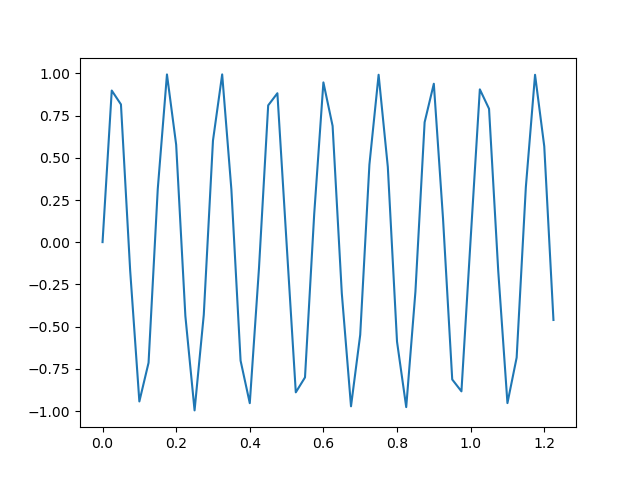

Train Epoch: 355, Loss: 0.000276


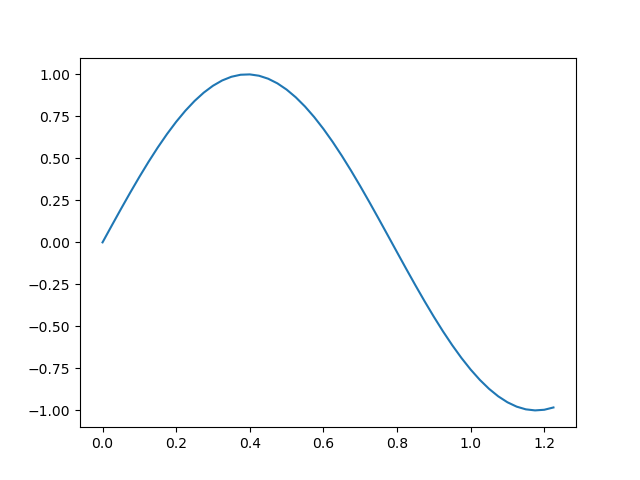

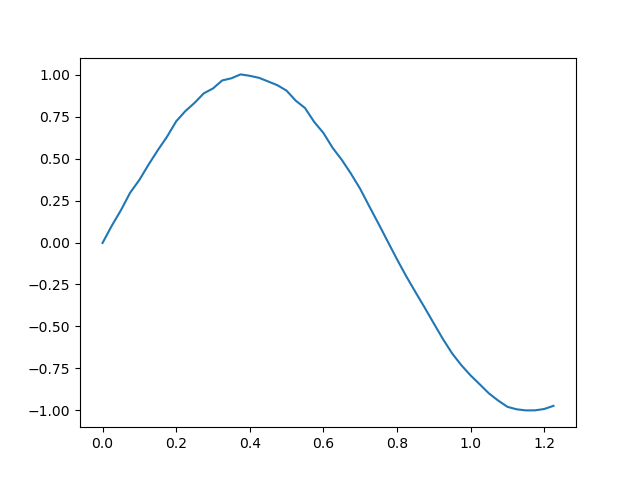

Train Epoch: 360, Loss: 0.000144


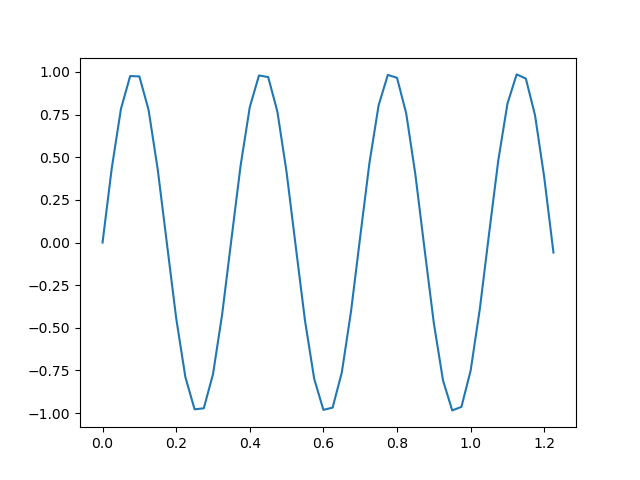

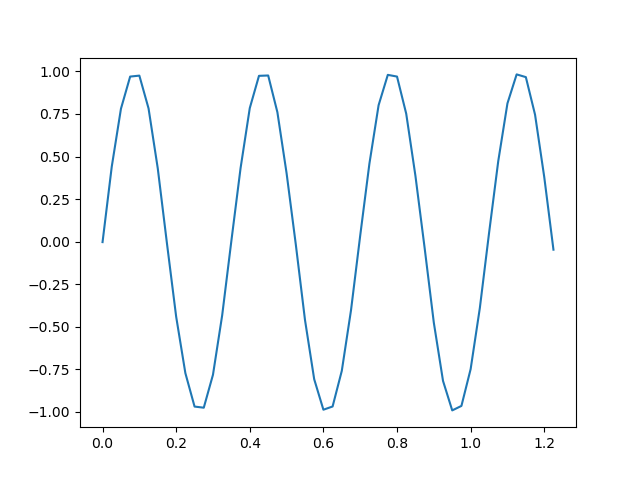

Train Epoch: 365, Loss: 0.000100


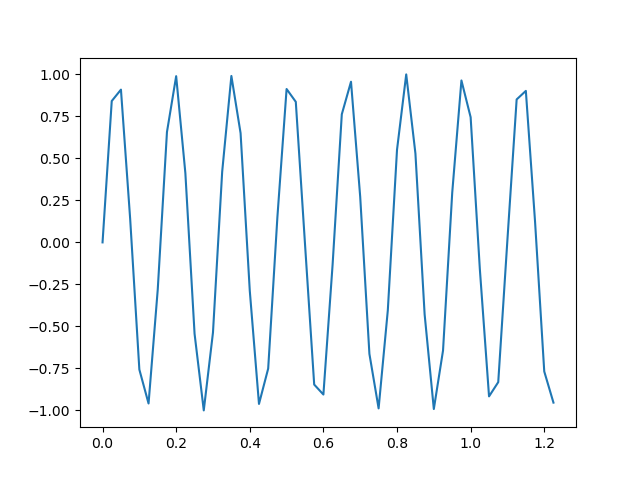

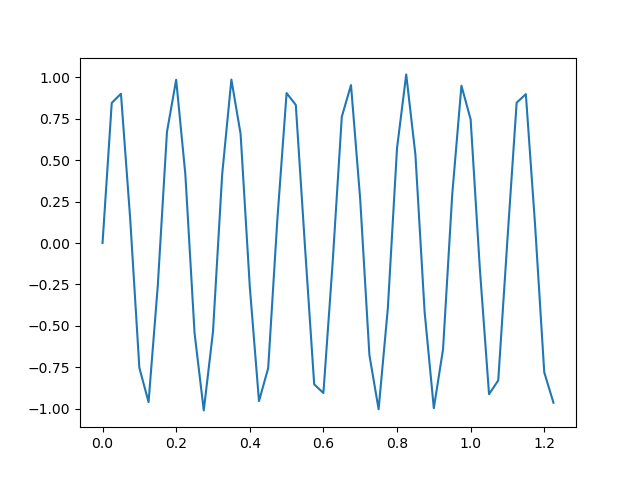

Train Epoch: 370, Loss: 0.000078


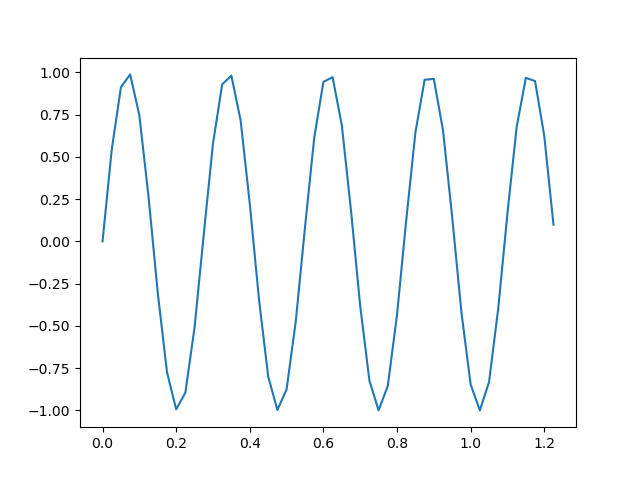

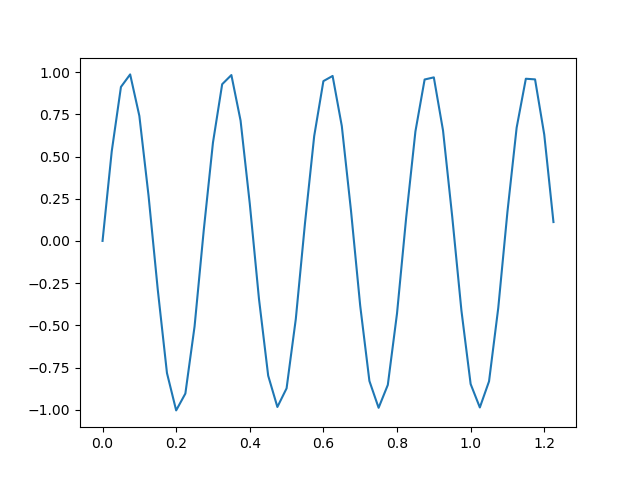

Train Epoch: 375, Loss: 0.000077


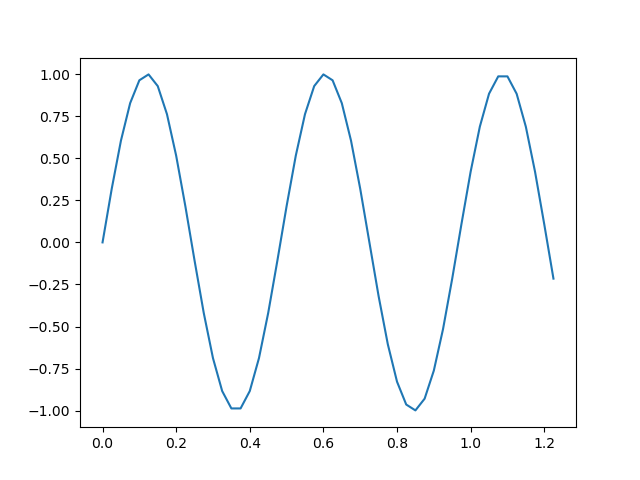

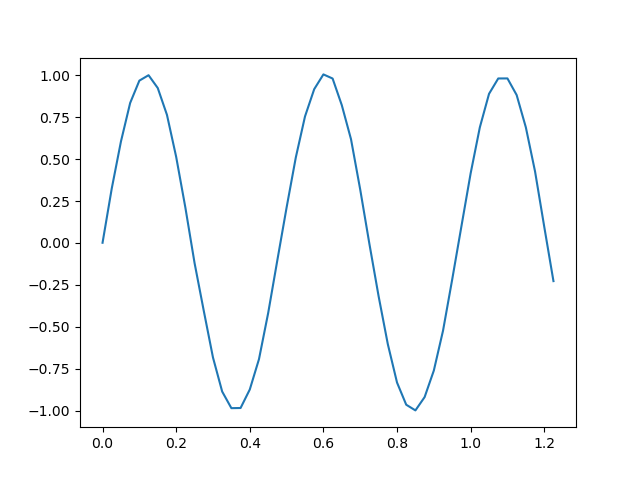

Train Epoch: 380, Loss: 0.000076


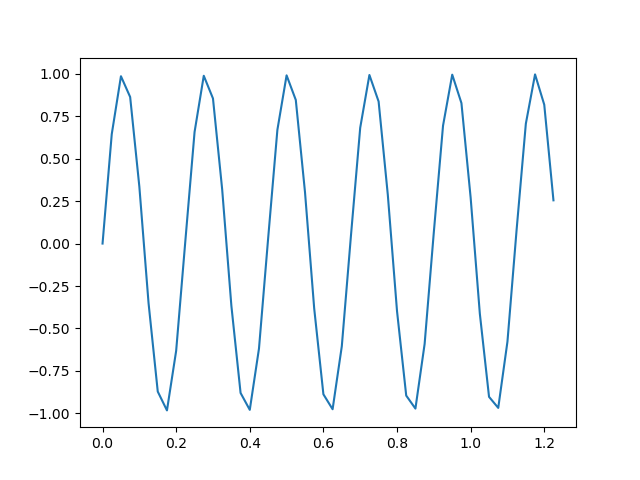

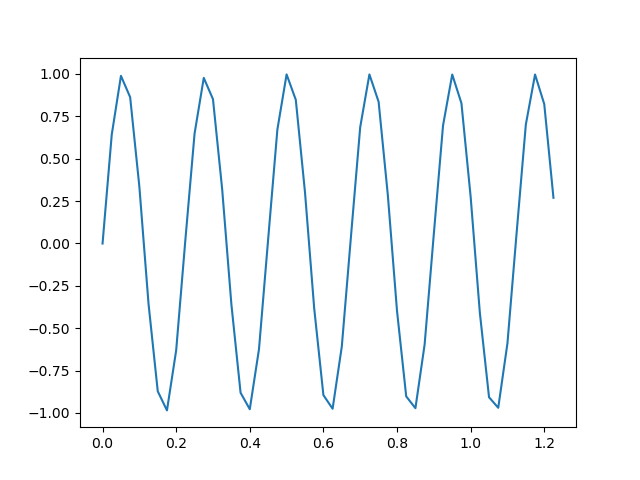

Train Epoch: 385, Loss: 0.000090


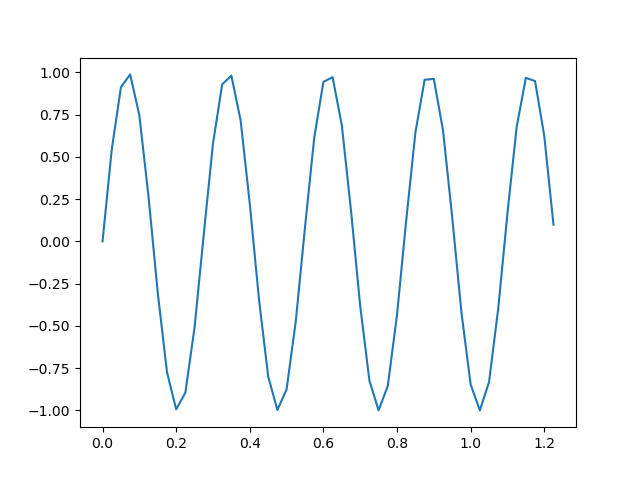

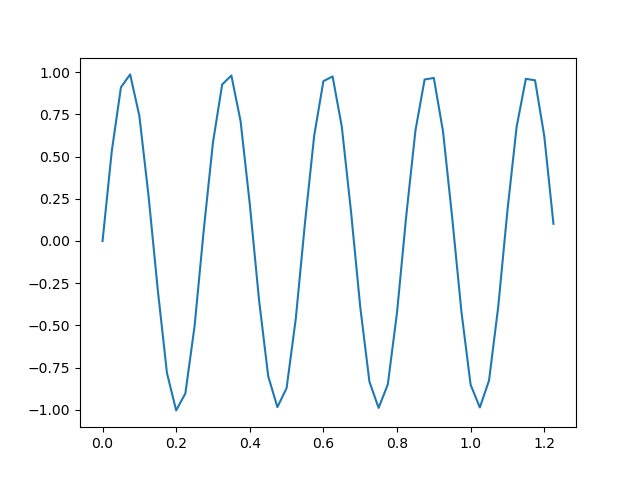

Train Epoch: 390, Loss: 0.000083


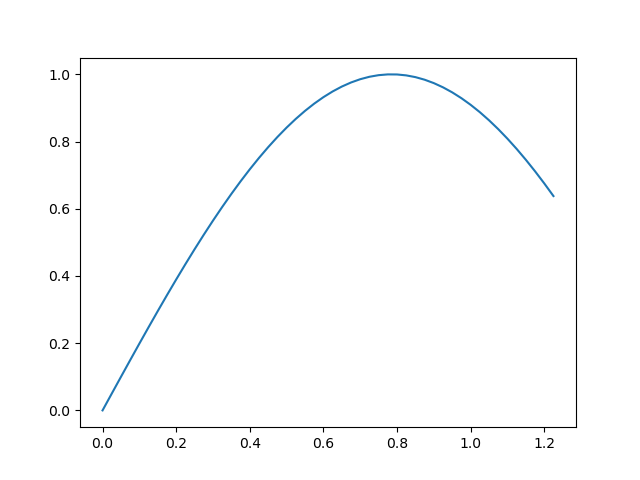

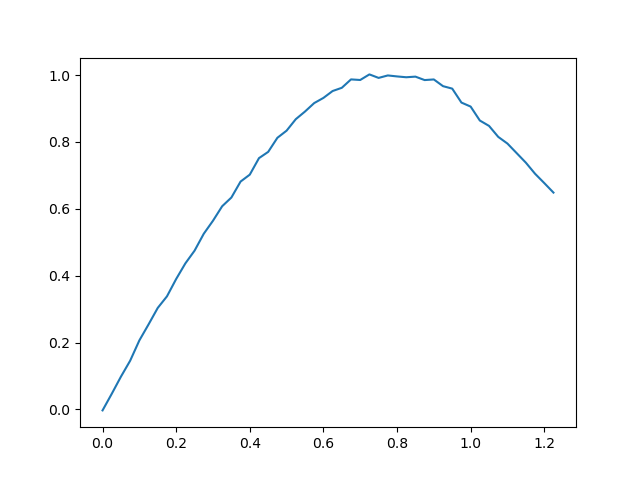

Train Epoch: 395, Loss: 0.000086


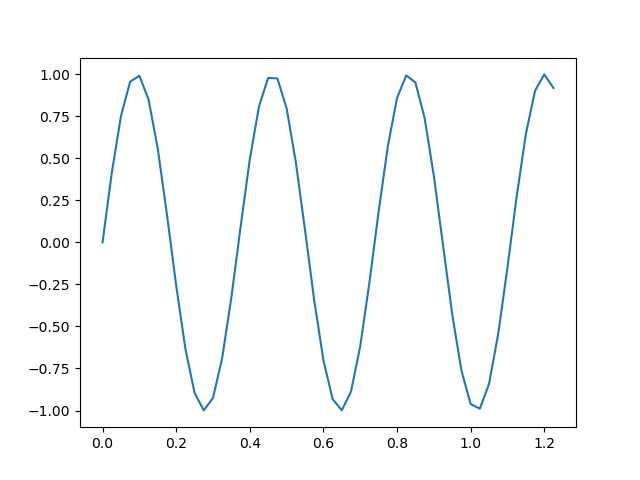

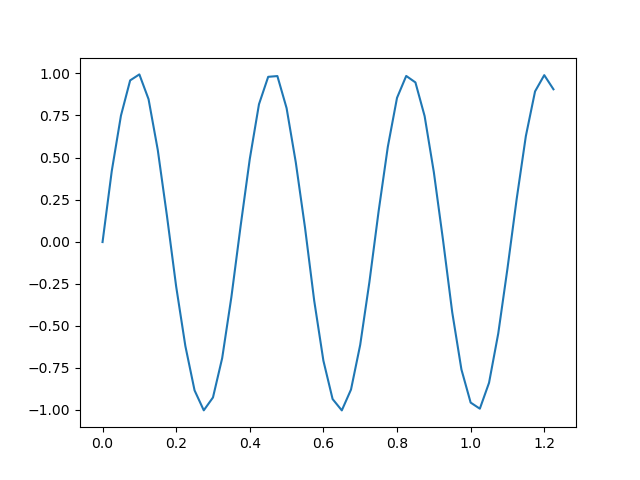

Train Epoch: 400, Loss: 0.000091


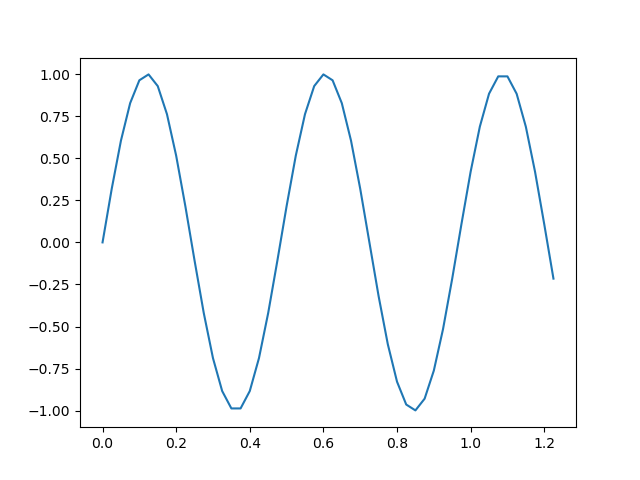

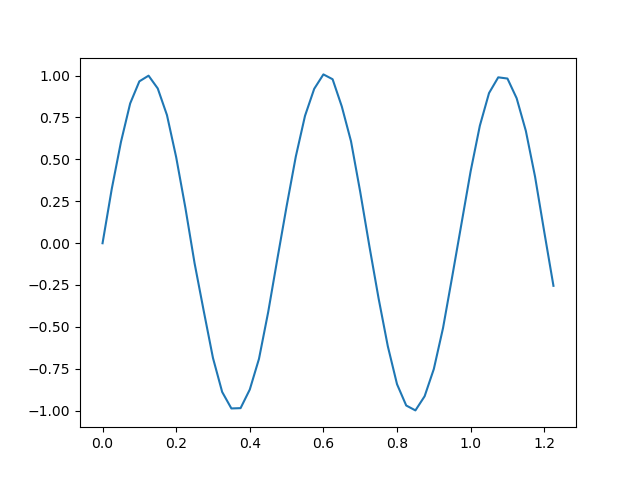

Train Epoch: 405, Loss: 0.000054


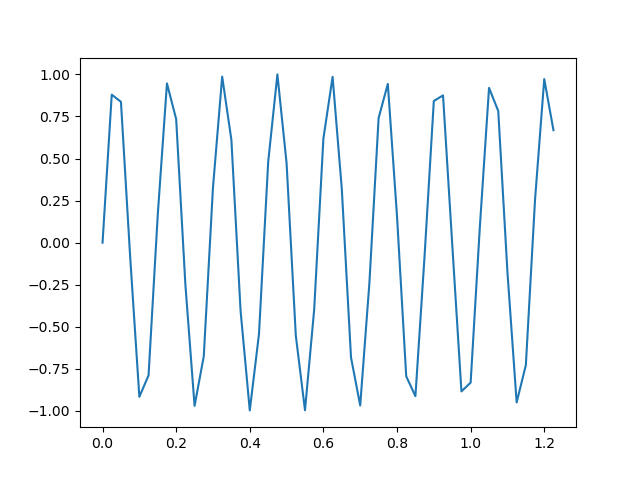

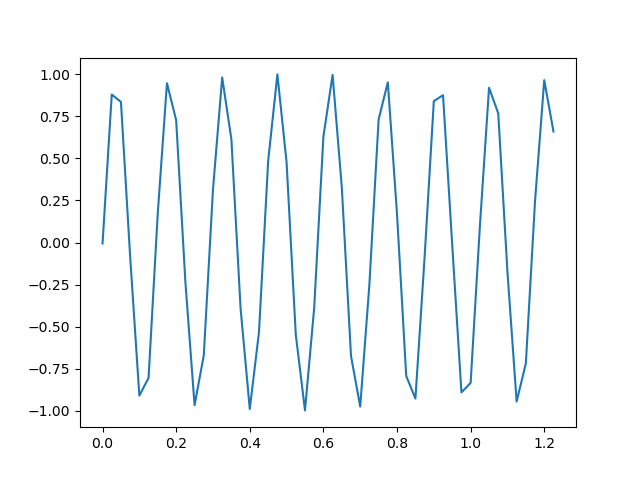

Train Epoch: 410, Loss: 0.000063


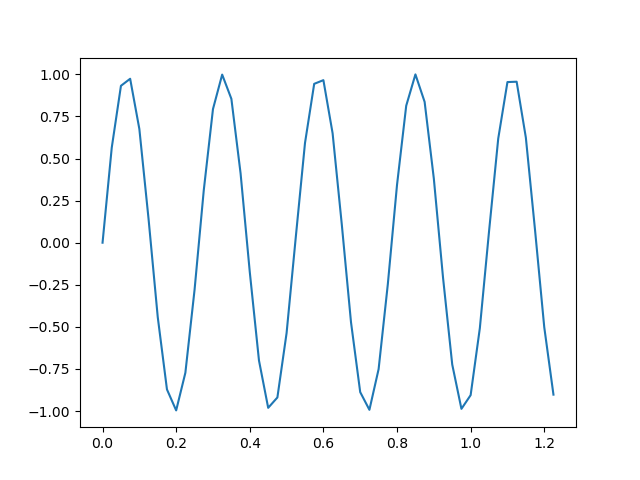

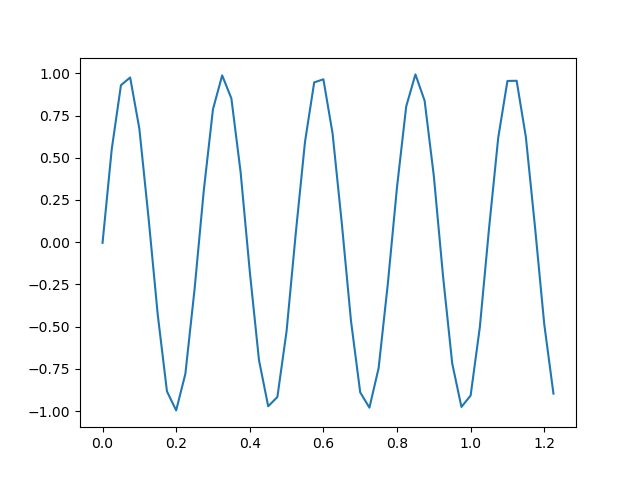

Train Epoch: 415, Loss: 0.000063


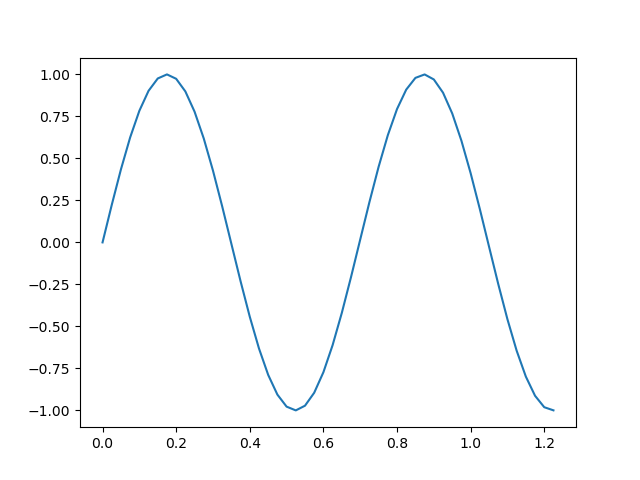

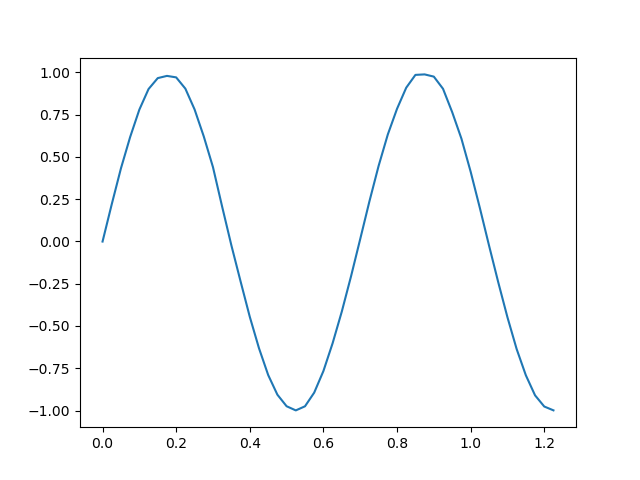

Train Epoch: 420, Loss: 0.000068


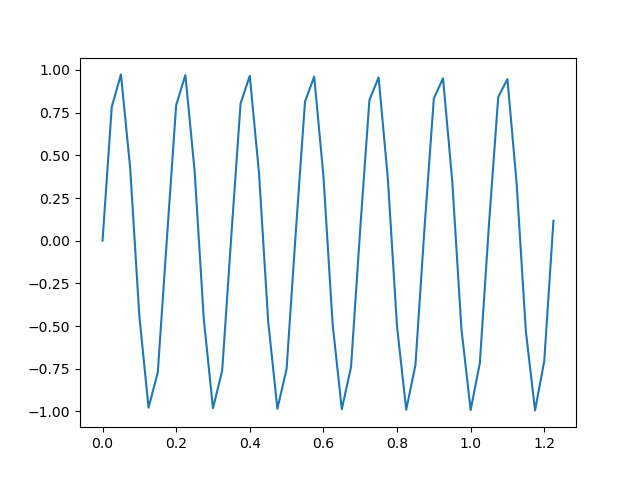

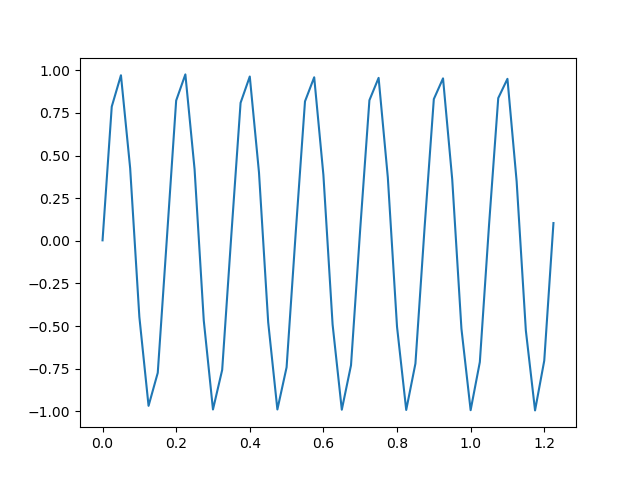

Train Epoch: 425, Loss: 0.000058


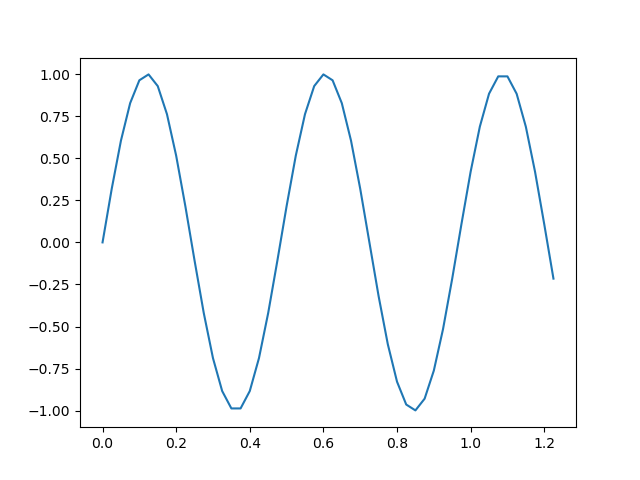

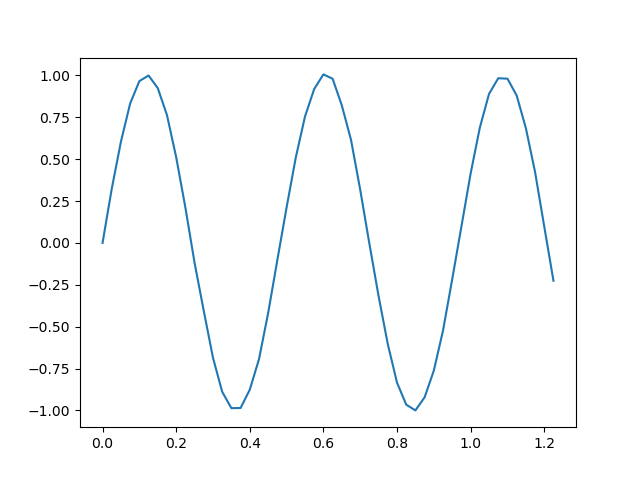

Train Epoch: 430, Loss: 0.000079


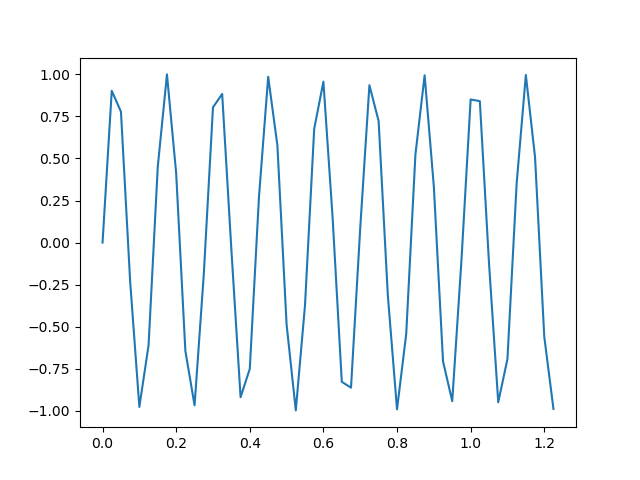

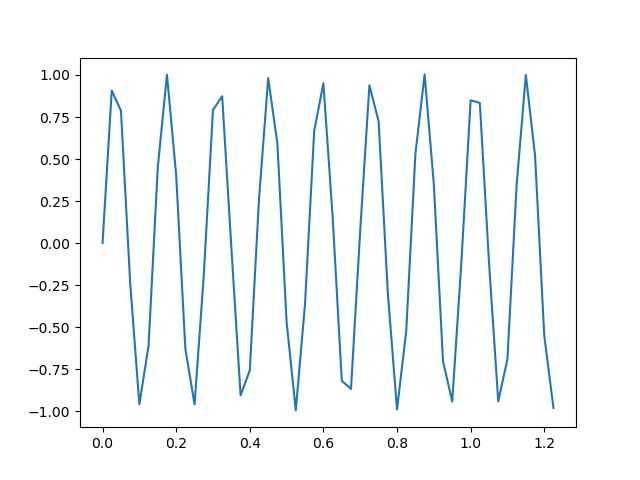

Train Epoch: 435, Loss: 0.000108


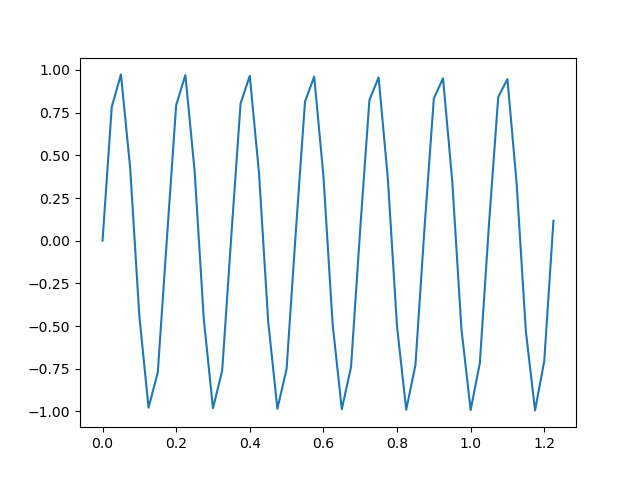

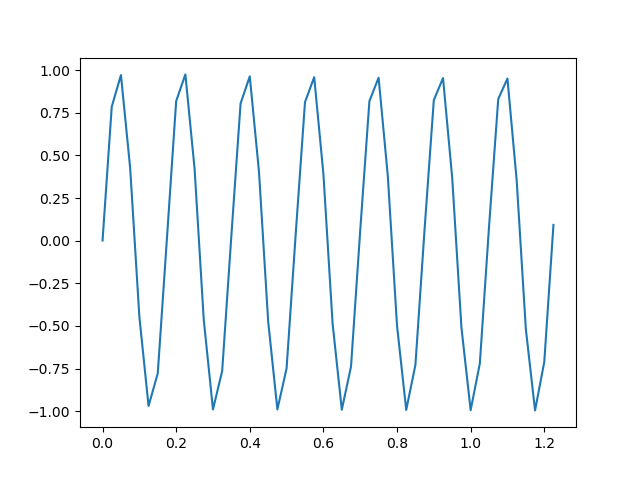

Train Epoch: 440, Loss: 0.000078


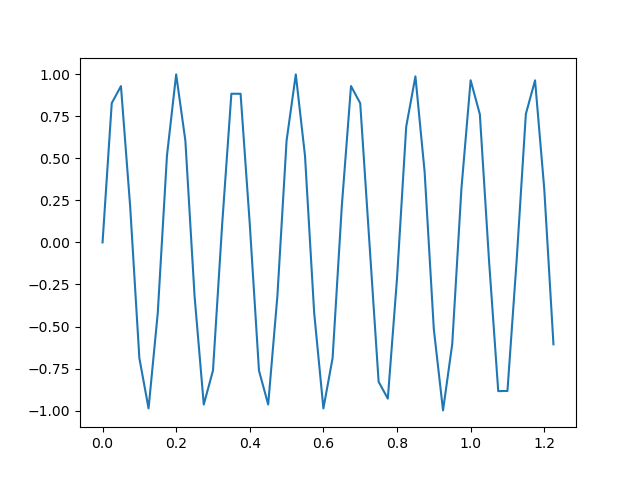

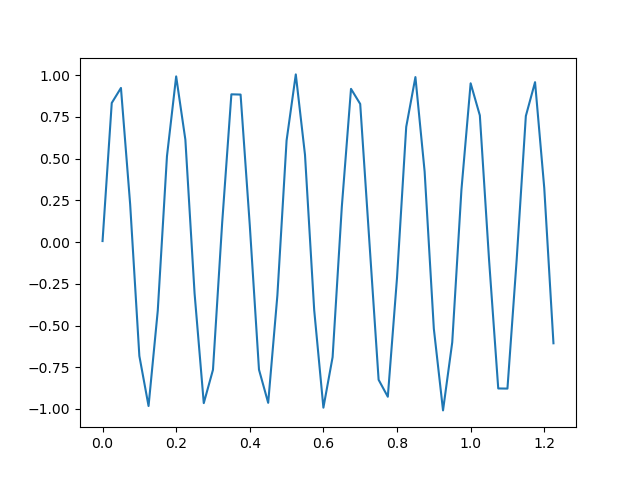

Train Epoch: 445, Loss: 0.000077


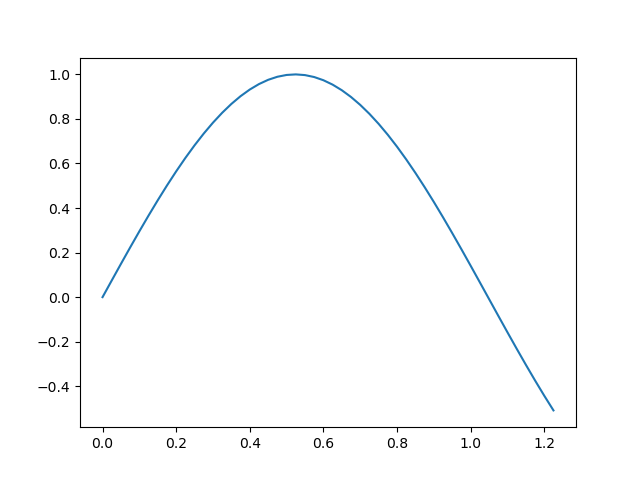

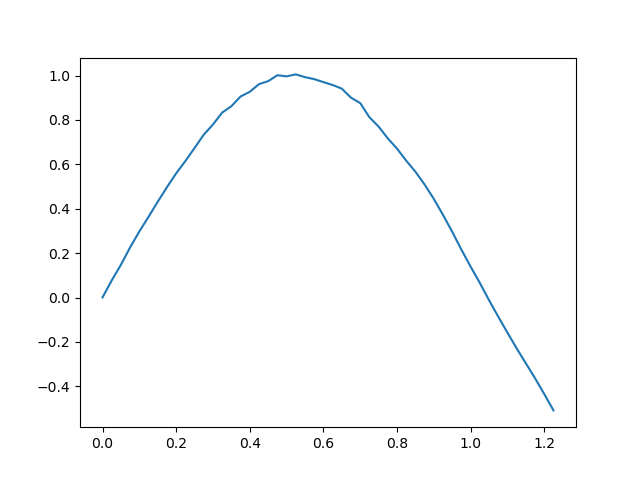

Train Epoch: 450, Loss: 0.000080


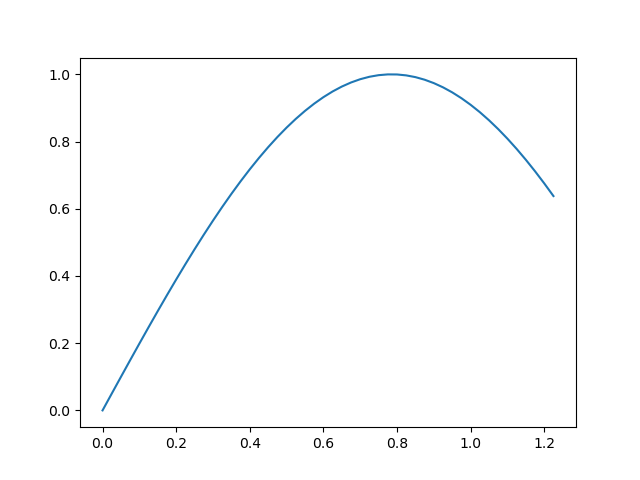

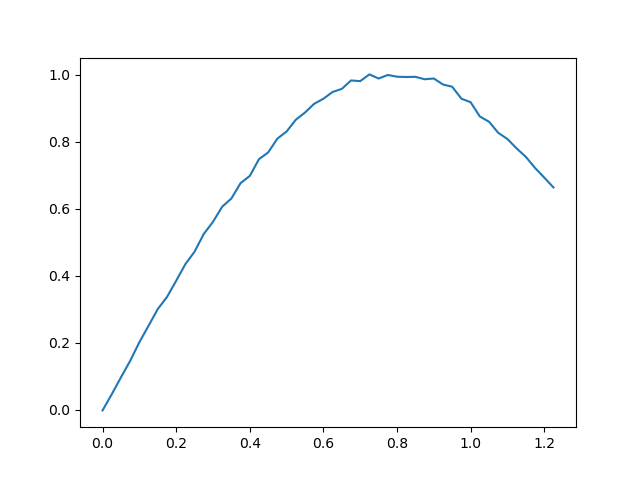

Train Epoch: 455, Loss: 0.000085


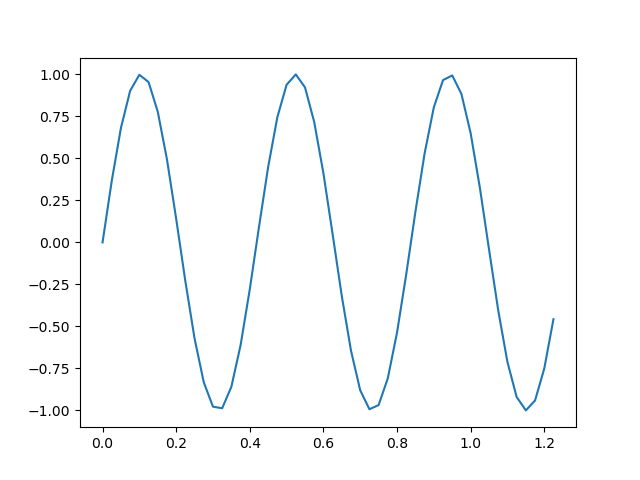

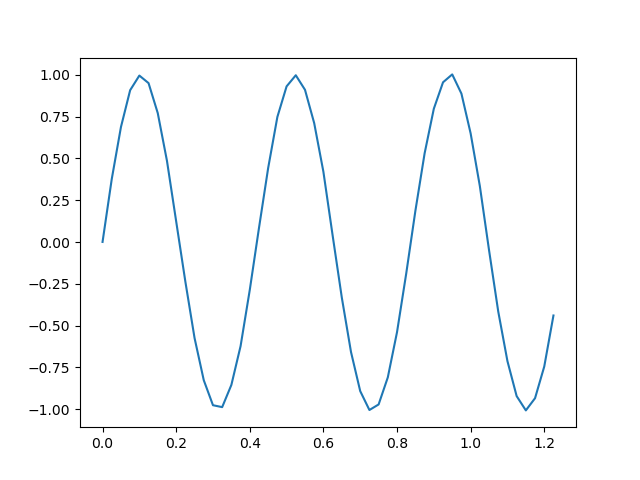

Train Epoch: 460, Loss: 0.000070


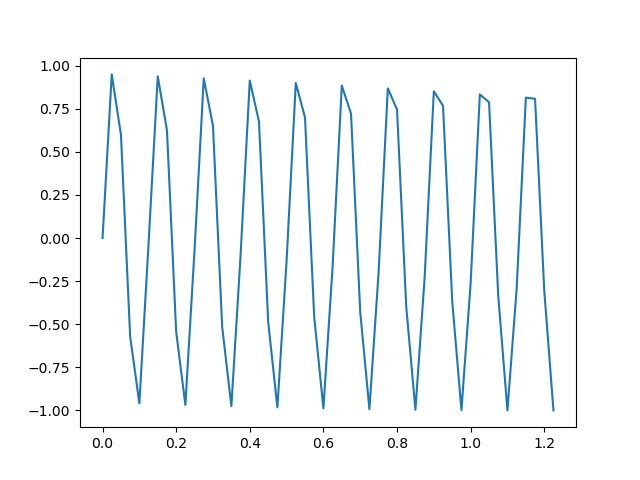

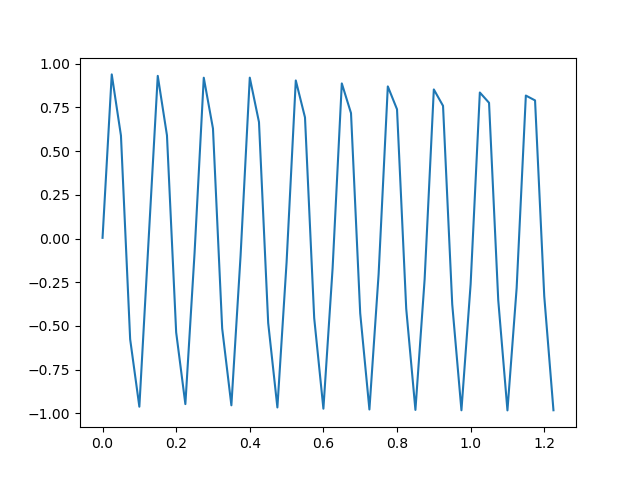

Train Epoch: 465, Loss: 0.000056


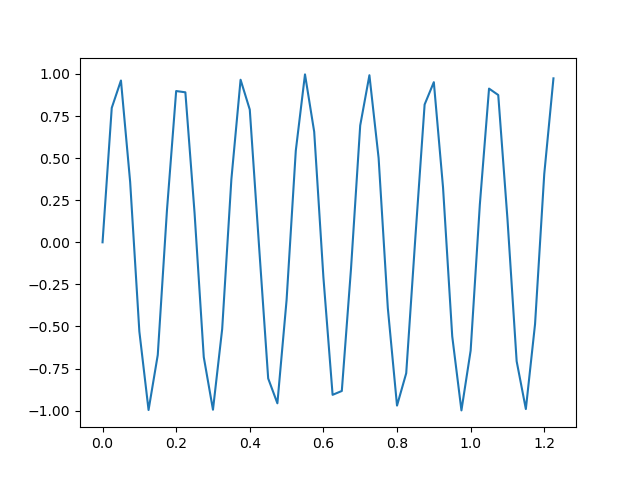

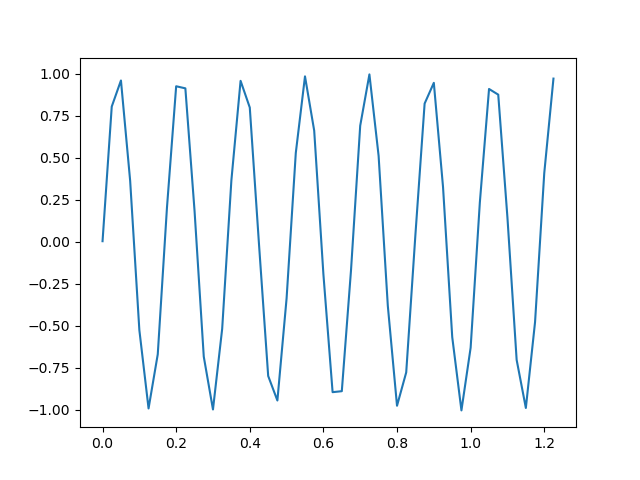

Train Epoch: 470, Loss: 0.000242


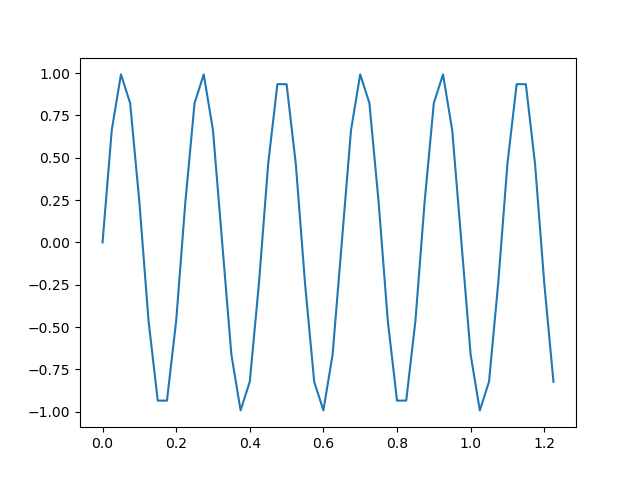

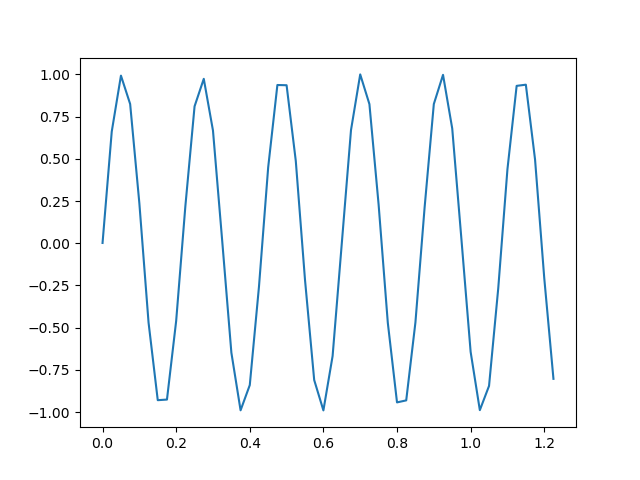

Train Epoch: 475, Loss: 0.000616


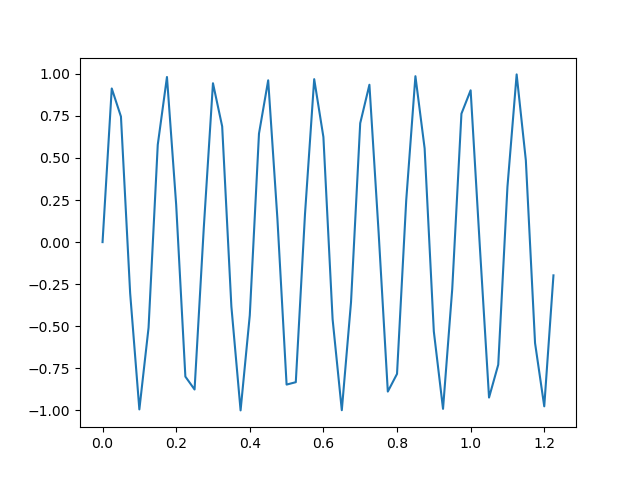

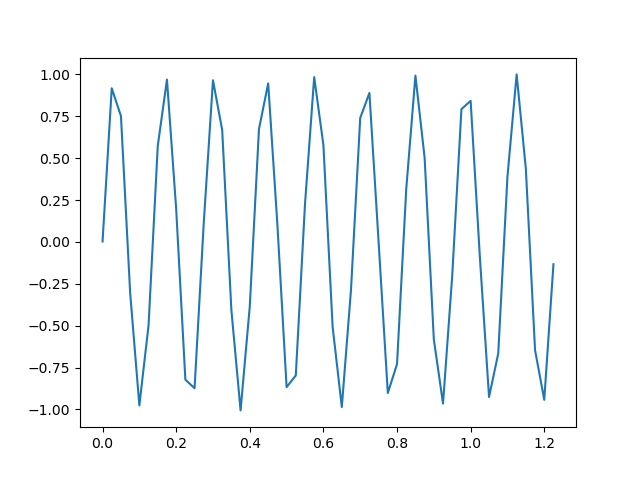

Train Epoch: 480, Loss: 0.015400


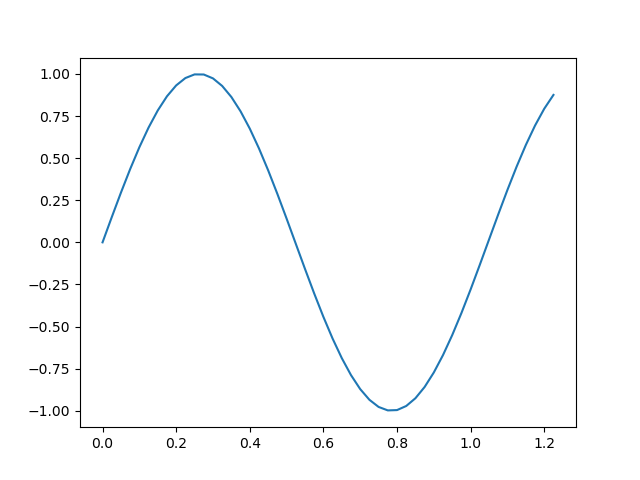

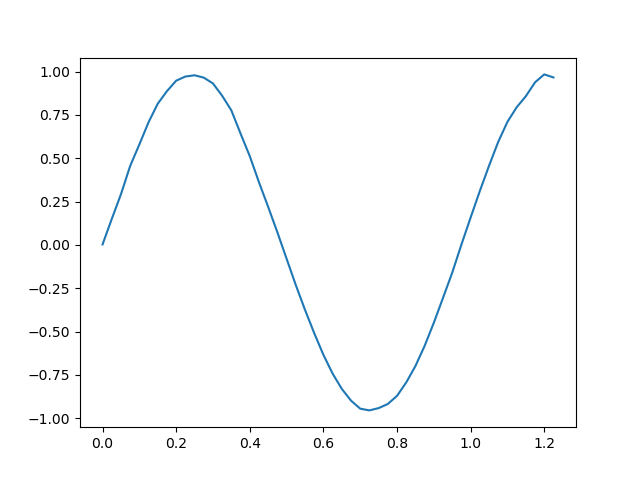

Train Epoch: 485, Loss: 0.013909


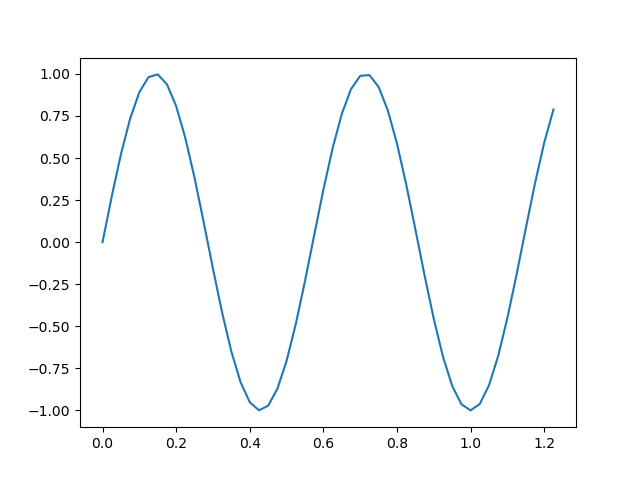

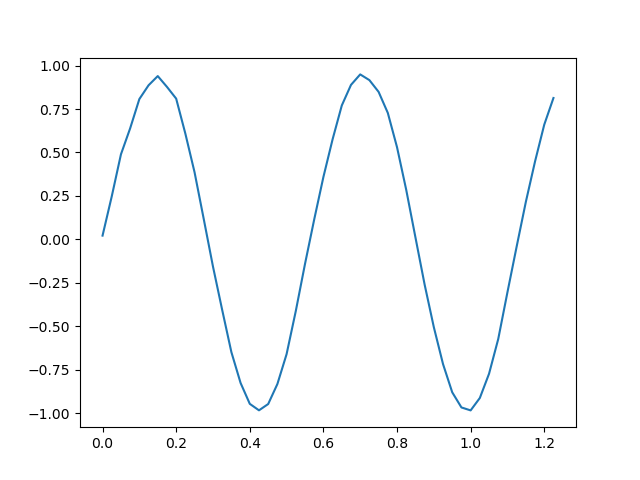

Train Epoch: 490, Loss: 0.017280


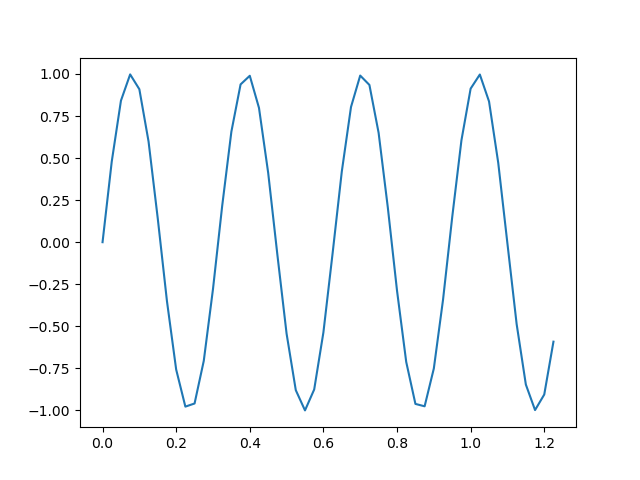

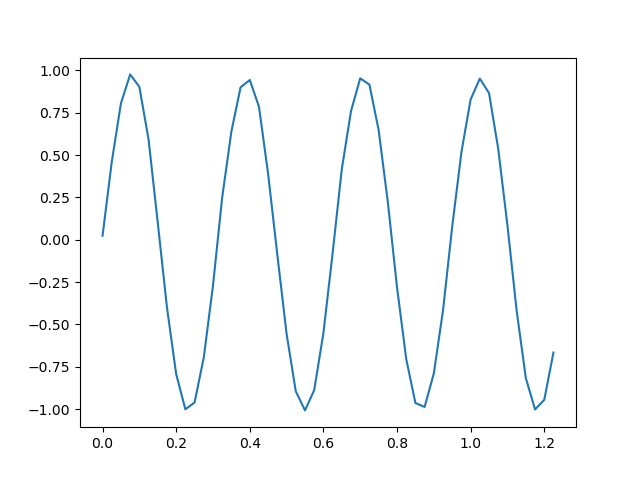

Train Epoch: 495, Loss: 0.009834


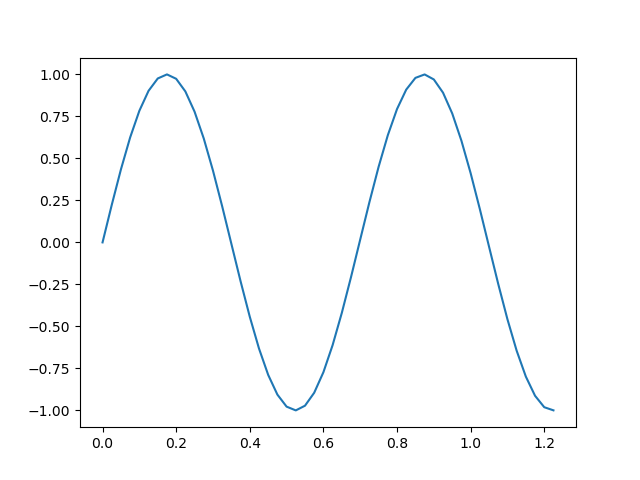

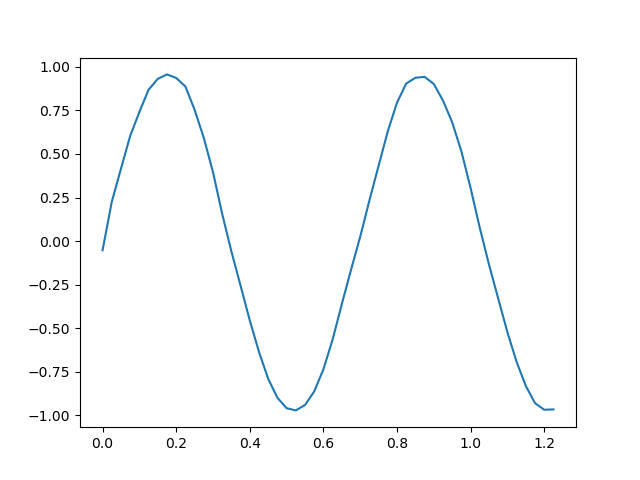

Train Epoch: 500, Loss: 0.003762


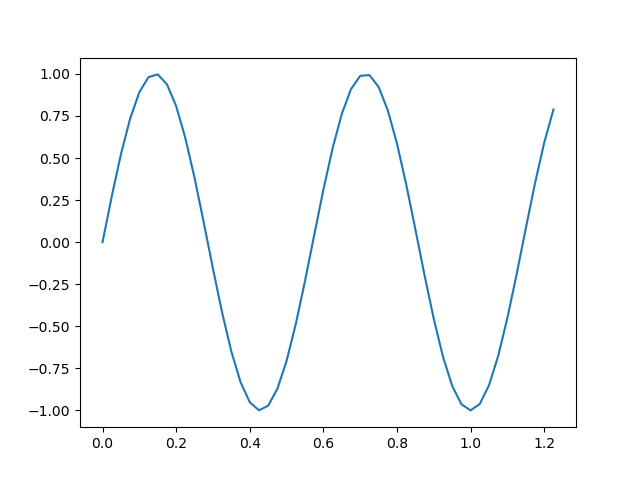

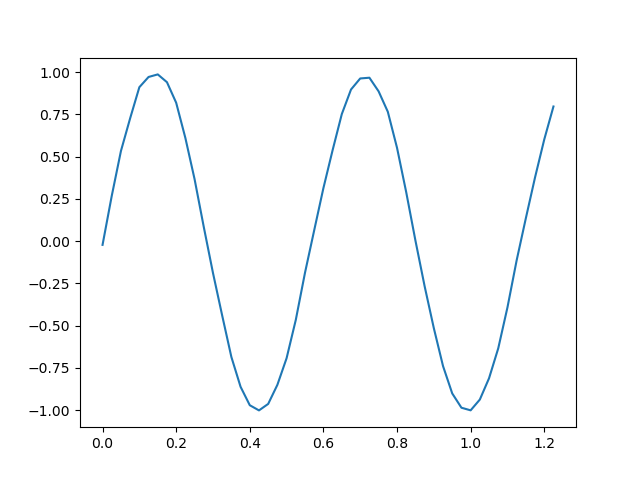

Train Epoch: 505, Loss: 0.003271


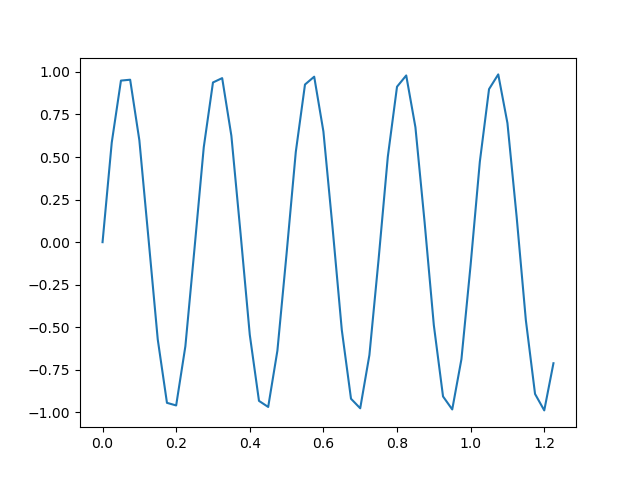

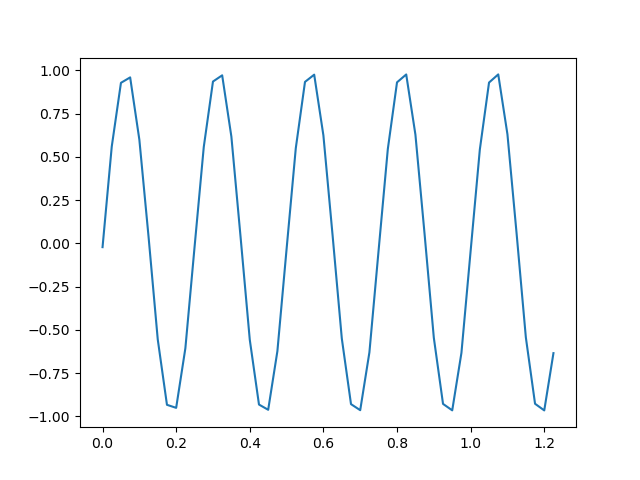

Train Epoch: 510, Loss: 0.006826


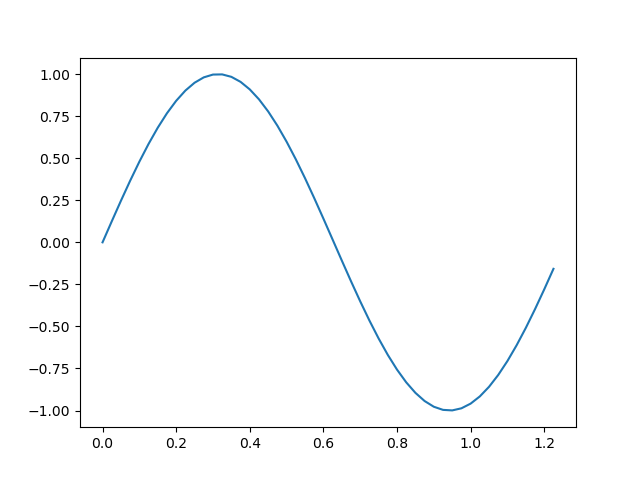

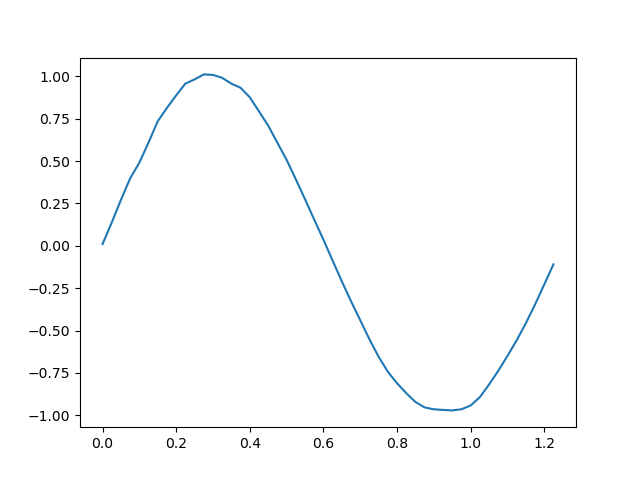

Train Epoch: 515, Loss: 0.002098


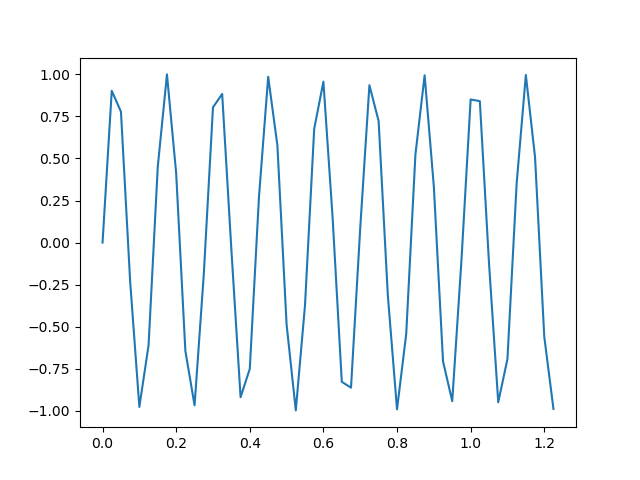

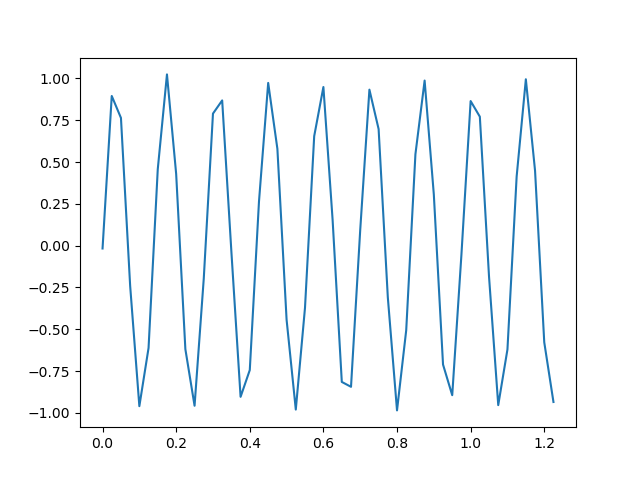

Train Epoch: 520, Loss: 0.000717


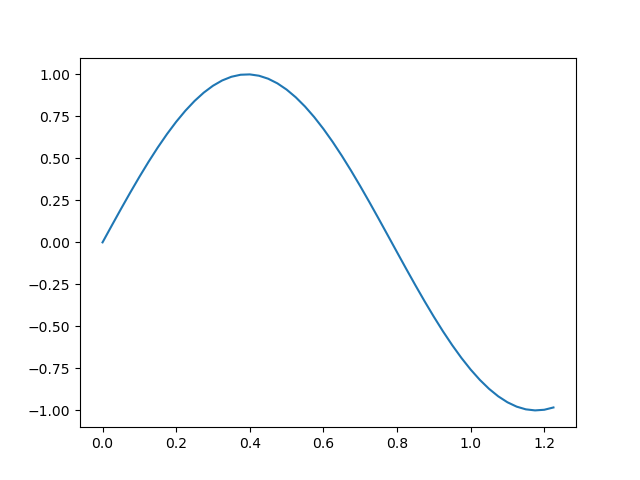

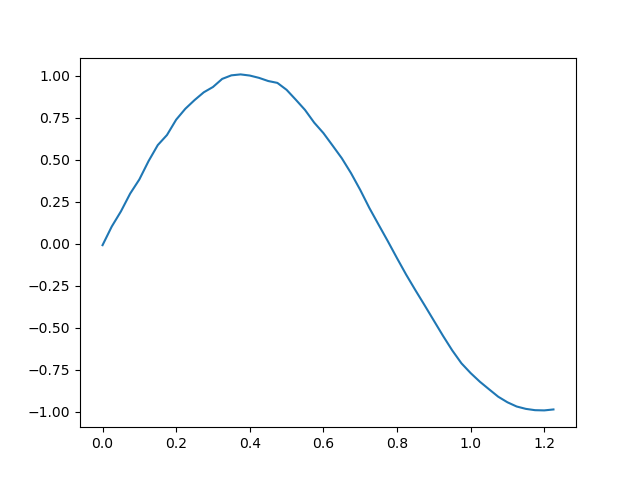

Train Epoch: 525, Loss: 0.000337


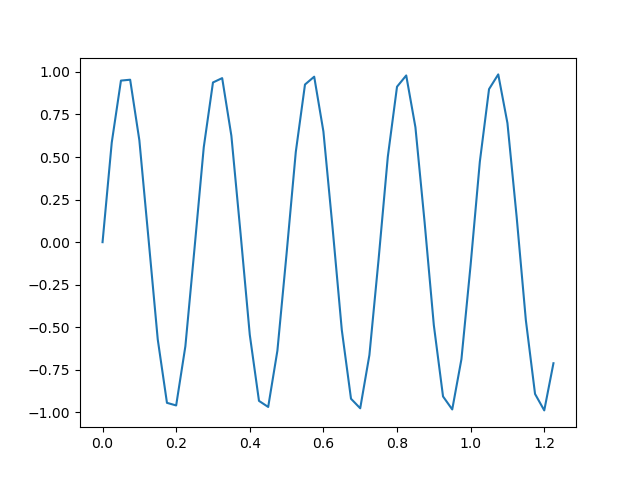

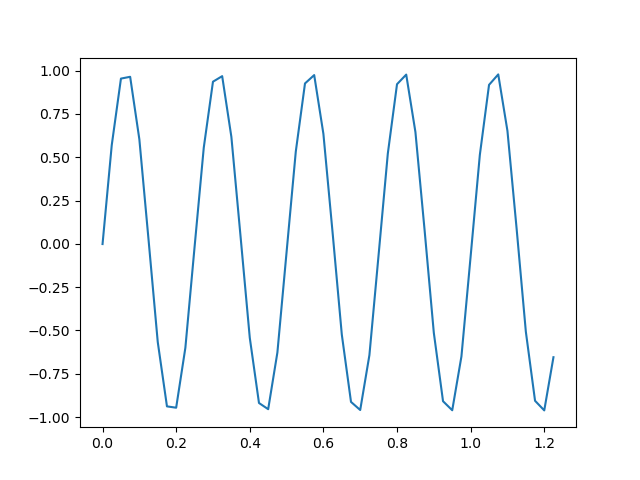

Train Epoch: 530, Loss: 0.000234


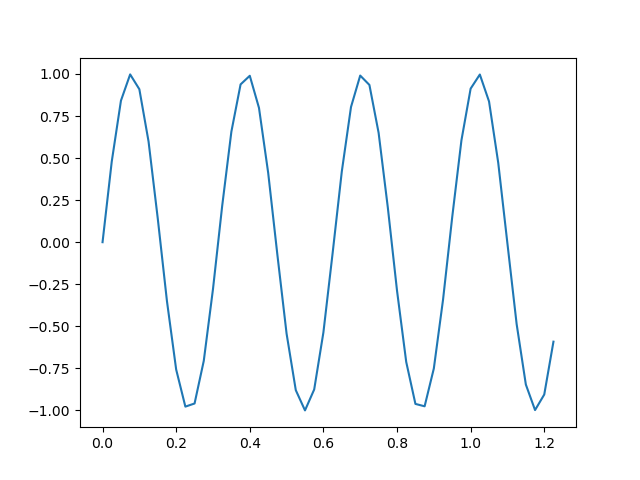

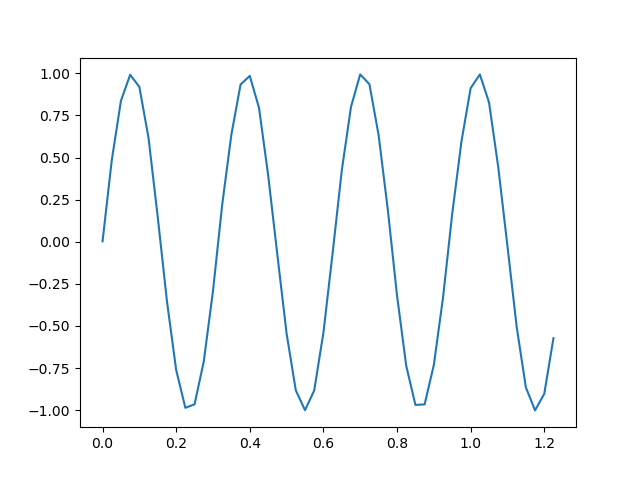

Train Epoch: 535, Loss: 0.000181


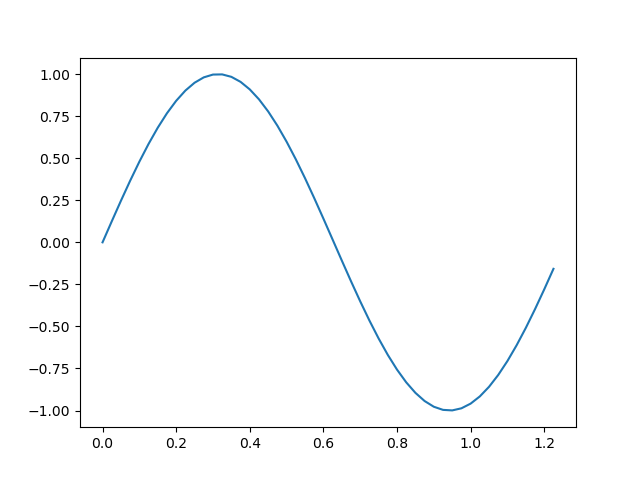

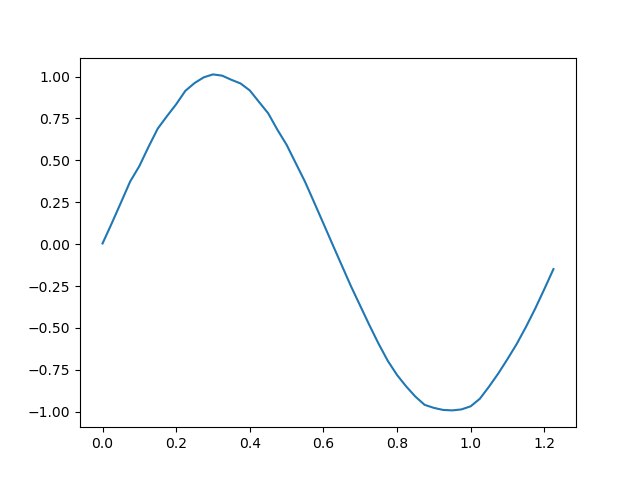

Train Epoch: 540, Loss: 0.000130


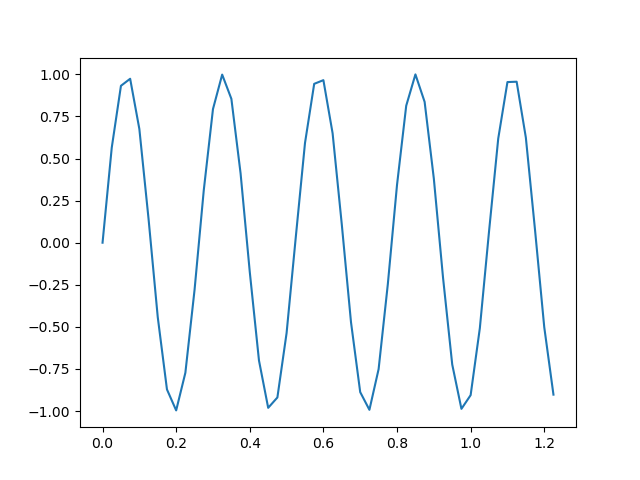

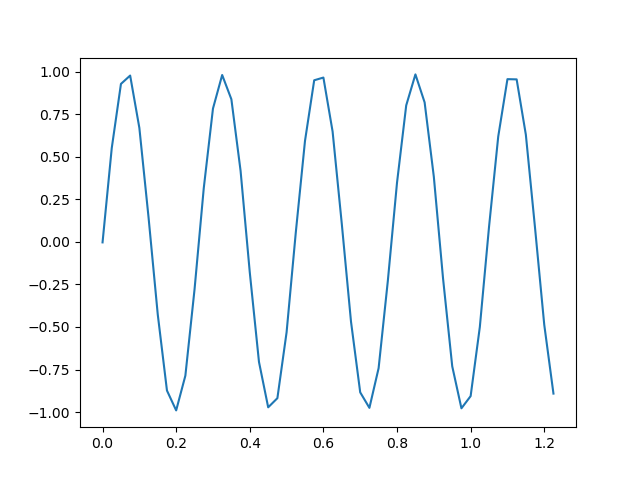

Train Epoch: 545, Loss: 0.000120


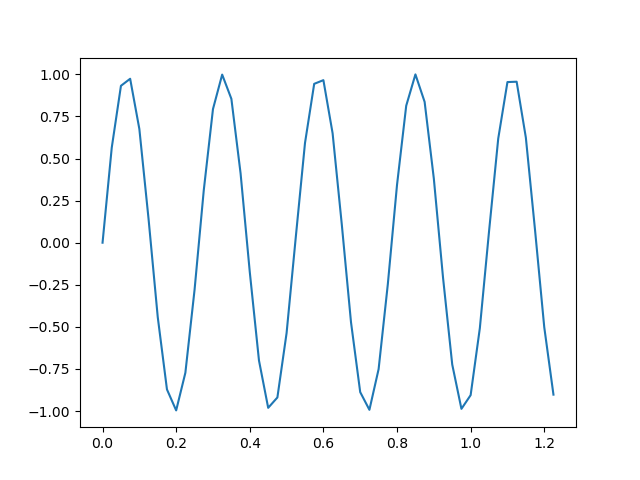

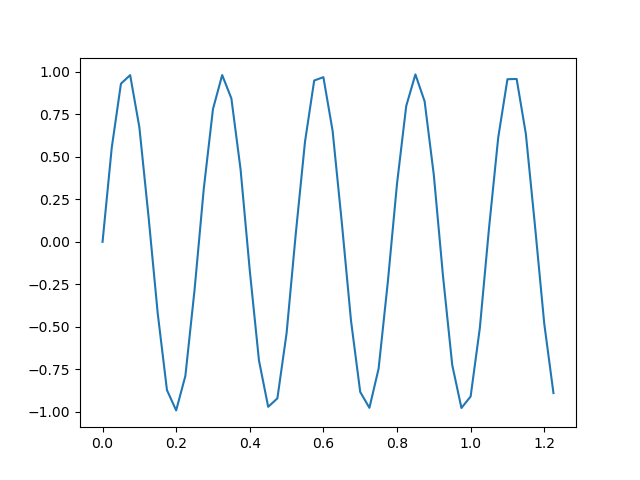

Train Epoch: 550, Loss: 0.000107


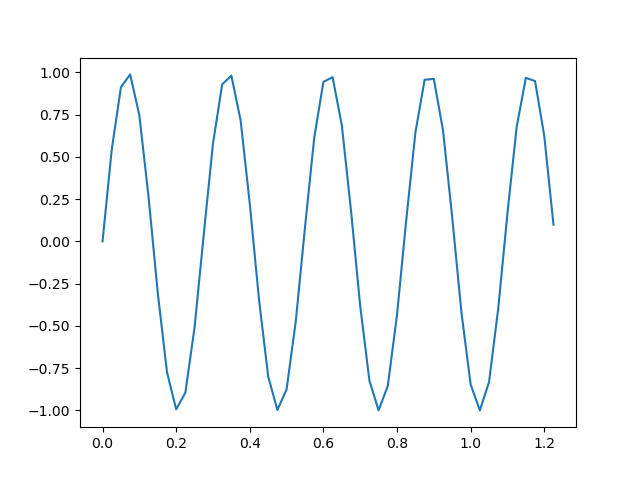

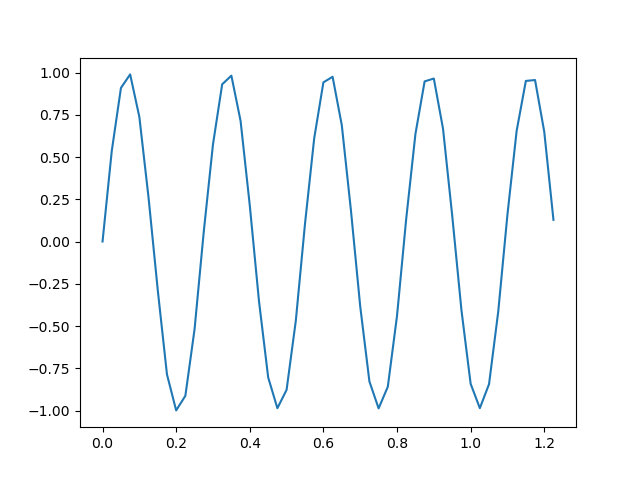

Train Epoch: 555, Loss: 0.000094


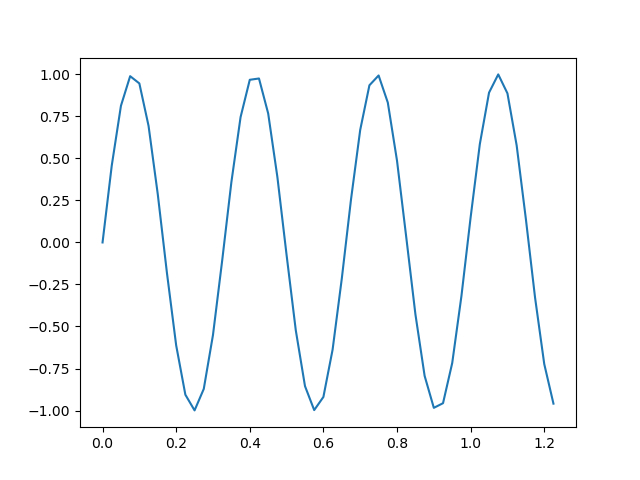

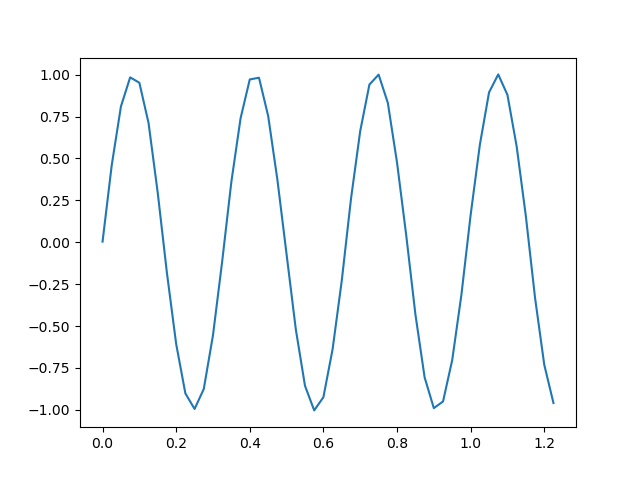

Train Epoch: 560, Loss: 0.000103


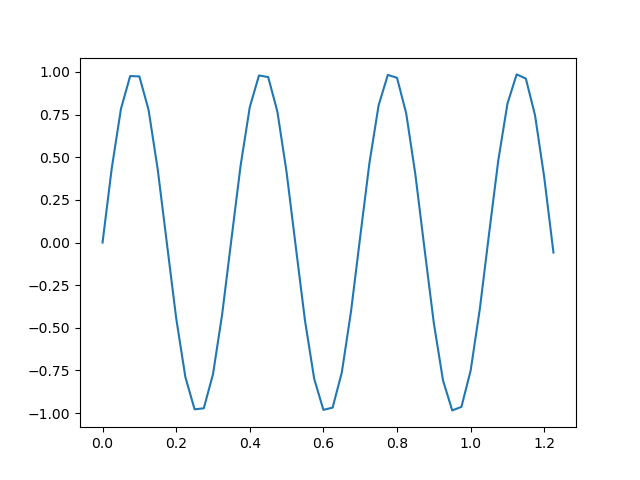

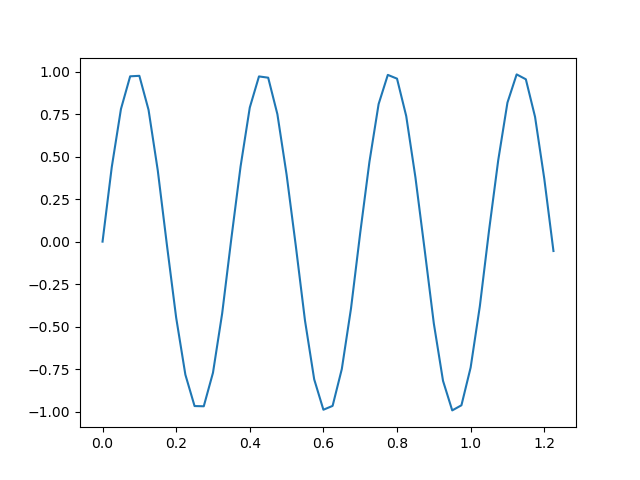

Train Epoch: 565, Loss: 0.000098


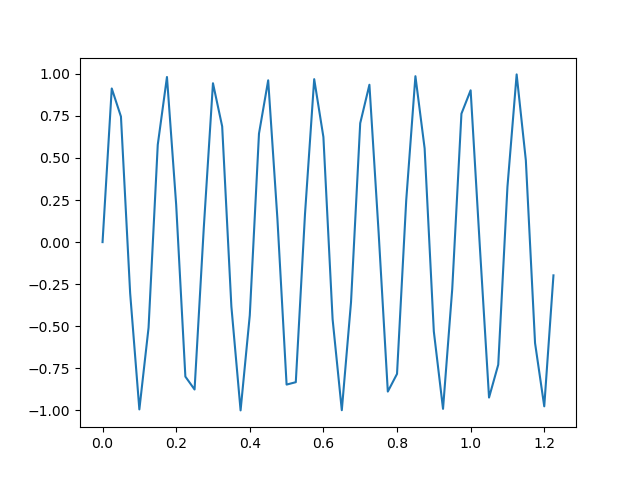

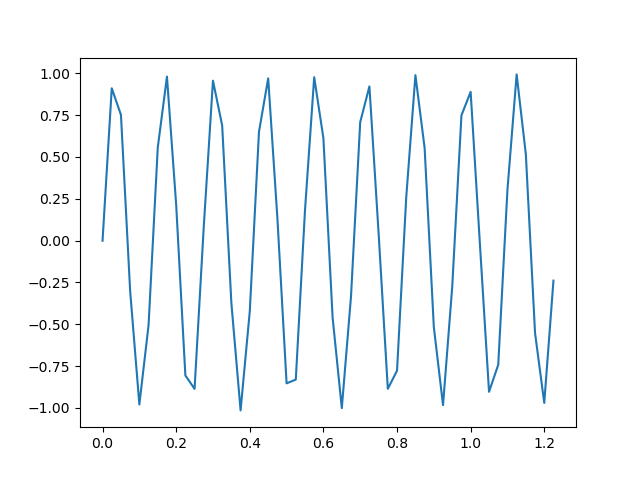

Train Epoch: 570, Loss: 0.000094


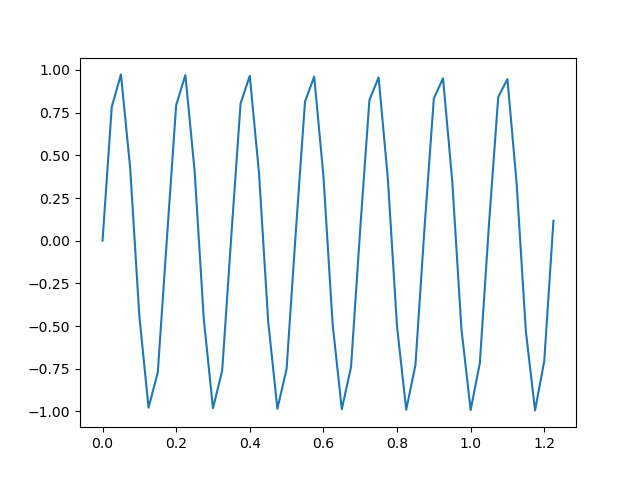

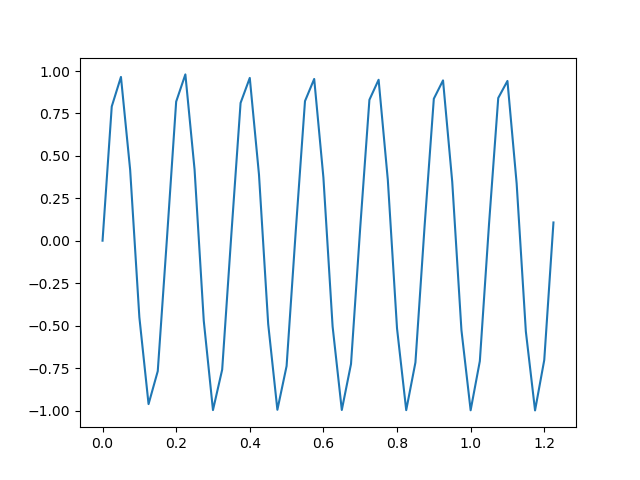

Train Epoch: 575, Loss: 0.000094


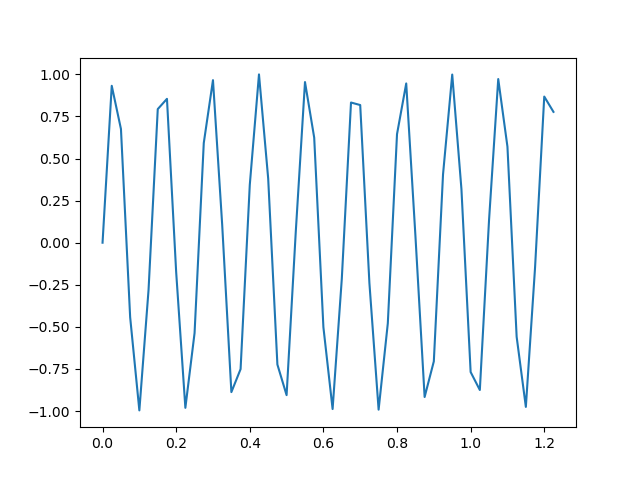

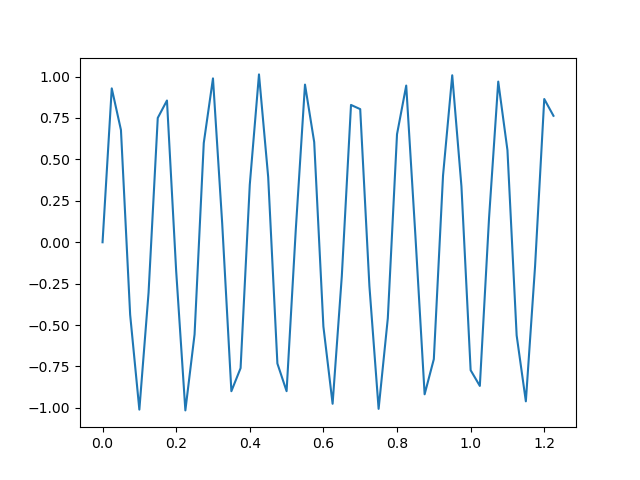

Train Epoch: 580, Loss: 0.000078


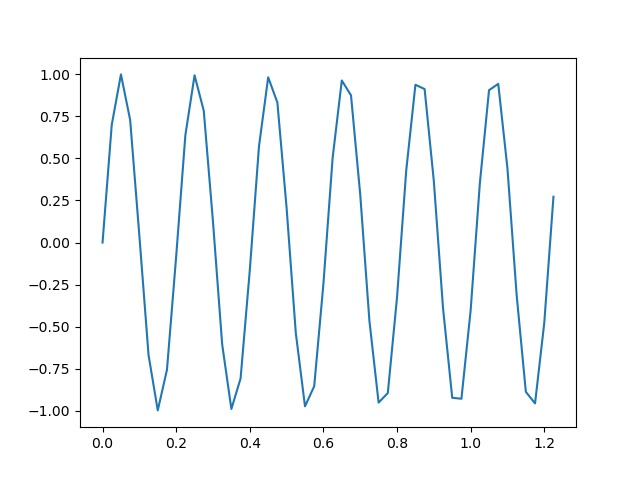

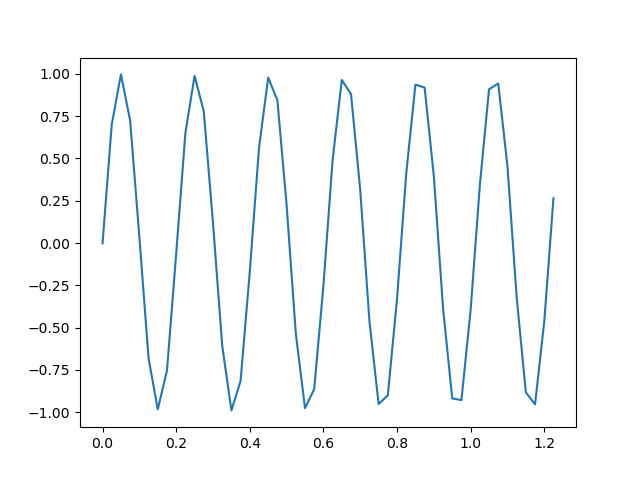

Train Epoch: 585, Loss: 0.000080


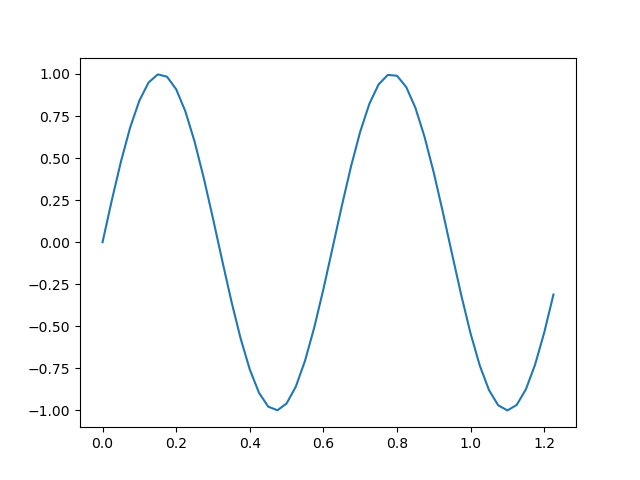

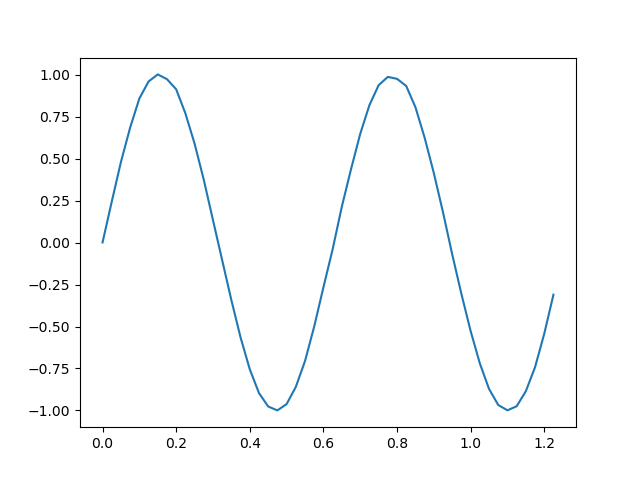

Train Epoch: 590, Loss: 0.000075


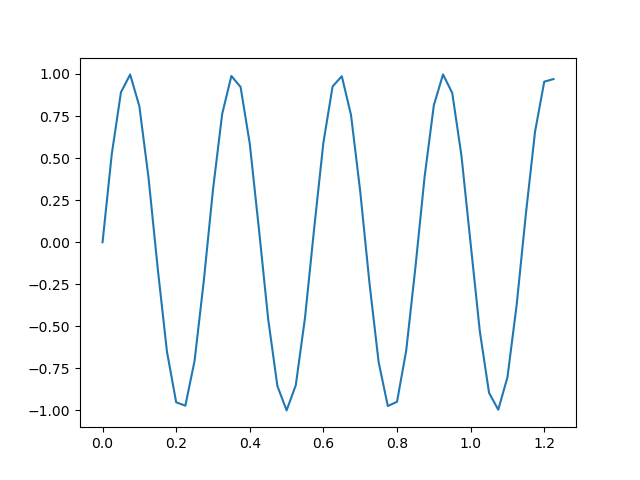

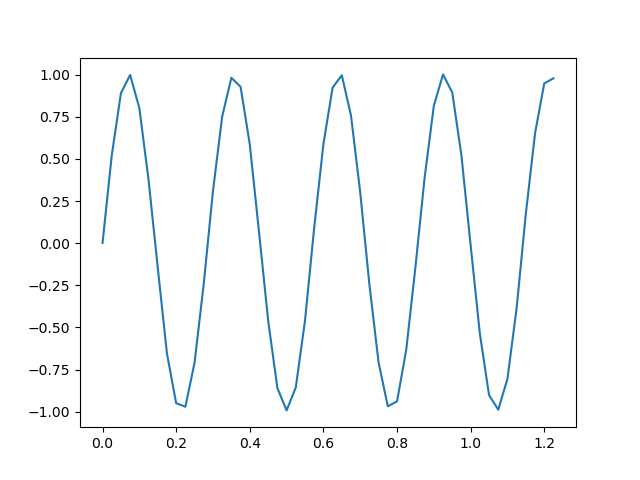

Train Epoch: 595, Loss: 0.000067


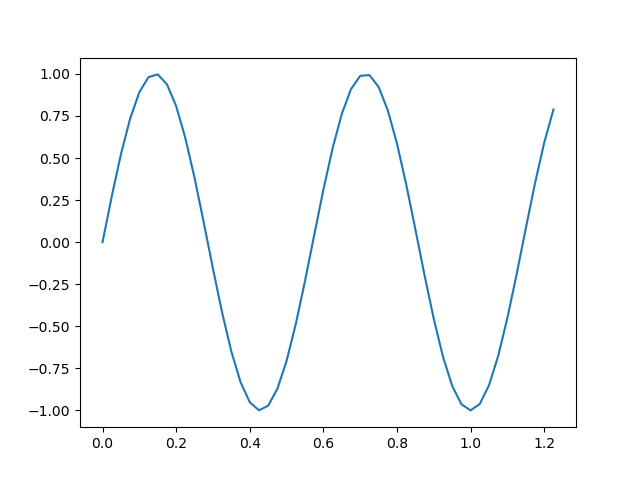

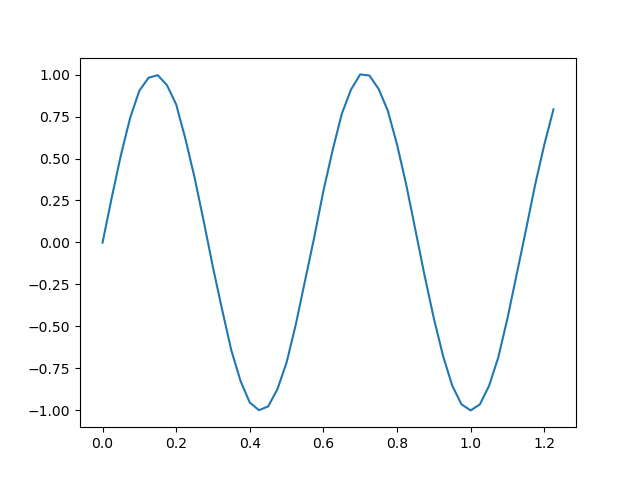

Train Epoch: 600, Loss: 0.000063


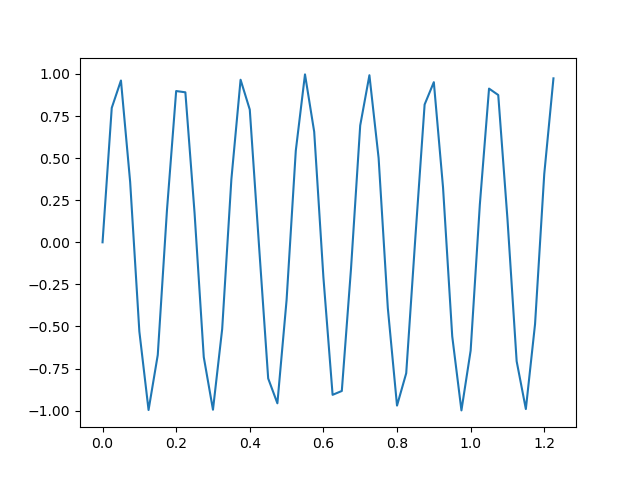

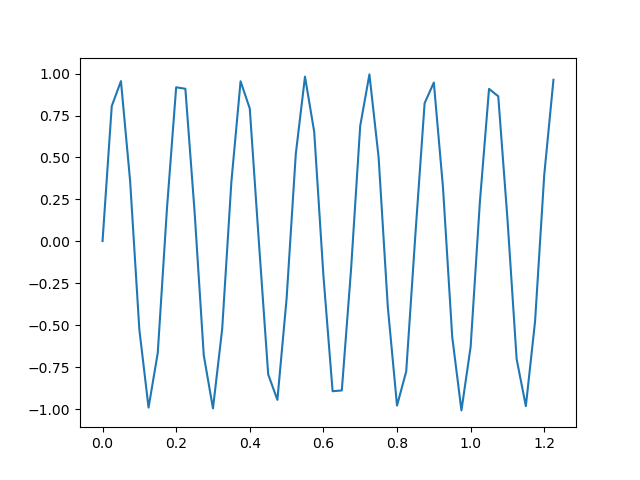

Train Epoch: 605, Loss: 0.000059


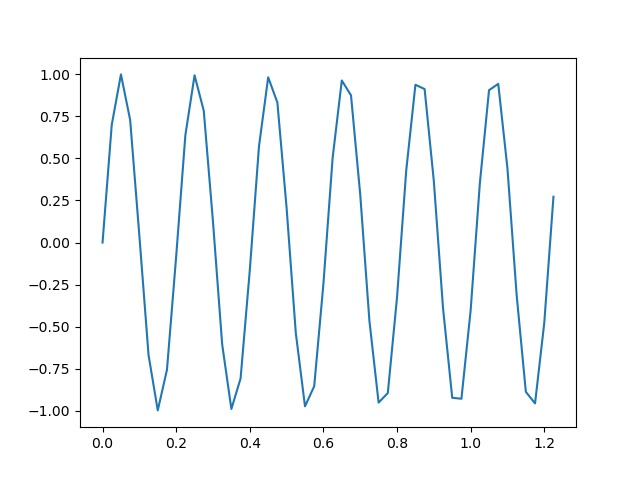

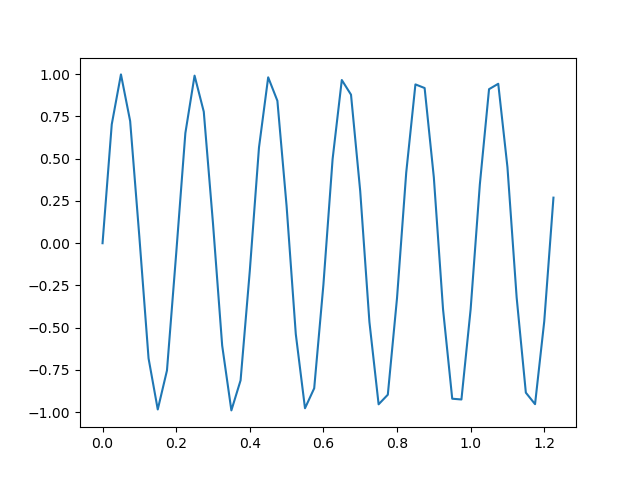

Train Epoch: 610, Loss: 0.000065


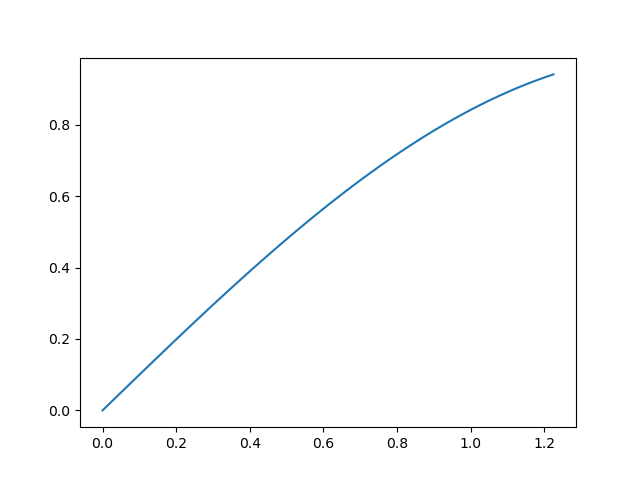

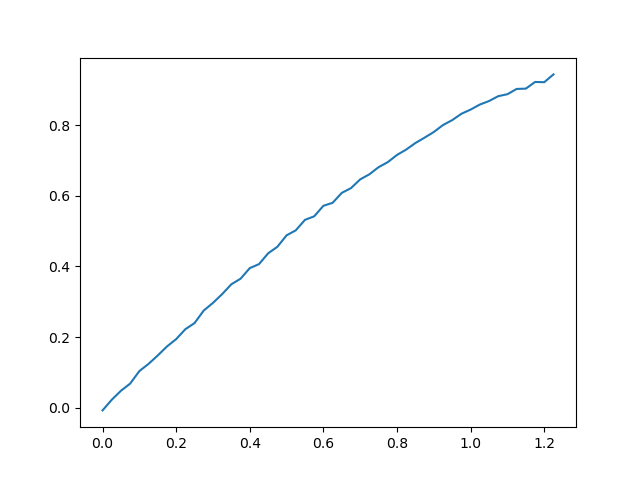

Train Epoch: 615, Loss: 0.000077


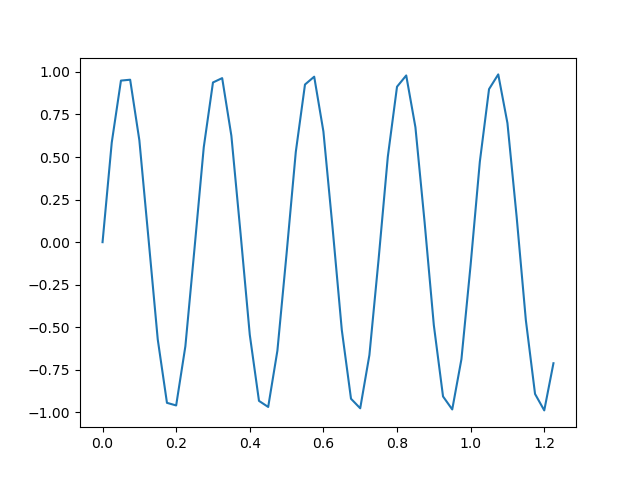

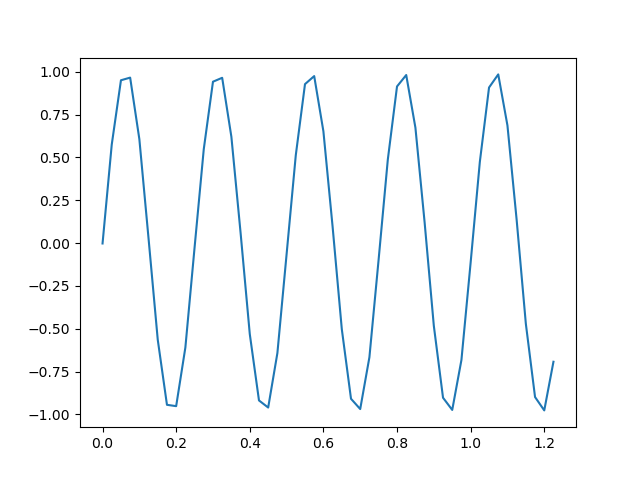

Train Epoch: 620, Loss: 0.000117


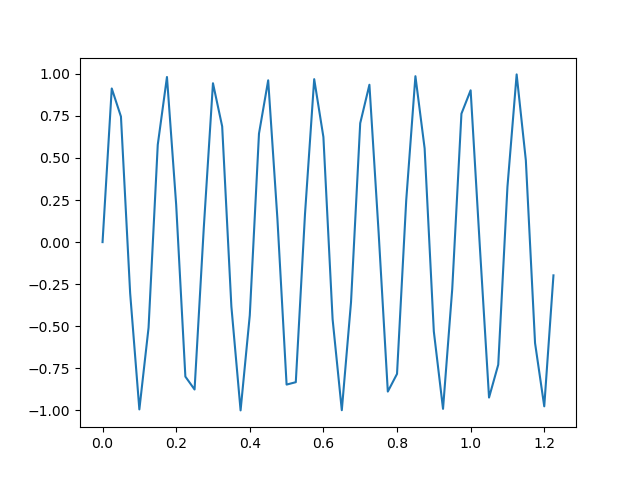

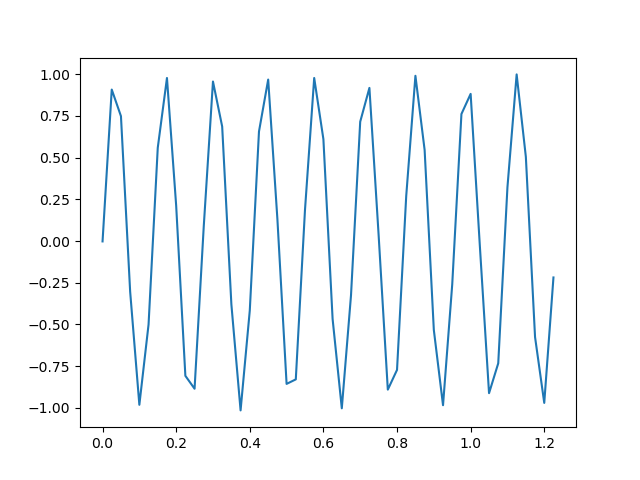

Train Epoch: 625, Loss: 0.000085


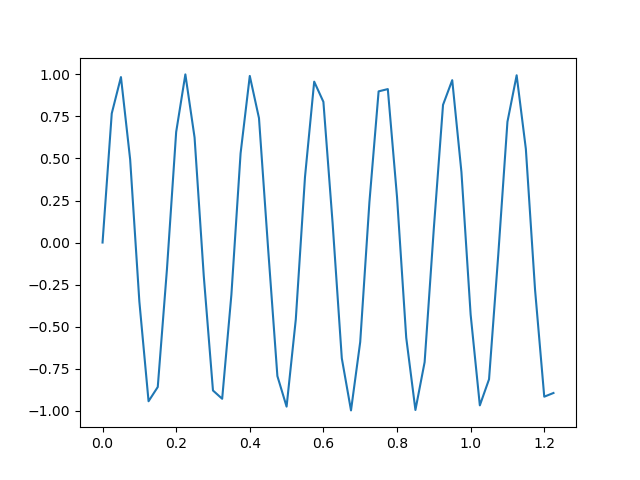

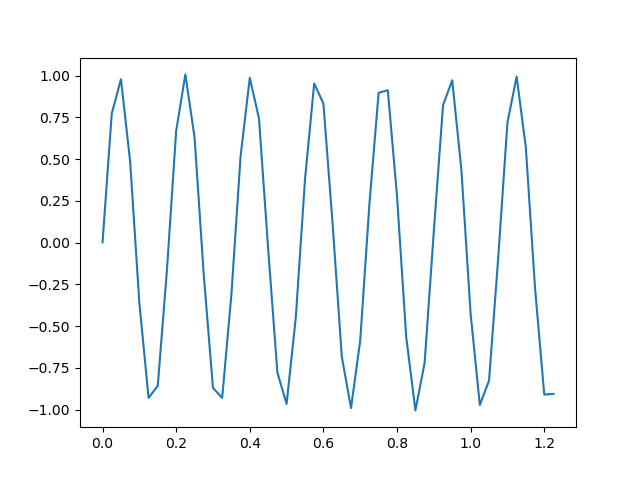

Train Epoch: 630, Loss: 0.000074


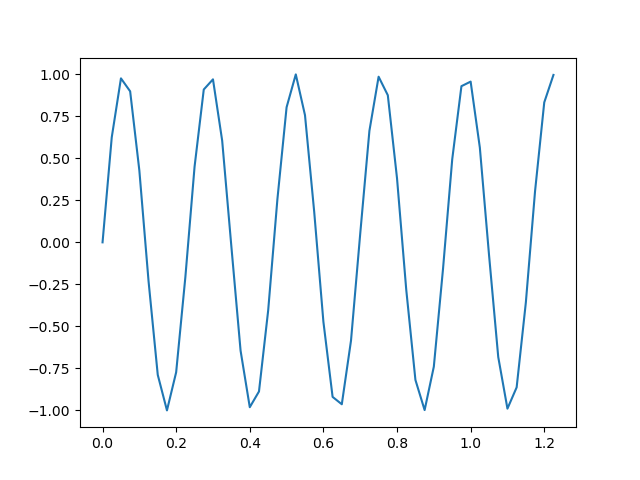

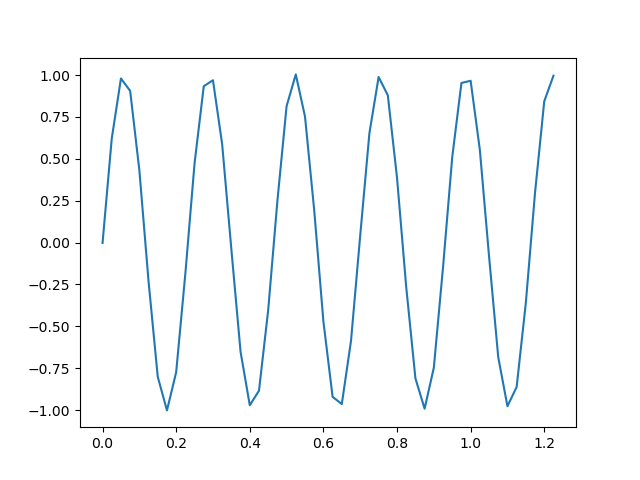

Train Epoch: 635, Loss: 0.000057


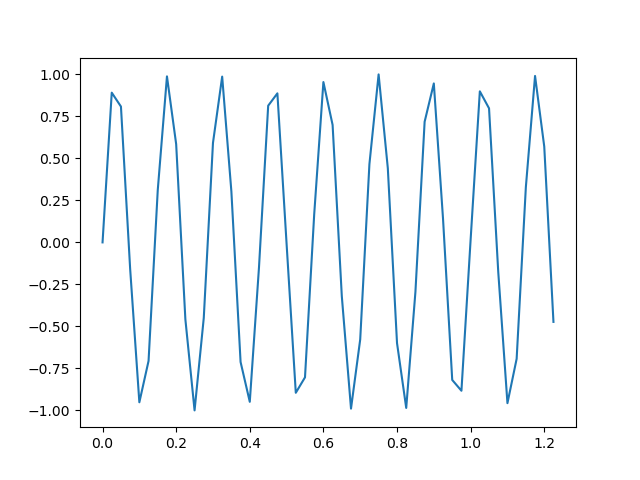

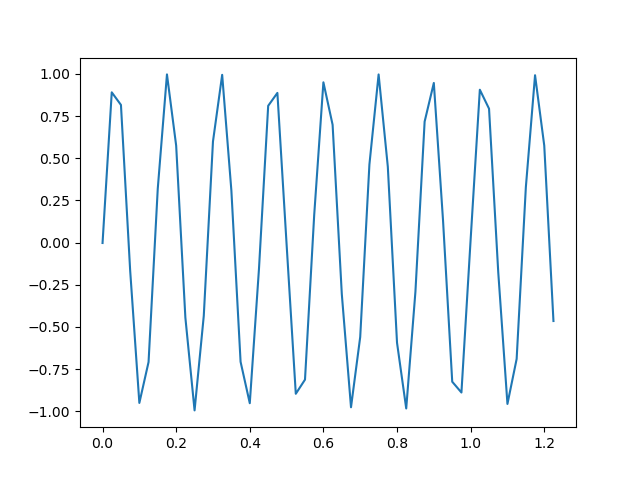

Train Epoch: 640, Loss: 0.000058


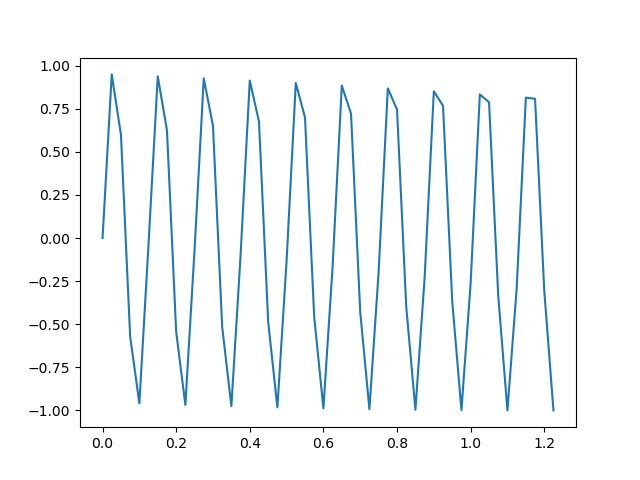

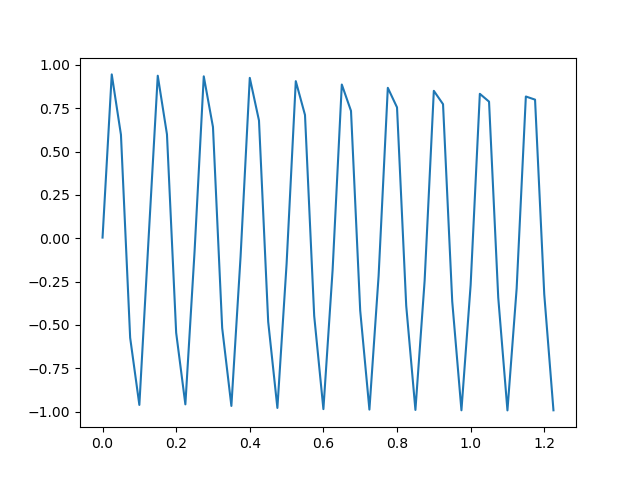

Train Epoch: 645, Loss: 0.000057


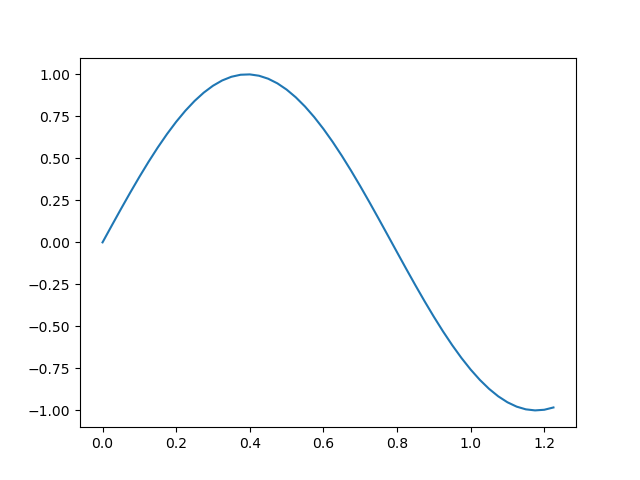

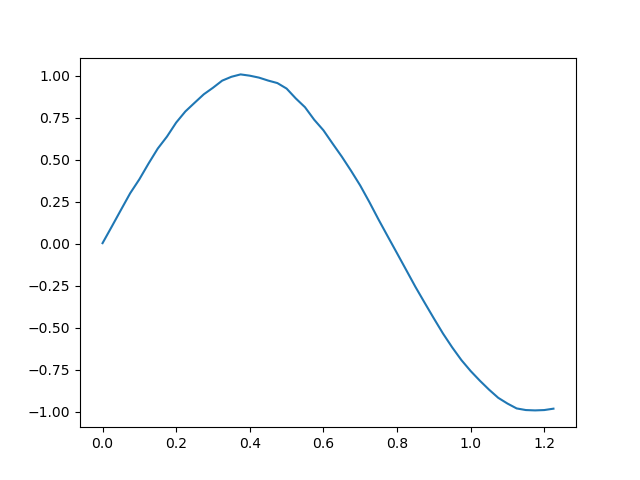

Train Epoch: 650, Loss: 0.000058


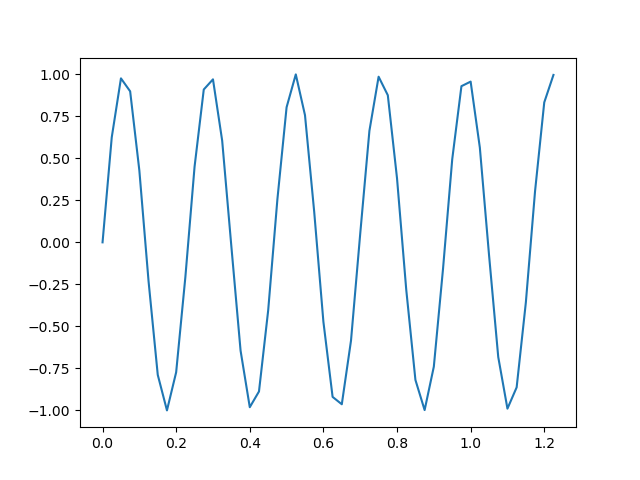

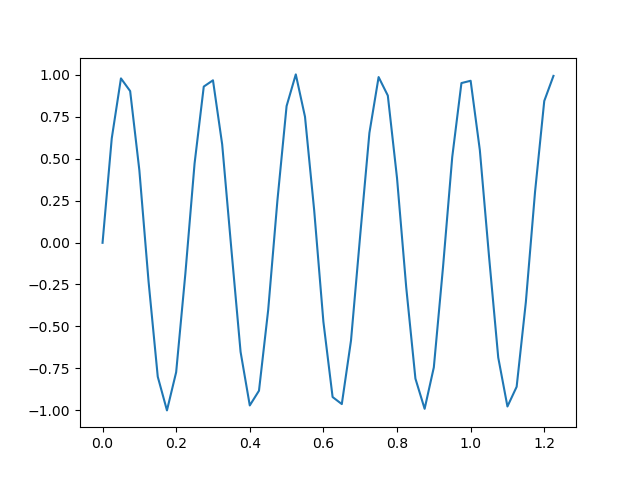

Train Epoch: 655, Loss: 0.000064


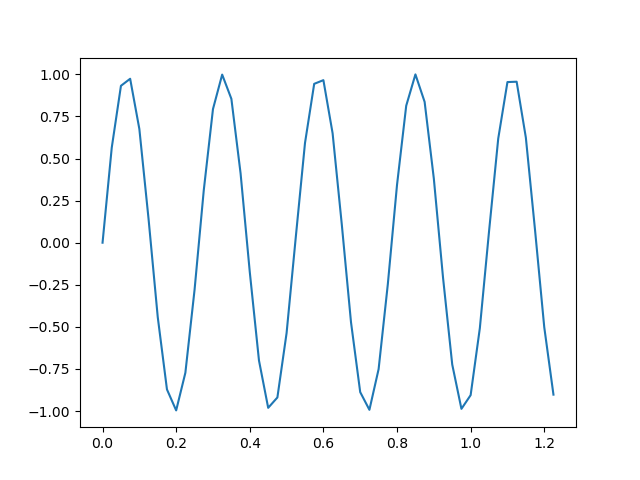

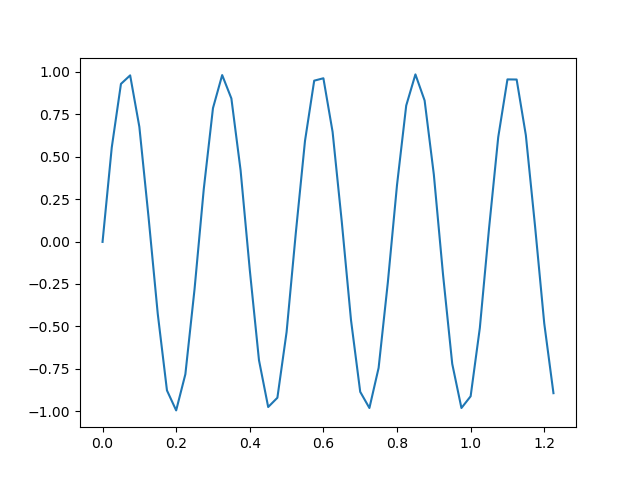

Train Epoch: 660, Loss: 0.000089


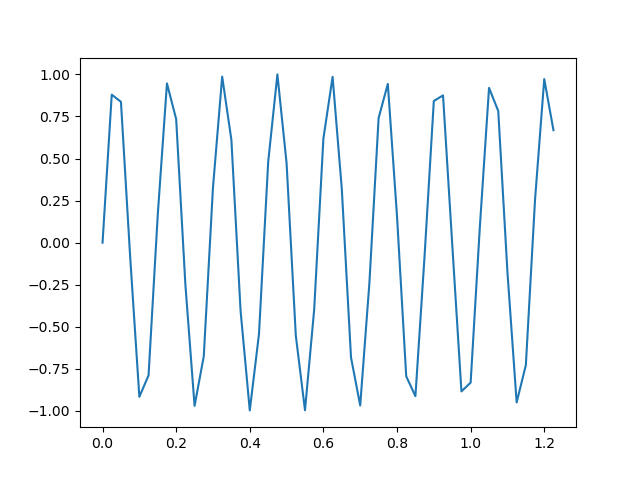

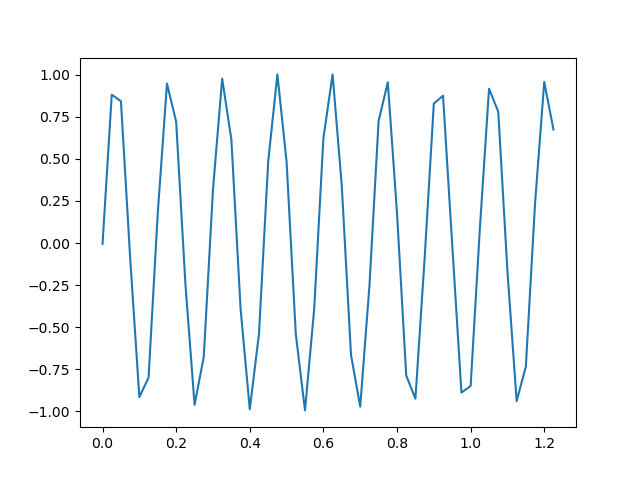

Train Epoch: 665, Loss: 0.000062


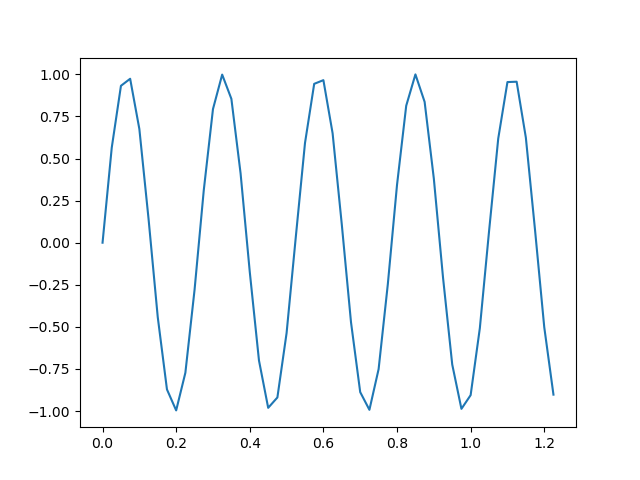

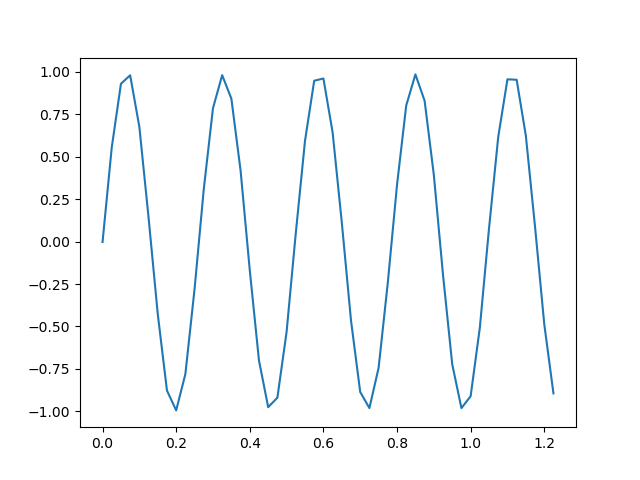

Train Epoch: 670, Loss: 0.000054


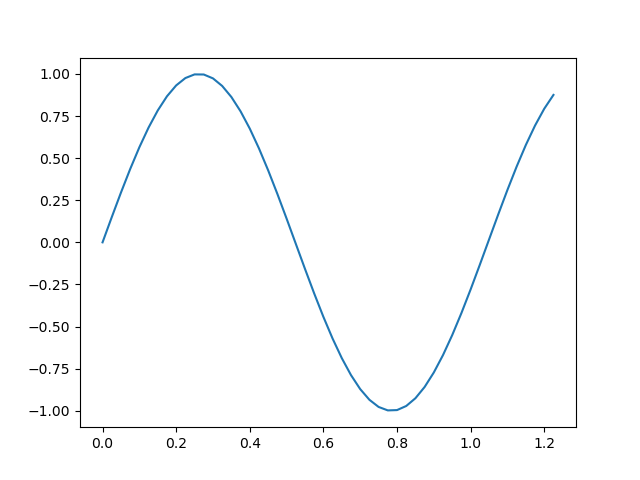

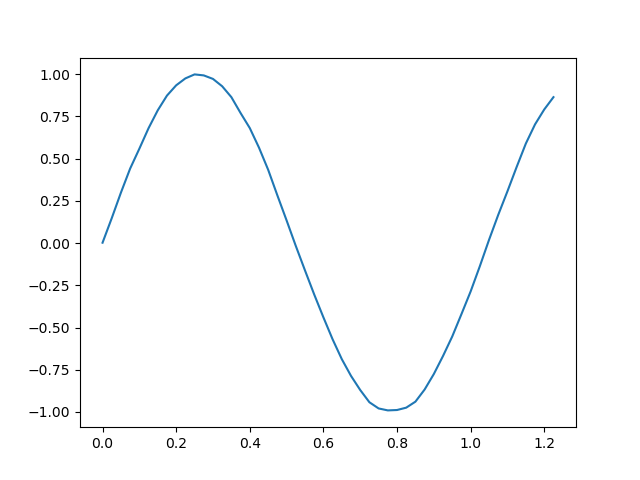

Train Epoch: 675, Loss: 0.000054


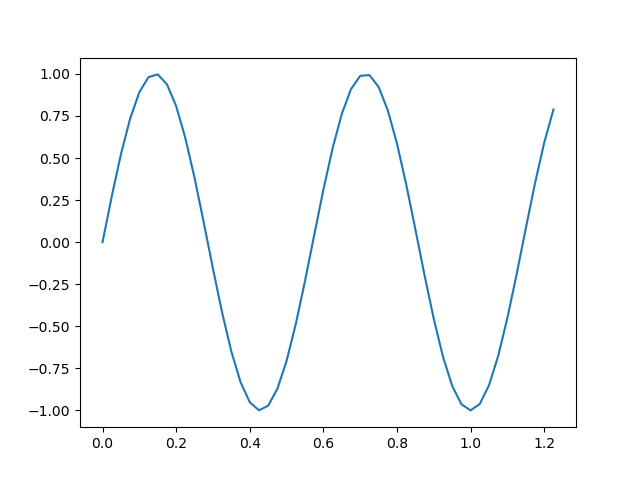

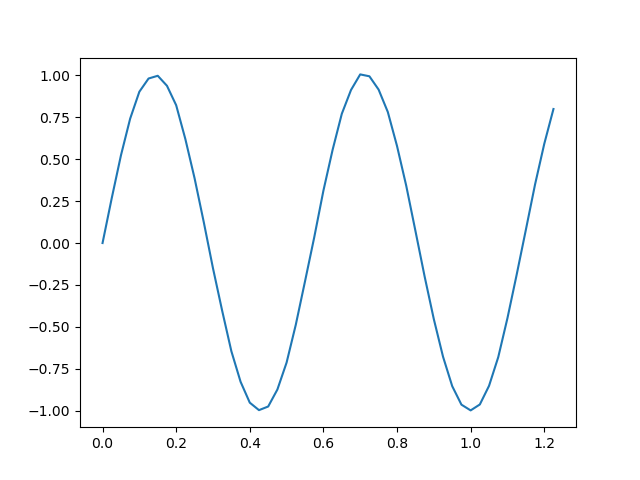

Train Epoch: 680, Loss: 0.000058


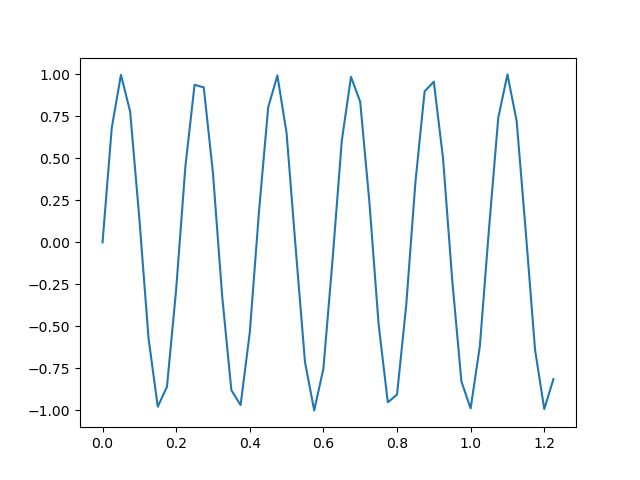

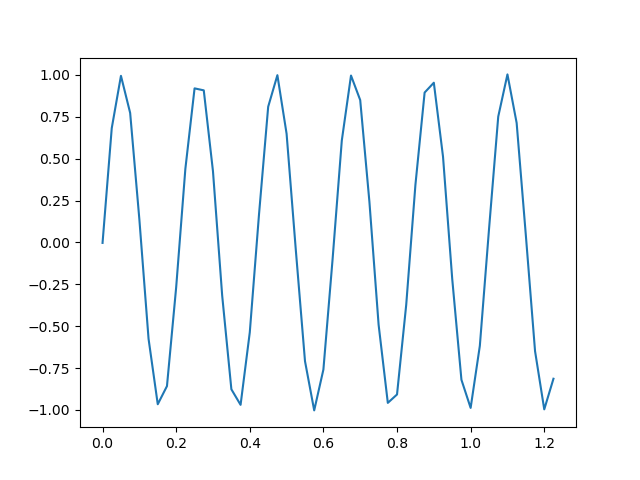

Train Epoch: 685, Loss: 0.000060


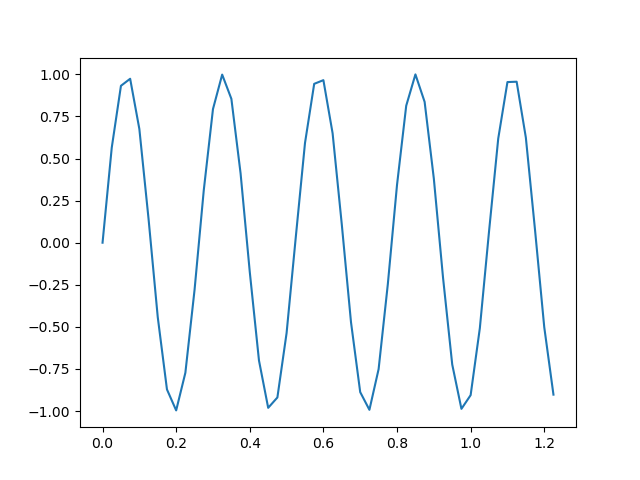

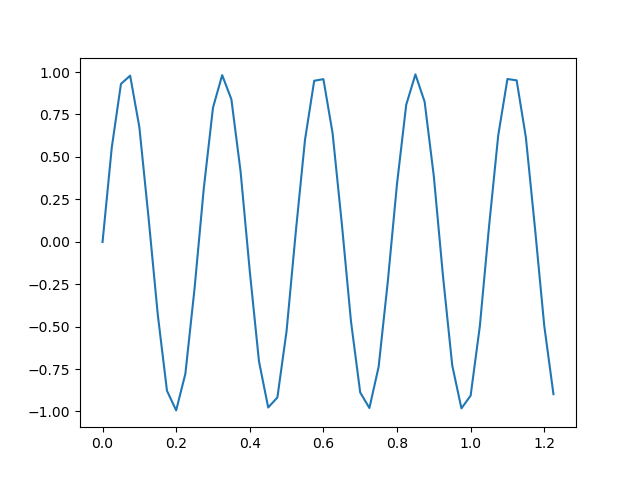

Train Epoch: 690, Loss: 0.000072


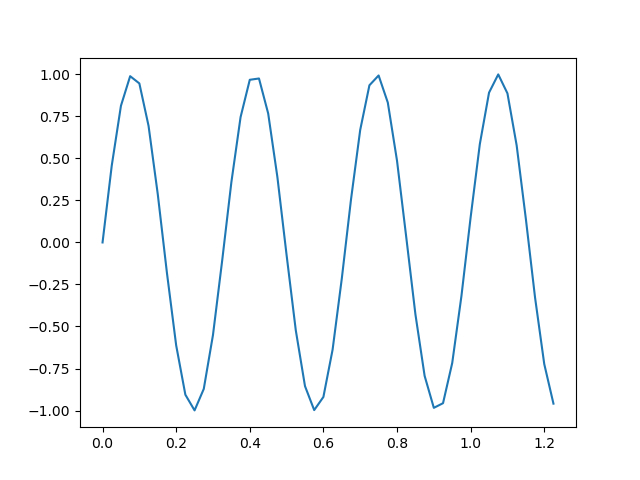

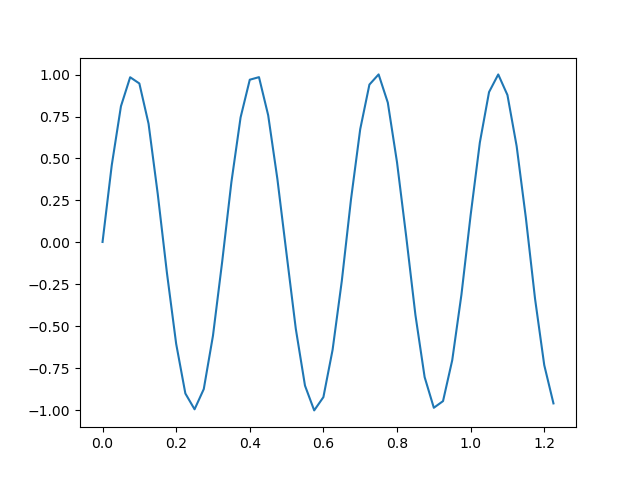

Train Epoch: 695, Loss: 0.000058


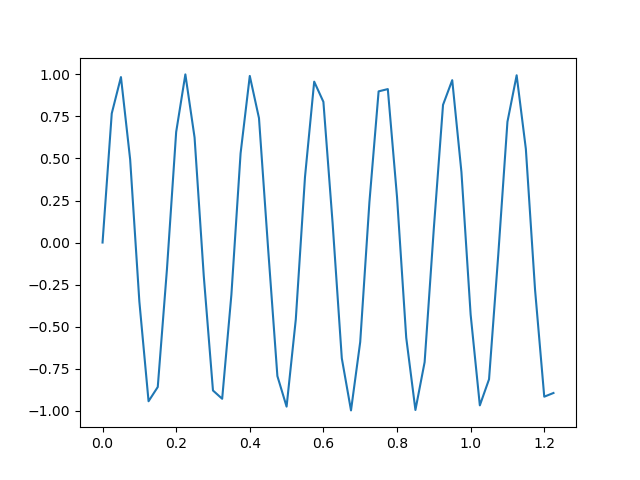

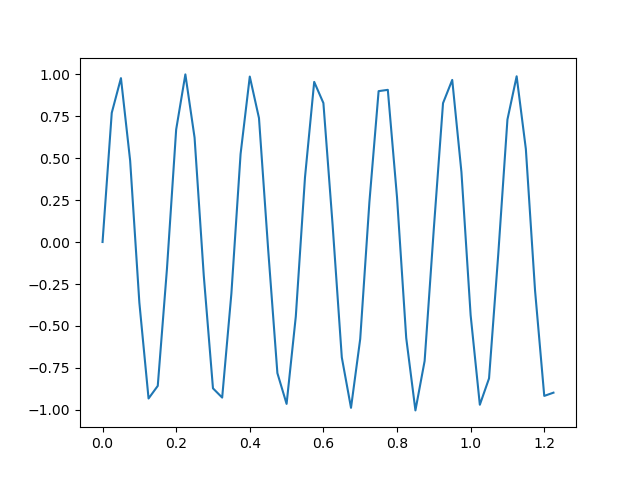

Train Epoch: 700, Loss: 0.000048


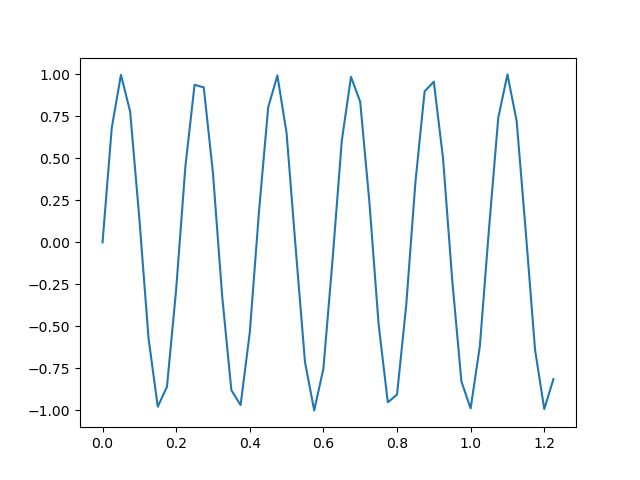

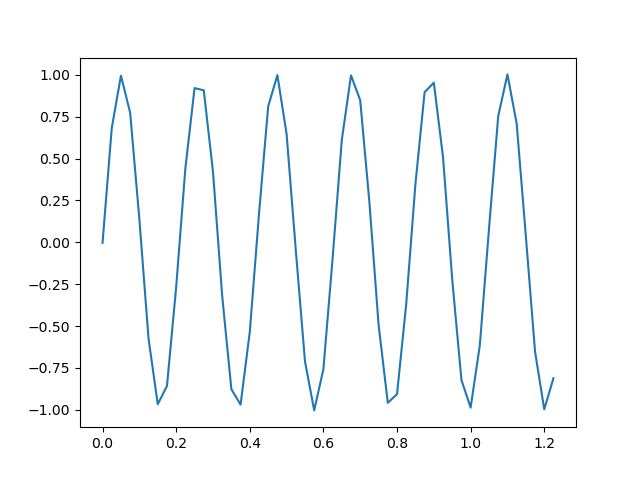

Train Epoch: 705, Loss: 0.000071


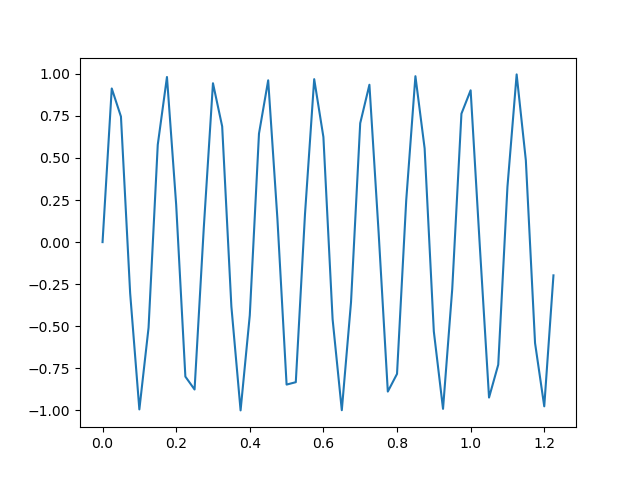

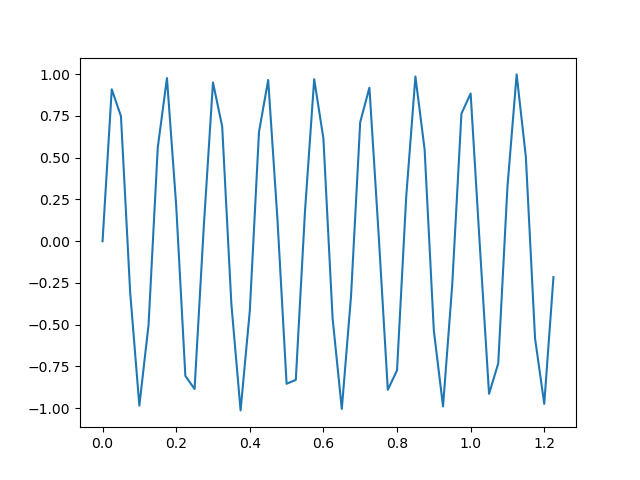

Train Epoch: 710, Loss: 0.000316


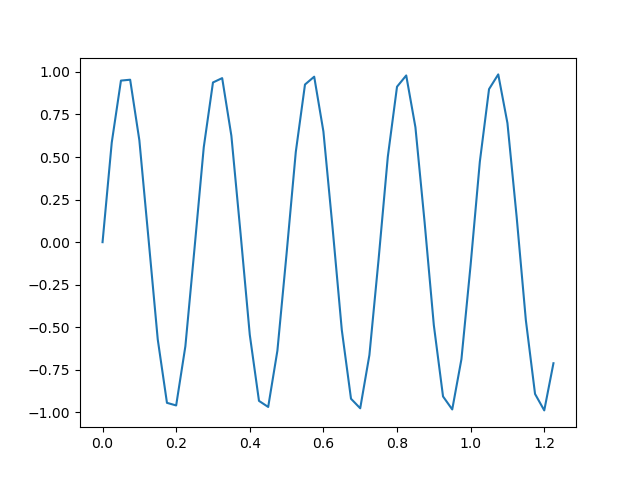

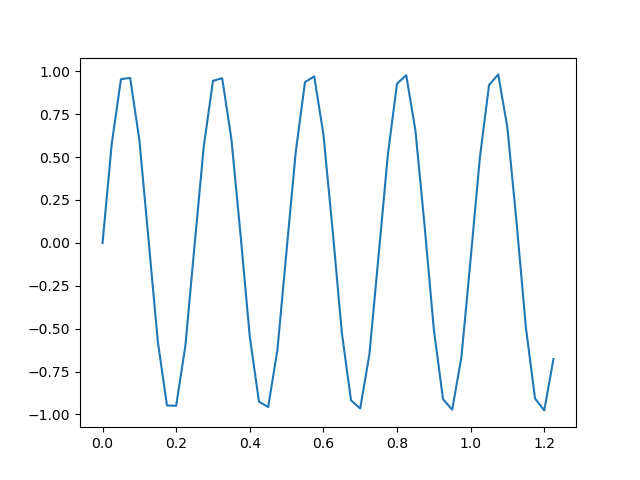

Train Epoch: 715, Loss: 0.000108


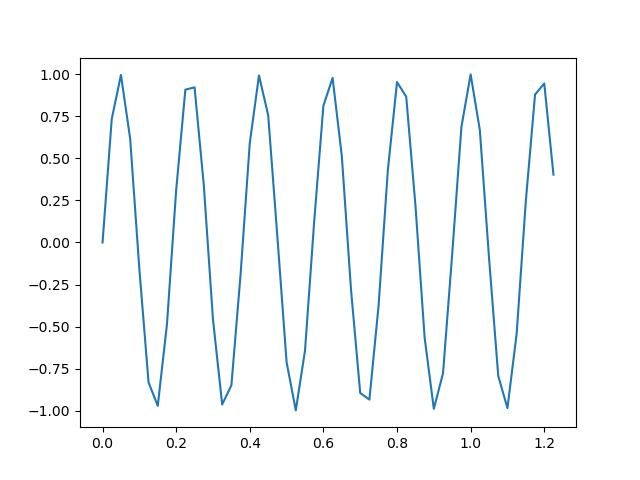

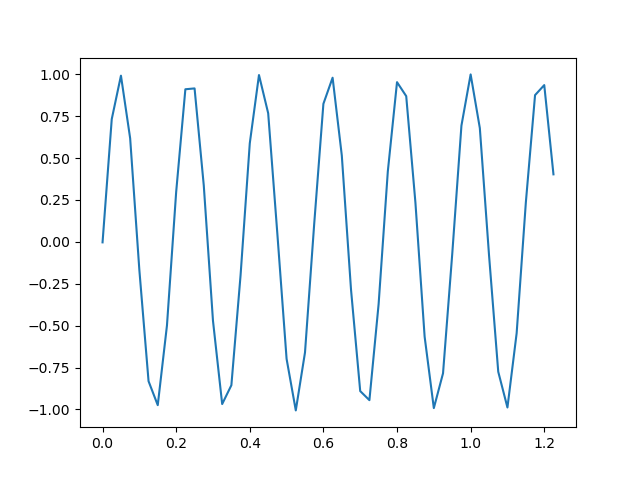

Train Epoch: 720, Loss: 0.000130


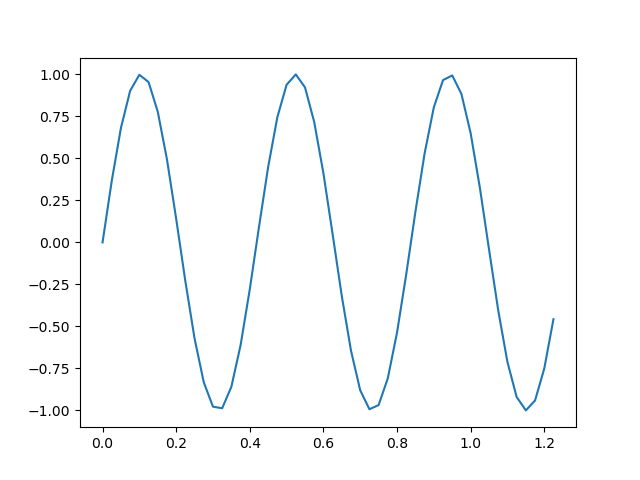

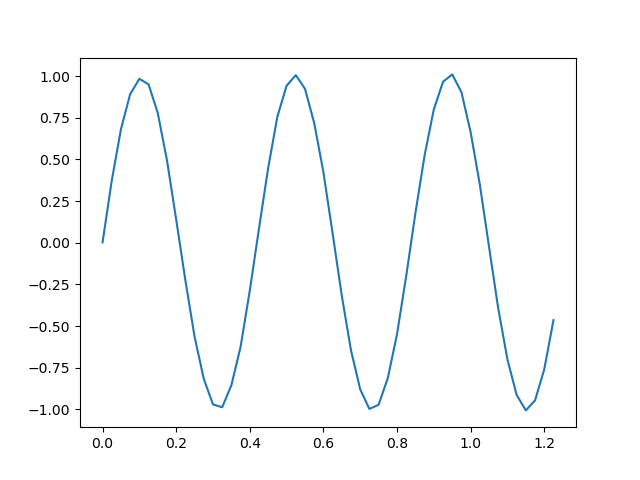

Train Epoch: 725, Loss: 0.002540


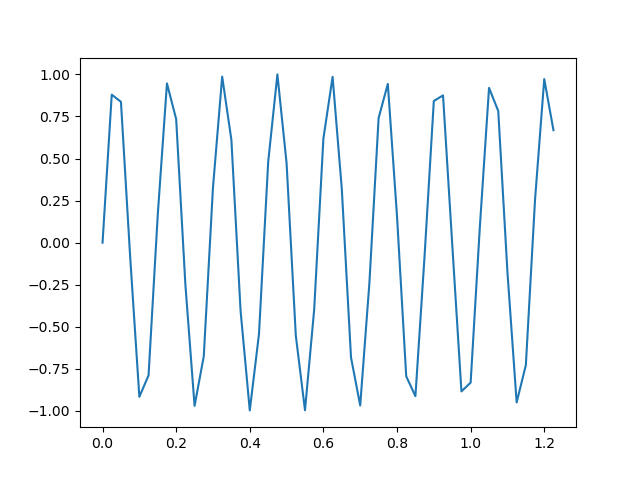

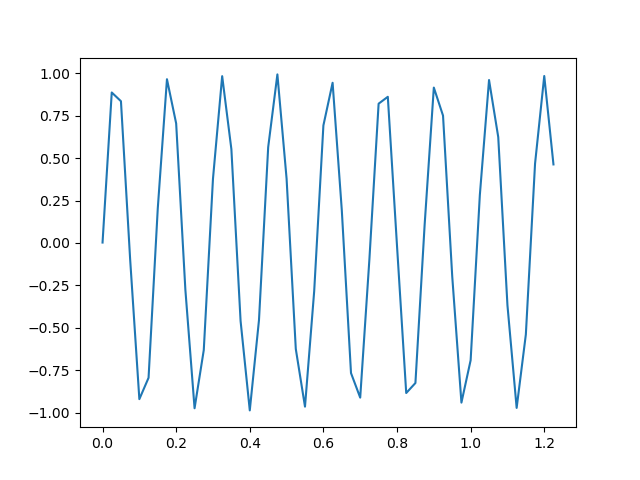

Train Epoch: 730, Loss: 0.001791


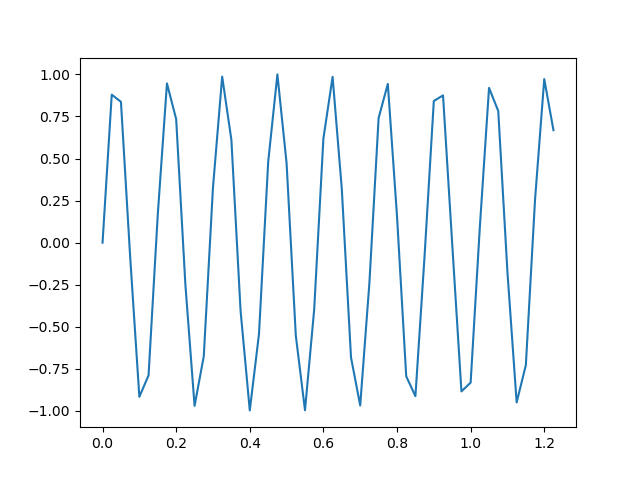

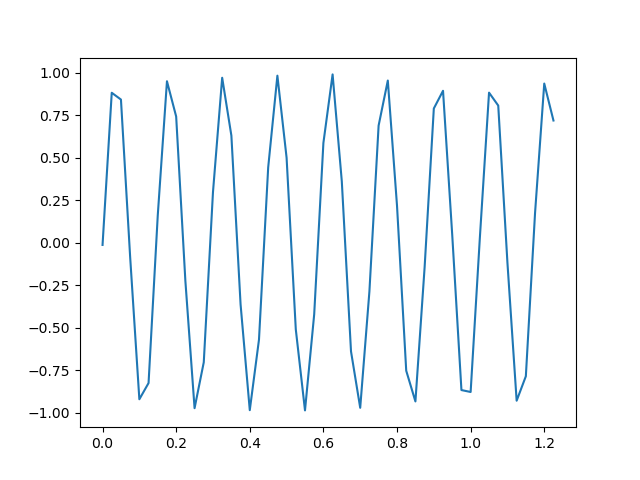

Train Epoch: 735, Loss: 0.017731


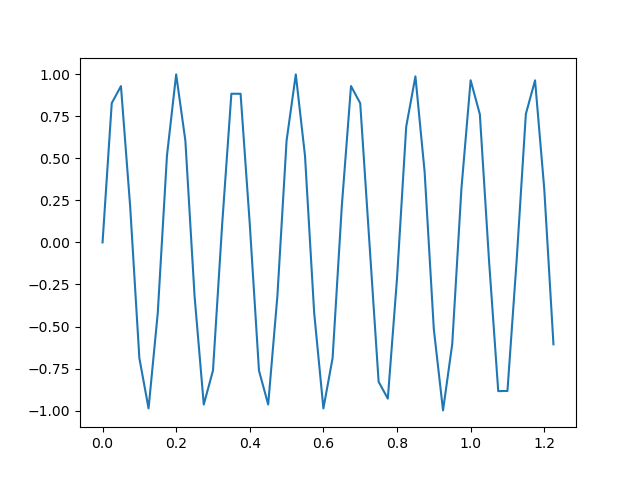

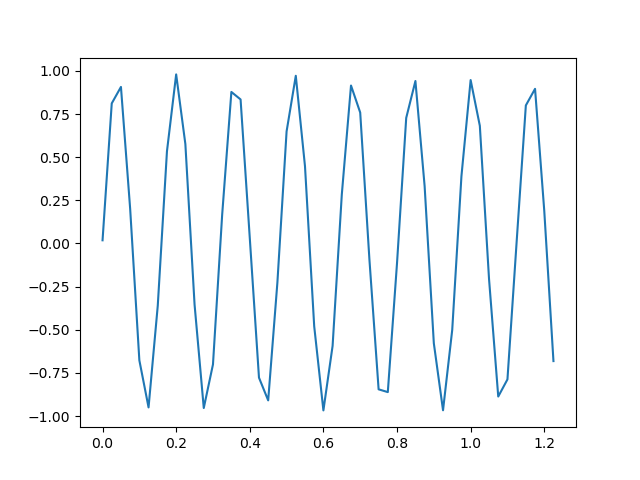

Train Epoch: 740, Loss: 0.030043


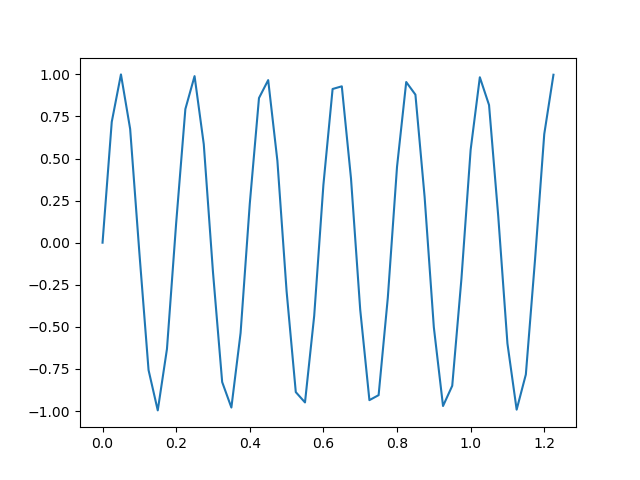

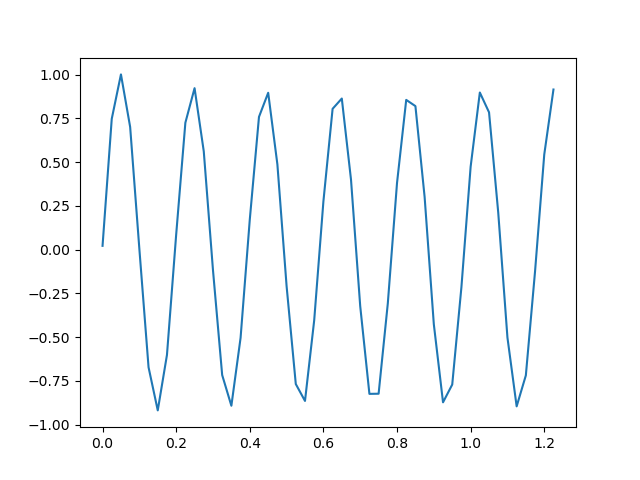

Train Epoch: 745, Loss: 0.060335


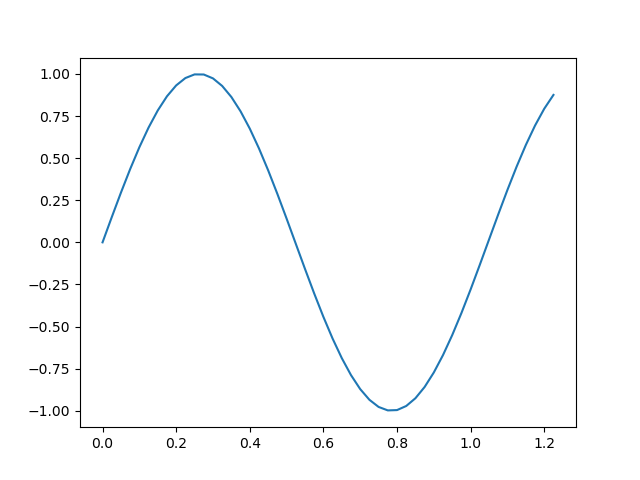

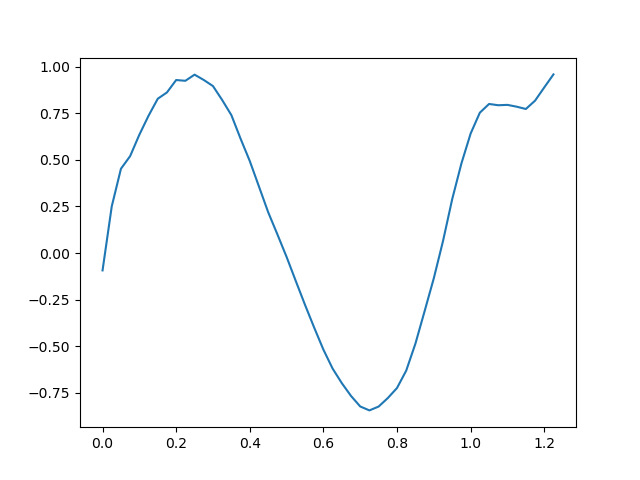

Train Epoch: 750, Loss: 0.016898


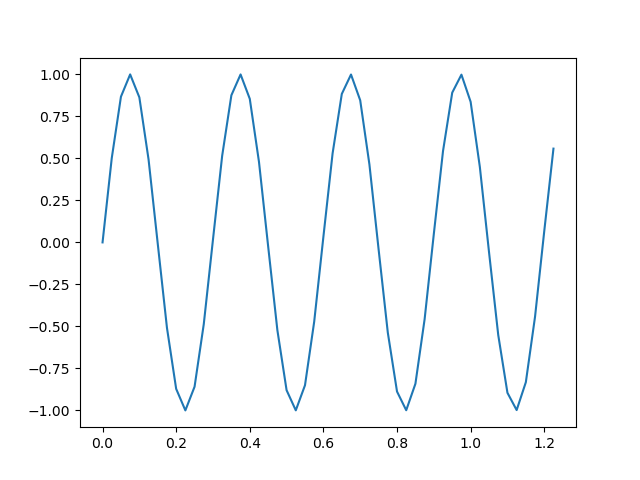

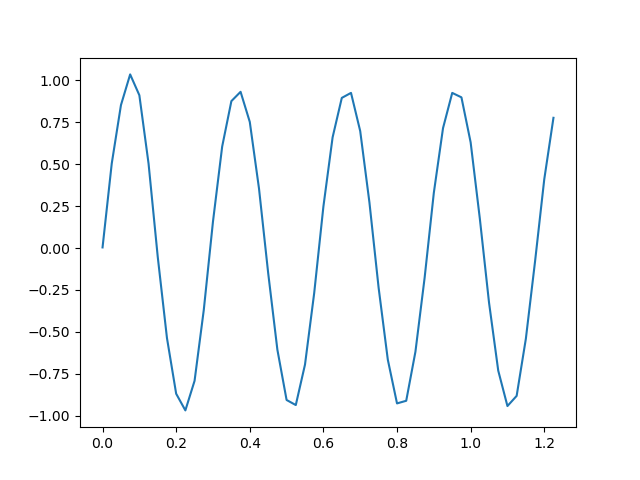

Train Epoch: 755, Loss: 0.005267


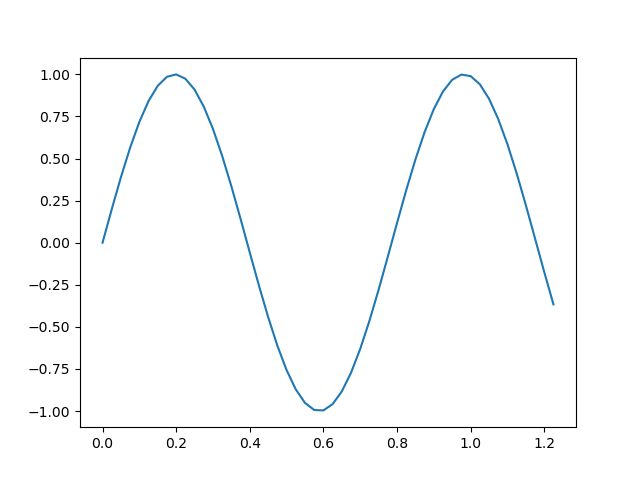

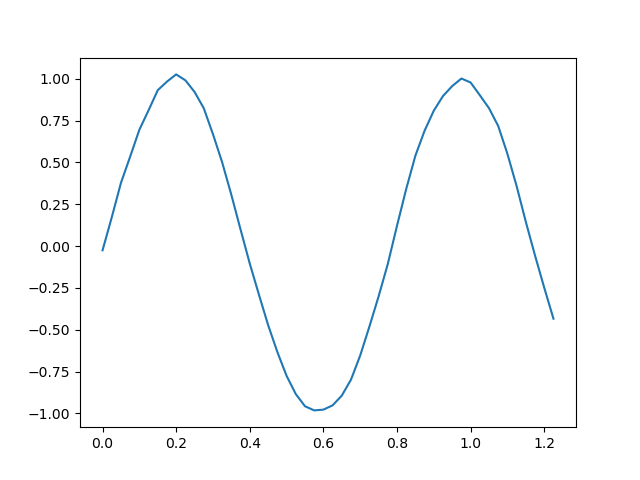

Train Epoch: 760, Loss: 0.002856


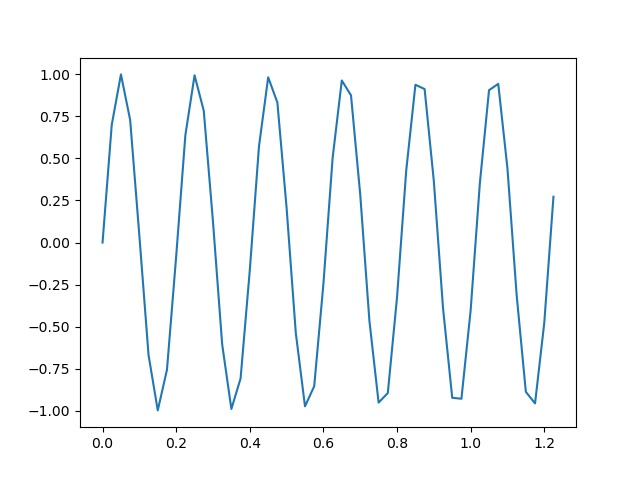

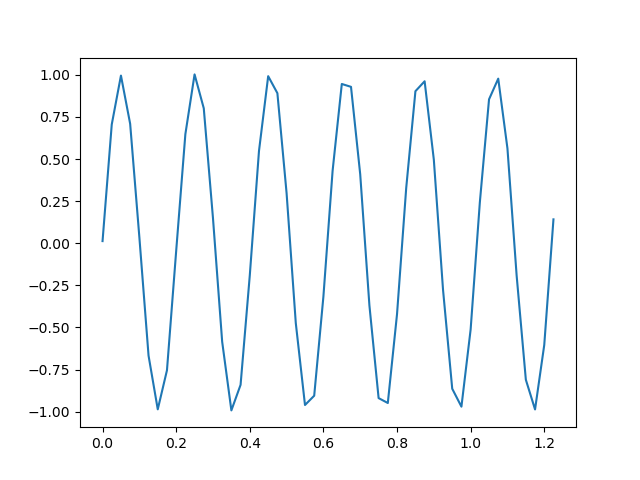

Train Epoch: 765, Loss: 0.000657


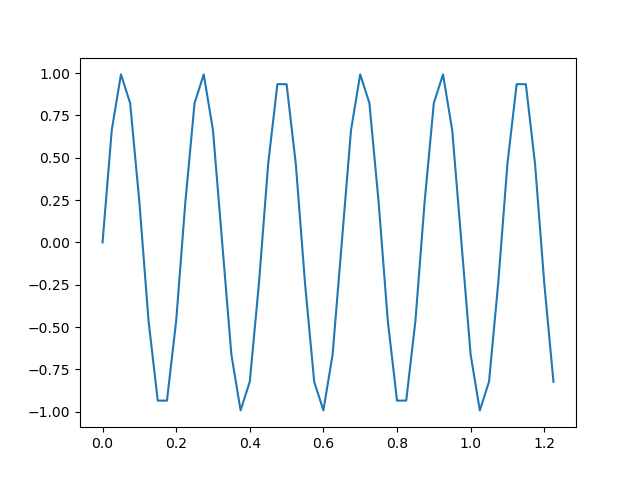

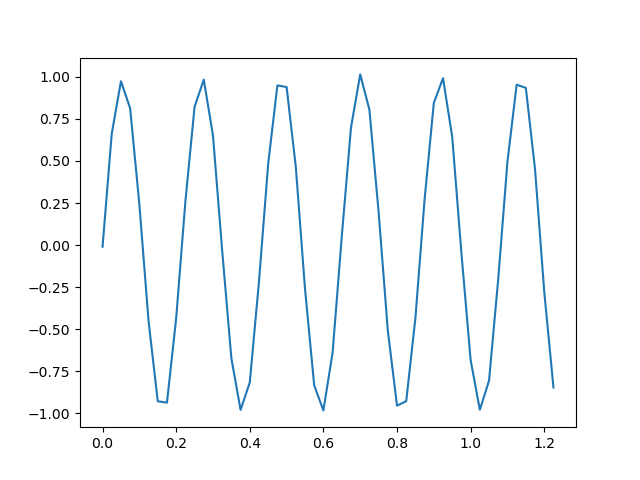

Train Epoch: 770, Loss: 0.000410


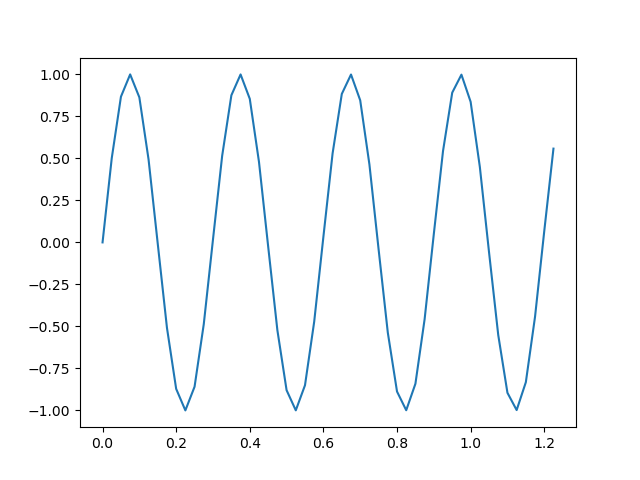

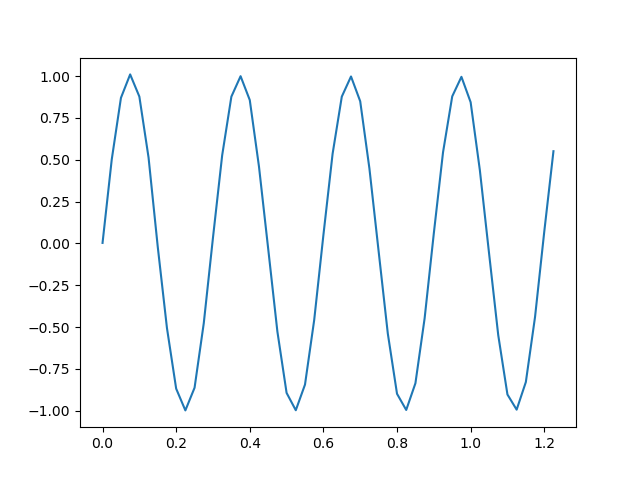

Train Epoch: 775, Loss: 0.000226


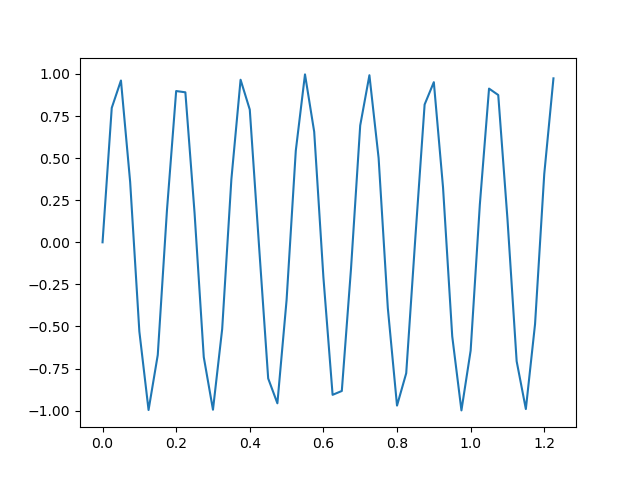

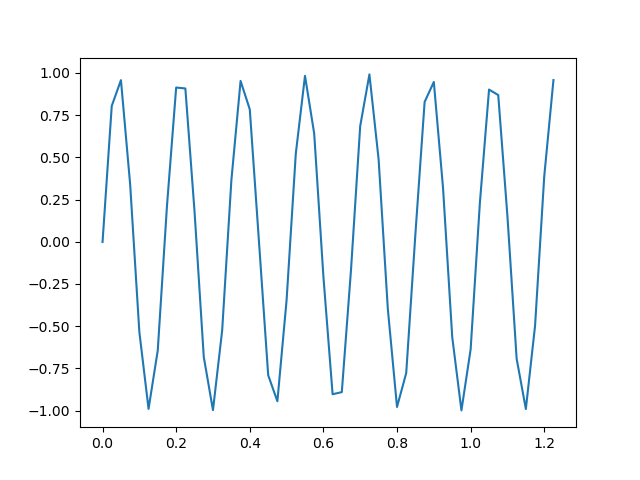

Train Epoch: 780, Loss: 0.000266


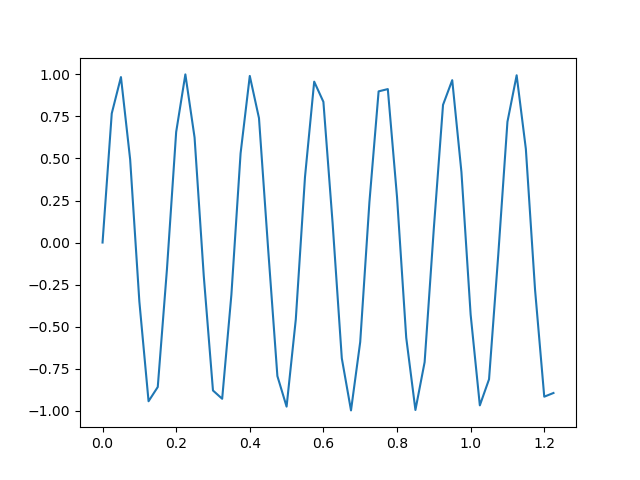

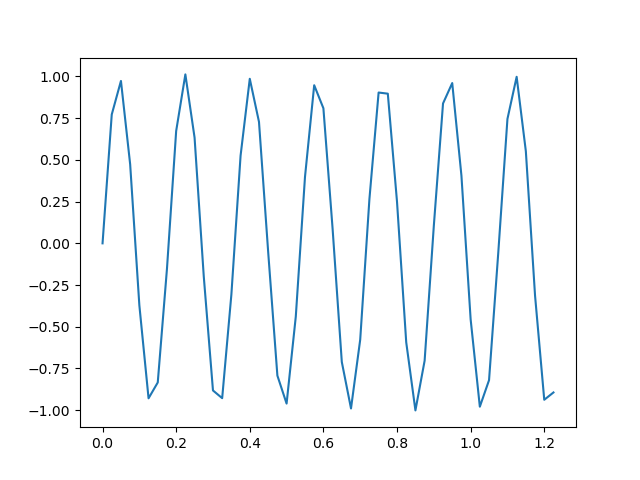

Train Epoch: 785, Loss: 0.000207


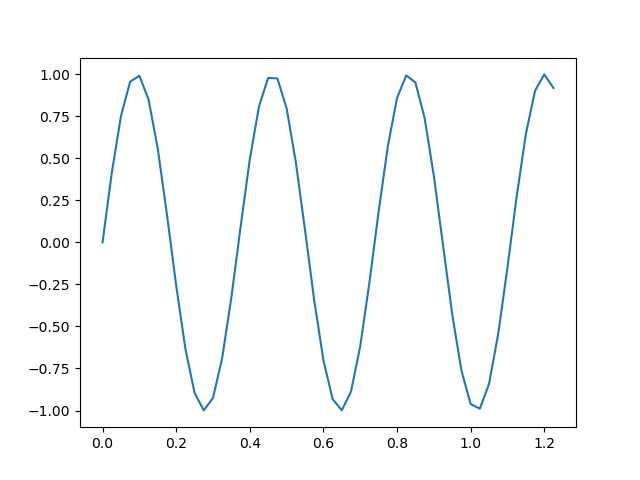

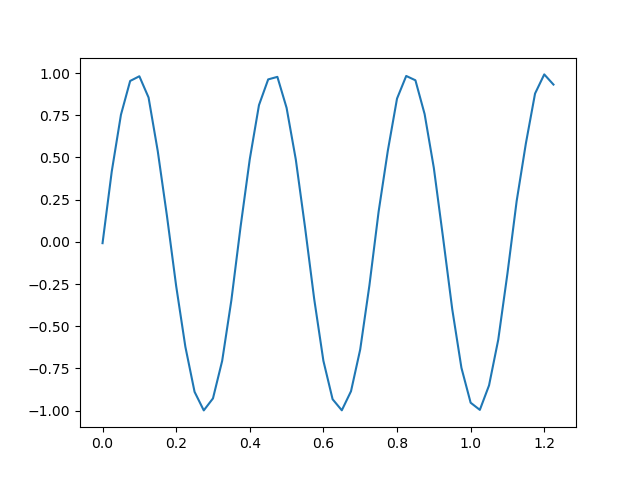

Train Epoch: 790, Loss: 0.000193


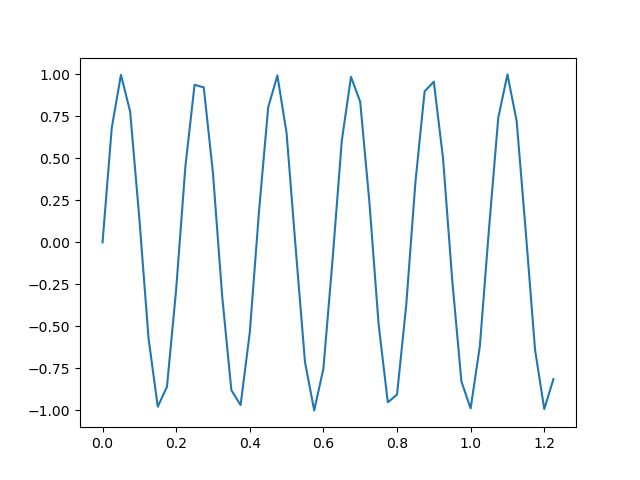

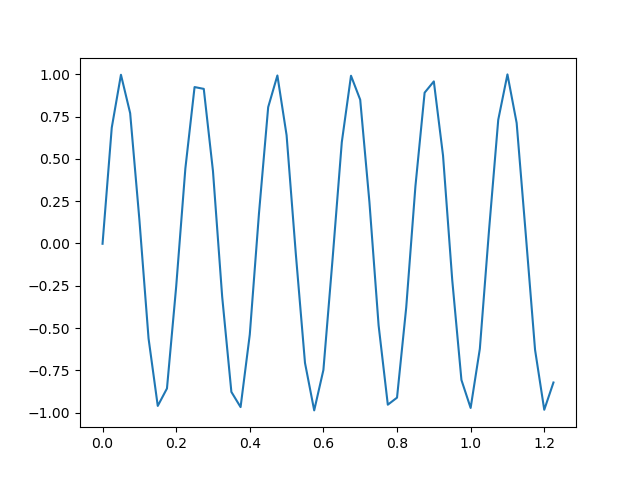

Train Epoch: 795, Loss: 0.000195


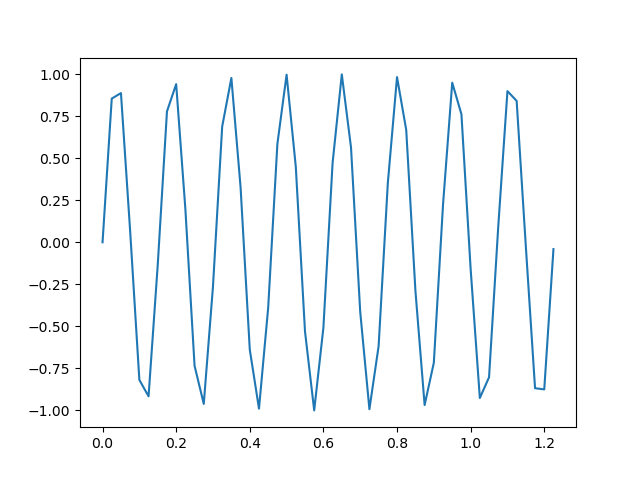

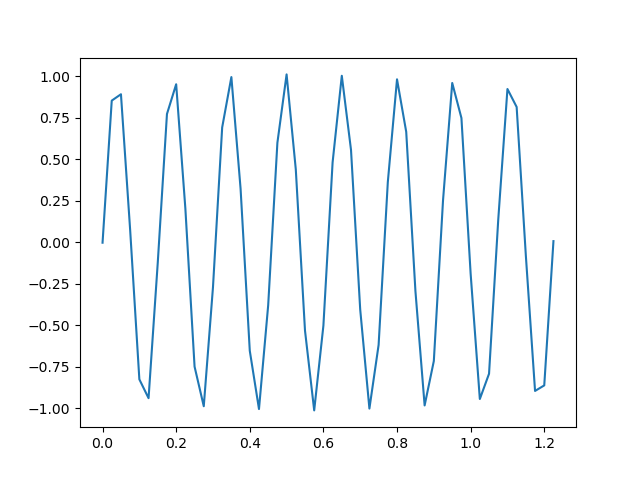

Train Epoch: 800, Loss: 0.000127


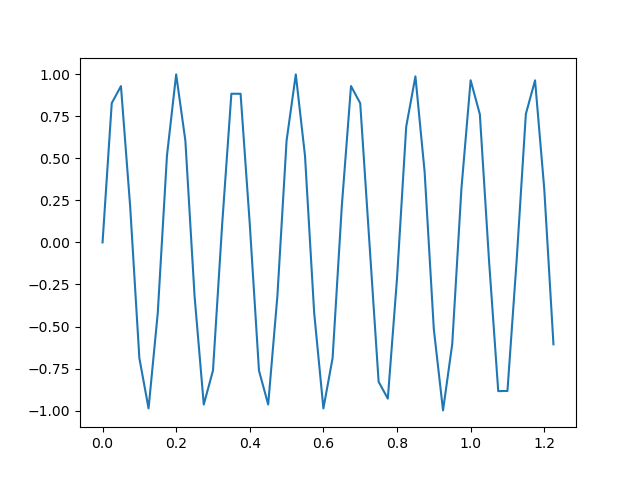

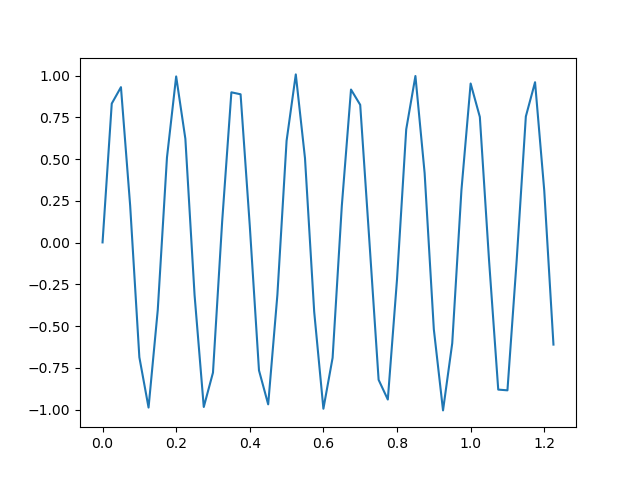

Train Epoch: 805, Loss: 0.000117


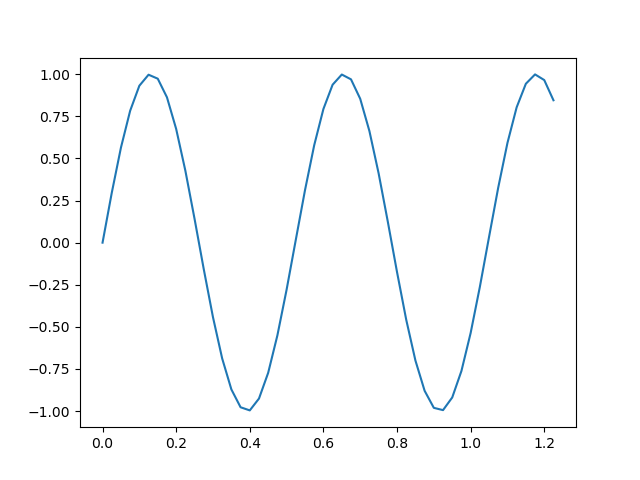

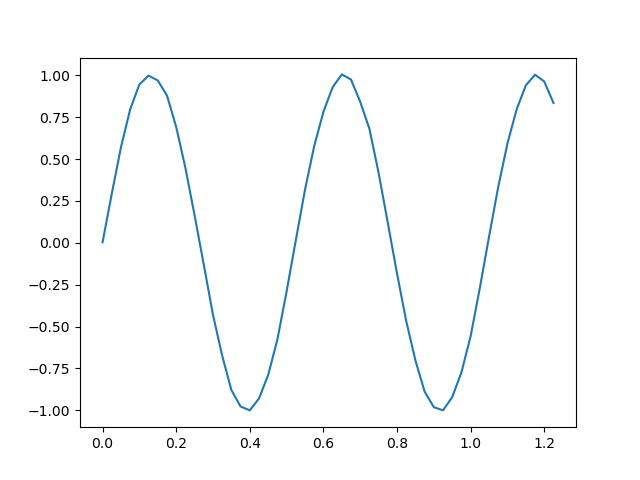

Train Epoch: 810, Loss: 0.000098


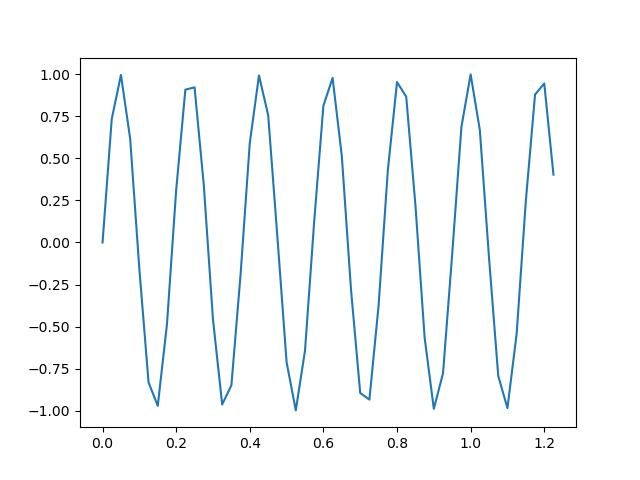

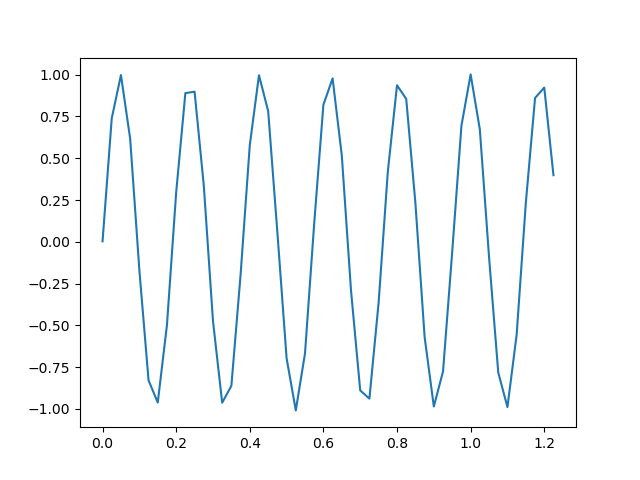

Train Epoch: 815, Loss: 0.000084


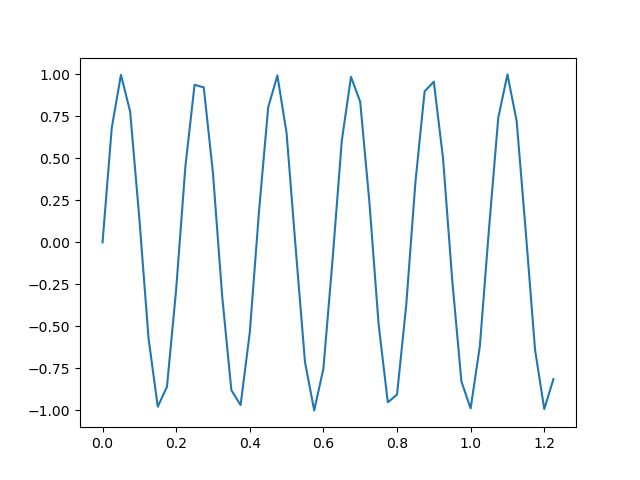

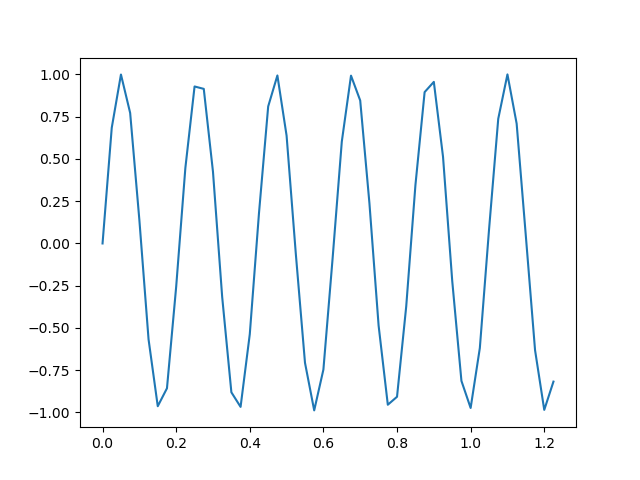

Train Epoch: 820, Loss: 0.000144


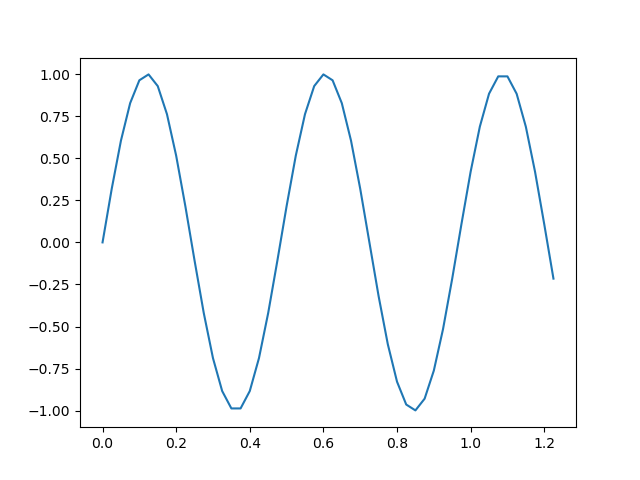

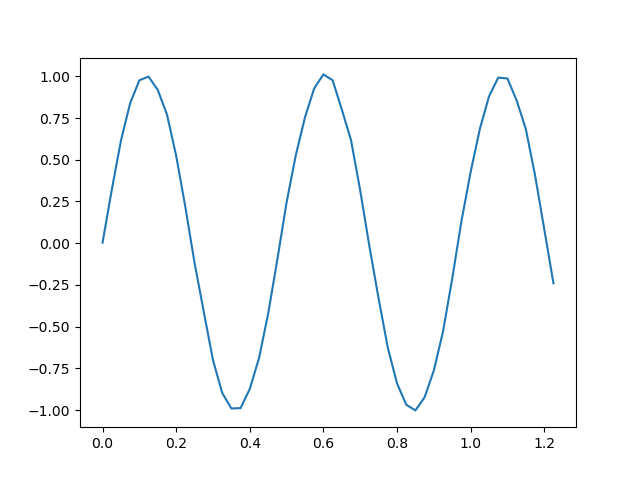

Train Epoch: 825, Loss: 0.000092


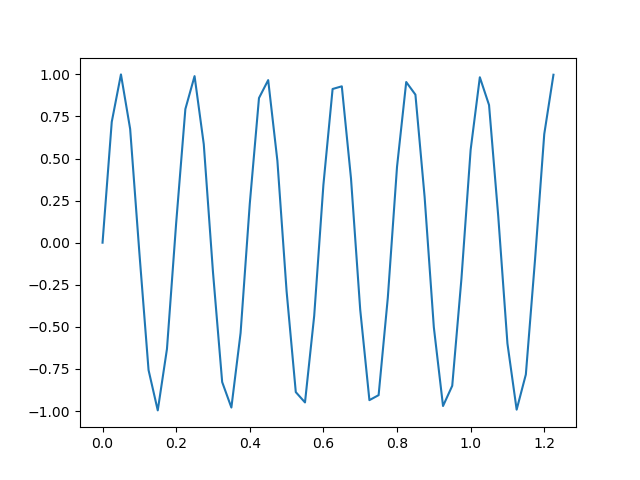

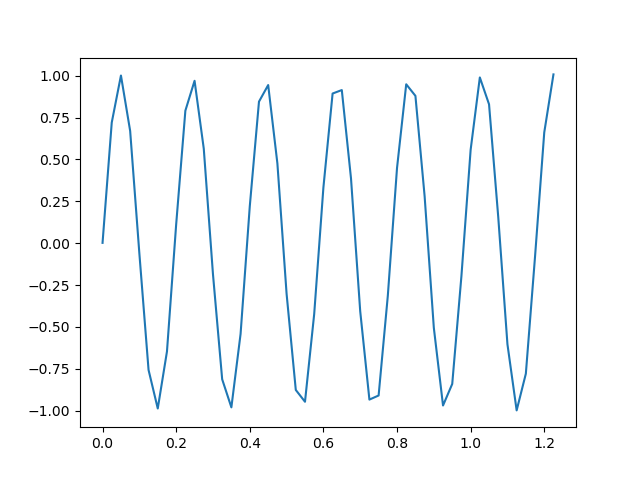

Train Epoch: 830, Loss: 0.000099


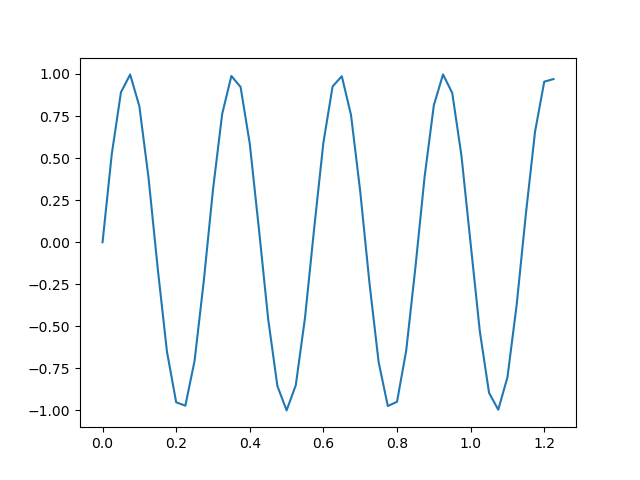

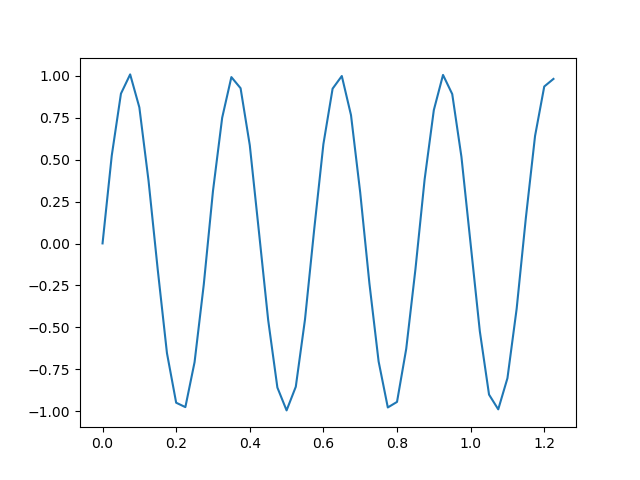

Train Epoch: 835, Loss: 0.000091


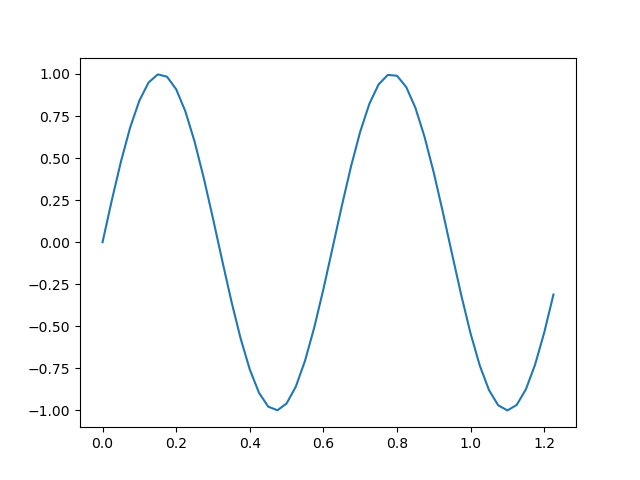

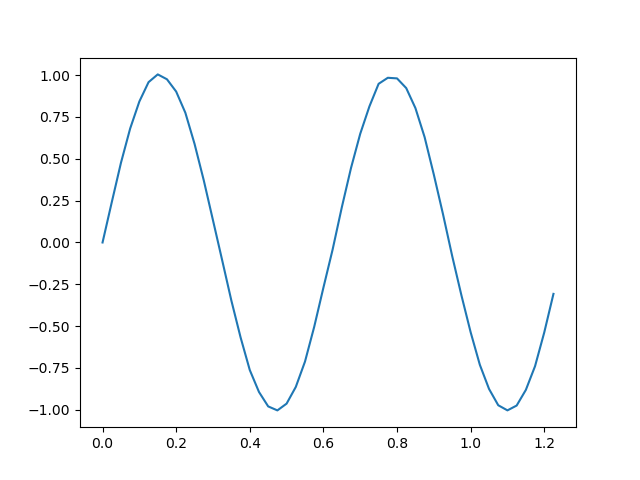

Train Epoch: 840, Loss: 0.000095


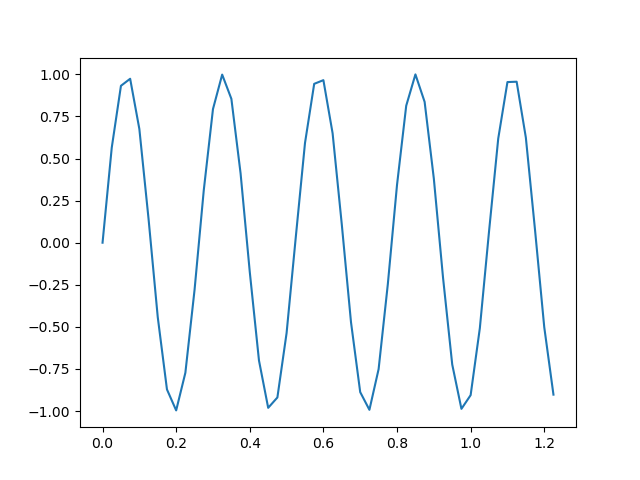

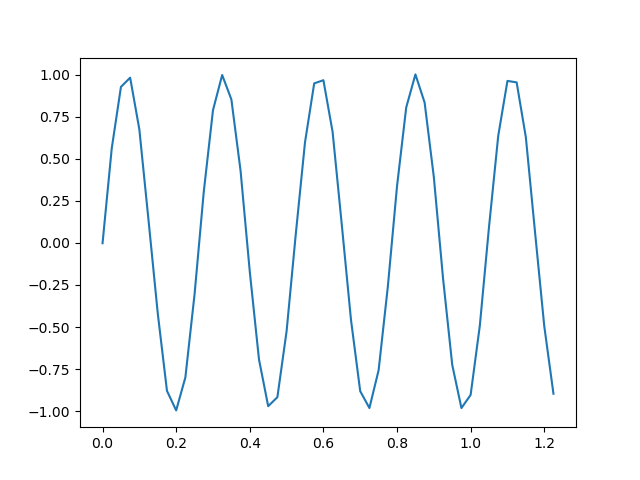

Train Epoch: 845, Loss: 0.000082


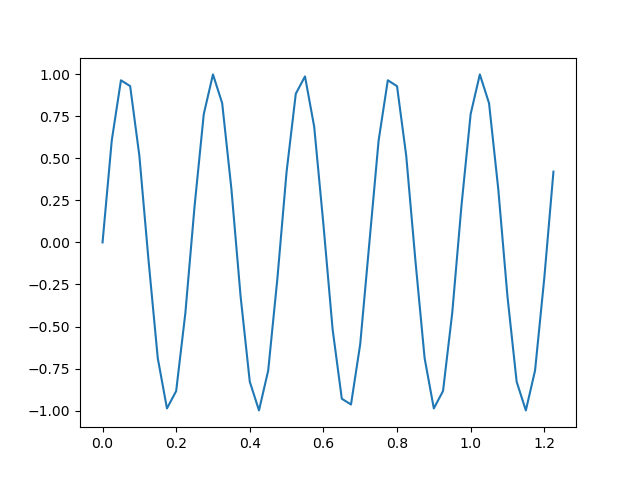

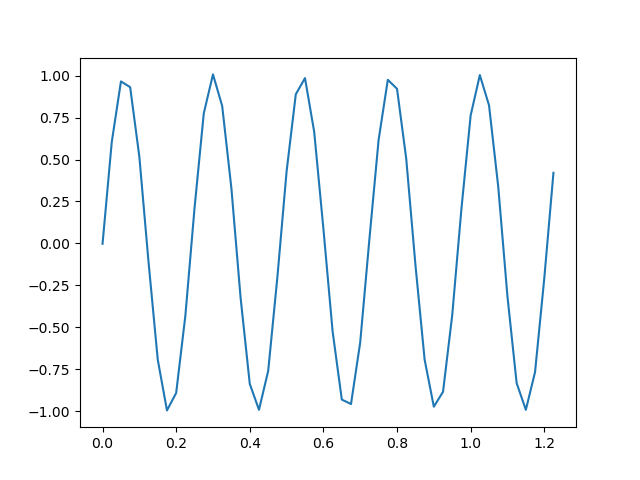

Train Epoch: 850, Loss: 0.000116


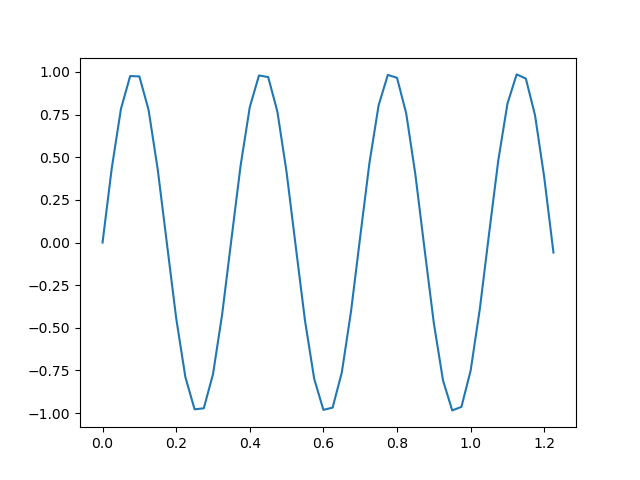

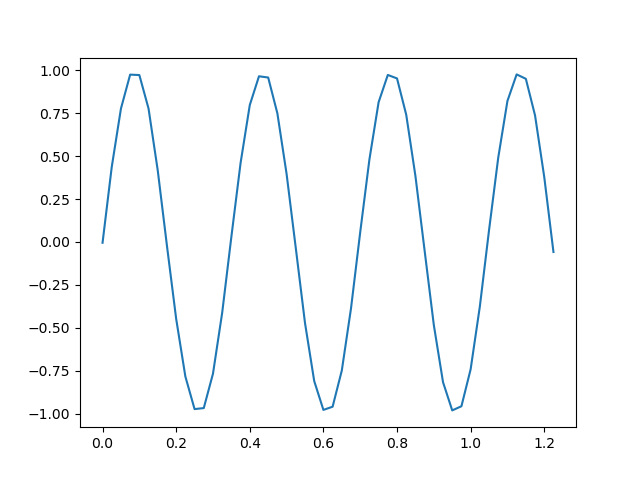

Train Epoch: 855, Loss: 0.000094


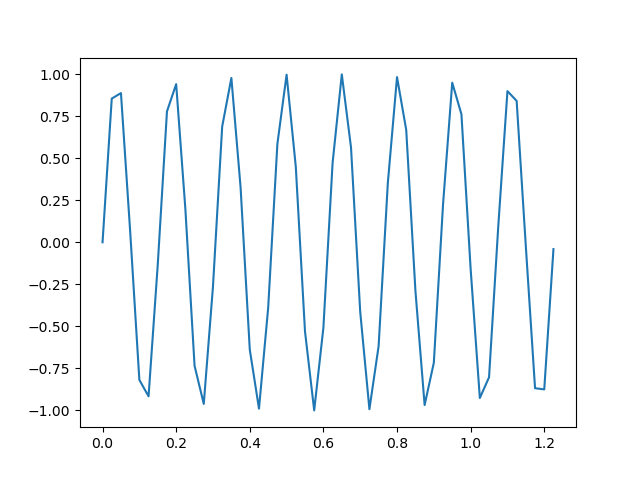

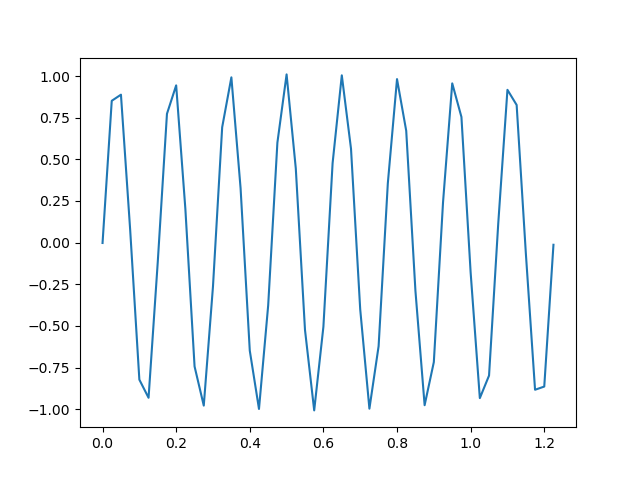

Train Epoch: 860, Loss: 0.000085


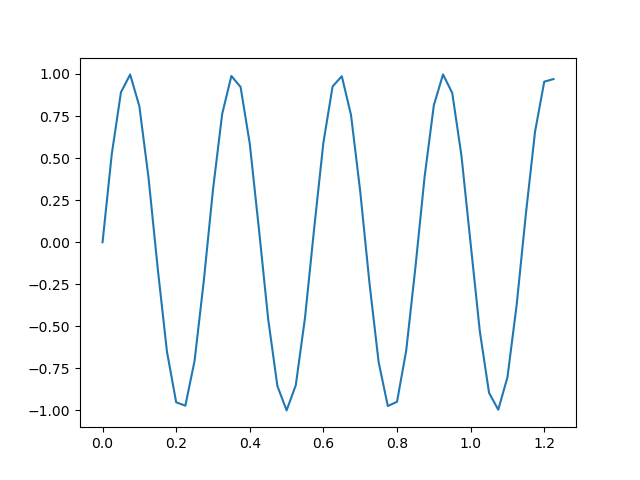

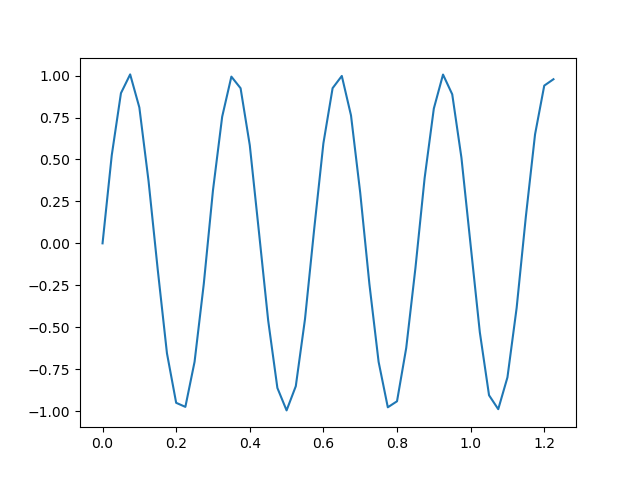

Train Epoch: 865, Loss: 0.000080


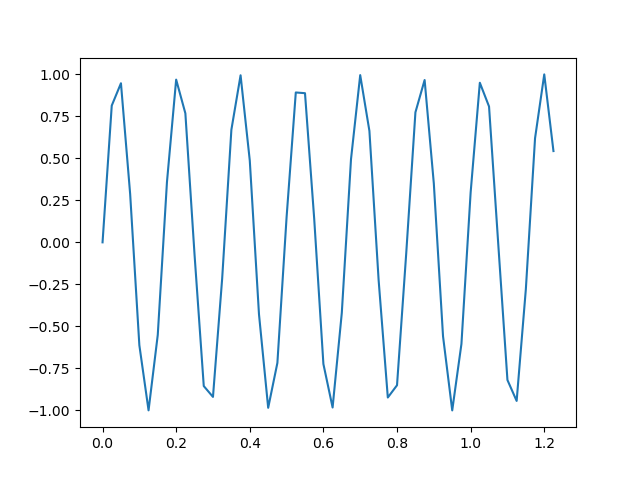

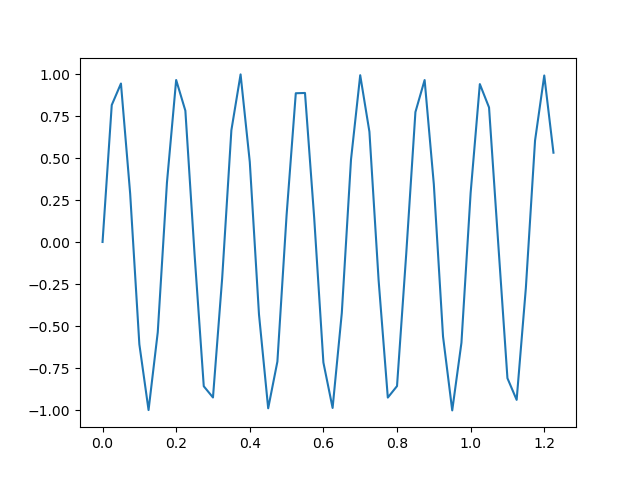

Train Epoch: 870, Loss: 0.000078


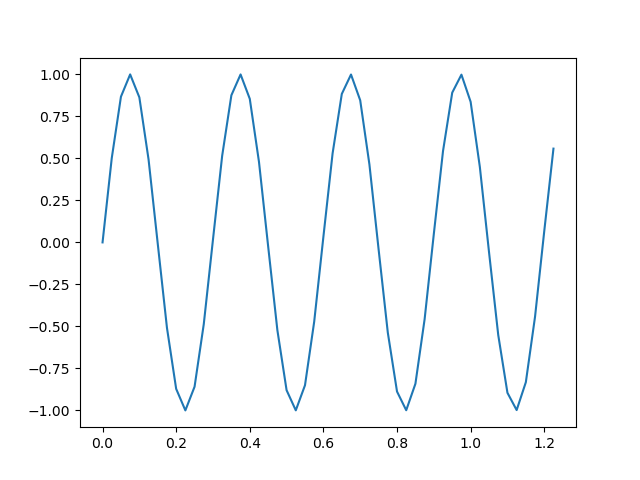

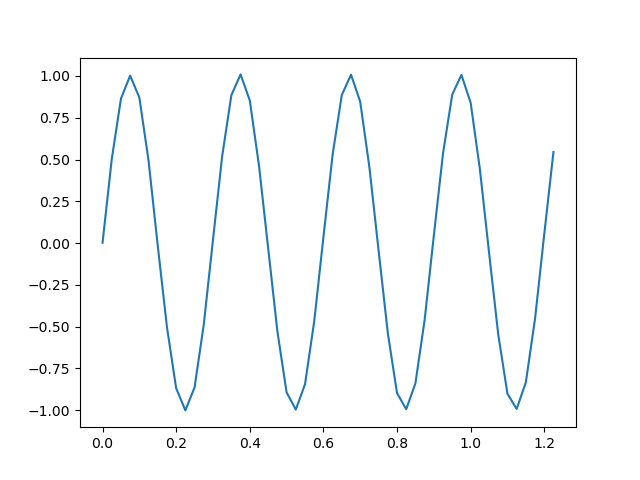

Train Epoch: 875, Loss: 0.000073


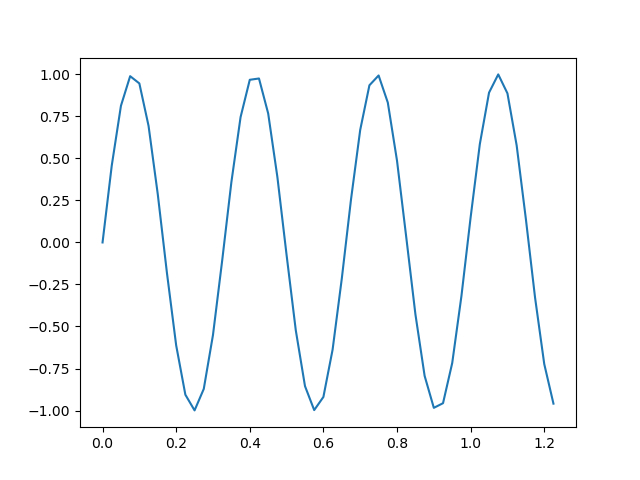

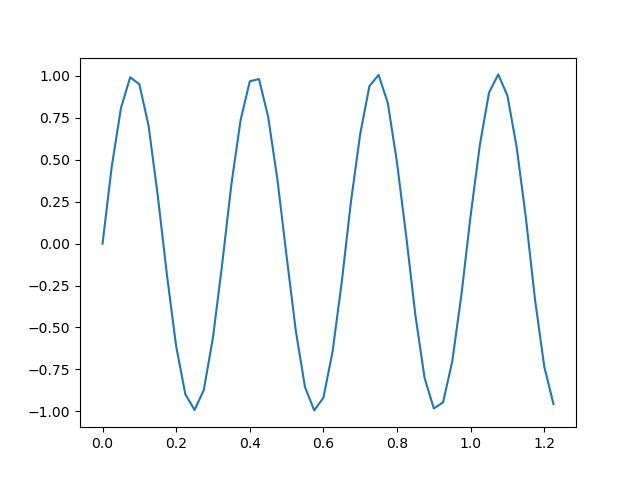

Train Epoch: 880, Loss: 0.000069


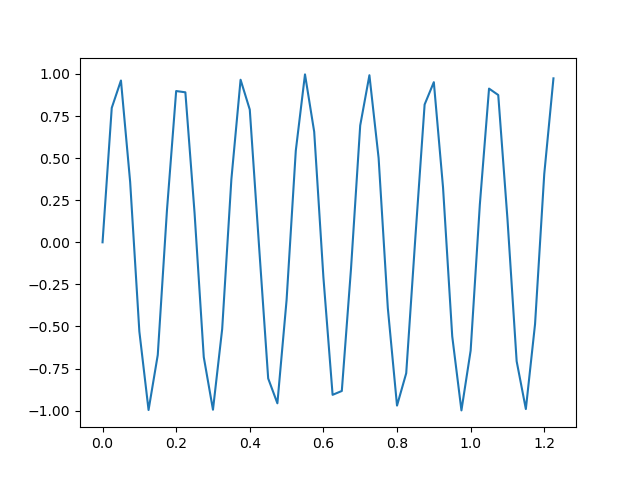

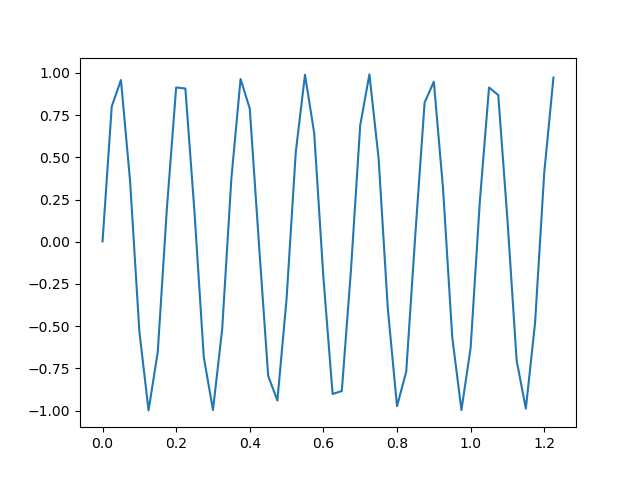

Train Epoch: 885, Loss: 0.000074


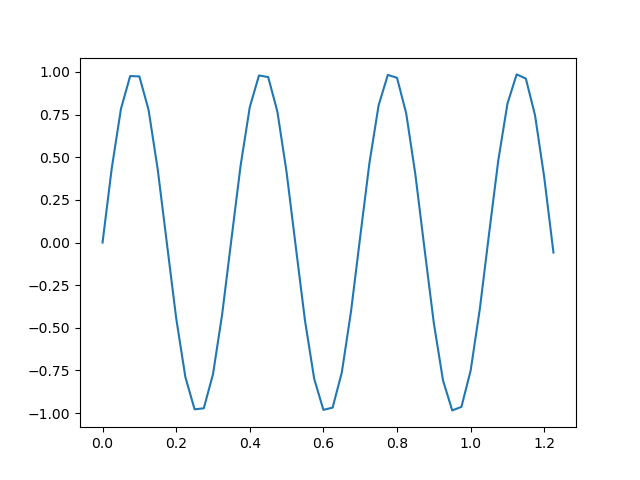

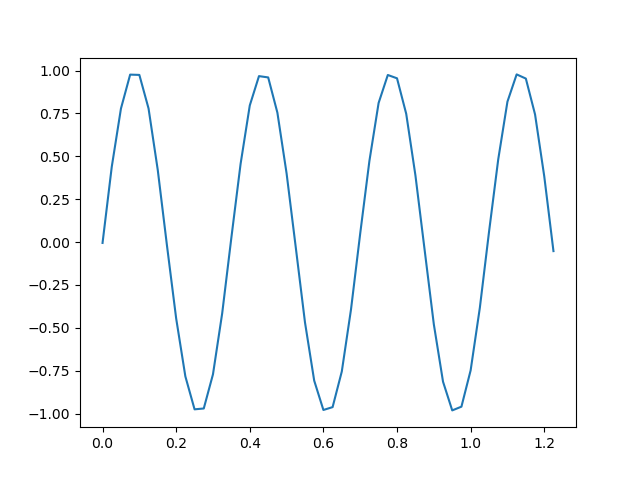

Train Epoch: 890, Loss: 0.000105


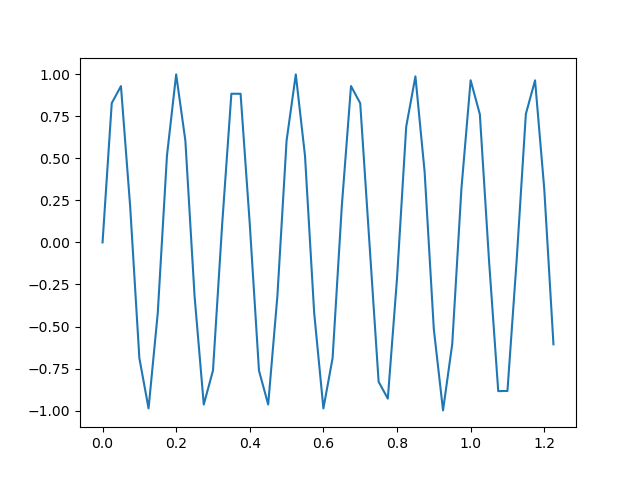

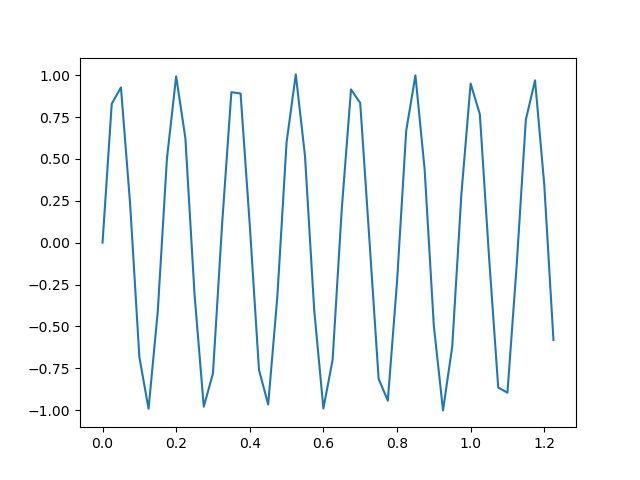

Train Epoch: 895, Loss: 0.000070


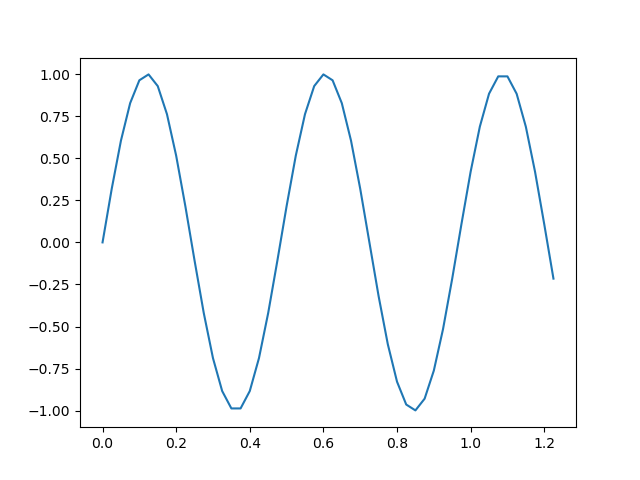

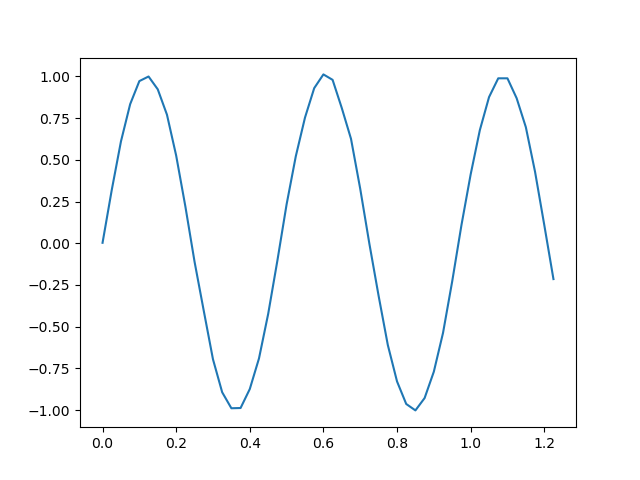

Train Epoch: 900, Loss: 0.000078


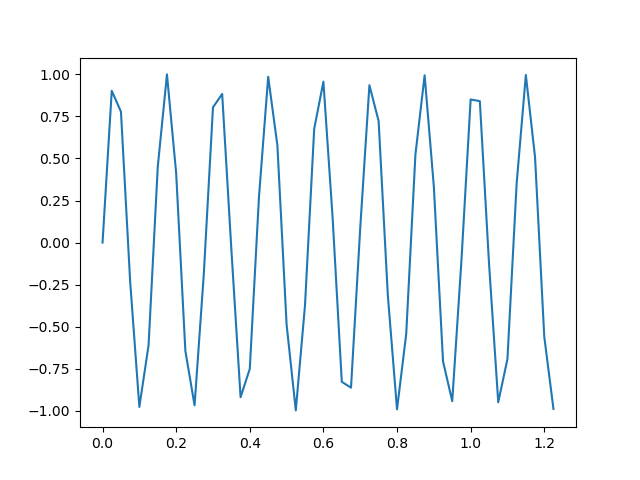

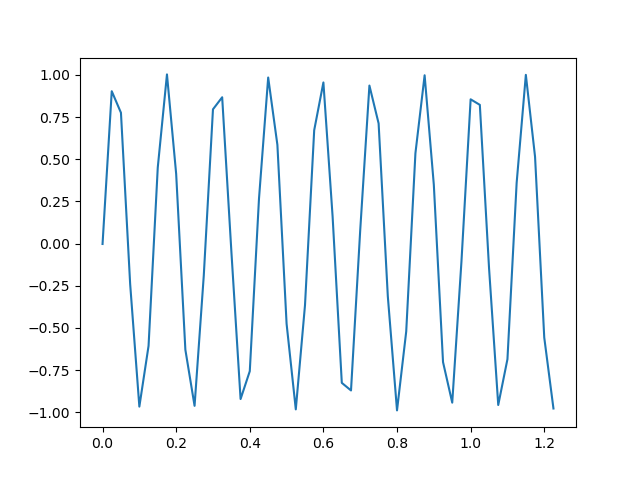

Train Epoch: 905, Loss: 0.000062


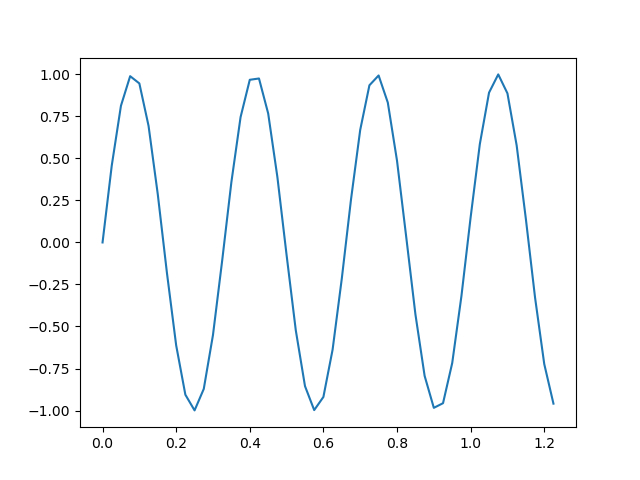

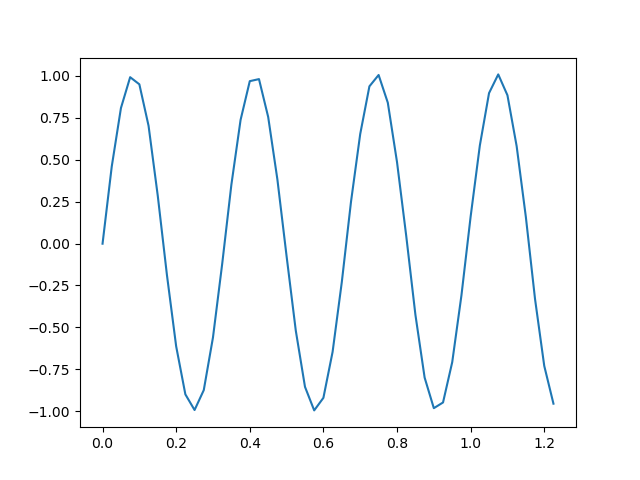

Train Epoch: 910, Loss: 0.000077


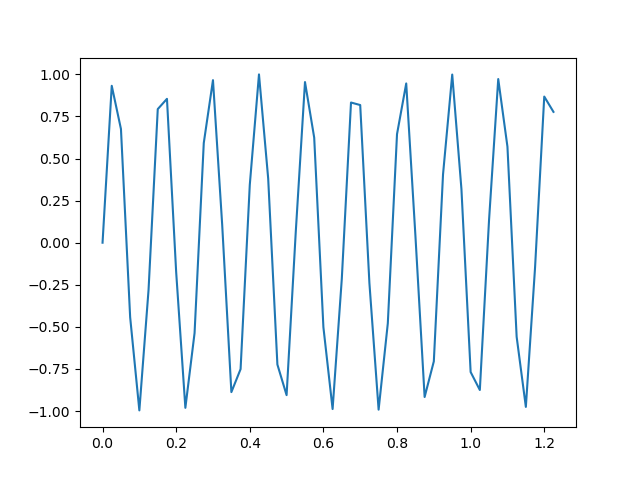

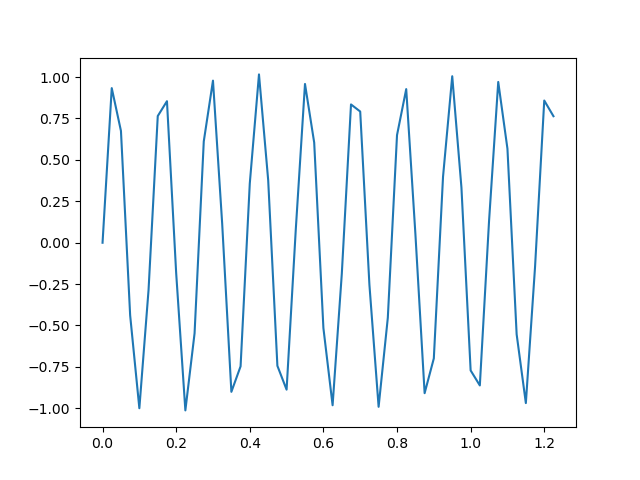

Train Epoch: 915, Loss: 0.000066


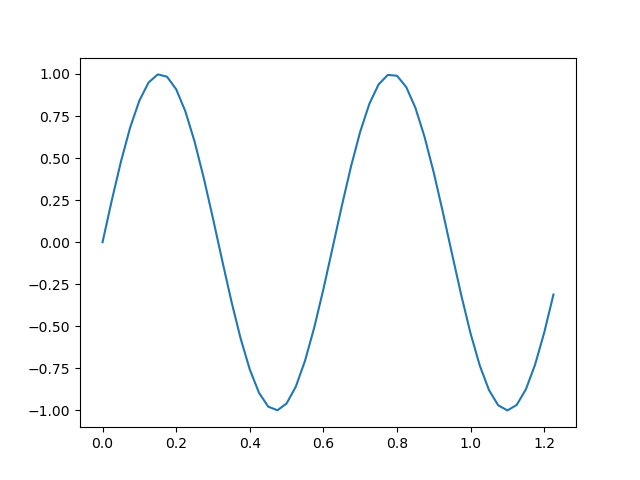

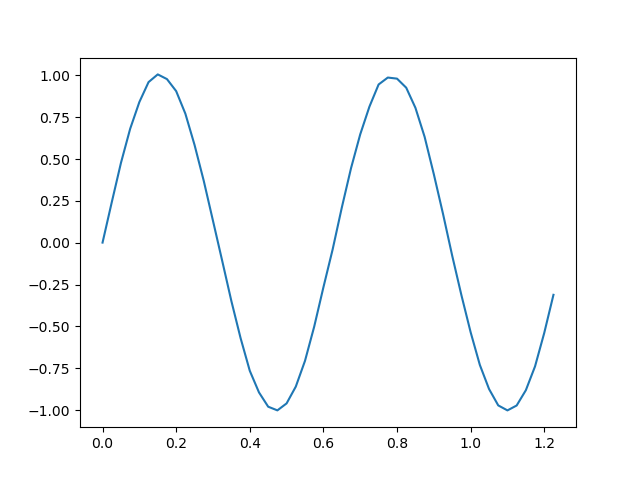

Train Epoch: 920, Loss: 0.000061


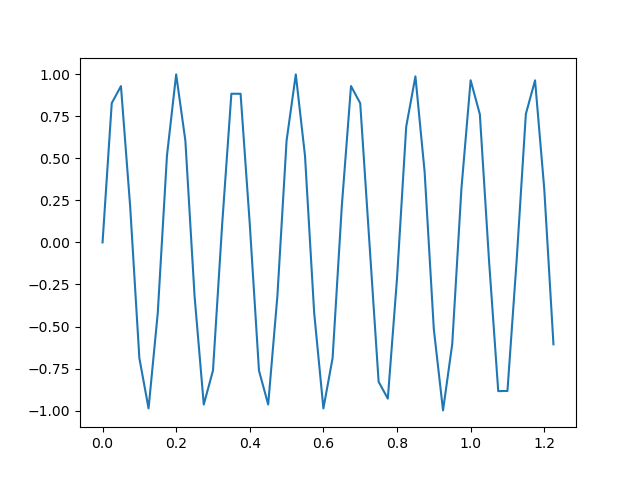

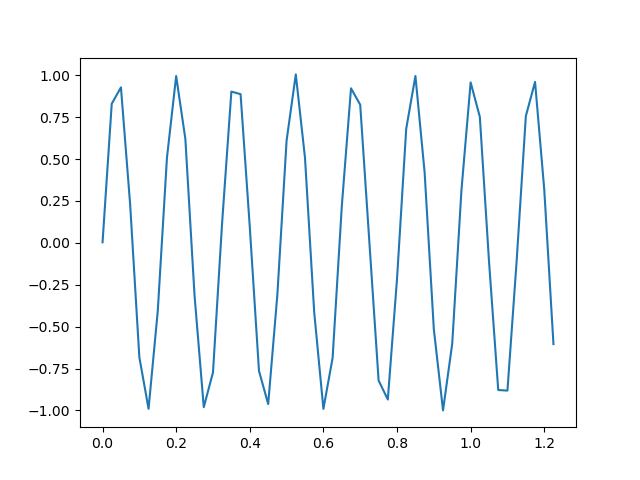

Train Epoch: 925, Loss: 0.000067


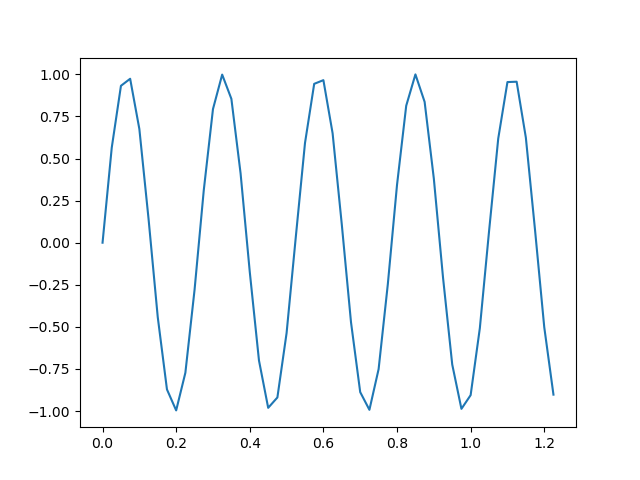

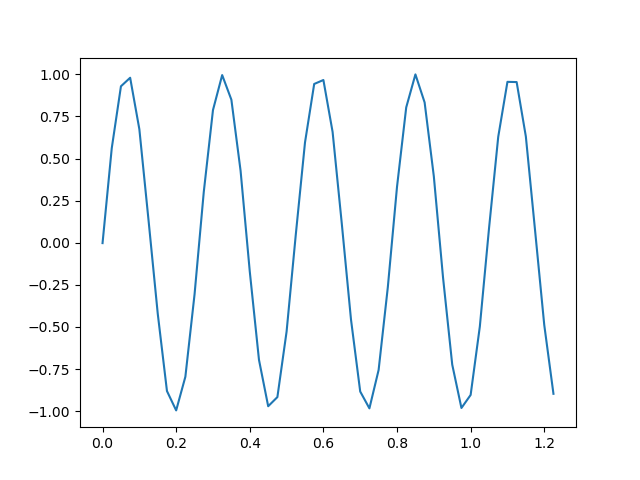

Train Epoch: 930, Loss: 0.000060


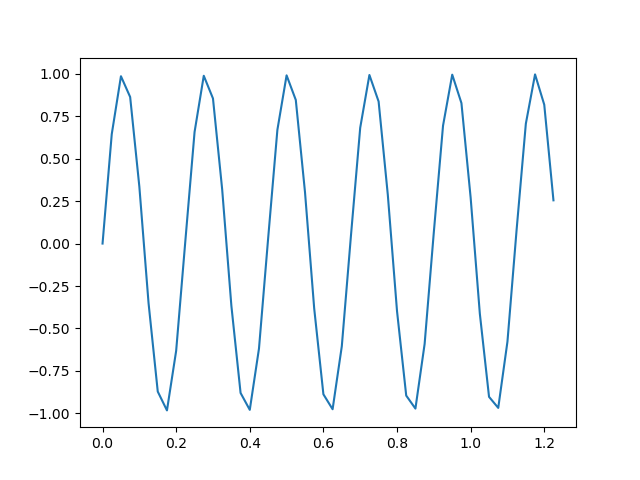

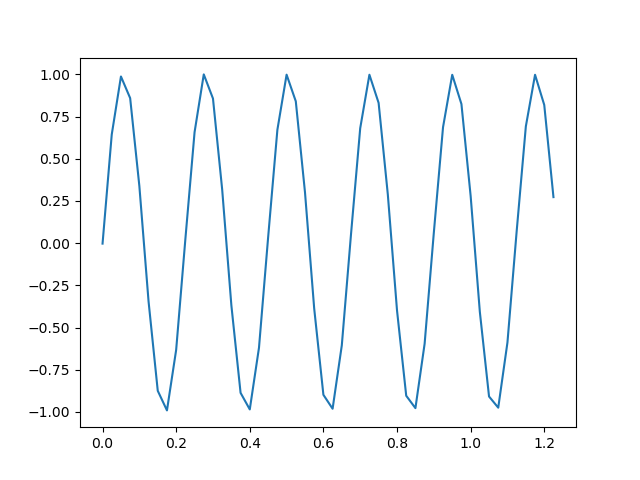

Train Epoch: 935, Loss: 0.000057


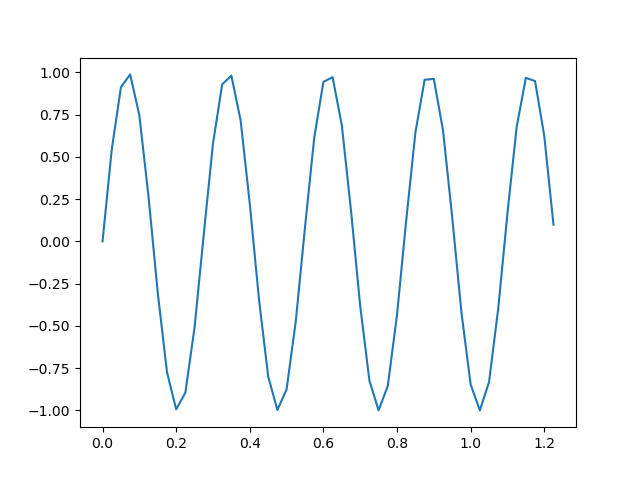

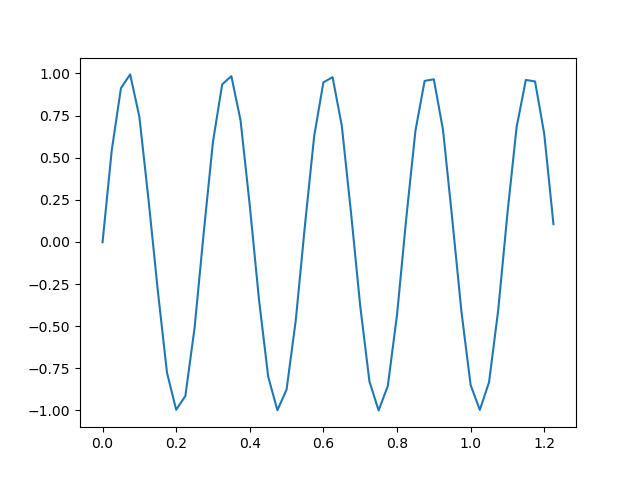

Train Epoch: 940, Loss: 0.000072


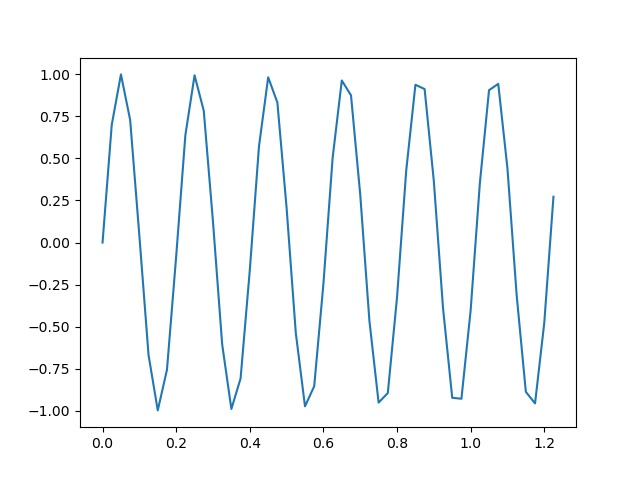

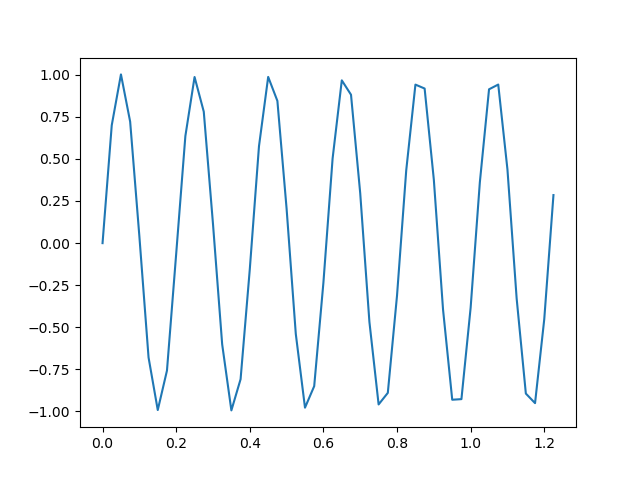

Train Epoch: 945, Loss: 0.000068


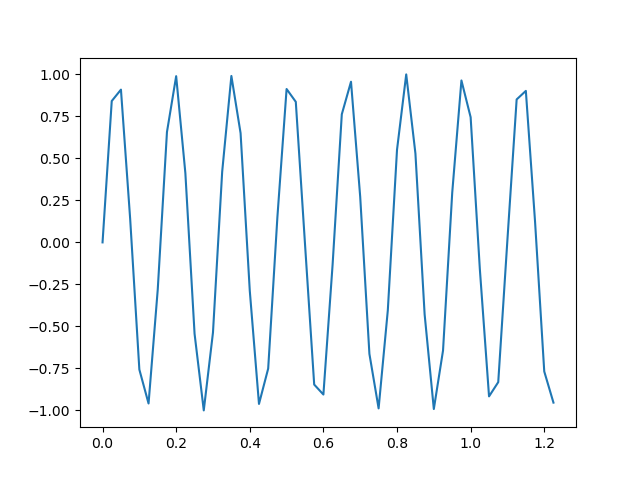

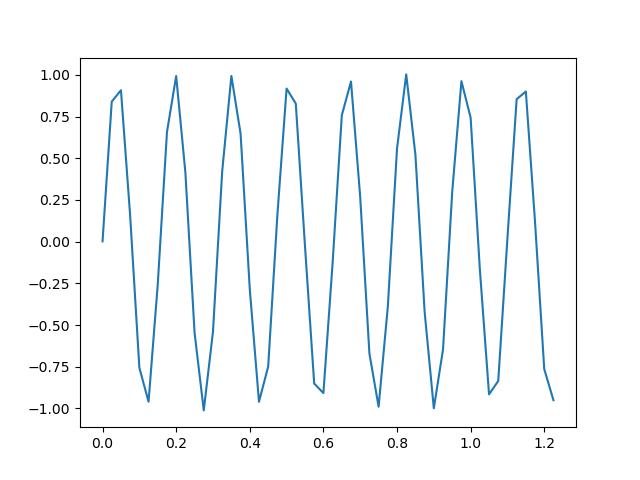

Train Epoch: 950, Loss: 0.000131


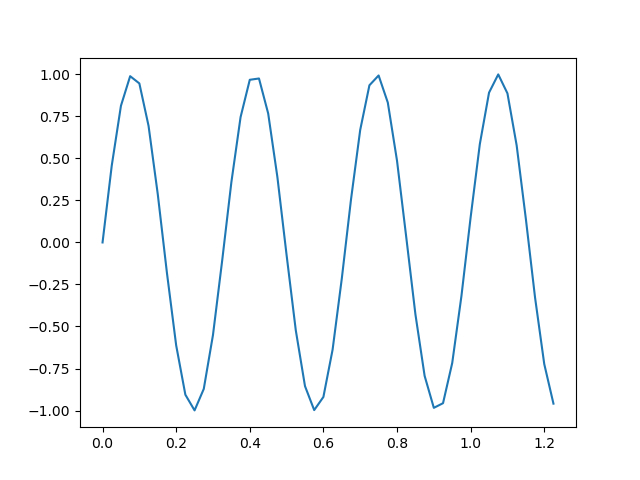

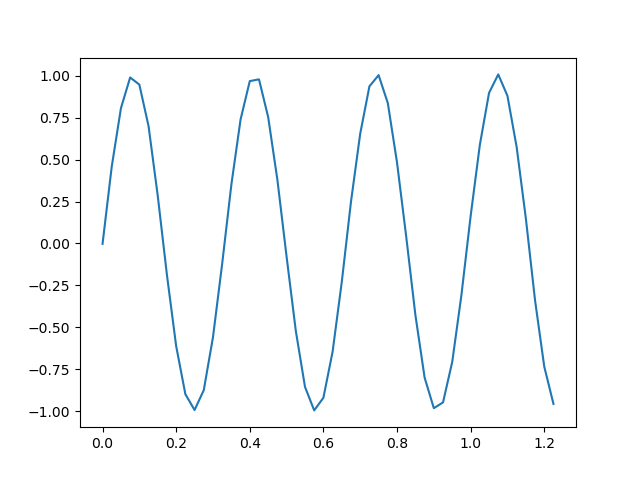

Train Epoch: 955, Loss: 0.000057


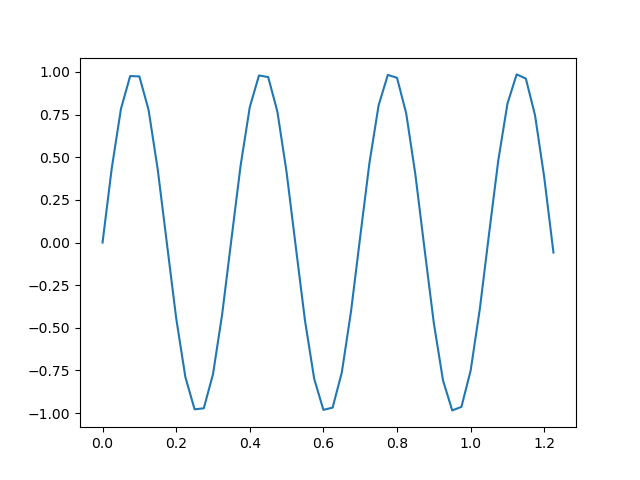

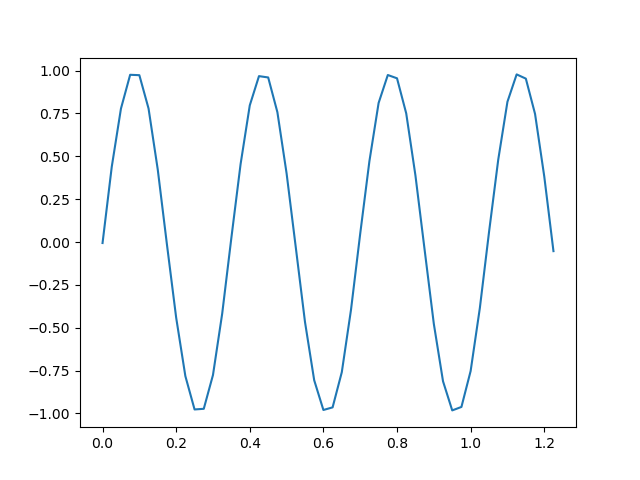

Train Epoch: 960, Loss: 0.000056


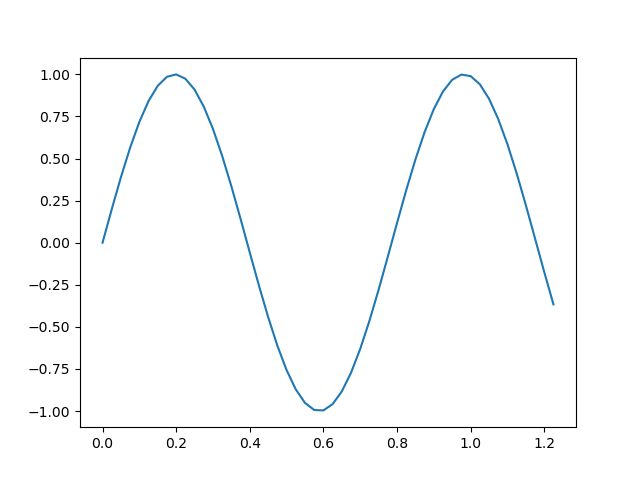

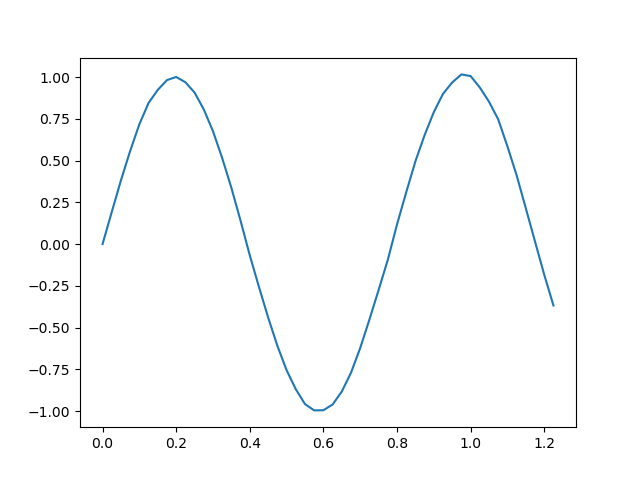

Train Epoch: 965, Loss: 0.000047


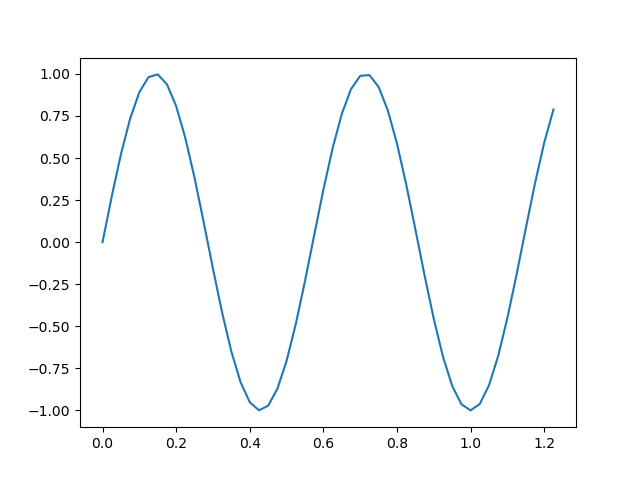

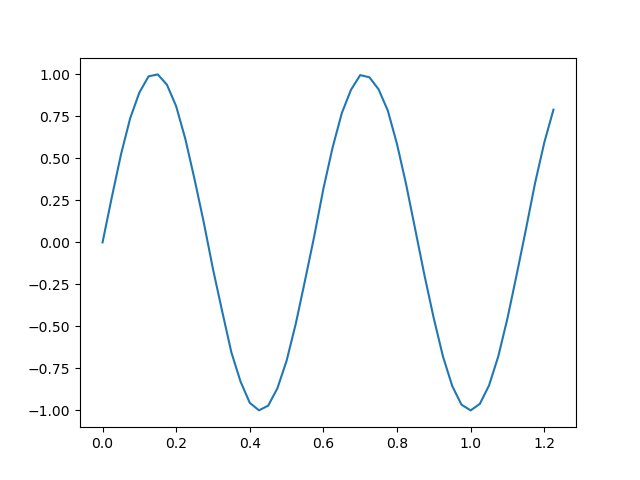

Train Epoch: 970, Loss: 0.000050


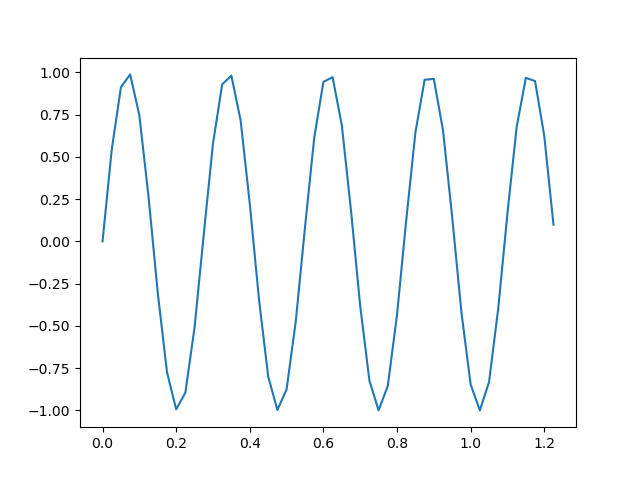

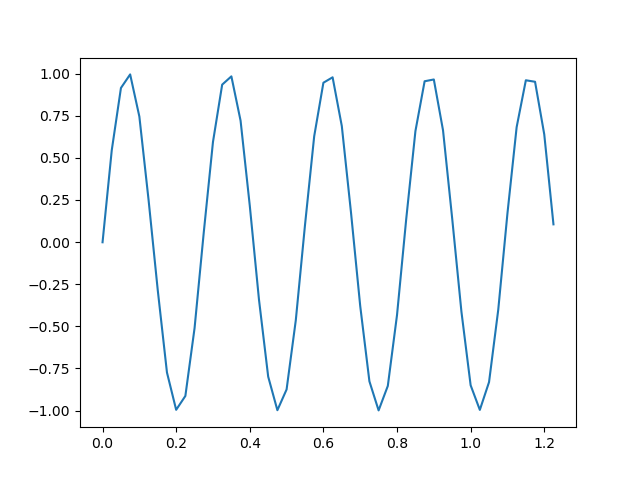

Train Epoch: 975, Loss: 0.000067


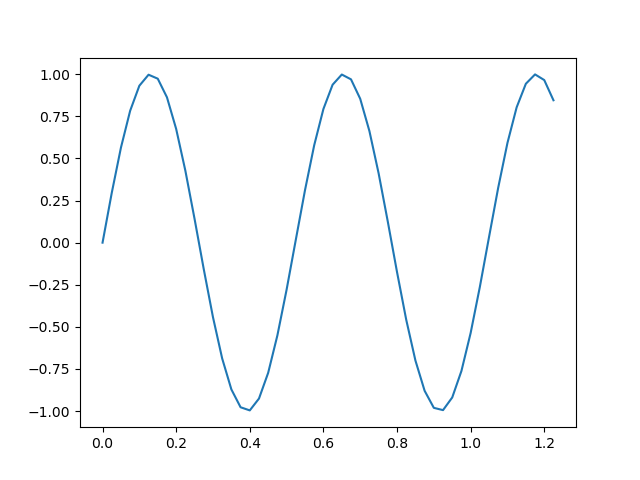

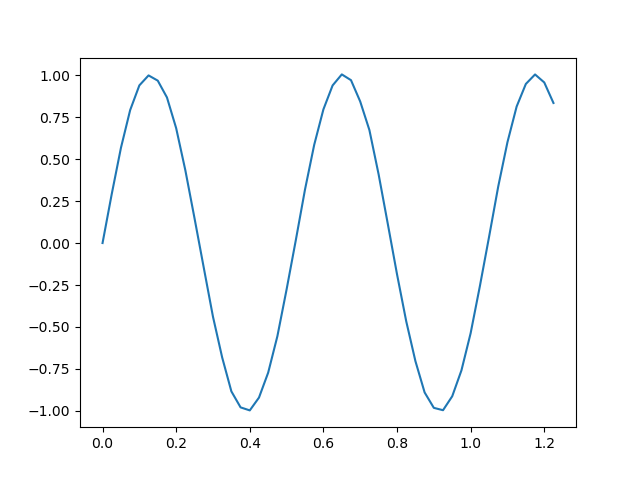

Train Epoch: 980, Loss: 0.000048


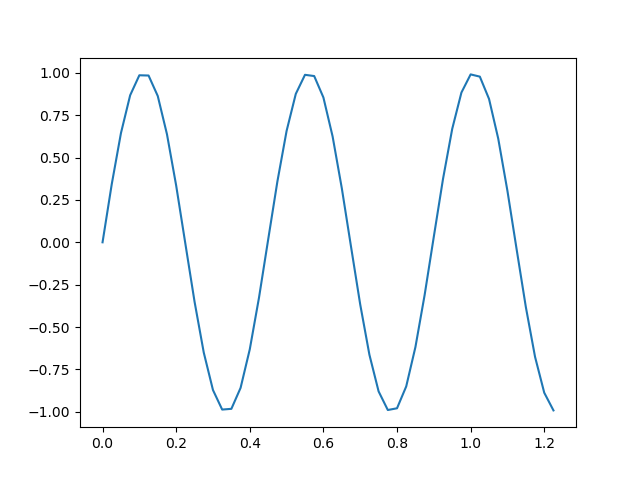

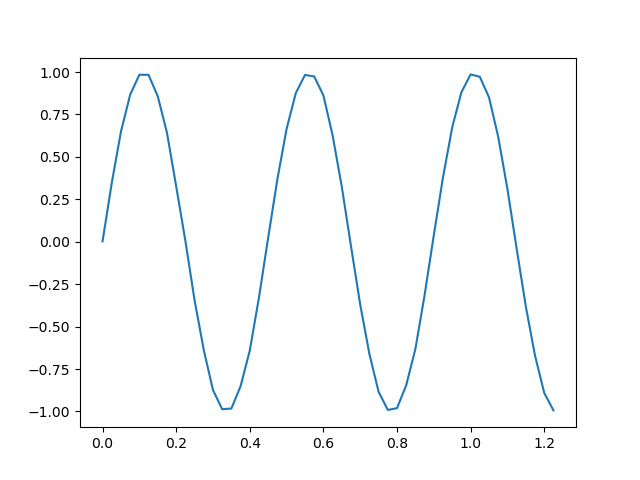

Train Epoch: 985, Loss: 0.000061


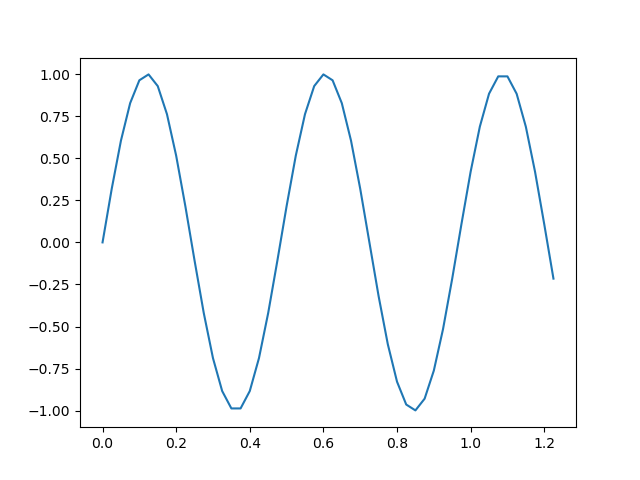

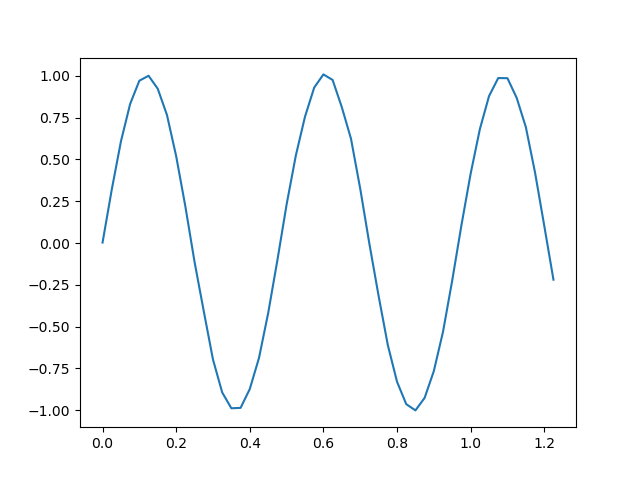

Train Epoch: 990, Loss: 0.000049


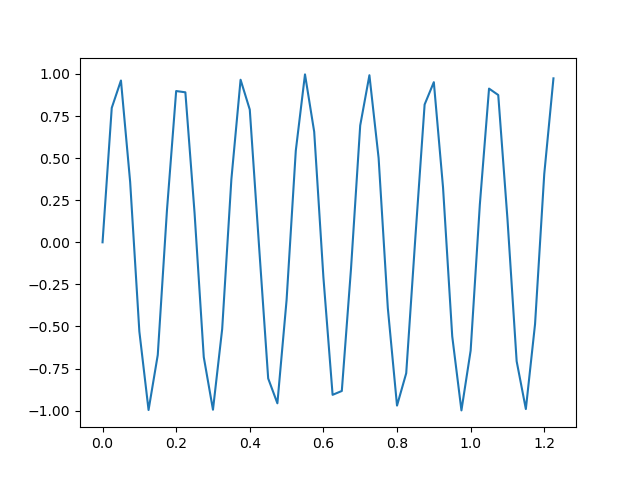

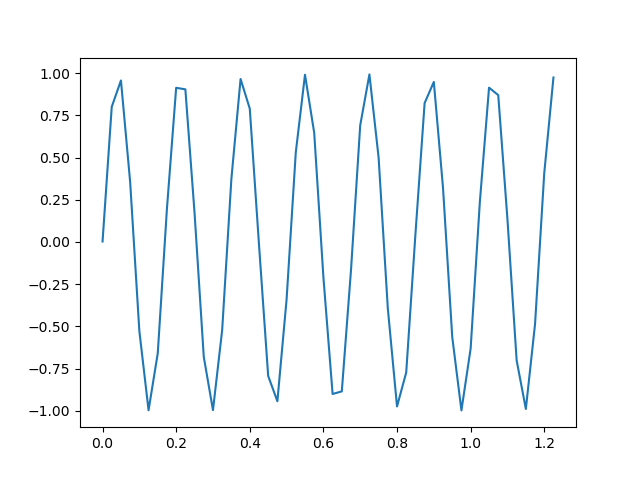

Train Epoch: 995, Loss: 0.000058


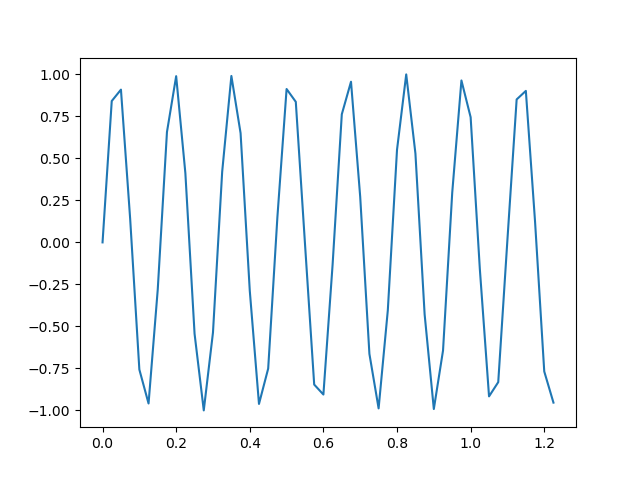

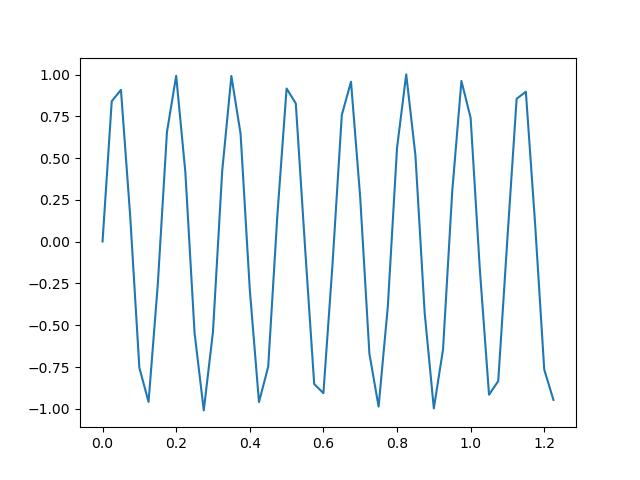

Train Epoch: 1000, Loss: 0.000061


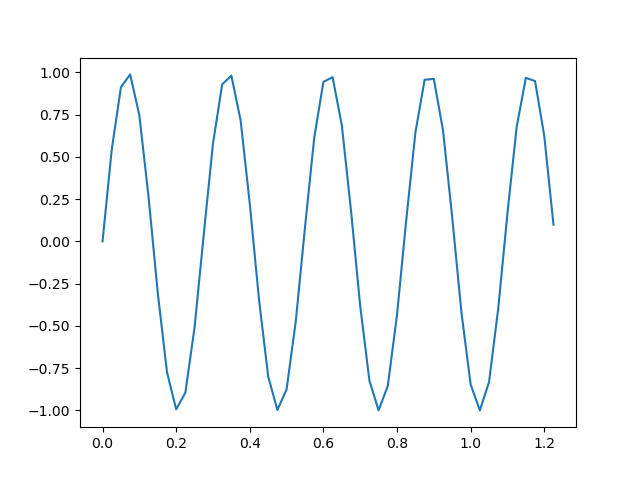

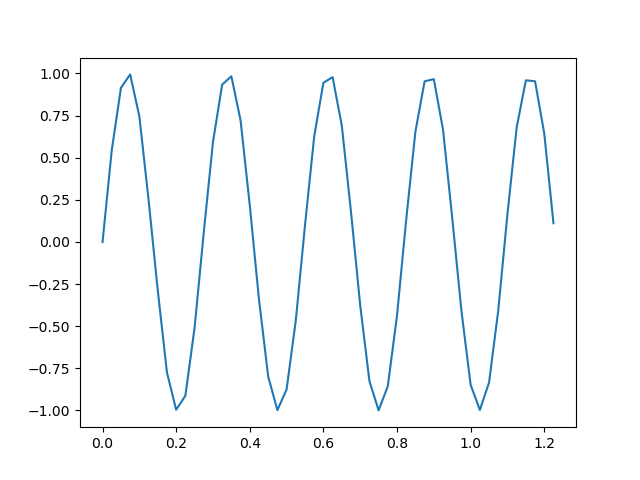

In [34]:
import numpy as np
import torch.utils.data as data

n_in = 1
n_out = 1
n_hid = 200
class SineWave(data.Dataset):
    def __init__(self, time_length=200, freq_range = 20):
        self.time_length = time_length
        self.freq_range = freq_range

    def __len__(self):
        return 200

    def __getitem__(self, item):
        freq = np.random.randint(1, self.freq_range + 1)
        const_signal = np.repeat(freq / self.freq_range + 0.25, self.time_length)
        const_signal = np.expand_dims(const_signal, axis=1)
        t = np.arange(0, self.time_length*0.025, 0.025)
        target = np.sin(freq * t)
        target = np.expand_dims(target, axis=1)
        return const_signal, target

sine_model = RNN(n_in, n_out, n_hid, activation='relu', save_path='sineRNN').to(device)
load(sine_model.save_path, sine_model)
time_length = 50
train_dataset = SineWave(time_length=time_length, freq_range=50)

batch_size = 50
sine_dataloader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True,)

print(sine_model)

nepochs = 1000
optimizer = optim.Adam(sine_model.parameters(), lr=0.001)
# for child in sine_model.children():
#     if isinstance(child, nn.Linear):
#         torch.nn.init.kaiming_normal_(child.weight)
#         child.bias.data.fill_(0.01)
        

for epoch in range(nepochs):
    sine_model.train()
#     with torch.autograd.detect_anomaly():
    for i, (input, target) in enumerate(sine_dataloader):
        input, target = input.float(), target.float()
        input, target = torch.Tensor(input).to(device), torch.Tensor(target).to(device)

        optimizer.zero_grad()
        hidden = torch.zeros(input.shape[0], n_hid).to(device)
        hidden_list, output_list, output = sine_model(input, hidden)

        loss = nn.MSELoss()(output_list, target)
        loss.backward()
        optimizer.step()
    # print(output_list.shape)
    # print(target.shape)
    if (epoch+1) % 5 == 0:
        print(f'Train Epoch: {epoch+1}, Loss: {loss.item():.6f}')
        plt.figure()
        plt.plot(np.arange(0, time_length*0.025, 0.025), target[0].detach().cpu().numpy())
        plt.show()
        plt.figure()
        plt.plot(np.arange(0, time_length*0.025, 0.025), output_list[0].detach().cpu().numpy())
        plt.show()
        
torch.save(sine_model.state_dict(), sine_model.save_path)

(10000, 200)
(1000, 200)


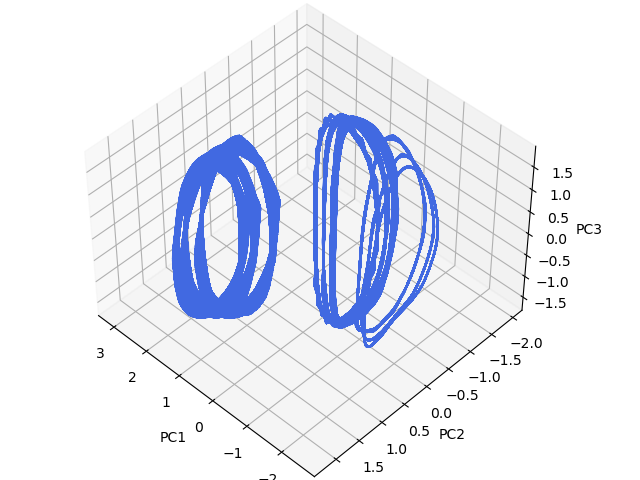

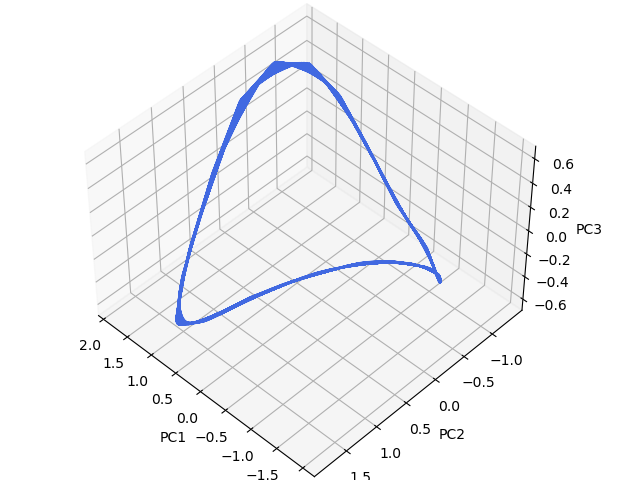

In [35]:
%matplotlib widget
sine_single_loader = torch.utils.data.DataLoader(train_dataset, batch_size=1)
plot_traj(sine_model, sine_single_loader, init_timelength=50,time_length=1000, n_traj=10)
plot_traj(sine_model, sine_single_loader, init_timelength=50,time_length=1000, n_traj=1)

In [37]:
# n_in = 1
# n_out = 1
# n_hid = 200
# sine_model = RNN(n_in, n_out, n_hid, save_path='./sineRNN').to(device)
# print(f'loading from {sine_model.save_path}')
# load(sine_model.save_path, sine_model)
sine_full_fixed_point_list = find_fix_points(sine_model, sine_single_loader, dataset='Sine', full=False)

iteration: 1000, speed=0.005788825917989016
iteration: 2000, speed=0.002489006845280528
iteration: 3000, speed=0.0019932175055146217
iteration: 4000, speed=0.0027523485478013754
iteration: 5000, speed=0.002472677966579795
iteration: 6000, speed=0.002423312980681658
performance leveled, forcibly finished. speed=0.002423312980681658
1
iteration: 1000, speed=0.004680364392697811
iteration: 2000, speed=0.002609886694699526
iteration: 3000, speed=0.002811742713674903
iteration: 4000, speed=0.002805175259709358
performance leveled, forcibly finished. speed=0.002805175259709358
2
iteration: 1000, speed=0.0033366826828569174
iteration: 2000, speed=0.003021354554221034
iteration: 3000, speed=0.0025500429328531027
iteration: 4000, speed=0.0027717312332242727
iteration: 5000, speed=0.002801422728225589
performance leveled, forcibly finished. speed=0.002801422728225589
3
iteration: 1000, speed=0.004074112977832556
iteration: 2000, speed=0.0030636698938906193
iteration: 3000, speed=0.00260761659592

(20000, 200)


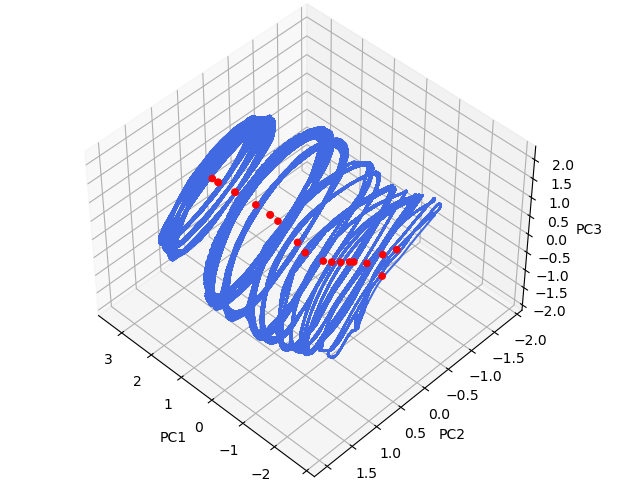

In [39]:
plot_traj(sine_model, sine_single_loader, sine_full_fixed_point_list, 
                init_timelength=50, n_traj=20, time_length=1000)

In [ ]:
plot_traj(sine_model, sine_single_loader, sine_fixed_point_list, 
                init_timelength=50, n_traj=20, time_length=1000)

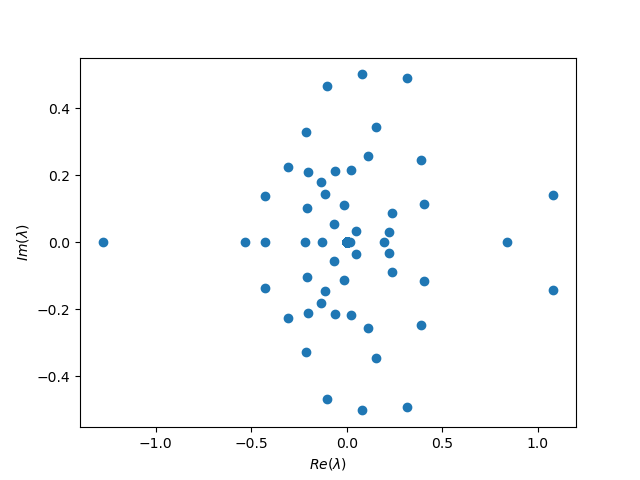

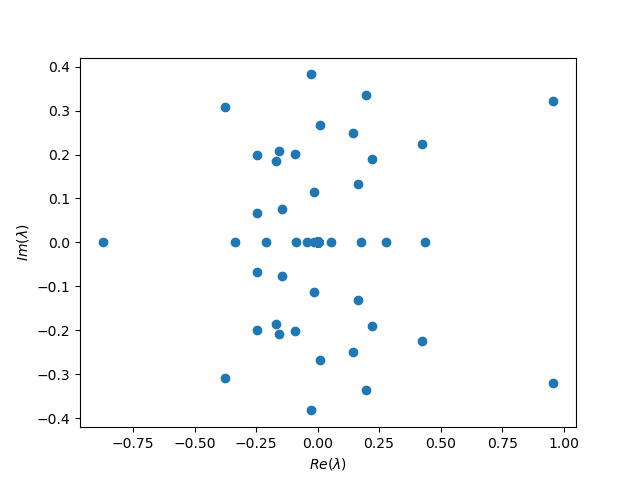

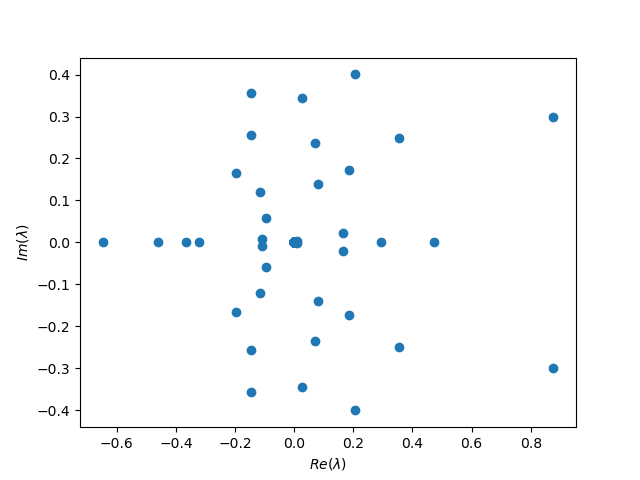

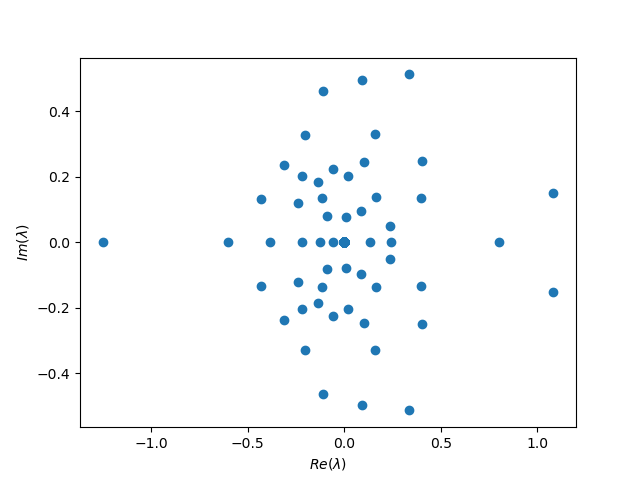

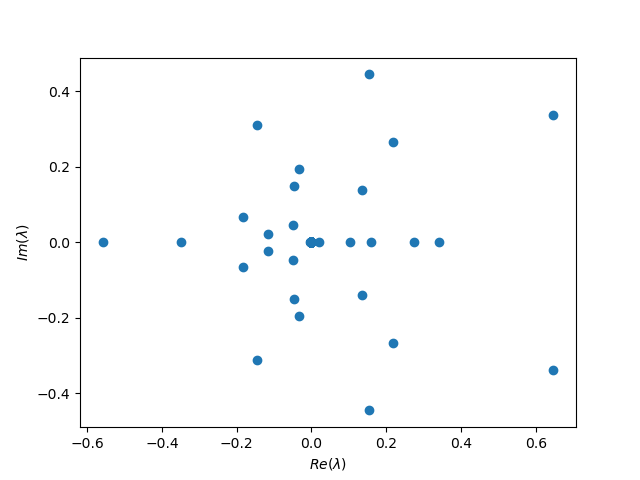

...

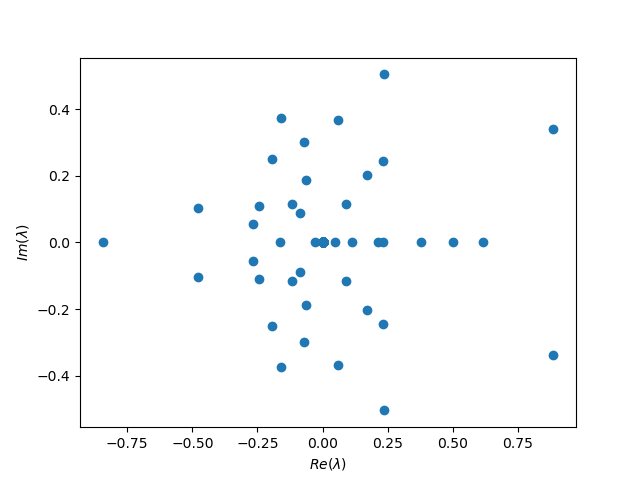

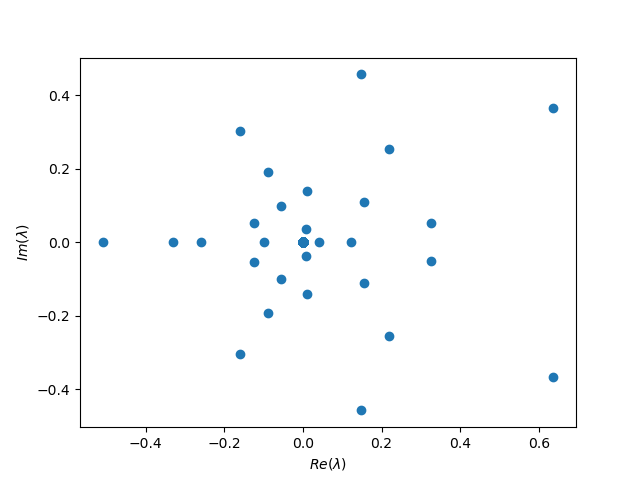

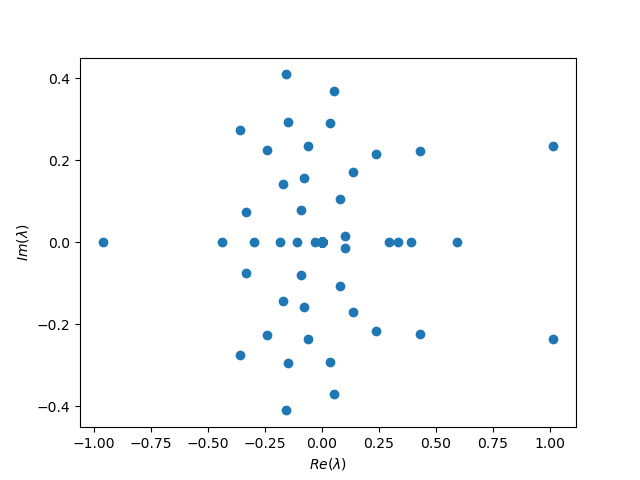

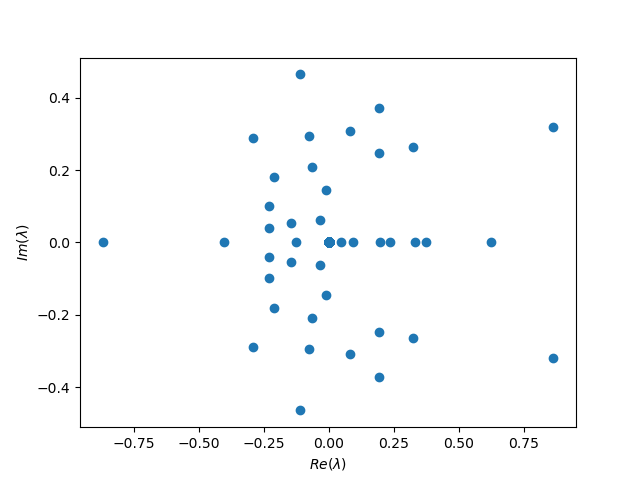

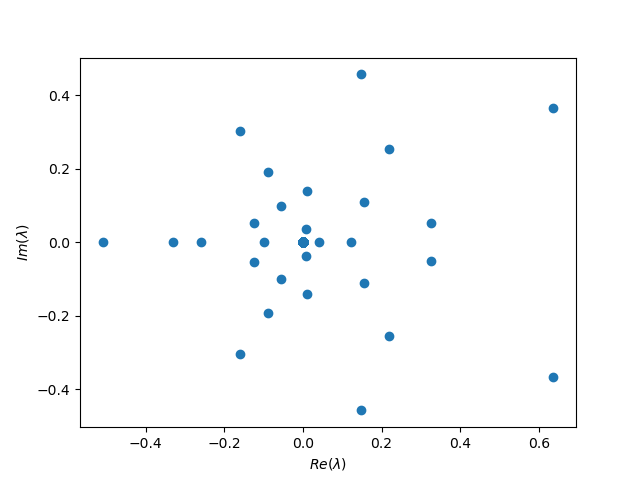

In [41]:
zero_input = torch.zeros(1,1,1).to(device)
analyzer = FixedPoint(model=sine_model, device=device)
for i in range(20):
    jacob = analyzer.calc_jacobian(torch.Tensor(sine_full_fixed_point_list[i]).to(device), zero_input)
    w, v = np.linalg.eig(jacob)
    w_real = list()
    w_im = list()
    for eig in w:
        w_real.append(eig.real)
        w_im.append(eig.imag)
    plt.figure()
    plt.scatter(w_real, w_im)
    plt.xlabel(r'$Re(\lambda)$')
    plt.ylabel(r'$Im(\lambda)$')
    plt.show()
    plt.savefig(f'figures/sine_eig{i}.png', dpi=100)

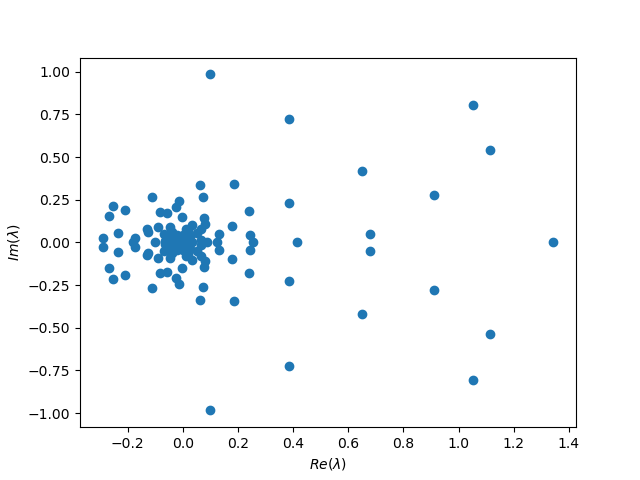

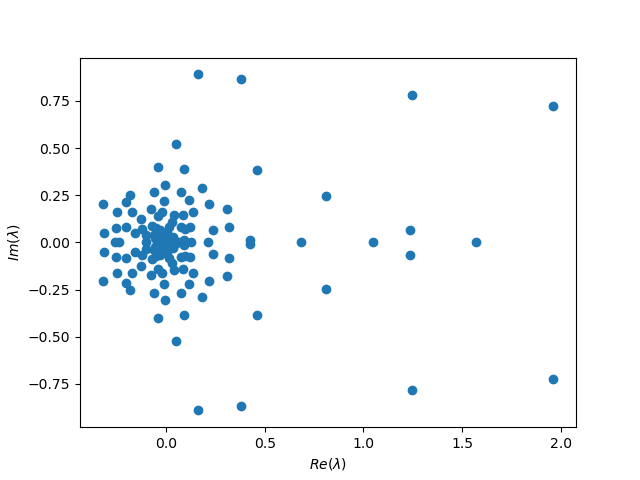

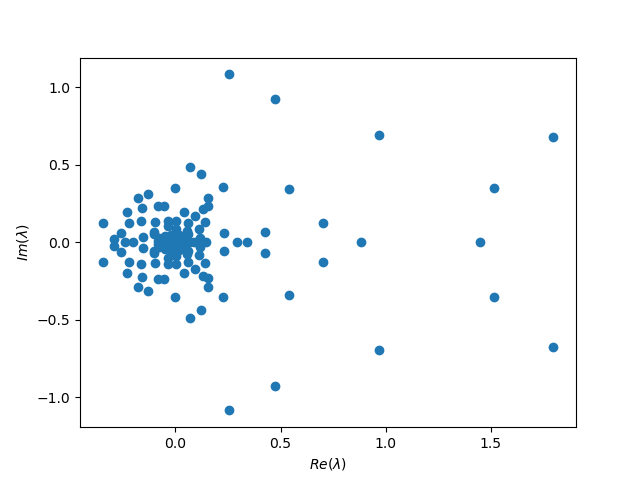

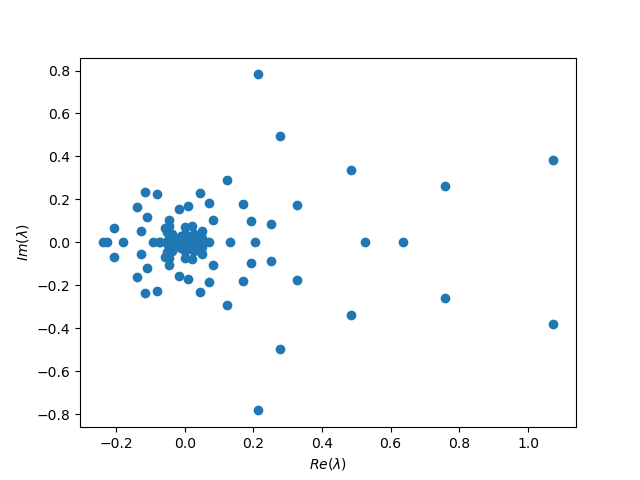

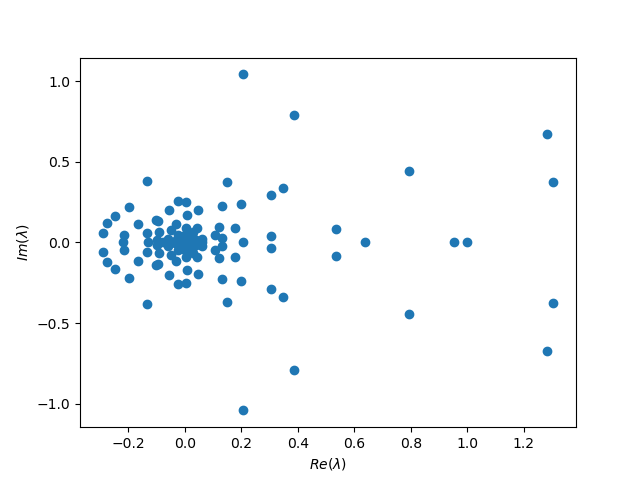

...

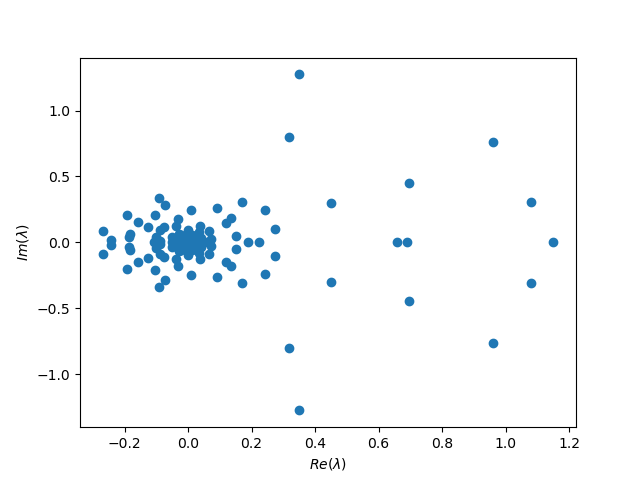

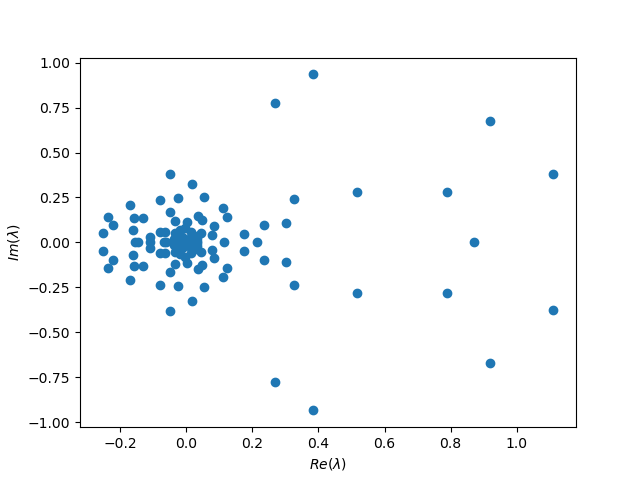

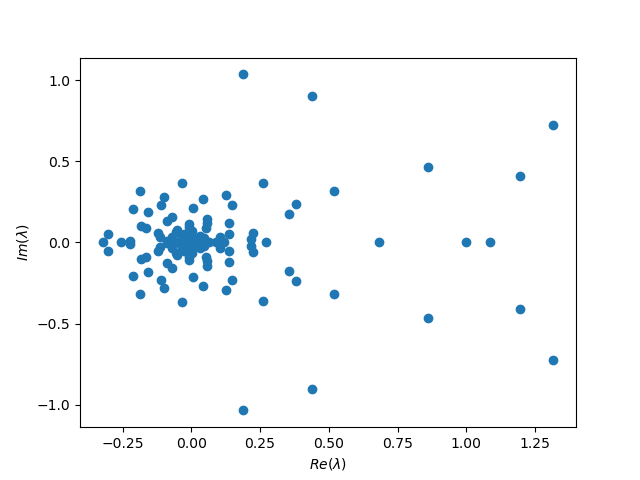

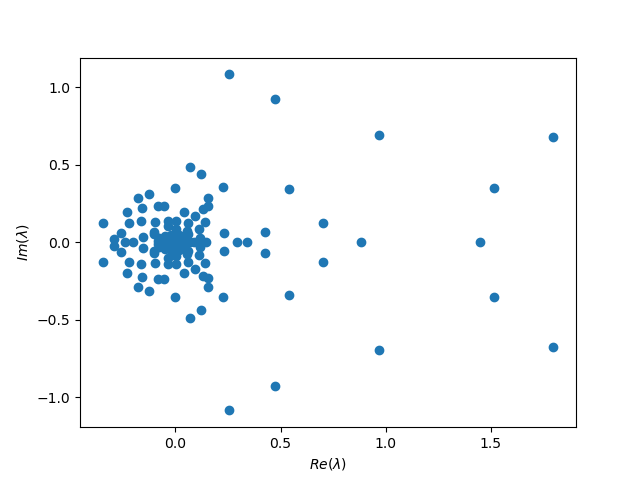

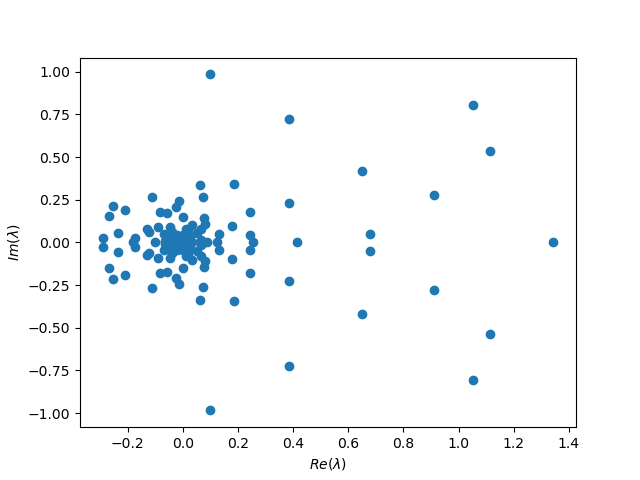

In [43]:
n_hid = 200
n_in = 28
n_out = 10
mnist_model = RNN(n_in, n_out, n_hid, lyapunov=False, activation='tanh', save_path='./vanillaRNN').to(device)
load(mnist_model.save_path, mnist_model)
zero_input = torch.zeros(1,1,28).to(device)
analyzer = FixedPoint(model=mnist_model, device=device)
for i in range(20):
    jacob = analyzer.calc_jacobian(torch.Tensor(vanilla_fixed_point_list[i]).to(device), zero_input)
    w, v = np.linalg.eig(jacob)
    w_real = list()
    w_im = list()
    for eig in w:
        w_real.append(eig.real)
        w_im.append(eig.imag)
    plt.figure()
    plt.scatter(w_real, w_im)
    plt.xlabel(r'$Re(\lambda)$')
    plt.ylabel(r'$Im(\lambda)$')
    plt.show()
#     plt.savefig(f'figures/MNIST_eig{i}.png', dpi=100)


In [47]:
def load_MNIST_model():
    n_hid = 200
    n_in = 28
    n_out = 10
    mnist_model = RNN(n_in, n_out, n_hid, lyapunov=False, activation='tanh', save_path='./vanillaRNN').to(device)
    load(mnist_model.save_path, mnist_model)
    return mnist_model

dataloader = test_loader
size = len(dataloader.dataset)
num_batch = len(dataloader)
model = load_MNIST_model()
model.eval()
test_loss, correct = 0, 0
incorrect_table = torch.zeros(10)
with torch.no_grad():
    for test_sample, label in dataloader:
        test_sample, label = test_sample.to(device), label.to(device)
        _,_,pred = model(test_sample)
        incorrect = label[pred.argmax(1)!=label]
        for i in range(10):
            incorrect_table[i] += incorrect[incorrect==i].shape[0]

Text(0.5, 0, 'digit label')

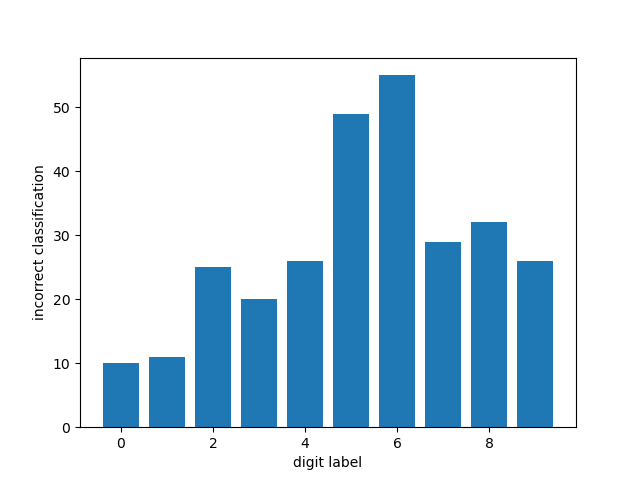

In [59]:
plt.figure()
plt.bar(range(10), incorrect_table)
plt.ylabel('incorrect classification')
plt.xlabel('digit label')

In [51]:
dataloader.__len__()

40

In [56]:
1-283/10000

0.9717